In [1]:
# import packages
import sys
import os.path
import numpy as np
np.seterr(divide='ignore',invalid='ignore')
import pandas as pd
import json
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.pyplot import text
import seaborn as sns
sns.set()

from spykshrk.realtime.datatypes import Datatypes
import loren_frank_data_processing as lfdp
from loren_frank_data_processing import Animal
import trodes2SS
import scipy as sp
import sungod_util
from spykshrk.franklab.data_containers import RippleTimes, pos_col_format#FlatLinearPosition, SpikeFeatures, Posteriors, \
         #EncodeSettings, pos_col_format, SpikeObservation, RippleTimes, DayEpochEvent, DayEpochTimeSeries

%load_ext autoreload
%autoreload 2

idx = pd.IndexSlice
pd.set_option('display.max_rows', 10)
pd.set_option('display.width', 120)

In [ ]:
# cell to start up holoviews
import holoviews as hv

import scipy as sp

hv.extension('bokeh')

In [ ]:
# cell to test and make sure holoviews and bokeh are working
coords = np.random.rand(50,2)
points = hv.Points(coords)

points.opts(color='k', marker='+', size=10)

In [598]:
exp_list = np.zeros((1,10))
exp_list[0][2]

0.0

In [218]:
# test sampling from exponential function
exp_list = np.zeros((1,50))
for i in np.arange(0,50):
    exp_list[0][i] = np.random.exponential(scale=30.0, size=None)
#np.around(exp_list,decimals=2)

<IPython.core.display.Javascript object>


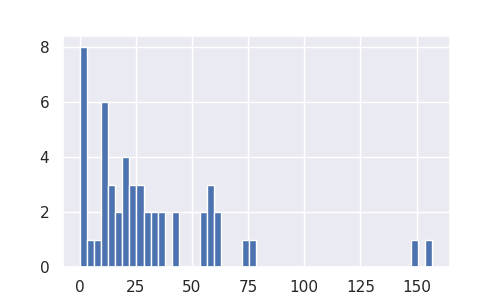

(array([8., 1., 1., 6., 3., 2., 4., 3., 3., 2., 2., 2., 0., 2., 0., 0., 0.,
        2., 3., 2., 0., 0., 0., 1., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 1.]),
 array([  0.26569727,   3.4007034 ,   6.53570954,   9.67071567,
         12.8057218 ,  15.94072793,  19.07573406,  22.2107402 ,
         25.34574633,  28.48075246,  31.61575859,  34.75076472,
         37.88577085,  41.02077699,  44.15578312,  47.29078925,
         50.42579538,  53.56080151,  56.69580765,  59.83081378,
         62.96581991,  66.10082604,  69.23583217,  72.37083831,
         75.50584444,  78.64085057,  81.7758567 ,  84.91086283,
         88.04586896,  91.1808751 ,  94.31588123,  97.45088736,
        100.58589349, 103.72089962, 106.85590576, 109.99091189,
        113.12591802, 116.26092415, 119.39593028, 122.53093641,
        125.66594255, 128.80094868, 131.93595481, 135.07096094,
        138.20596707, 141.34097321, 144.47597934, 147.61098547,
      

In [219]:
plt.figure(figsize=(5,3))
plt.hist(exp_list[0],bins=50)

In [223]:
np.random.exponential(scale=30.0, size=None)

36.936610537940155

In [764]:
# cell to read real-time hdf5 file

#12-17, bill run session 3
#hdf_file = '/stelmo/mcoulter/spykshrk_output/bill/20191217_bill_05_r3_westerlies_streaming.rec_merged.h5'

# new pos/vel and fix prob no spike
#hdf_file = '/stelmo/mcoulter/spykshrk_output_westerlies/remy_decoder_19tet_2_13_prob_no.rec_merged.h5'

# 2-19 trodes 2 spike fix
#hdf_file = '/stelmo/mcoulter/spykshrk_output_westerlies/remy_decoder_19tet_2_19_spike_fix_whole.rec_merged.h5'

# 2-20 trodes 2 spike fix, new posterior sum times
#hdf_file = '/stelmo/mcoulter/spykshrk_output_westerlies/remy_decoder_19tet_2_20_post_sum_length.rec_merged.h5'

# 2-21 trodes 2 spike fix, more complete post sum record
#hdf_file = '/stelmo/mcoulter/spykshrk_output_westerlies/remy_decoder_19tet_2_21_post_sum_record.rec_merged.h5'

# 2-22 trodes 2 spike fix, 20 msec delay after ripple detection to start sum
#hdf_file = '/stelmo/mcoulter/spykshrk_output_westerlies/remy_decoder_19tet_2_22_post_sum_delay.rec_merged.h5'

# 3-26 lfp config fix, 5 lfp tets, rip sd = 4, crossing tets = 2
#hdf_file = '/stelmo/mcoulter/spykshrk_output_westerlies/remy_decoder_19tet_3_26_fix_lfp_ref.rec_merged.h5'

# 3-26 lfp config fix, 10 lfp tets, rip sd = 4, crossing tets = 4
#hdf_file = '/stelmo/mcoulter/spykshrk_output_westerlies/remy_decoder_19tet_3_26_10_lfp_tets.rec_merged.h5'

# 3-27 lfp config fix, 5 lfp tets, rip sd = 5, crossing tets = 2
# hmmmm something is wrong here, 75 matching replays and 875 non-matching...
#hdf_file = '/stelmo/mcoulter/spykshrk_output_westerlies/remy_decoder_19tet_3_27_5_lfp_tets.rec_merged.h5'

# 4-9 lfp config fix, 10 lfp tets, rip sd = 4, crossing tets = 4, ripple lockout 200 msec, posterior sum 75 msec, 15uV
#hdf_file = '/stelmo/mcoulter/spykshrk_output_westerlies/remy_20_2_19tet_10lfp_15uV_4_9_rip_time.rec_merged.h5'

# 4-9 lfp config fix, 10 lfp tets, rip sd = 4, crossing tets = 4, ripple lockout 200 msec, posterior sum 50 msec, 20uV
#hdf_file = '/stelmo/mcoulter/spykshrk_output_westerlies/remy_20_2_19tet_10lfp_20uV_4_9_rip_200_50.rec_merged.h5'

# 4-10 gus day 17 epoch 3 - correct channels zero-ed out
#hdf_file = '/stelmo/mcoulter/spykshrk_output_westerlies/gus_1107_19tet_10lfp_4_10.rec_merged.h5'

# 4-13 gus day 17 epoch 3 - added LFP referencing
#hdf_file = '/stelmo/mcoulter/spykshrk_output_westerlies/gus_1107_19tet_10lfp_4_13_redo.rec_merged.h5'

# 4-16 real-time decoder using the full R Star tree for the whole session - not sure if this works
#hdf_file = '/stelmo/mcoulter/spykshrk_output_westerlies/remy_20_2_19tet_10lfp_20uV_4_16_load_tree.rec_merged.h5'

# 4-16 full R star tree, take 2 - tried to fix occupancy by loading complete occupancy
#hdf_file = '/stelmo/mcoulter/spykshrk_output_westerlies/remy_20_2_19tet_10lfp_20uV_4_16_load_tree_2.rec_merged.h5'

# 4-17 re-run remy day 20 epoch 2 with trans mat offset = 0.001
#hdf_file = '/stelmo/mcoulter/spykshrk_output_westerlies/remy_20_2_19tet_10lfp_20uV_4_17_offset.rec_merged.h5'

# 3-31 remy day 20 epoch 4 - better for arm 7 maybe, offset 0.0001
#hdf_file = '/stelmo/mcoulter/spykshrk_output_westerlies/remy_20_4_19tet_3_31_10lfp.rec_merged.h5'

# 4-23 remy day 20 epoch 4 - trans mat offset = 0.001
#hdf_file = '/stelmo/mcoulter/spykshrk_output_westerlies/remy_20_4_19tet_10lfp_4_23_offset.rec_merged.h5'

# 4-25 new whole ripple sum for real-time decoder
#hdf_file = '/stelmo/mcoulter/spykshrk_output_westerlies/remy_20_4_19tet_10lfp_4_25_replay_check.rec_merged.h5'

# 4-25 new whole ripple sum for real-time decoder, whole session
#hdf_file = '/stelmo/mcoulter/spykshrk_output_westerlies/remy_20_4_19tet_10lfp_4_25_replay_check_2.rec_merged.h5'

# 4-26 use spike count instead of timer for end of ripple lockout
hdf_file = '/stelmo/mcoulter/spykshrk_output_westerlies/remy_20_4_19tet_10lfp_4_26_lockout_whole.rec_merged.h5'


store = pd.HDFStore(hdf_file, mode='r')

In [3]:
# 4-9 lfp config fix, 10 lfp tets, rip sd = 4, crossing tets = 4, ripple lockout 200 msec, posterior sum 50 msec, 20uV
encoder_data = store['rec_3']
decoder_data = store['rec_4']
decoder_missed_spikes = store['rec_5']
likelihood_data = store['rec_6']
occupancy_data = store['rec_7']
#ripple_data = store['rec_1']
#stim_state = store['rec_10']
stim_lockout = store['rec_11']
stim_message = store['rec_12']
#timing = store['rec_100']

In [5]:
# 4-17 re-run remy day 20 epoch 2 with trans mat offset = 0.001
encoder_data1 = store['rec_3']
decoder_data1 = store['rec_4']
decoder_missed_spikes1 = store['rec_5']
likelihood_data1 = store['rec_6']
occupancy_data1 = store['rec_7']
#ripple_data1 = store['rec_1']
#stim_state = store['rec_10']
stim_lockout1 = store['rec_11']
stim_message1 = store['rec_12']
#timing1 = store['rec_100']

In [374]:
# 3-31 remy day 20 epoch 4 (trans mat offset = 0.0001)
encoder_data2 = store['rec_3']
decoder_data2 = store['rec_4']
decoder_missed_spikes2 = store['rec_5']
likelihood_data2 = store['rec_6']
occupancy_data2 = store['rec_7']
#ripple_data1 = store['rec_1']
#stim_state = store['rec_10']
stim_lockout2 = store['rec_11']
stim_message2 = store['rec_12']
#timing1 = store['rec_100']

In [592]:
# 4-23 remy day 20 epoch 4 (trans mat offset = 0.001)
encoder_data3 = store['rec_3']
decoder_data3 = store['rec_4']
decoder_missed_spikes3 = store['rec_5']
likelihood_data3 = store['rec_6']
occupancy_data3 = store['rec_7']
#ripple_data1 = store['rec_1']
#stim_state = store['rec_10']
stim_lockout3 = store['rec_11']
stim_message3 = store['rec_12']
#timing1 = store['rec_100']

In [765]:
# 4-26 spike count for ripple lockout end
encoder_data5 = store['rec_3']
decoder_data5 = store['rec_4']
decoder_missed_spikes5 = store['rec_5']
likelihood_data5 = store['rec_6']
occupancy_data5 = store['rec_7']
#ripple_data1 = store['rec_1']
#stim_state = store['rec_10']
stim_lockout5 = store['rec_11']
stim_message5 = store['rec_12']
#timing1 = store['rec_100']

In [567]:
# occupancy at end of run session: remy 20, 2
occupancy_data5.iloc[:,9:146][-1:].values

occ_test = [[2775., 1186., 1215., 2759., 1499., 1012., 1229., 1672., 1549.,
          0,   0,   0,   0,  178.,  132.,  115.,  135.,  133.,
         110.,   95.,   79.,   92.,  116.,  196.,  453.,   0,   0,
          0,   0,  134.,   95.,   92.,   78.,   88.,   80.,   70.,
          76.,   81.,  105.,  169.,  372.,   0,   0,   0,   0,
         107.,  106.,  117.,   97.,   83.,   78.,   76.,   71.,   84.,
         106.,  165.,  354.,   0,   0,   0,   0,  122.,   89.,
          81.,   76.,   78.,   70.,   63.,   67.,   68.,   93.,  138.,
         276.,   0,   0,   0,   0,  251.,  160.,  123.,  113.,
         113.,  116.,  101.,   94.,   86.,  104.,  149.,  375.,   0,
          0,   0,   0,  209.,  154.,  133.,  121.,   88.,   90.,
          87.,   84.,   94.,  111.,  163.,  280.,   0,   0,   0,
          0,   97.,   77.,   66.,   63.,   61.,   52.,   57.,   46.,
          51.,   81.,  108.,  195.,   0,   0,   0,   0,  106.,
         109.,   99.,  105.,   86.,   74.,   72.,   69.,   79.,  104.,
         156.,  289.]]
occ_test[0][0]
occ_test = np.asarray(occ_test)[0]
occ_test.shape

(137,)

In [ ]:
# categories of timing messages
list(timing3)

In [37]:
print(stim_lockout[stim_lockout['lockout_state']==1].shape)
print(stim_lockout1[stim_lockout1['lockout_state']==1].shape)
print(stim_lockout2[stim_lockout2['lockout_state']==1].shape)
print(stim_lockout3[stim_lockout3['lockout_state']==1].shape)

(680, 7)
(3266, 7)
(1309, 7)
(1412, 7)


In [179]:
# spike counts for a ripple
sum(decoder_data2['spike_count'].values)
test_ripple = decoder_data2[(decoder_data2['bin_timestamp']>=112179450) & (decoder_data2['bin_timestamp']<=112180950)]
sum(test_ripple['spike_count'].values)

71

In [171]:
# total decoded spikes
encoder_data2.shape[0] - decoder_missed_spikes2.shape[0]

1341300

In [737]:
stim_message4['posterior_max_arm']
rips

<RippleTimes: 7fb8aa54-72b2-4d31-be50-8e656c2067c7, shape: ((1265, 4))>

In [ ]:
# new posterior sum for whole ripple process
# notes: need to turn on lfp timer in decoder process
plt.figure(figsize=(8,4))
#plt.hist(stim_message4['delay'].values)
plt.hist(stim_message4['posterior_max_arm'],bins=np.arange(0,100))
#plt.scatter(mvt_time['time'].values,mvt_time['linpos_flat'].values,s=1,c='red')


In [6]:
# DO NOT USE - old linearization
#this is the most recent offline decode
file_path = '/stelmo/mcoulter/oct_2019_decoding/remy_20_2_shuffle_0_posteriors_functionalized_150_decode_whole.h5'


In [6]:
# Remy: this offline data is good
# most recent offline decode with new linearization
file_path = '/stelmo/mcoulter/raw_data/remy/remy_20_2_shuffle_0_posteriors_2_20_offline_new_linear.h5'
hdf_base = '/analysis'
hdf_grps = 'decode/clusterless/offline/posterior'
hdf_label = 'sungod_trans_mat'

with pd.HDFStore(file_path, 'r') as store:
    main_path = os.path.join(hdf_base, hdf_grps, hdf_label)
    posteriors2 = store[main_path] 


In [30]:
# Remy: offline decode with trans mat offset = 0.001
file_path = '/stelmo/mcoulter/raw_data/remy/remy_20_2_shuffle_0_posteriors_4_18_offline_offset.h5'
hdf_base = '/analysis'
hdf_grps = 'decode/clusterless/offline/posterior'
hdf_label = 'sungod_trans_mat'

with pd.HDFStore(file_path, 'r') as store:
    main_path = os.path.join(hdf_base, hdf_grps, hdf_label)
    posteriors3 = store[main_path] 

In [376]:
# Remy: offline decode day 20, epoch 4
file_path = '/stelmo/mcoulter/raw_data/remy/remy_20_4_shuffle_0_posteriors_3_31_offline_new_linear.h5'
hdf_base = '/analysis'
hdf_grps = 'decode/clusterless/offline/posterior'
hdf_label = 'sungod_trans_mat'

with pd.HDFStore(file_path, 'r') as store:
    main_path = os.path.join(hdf_base, hdf_grps, hdf_label)
    posteriors4 = store[main_path] 

In [599]:
# Remy: offline decode day 20, epoch 4, offset = 0.001
file_path = '/stelmo/mcoulter/raw_data/remy/remy_20_4_shuffle_0_posteriors_4_23_offline_offset.h5'
hdf_base = '/analysis'
hdf_grps = 'decode/clusterless/offline/posterior'
hdf_label = 'sungod_trans_mat'

with pd.HDFStore(file_path, 'r') as store:
    main_path = os.path.join(hdf_base, hdf_grps, hdf_label)
    posteriors5 = store[main_path] 

In [341]:
# Gus offline decode with new linearization
file_path = '/stelmo/mcoulter/raw_data/gus/gus_17_3_shuffle_0_posteriors_4_13_offline_new_linear.h5'
hdf_base = '/analysis'
hdf_grps = 'decode/clusterless/offline/posterior'
hdf_label = 'sungod_trans_mat'

with pd.HDFStore(file_path, 'r') as store:
    main_path = os.path.join(hdf_base, hdf_grps, hdf_label)
    posteriors3 = store[main_path] 

In [773]:
# Remy: offline decode day 21, epoch 2, encode whole
file_path = '/stelmo/mcoulter/raw_data/remy/remy_21_2_shuffle_0_posteriors_4_28_offline_whole.h5'
hdf_base = '/analysis'
hdf_grps = 'decode/clusterless/offline/posterior'
hdf_label = 'sungod_trans_mat'

with pd.HDFStore(file_path, 'r') as store:
    main_path = os.path.join(hdf_base, hdf_grps, hdf_label)
    posteriors6 = store[main_path] 

In [774]:
# Remy: offline decode day 21, epoch 2, encode partial
file_path = '/stelmo/mcoulter/raw_data/remy/remy_21_2_shuffle_0_posteriors_4_28_offline_partial.h5'
hdf_base = '/analysis'
hdf_grps = 'decode/clusterless/offline/posterior'
hdf_label = 'sungod_trans_mat'

with pd.HDFStore(file_path, 'r') as store:
    main_path = os.path.join(hdf_base, hdf_grps, hdf_label)
    posteriors7 = store[main_path] 

In [777]:
# get linear position for offline
# TO DO: update for location of new linearized position files

#### Define parameters
rat_name = 'remy'
day =  21     #previously:{'remy':[20], 'gus':[28], 'bernard':[23], 'fievel':[19]}
epoch = 2   # previously:{'remy':[4], 'gus':[2], 'bernard':[4], 'fievel':[2]} 

# define data source filepaths
path_base = '/stelmo/mcoulter/'
#path_base = '/mnt/vortex/mcoulter/'
#raw_directory = path_base + 'raw_data/' + rat_name + '/'
raw_directory = '/stelmo/anna/remy/filterframework/'
# old linearization
#linearization_path = raw_directory + 'decoding/'
# new linearization
linearization_path = '/stelmo/mcoulter/raw_data/'
day_ep = str(day) + '_' + str(epoch)

#tetlist = None
tetlist = [4]
tetrodes= tetlist

pos_bin_size = 5
velocity_thresh_for_enc_dec = 4
velocity_buffer = 0
shift_amt_for_shuffle = 0
use_enc_as_dec = 1   #if you want to use the encoding marks as the decoding marks
discrete_tm_val=.99   # for classifier

# IMPORT and process data
#initialize data importer
datasrc = trodes2SS.TrodesImport(raw_directory, rat_name, [day], 
                       [epoch], tetrodes)
# Import trials
trials = datasrc.import_trials()
# Import raw position
linear_pos_raw = datasrc.import_pos(xy='x')   # this is basically just to pull in speed, will be replaced with linearized below
#posY = datasrc.import_pos(xy='y')          #  OPTIONAL; useful for 2d visualization

# if linearization exists, load it. if not, run the linearization.
# new linear: linearization_path + rat_name
# old linear: linearization_path 
lin_output1 = linearization_path + rat_name + '/' + rat_name + '_' + day_ep + '_' + 'linearized_distance.npy'
lin_output2 = linearization_path + rat_name + '/' + rat_name + '_' + day_ep + '_' + 'linearized_track_segments.npy'
linear_pos_raw['linpos_flat'] = np.load(lin_output1)   #replace x pos with linerized 
track_segment_ids = np.load(lin_output2)
print('Linearization found. Loading it')

# generate boundary definitions of each segment
arm_coords, _ = sungod_util.define_segment_coordinates(linear_pos_raw, track_segment_ids)  # optional addition output of all occupied positions (not just bounds)

#bin linear position 
binned_linear_pos, binned_arm_coords, pos_bins = sungod_util.bin_position_data(linear_pos_raw, arm_coords, pos_bin_size)

# for using new linearization nodes
binned_arm_coords[:,1] = 1+binned_arm_coords[:,1]
print(binned_arm_coords)
#pos_bin_delta = 1

# Import ripples
rips_tmp = datasrc.import_rips(linear_pos_raw, velthresh=4) 
rips = RippleTimes.create_default(rips_tmp,1)  # cast to rippletimes obj
print('Rips less than velocity thresh: '+str(len(rips)))


Linearization found. Loading it
[  0.   5.  10.  15.  20.  25.  30.  35.  40.  45.  50.  55.  60.  63.
  68.  73.  78.  83.  88.  93.  98. 103. 108. 113. 118. 123. 128. 133.
 138. 141. 146. 151. 156. 161. 166. 171. 176. 181. 186. 191. 196. 201.
 206. 211. 216. 220. 225. 230. 235. 240. 245. 250. 255. 260. 265. 270.
 275. 280. 285. 290. 295. 300. 302. 307. 312. 317. 322. 327. 332. 337.
 342. 347. 352. 357. 362. 367. 372. 377. 382. 387. 392. 397. 402. 407.
 412. 417. 422. 427. 432. 437. 442. 447. 452. 457. 461. 466. 471. 476.
 481. 486. 491. 496. 501. 506. 511. 516. 521. 526. 531. 536. 541. 542.
 547. 552. 557. 562. 567. 572. 577. 582. 587. 592. 597. 602. 607. 612.
 617. 620. 625. 630. 635. 640. 645. 650. 655. 660. 665. 670. 675. 680.
 685.]
[[  0   8]
 [ 13  25]
 [ 29  41]
 [ 45  57]
 [ 62  74]
 [ 78  90]
 [ 94 106]
 [111 123]
 [127 139]]
[[  0   9]
 [ 13  26]
 [ 29  42]
 [ 45  58]
 [ 62  75]
 [ 78  91]
 [ 94 107]
 [111 124]
 [127 140]]
Rips less than velocity thresh: 1485


<IPython.core.display.Javascript object>


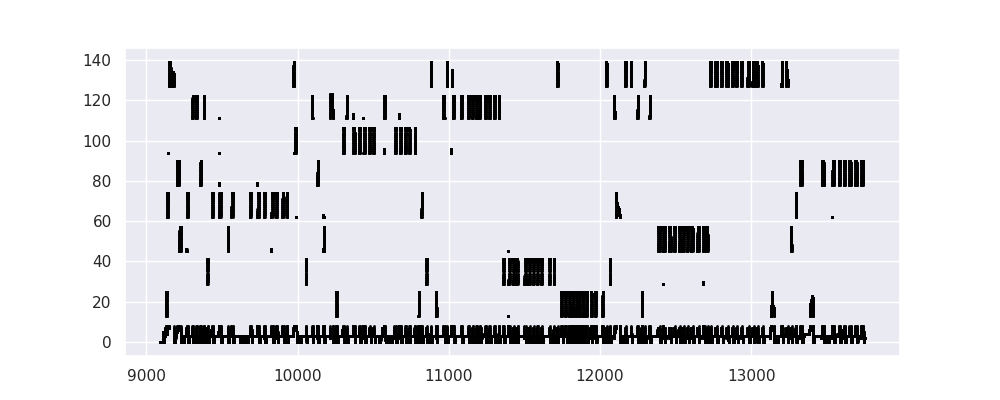

In [378]:
#%matplotlib notebook
# look at trials for remy day 20 epoch 4
binned_linear_pos_plot = binned_linear_pos.copy()
binned_linear_pos_plot.reset_index(inplace=True)
mvt_time = binned_linear_pos_plot[binned_linear_pos_plot['linvel_flat'].values>4]
plt.figure(figsize=(10,4))
plt.scatter(binned_linear_pos_plot['time'].values,binned_linear_pos_plot['linpos_flat'].values,s=1,c='black')
#plt.scatter(mvt_time['time'].values,mvt_time['linpos_flat'].values,s=1,c='red')


<IPython.core.display.Javascript object>


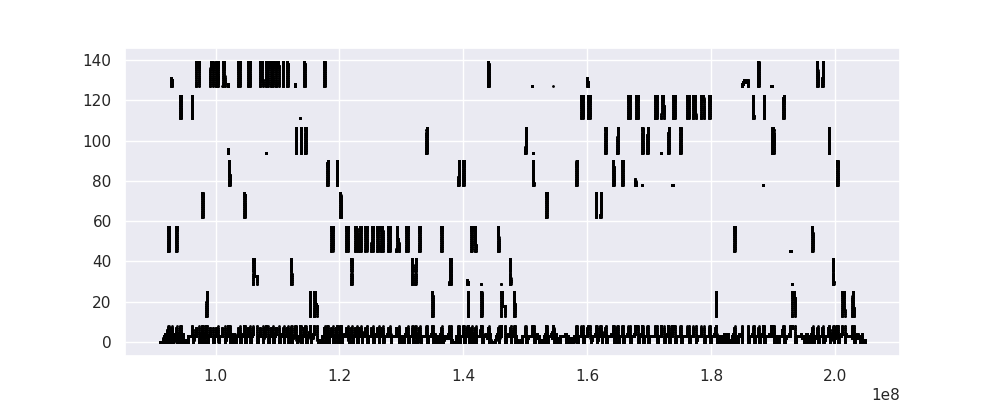

In [354]:
# look at linearized position for Gus day 17 epoch 3
# compare real-time and offline

# real-time timestamp offset: +88254102
# offset appears to be correct

binned_linear_pos_plot = binned_linear_pos.copy()
binned_linear_pos_plot.reset_index(inplace=True)
mvt_time = binned_linear_pos_plot[binned_linear_pos_plot['linvel_flat'].values>4]
plt.figure(figsize=(10,4))
plt.scatter(binned_linear_pos_plot['timestamp'].values,binned_linear_pos_plot['linpos_flat'].values,s=1,c='black')
#plt.scatter(occupancy_data6['bin_timestamp'].values+88254102,occupancy_data6['linear_pos'].values,s=1,c='red')

#plt.scatter(mvt_time['time'].values,mvt_time['linpos_flat'].values,s=1,c='red')


In [255]:
# want to get rid of messages sent based on sum during length of the ripple - too many false positives
# remove duplicates from stim_message - should only have first message for each ripple
# now, we dont want to use this! with 75 msec window we want to see what happens with the 2nd message
stim_messsage_no_dup = stim_message5.copy()
stim_messsage_no_dup['ripple_diff'] = stim_message5['ripple_number'].diff()
stim_message_to_use = stim_messsage_no_dup[stim_messsage_no_dup['ripple_diff']>0]
print(stim_message_to_use.shape)
print(stim_message5.shape)

(1207, 24)
(1314, 23)


In [753]:
# want to try to add both beginning of ripple and time bin when message was sent to decoder_data
# for stim_message this merge ('nearest') put the arm number and ripple number at all timebins after the end of the rippple
# for stim_lockout this merge ('backward') will highlight the ripple time
# stim_lockout timestamp_shift is the 70 msec shift to account for delay in realtime rip detection (-2100)
# currently it looks like the shift is set to 0

# which files to use
stim_message_file = stim_message4
stim_lockout_file = stim_lockout4
decoder_data_file = decoder_data4

stim_message_1 = stim_message_file.copy()
stim_message_2 = stim_message_1.drop(['rec_ind','spike_timestamp','time','lfp_timestamp',
                                   'ripple_time_bin','spike_count',
                                   'content_threshold','max_arm_repeats','box','arm1','arm2',
                                   'arm3','arm4','arm5','arm6','arm7','arm8'], axis=1)
stim_message_2
decode_to_merge = decoder_data_file.copy()
merged_decoder_stim = pd.merge_asof(decode_to_merge,stim_message_2,on='bin_timestamp',direction='nearest')
merged_decoder_stim

stim_lockout_1 = stim_lockout_file.copy()
stim_lockout_1['timestamp_shift'] = stim_lockout_file['timestamp']
stim_lockout_1['bin_timestamp'] = stim_lockout_1['timestamp_shift']

stim_lockout_2 = stim_lockout_1.drop(['rec_ind','timestamp','time','tets_above_thresh',
                                      'big_rip_message_sent'], axis=1)
stim_lockout_2
##decode_to_merge = decoder_data1.copy()
merged_decoder_lockout = pd.merge_asof(merged_decoder_stim,stim_lockout_2,on='bin_timestamp',direction='backward')
merged_decoder_lockout.shape

(819772, 170)

<IPython.core.display.Javascript object>


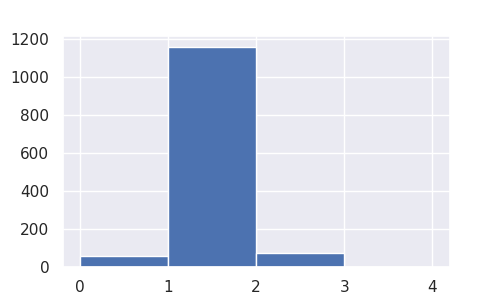

(array([5.800e+01, 1.159e+03, 7.200e+01, 1.000e+00]),
 array([0, 1, 2, 3, 4]),
 <a list of 4 Patch objects>)

In [196]:
# several ripples are missing any entry for shortcut_message
# and several are duplicated
# okay figured this out - was problem with 20 msec delay - no longer using this
# duplicates are from allowed time for sum after ripple detection
plt.figure(figsize=(5,3))
plt.hist(stim_message_file['ripple_number'].diff().values,bins=np.arange(0,5))

In [ ]:
# time of non-matching realtime ripples (false positive)
realtime_rip_list = stim_lockout5[stim_lockout5['lockout_state']==1]
realtime_rip_list
plt.figure(figsize=(7,3))
#plt.scatter(nonmatching_offline_rips['timestamp_x'].values,nonmatching_offline_rips['lockout_state'].values,s=5)
#plt.hist(nonmatching_offline_rips['timestamp_x'].values,bins=100,color='r')
plt.hist(realtime_rip_list['timestamp'].values,bins=100,color='k')



In [754]:
# subset of decoder_data to plot - loop through each ripple
# how can we just generate the images for the mismatched ripples??

# which files to use
stim_message_file = stim_message4
stim_lockout_file = stim_lockout4
decoder_data_file = decoder_data4

# new: stim_message
#realtime_posterior_sum_all = np.zeros((len(stim_message_file),4))
# original: stim_lockout
realtime_posterior_sum_all = np.zeros((len(stim_lockout_file[stim_lockout_file['lockout_state']==1]),4))

counter = -1
summarize_all_rips = True

# we could use stim_message lfp_timestamp instead here - it is ahead by 100-200 timestamps
#for timestamp in stim_message_file['lfp_timestamp'].values:
# original: used stim_lockout
for timestamp in stim_lockout_file[stim_lockout_file['lockout_state']==1]['timestamp'].values:
    counter += 1
    #print(timestamp)
    #if counter in non_matching['realtime_rip'].values:
        #print(counter)
        
    # check replay content of non-matching ripples
    #if counter in nonmatching_offline_rips['lockout_num'].values:
        #print(counter)
        
    # check replay content of matching ripples
    #if counter in matching_offline_rips['lockout_num'].values:
        #print(counter)        
    
    if summarize_all_rips:
        #print(timestamp,)
    #posterior from decode/stim message merged table
        merged_to_plot = merged_decoder_lockout[(merged_decoder_lockout['bin_timestamp'] > timestamp-30*300) & 
                                            (merged_decoder_lockout['bin_timestamp'] < timestamp+30*300)]
        merged_to_plot.set_index('bin_timestamp',inplace=True)

        posterior_only_merged = merged_to_plot.drop(['rec_ind','wall_time','velocity','real_pos',
                                                'spike_count','ripple','ripple_length','timestamp_shift',
                                                'shortcut_message','box','arm1','arm2','arm3','arm4','arm5',
                                                'arm6','arm7','arm8','posterior_max_arm','shortcut_message_sent',
                                                'raw_x','raw_y','smooth_x','smooth_y','ripple_number_x',
                                                'ripple_number_y','ripple_end','lockout_state','lockout_num',
                                                'delay','next_bin'], axis=1)
        # ripple time - generated from lockout_state
        # note: this does not inlcude the 70 msec before ripple detection
        # lockout_state changes at posterior_lock end, so this should post_lock (now 50 msec)
        ripples_to_plot = merged_to_plot.reset_index()
        ripple_times_rt = ripples_to_plot.index[ripples_to_plot['lockout_state'] > 0].tolist()

        # get timestamp when shortcut message was sent - try to just isolate single ripple
        # bin_timestamp will show the delay - it will appear before the start of the ripple
        # in contrast, lfp_timestamp would line up exactly with ripple start
        shortcut_message_to_plot = stim_message_file[(stim_message_file['lfp_timestamp'] > timestamp-30*30) & 
                                             (stim_message_file['lfp_timestamp'] < timestamp+30*100)]
        merged_to_plot_index = merged_to_plot.reset_index()
        # loop through multiple entries in shortcut_message
        shortcut_message_times = np.zeros(shortcut_message_to_plot.shape[0])
        for i in np.arange(0,shortcut_message_to_plot.shape[0]):
            shortcut_message_times[i] = merged_to_plot_index.index[merged_to_plot_index['bin_timestamp'].values == shortcut_message_to_plot['bin_timestamp'][i:i+1].values].tolist()[0]
            #print(shortcut_message_to_plot['box'][i:i+1].values,shortcut_message_to_plot['arm1'][i:i+1].values,
            #      shortcut_message_to_plot['arm2'][i:i+1].values,shortcut_message_to_plot['arm3'][i:i+1].values,
            #      shortcut_message_to_plot['arm4'][i:i+1].values,shortcut_message_to_plot['arm5'][i:i+1].values,
            #      shortcut_message_to_plot['arm6'][i:i+1].values,shortcut_message_to_plot['arm7'][i:i+1].values,
            #      shortcut_message_to_plot['arm8'][i:i+1].values)
        #shortcut_message_times = merged_to_plot_index.index[merged_to_plot_index['bin_timestamp'].values == shortcut_message_to_plot['bin_timestamp'].values].tolist()
        shortcut_messages = shortcut_message_to_plot['shortcut_message_sent'].values*123
    
        #posterior_only
        #print(posterior_only_merged.shape)
    
        #plot heatmap with posterior surrounding each ripple
        post_heatmap = posterior_only_merged.transpose()
        post_heatmap = post_heatmap.iloc[::-1]
    
        #plot title: include ripple number, max arm, and delay
        title_index = int(len(merged_to_plot)*0.6)
        max_arm = merged_to_plot[title_index:title_index+1]['posterior_max_arm'].values
        #ripple_num = merged_to_plot[-2:-1]['ripple_number_y'].values
        #f'Real-time posterior, ripple {max_arm}. Max arm {ripple_num}'
        #ripple_num = merged_to_plot[ripple_num_index:ripple_num_index+1]['ripple_number_y'].values
        ripple_num = merged_to_plot[title_index:title_index+1]['lockout_num'].values
        message_delay = np.around(merged_to_plot[title_index:title_index+1]['delay'].values,decimals=0)
        #offline_max = non_matching[(non_matching['realtime_rip']>=counter) & 
        #                           (non_matching['realtime_rip']<counter+1)]['off_max_arm'].values
        offline_max = 0
        #print('ripple:',ripple_num,'timestamp',timestamp-30*300,timestamp+30*300)

        # fill in current row of posterior sum array - seems to work
        realtime_posterior_sum_all[counter,0] = ripple_num
        realtime_posterior_sum_all[counter,1] = max_arm
        realtime_posterior_sum_all[counter,2] = shortcut_message_to_plot.shape[0]-1
        realtime_posterior_sum_all[counter,3] = message_delay
    
        #plt.figure(figsize=(8,4))
        #plt.title(f'Real-time posterior, Ripple {ripple_num} RT max {max_arm} Off max {offline_max} Delay {message_delay}')
        #ax = (sns.heatmap(post_heatmap,vmin=0, vmax=0.7))
        ##gap lines need to be inverse of where you would expect
        #ax.hlines([135-9,135-25,135-41,135-57,135-73,135-89,135-105,135-121], lw=2, color='w',*ax.get_xlim())
        ##ax.scatter(np.arange(0,merged_to_plot.shape[0]),136-merged_to_plot['real_pos'].values,s=1,alpha=0.5,color='cyan')
        ##ax.scatter(stim_lockout['timestamp'].values,(stim_lockout['lockout_state'].values)*50,s=2,alpha=1)
        #ax.vlines(ripple_times_rt,lw=1,color='w',alpha=0.3,*ax.get_ylim())
        ## plot time when statescript message was sent, 100 = sent, 0 = not send
        ## if X is missing it means the timestamp didn't match perfectly above
        ## could take delay into account here: add delay/5
        #ax.scatter(shortcut_message_times+message_delay/5,124-shortcut_messages,s=40,color='yellow',marker='x')

        # try to find ripple number
        #ax.scatter(np.arange(0,merged_to_plot.shape[0]),136-merged_to_plot['ripple_number_y'].values+20,s=1,alpha=0.5,color='red')
        # need to convert sent_message_list into values starting where beginning of this plot is x=0
        #ax.vlines(100,lw=1,color='w',alpha=1,*ax.get_ylim())
    
        # final step: save the figure
        #plt.savefig(f'/stelmo/mcoulter/posterior_plots_by_ripple/remy_20_2_realtime_2_20_nonmatching_{ripple_num}_timestamp_{timestamp}.jpg')

# convert offline_posterior_sum_all array to pandas
# only run first time through, before matching
realtime_post_sum_summary = pd.DataFrame(data=realtime_posterior_sum_all,columns=('realtime_rip','rt_max_arm',
                                                                                  'rt_two_messages','rt_delay'))
realtime_post_sum_summary.shape

# check numbering for ripples 4, 5, 6
# also, looks like it never switch to an outer arm if the decode starts in the box
# looks like many replays fail because it doesn't get 10 bins of data - this may be a result of empty bins

(1098, 4)

In [ ]:
# replay arm for all real-time rips
# gus: day 17 epoch 3: all rips: 78% box or no arm > 0.5
realtime_post_sum_summary
plt.figure(figsize=(7,3))
#plt.scatter(nonmatching_offline_rips['timestamp_x'].values,nonmatching_offline_rips['lockout_state'].values,s=5)
#plt.hist(nonmatching_offline_rips['timestamp_x'].values,bins=100,color='r')
#plt.hist(non_matching_replay_arm['rt_max_arm'].values,bins=np.arange(0,101),color='k')
plt.hist(realtime_post_sum_summary['rt_max_arm'].values,bins=np.arange(0,101),color='k')

In [ ]:
# replay arms for non-matching ripples
# replay arm for matching ripples
#non_matching_replay_arm = realtime_post_sum_summary[realtime_post_sum_summary['realtime_rip']>0]
matching_replay_arm = realtime_post_sum_summary[realtime_post_sum_summary['realtime_rip']>0]
print(matching_replay_arm.shape)
plt.figure(figsize=(7,3))
#plt.scatter(nonmatching_offline_rips['timestamp_x'].values,nonmatching_offline_rips['lockout_state'].values,s=5)
#plt.hist(nonmatching_offline_rips['timestamp_x'].values,bins=100,color='r')
#plt.hist(non_matching_replay_arm['rt_max_arm'].values,bins=np.arange(0,101),color='k')
plt.hist(matching_replay_arm['rt_max_arm'].values,bins=np.arange(0,101),color='k')


In [ ]:
# spike count moving average
spk_count_window = np.zeros((1,3))
spk_count_avg = np.zeros((2,rip_85.shape[0]))
for i in np.arange(0,rip_85.shape[0]):
    spk_count_window[0,np.mod(i,3)] = rip_85['spike_count'].values[i]
    spk_count_avg[0][i] = rip_85['bin_timestamp'].values[i]
    spk_count_avg[1][i] = np.average(spk_count_window)
    print(i)

<IPython.core.display.Javascript object>


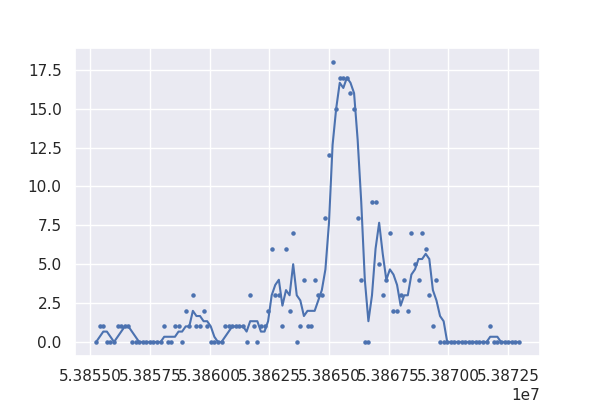

In [177]:
#ripple: [85.] timestamp 53855100 53873100
rip_85 = decoder_data2[(decoder_data2['bin_timestamp']>53855100) & (decoder_data2['bin_timestamp']<53873100)]
plt.figure(figsize=(6,4))
plt.scatter(rip_85['bin_timestamp'].values,rip_85['spike_count'].values,s=5)
plt.plot(spk_count_avg[0],spk_count_avg[1])

In [ ]:
# plot replay arms for real-time ripples
realtime_post_sum_summary[80:90]
#plt.hist(realtime_post_sum_summary['rt_max_arm'].values,bins=np.arange(0,100))
#realtime_post_sum_summary[realtime_post_sum_summary['rt_two_messages']>0]
realtime_post_sum_summary.shape
print(realtime_post_sum_summary.shape)
realtime_post_sum_summary[(realtime_post_sum_summary['rt_max_arm']>=1) & (realtime_post_sum_summary['rt_max_arm']<=8)]


In [ ]:
# DONT use: replaced with merge from other direction in next cell
# to match offline, add 1958987 to realtime timestamps
# shift for realtime ripple detection delay: subtract 2100
#45317550 45321300

# choose files
stim_message_file = stim_message_to_use
stim_lockout_file = stim_lockout2
decoder_data_file = decoder_data2

realtime_rips = stim_lockout_file[stim_lockout_file['lockout_state']==1]
print('realtime rips',realtime_rips.shape)
offline_rips = rips.reset_index()
print('offline rips',offline_rips.shape)
offline_rips['adj_timestamp'] = offline_rips['timestamp']
#realtime_rips['adj_timestamp'] = realtime_rips['timestamp']+1958987-2100
# remove 70 msec adjustment for real-time ripples for better matching
realtime_rips['adj_timestamp'] = realtime_rips['timestamp']+1958987

realtime_rips
# merge real-time and offline ripples 
# offline ripple start is 50-100 msec before real-time
# try a tolerance of 100 msec = 3000 timestamps
# one problem is that we are only matching to the start of the offline ripple - but long ripples will get split in 2
# so we really want to match over the whole interval of the offline ripple
merged_ripple_times = pd.merge_asof(offline_rips,realtime_rips,on='adj_timestamp',tolerance=9000,direction='forward')
matching_offline_rips = merged_ripple_times[merged_ripple_times['lockout_num']>0]

# now need to remove duplicates: where a single real-time ripple is matched to two offline rips
matching_offline_rips['RT_dups'] = matching_offline_rips['lockout_num'].diff()
matching_offline_rips = matching_offline_rips[matching_offline_rips['RT_dups']>0]
print(matching_offline_rips.shape)

In [768]:
# to match offline, add 1958987 to realtime timestamps
# shift for realtime ripple detection delay: subtract 2100
#45317550 45321300
# NOTE: here we are using real-time as left dataframe and offline as right, reversed from cell above
# this seems to work better!!

#timestamp offset:
# remy day 20, epoch 2: 1958987
# gus day 17 epoch 3: 88254102

# choose files
stim_lockout_file = stim_lockout5

realtime_rips = stim_lockout_file[stim_lockout_file['lockout_state']==1]
print('realtime rips',realtime_rips.shape)
offline_rips = rips.reset_index()
print('offline rips',offline_rips.shape)
offline_rips['adj_timestamp'] = offline_rips['timestamp']
#realtime_rips['adj_timestamp'] = realtime_rips['timestamp']+1958987-2100
# remove 70 msec adjustment for real-time ripples for better matching
realtime_rips['adj_timestamp'] = realtime_rips['timestamp']+1958987

realtime_rips
# merge real-time and offline ripples 
# offline ripple start is 50-100 msec before real-time
# try a tolerance of 300 msec = 9000 timestamps
# one problem is that we are only matching to the start of the offline ripple - but long ripples will get split in 2
# so we really want to match over the whole interval of the offline ripple
merged_ripple_times = pd.merge_asof(realtime_rips,offline_rips,on='adj_timestamp',tolerance=9000,direction='backward')
matching_offline_rips = merged_ripple_times[merged_ripple_times['lockout_num']>0]

# offline ripple duration
matching_offline_rips['off_dur'] = matching_offline_rips['endtime']-matching_offline_rips['starttime']

# note: still a few duplicates - this is coming from the original list of realtime ripples (stim_lockout)

# save mismatched ripples separately
nonmatching_offline_rips = matching_offline_rips[matching_offline_rips['day'].isnull()]
# now need to remove ripples that dont match
matching_offline_rips = matching_offline_rips[matching_offline_rips['day']>0]
print('matching before duplicates',matching_offline_rips.shape)

# 2 real-time rips match 1 offline rip
matching_offline_rips['two_RT_rips'] = matching_offline_rips['event'].diff()
# only keep rows where diff > 0 - this will remove double matches, specifically the second real-time rip
#matching_offline_rips = matching_offline_rips[matching_offline_rips['two_RT_rips']>0]

print('matching',matching_offline_rips.shape)

realtime rips (3561, 7)
offline rips (1256, 7)
matching before duplicates (3061, 16)
matching (3061, 17)


In [276]:
# find offline ripples with no real-time match
all_offline_rips = rips.copy()
all_offline_rips = all_offline_rips.reset_index()
merged_rips_2 = all_offline_rips.merge(matching_offline_rips,on='event',how='outer')
merged_rips_2
offline_rips_no_match = merged_rips_2[pd.isnull(merged_rips_2).any(axis=1)]

<IPython.core.display.Javascript object>


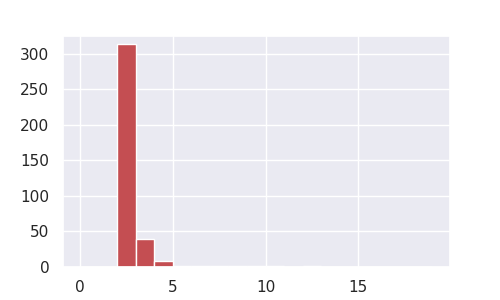

(0, 325)

In [284]:
plt.figure(figsize=(5,3))
plt.hist(offline_rips_no_match['maxthresh_x'].values,bins=np.arange(0,20,1),color='r')
#plt.hist(matching_offline_rips['maxthresh'].values,bins=np.arange(0,20,1),color='k')
plt.ylim(0,325)

In [ ]:
matching_offline_rips

<IPython.core.display.Javascript object>


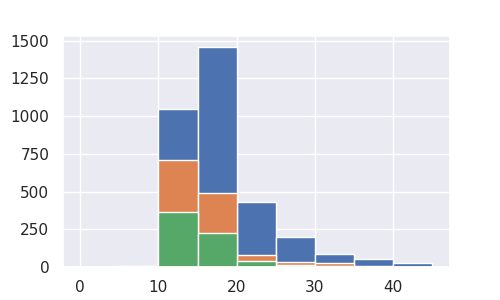

(array([  0.,   3., 364., 223.,  42.,  11.,   8.,   2.,   1.]),
 array([ 0,  5, 10, 15, 20, 25, 30, 35, 40, 45]),
 <a list of 9 Patch objects>)

In [25]:
%matplotlib notebook
plt.figure(figsize=(5,3))
plt.hist(stim_message1['delay'].values,bins=np.arange(0,50,5),alpha=1)
plt.hist(stim_message2['delay'].values,bins=np.arange(0,50,5),alpha=1)
plt.hist(stim_message['delay'].values,bins=np.arange(0,50,5),alpha=1)

<IPython.core.display.Javascript object>


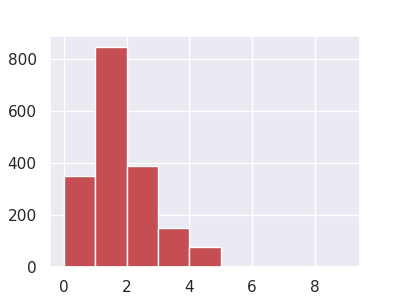

(array([350., 847., 389., 149.,  76.,   0.,   0.,   0.,   0.]),
 array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 <a list of 9 Patch objects>)

In [339]:
# looking at velocity of matching vs non-matching ripples
# result: non-matching ripples have much higher velocity - supports idea of theta power bleed through
matching_offline_rips
nonmatching_offline_rips
plt.figure(figsize=(4,3))
plt.hist(nonmatching_offline_rips['time'].values,bins=np.arange(0,10),color='r')
#plt.hist(matching_offline_rips['time'].values,bins=np.arange(0,10),color='k')
#plt.ylim(0,525)

<IPython.core.display.Javascript object>


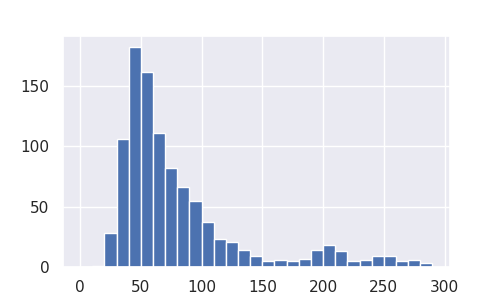

(array([  0.,   1.,  28., 106., 182., 161., 111.,  82.,  66.,  55.,  37.,
         23.,  21.,  14.,   9.,   5.,   6.,   5.,   7.,  14.,  18.,  13.,
          5.,   6.,   9.,   9.,   5.,   6.,   3.]),
 array([  0,  10,  20,  30,  40,  50,  60,  70,  80,  90, 100, 110, 120,
        130, 140, 150, 160, 170, 180, 190, 200, 210, 220, 230, 240, 250,
        260, 270, 280, 290]),
 <a list of 29 Patch objects>)

In [104]:
# plot ripple detection delay for matching rips
plt.figure(figsize=(5,3))
plt.hist((matching_offline_rips['adj_timestamp'].values-matching_offline_rips['timestamp_y'].values)/30,bins=np.arange(0,300,10))
         

<IPython.core.display.Javascript object>


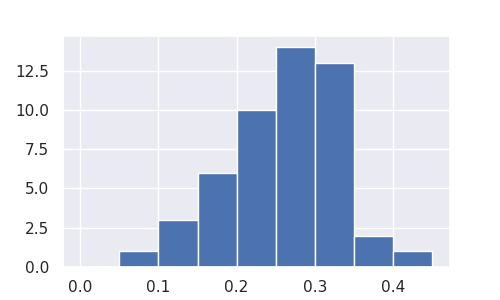

(array([ 0.,  1.,  3.,  6., 10., 14., 13.,  2.,  1.]),
 array([0.  , 0.05, 0.1 , 0.15, 0.2 , 0.25, 0.3 , 0.35, 0.4 , 0.45]),
 <a list of 9 Patch objects>)

In [422]:
# duration of offline ripples
matching_offline_rips['dup_offline'] = matching_offline_rips['event'].diff()
offline_dup_ripples = matching_offline_rips[matching_offline_rips['dup_offline']==0]
plt.figure(figsize=(5,3))
plt.hist(offline_dup_ripples['off_dur'].values,bins=np.arange(0,0.5,.05))

<IPython.core.display.Javascript object>


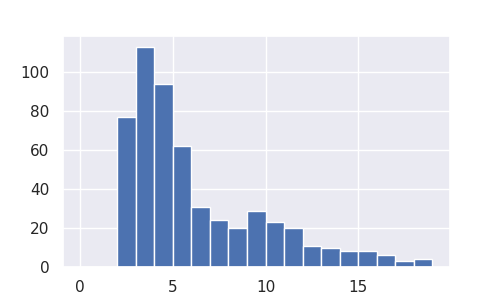

(array([  0.,   0.,  77., 113.,  94.,  62.,  31.,  24.,  20.,  29.,  23.,
         20.,  11.,  10.,   8.,   8.,   6.,   3.,   4.]),
 array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19]),
 <a list of 19 Patch objects>)

In [427]:
# duration of offline ripples
matching_offline_rips['dup_offline'] = matching_offline_rips['event'].diff()
offline_dup_ripples = matching_offline_rips[matching_offline_rips['dup_offline']>0]
offline_dup_ripples
plt.figure(figsize=(5,3))
#duration of offline
#plt.hist(offline_dup_ripples['off_dur'].values,bins=np.arange(0,0.5,.05))
#size of offline
plt.hist(offline_dup_ripples['maxthresh'].values,bins=np.arange(0,20))


<IPython.core.display.Javascript object>


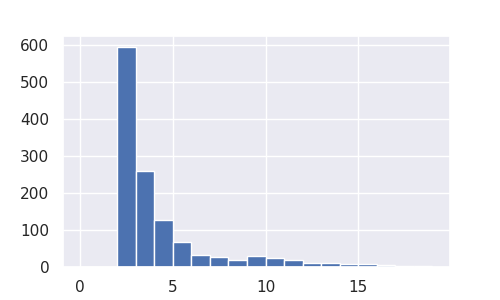

(array([  0.,   0., 595., 259., 128.,  67.,  32.,  27.,  20.,  29.,  23.,
         20.,  12.,  10.,   8.,   9.,   6.,   3.,   4.]),
 array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19]),
 <a list of 19 Patch objects>)

In [428]:
plt.figure(figsize=(5,3))
#duration of offline
#plt.hist(offline_dup_ripples['off_dur'].values,bins=np.arange(0,0.5,.05))
#size of offline
plt.hist(rips['maxthresh'].values,bins=np.arange(0,20))

In [ ]:
# time between ripple starts offline
# conclusion: 150 ripples: starttime difference is less than 200 msec (12%)

rips_check = rips.copy()
rips_check['rip_space'] = rips_check['starttime'].diff()
rips_check
plt.figure(figsize=(5,3))
plt.hist(rips_check['rip_space'].values,bins=np.arange(0,20,.1))

In [ ]:
# check for duplicates or missing ripples
matching_offline_rips[0:10]
plt.figure(figsize=(5,3))
plt.hist(matching_offline_rips['lockout_num'].diff().values,bins=np.arange(0,10))

In [772]:
realtime_rips_plot.shape
stim_message5.shape

(1186, 24)

<IPython.core.display.Javascript object>


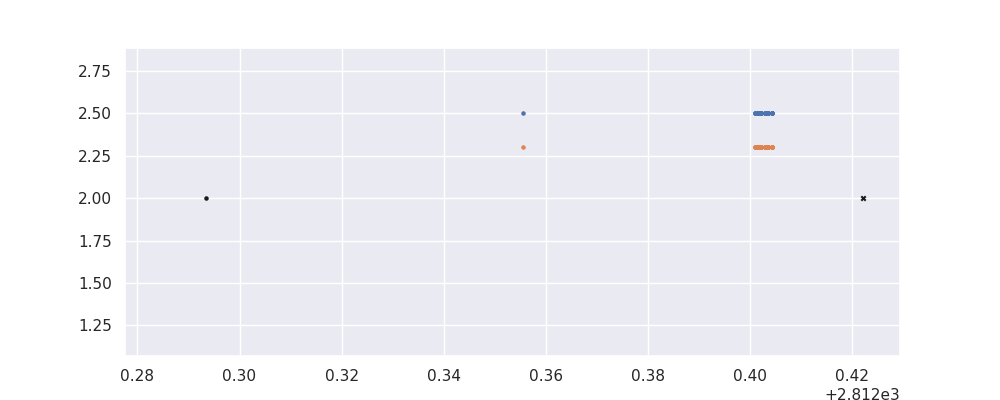

(1, 3)

In [771]:
# plot realtime and offline ripple starts
#matching_offline_rips_3k = matching_offline_rips.copy()
#matching_offline_rips_3k_fwd = matching_offline_rips.copy()
#matching_offline_rips_9k_fwd = matching_offline_rips.copy()

off_rips_range = rips.copy()
off_rips_range['end_timestamp'] = off_rips_range['timestamp'] + ((off_rips_range['endtime'] - off_rips_range['starttime'])*30000)
off_rips_range

stim_lockout_file = stim_lockout5
realtime_rips_plot = stim_lockout_file[stim_lockout_file['lockout_state']==1]

plt.figure(figsize=(10,4))
plt.scatter(off_rips_range['timestamp'].values/30000,np.repeat(2, 1256),s=5,c='k')
plt.scatter(off_rips_range['end_timestamp'].values/30000,np.repeat(2, 1256),s=10,c='k',marker='x')
plt.scatter((realtime_rips_plot['timestamp'].values+1958987)/30000,np.repeat(2.5, 3561),s=5)
#plt.scatter((matching_offline_rips_3k['adj_timestamp'].values)/30000,np.repeat(2.45, 547),s=5)
#plt.scatter((matching_offline_rips_3k_fwd['adj_timestamp'].values)/30000,np.repeat(2.4, 408),s=5)
#plt.scatter((matching_offline_rips_9k_fwd['adj_timestamp'].values)/30000,np.repeat(2.35, 547),s=5)
plt.scatter((matching_offline_rips['adj_timestamp'].values)/30000,np.repeat(2.3, 3061),s=5)

plt.ylim([1,3])

<IPython.core.display.Javascript object>


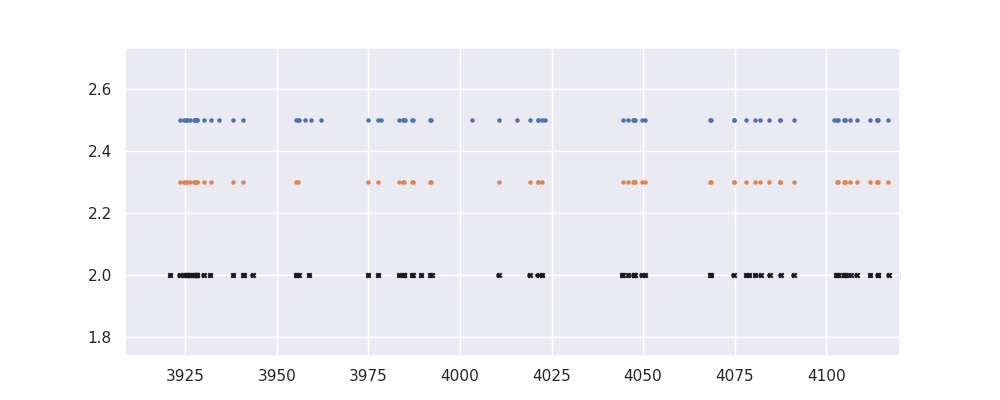

(1, 3)

In [31]:
# plot realtime and offline ripple starts
# 10 lfp tetrodes, sd = 4, 4 tets above threshold
#matching_offline_rips_3k = matching_offline_rips.copy()
#matching_offline_rips_3k_fwd = matching_offline_rips.copy()
#matching_offline_rips_9k_fwd = matching_offline_rips.copy()

off_rips_range = rips.copy()
off_rips_range['end_timestamp'] = off_rips_range['timestamp'] + ((off_rips_range['endtime'] - off_rips_range['starttime'])*30000)
off_rips_range

stim_lockout_file = stim_lockout2
realtime_rips_plot = stim_lockout_file[stim_lockout_file['lockout_state']==1]

plt.figure(figsize=(10,4))
plt.scatter(off_rips_range['timestamp'].values/30000,np.repeat(2, 1256),s=5,c='k')
plt.scatter(off_rips_range['end_timestamp'].values/30000,np.repeat(2, 1256),s=10,c='k',marker='x')
plt.scatter((realtime_rips_plot['timestamp'].values+1958987)/30000,np.repeat(2.5, 1309),s=5)
#plt.scatter((matching_offline_rips_3k['adj_timestamp'].values)/30000,np.repeat(2.45, 547),s=5)
#plt.scatter((matching_offline_rips_3k_fwd['adj_timestamp'].values)/30000,np.repeat(2.4, 408),s=5)
#plt.scatter((matching_offline_rips_9k_fwd['adj_timestamp'].values)/30000,np.repeat(2.35, 547),s=5)
plt.scatter((matching_offline_rips['adj_timestamp'].values)/30000,np.repeat(2.3, 1016),s=5)

plt.ylim([1,3])

In [69]:
#rips_test = rips.copy()
#rips_test['end_timestamp'] = rips_test['timestamp'] + ((rips_test['endtime'] - rips_test['starttime'])*30000)
#rips_test
matching_offline_rips

,rec_ind,timestamp_x,time,lockout_num,lockout_state,tets_above_thresh,big_rip_message_sent,adj_timestamp,day,epoch,event,timestamp_y,starttime,endtime,maxthresh,off_dur,two_RT_rips
12,38829,43858600,0.472010,12,1,4,0,45817587,20.0,2.0,65.0,45816504.0,1527.216800,1527.259467,3.036746,0.042667,NaN
13,39122,43895200,0.391922,13,1,4,0,45854187,20.0,2.0,66.0,45852404.0,1528.413467,1528.517467,6.582024,0.104000,1.0
14,39869,43977500,0.334504,14,1,4,0,45936487,20.0,2.0,68.0,45935224.0,1531.174133,1531.238800,2.526008,0.064667,2.0
16,40924,44082540,1.171463,16,1,4,0,46041527,20.0,2.0,69.0,46038044.0,1534.601467,1534.742133,3.670240,0.140667,1.0
19,49059,44807880,1.114918,19,1,4,0,46766867,20.0,2.0,82.0,46763124.0,1558.770800,1558.888133,3.029981,0.117333,13.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1301,1129684,161135920,0.746357,1301,1,4,0,163094907,20.0,2.0,2242.0,163088644.0,5436.288133,5436.611467,13.474237,0.323333,0.0
1302,1134497,161591380,1.255782,1302,1,4,0,163550367,20.0,2.0,2255.0,163548024.0,5451.600800,5451.734800,5.551768,0.134000,13.0
1303,1136460,161837140,0.274201,1303,1,4,0,163796127,20.0,2.0,2258.0,163794004.0,5459.800133,5459.888133,4.067768,0.088000,3.0
1307,1140811,162296240,1.007174,1307,1,4,0,164255227,20.0,2.0,2267.0,164253304.0,5475.110133,5475.174800,2.896035,0.064667,9.0


<IPython.core.display.Javascript object>


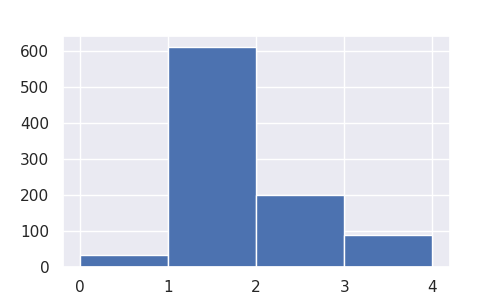

(array([ 34., 612., 199.,  89.]),
 array([0, 1, 2, 3, 4]),
 <a list of 4 Patch objects>)

In [51]:
# shows number of realtime ripple duplicates
# this comes from stim_lockout record
# look at value of 0 bin in histogram (9)
plt.figure(figsize=(5,3))
plt.hist(matching_offline_rips['lockout_num'].diff().values,bins=np.arange(0,5))

<IPython.core.display.Javascript object>


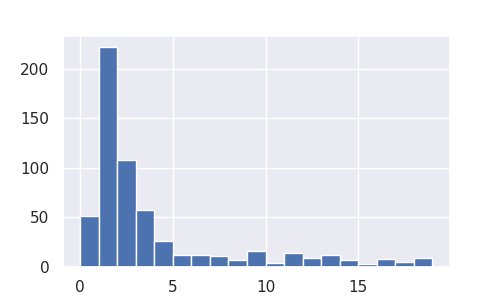

(array([ 51., 222., 108.,  58.,  26.,  12.,  12.,  11.,   7.,  16.,   4.,
         14.,   9.,  12.,   7.,   3.,   8.,   5.,   9.]),
 array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19]),
 <a list of 19 Patch objects>)

In [417]:
# shows number of real-time ripples that match the same offline ripples
# these are long offline ripples
# look at value of 0 bin in histogram (51)
plt.figure(figsize=(5,3))
plt.hist(matching_offline_rips['event'].diff().values,bins=np.arange(0,20))

In [ ]:
posterior_offline.iloc[:,4:145]
post_sum_times.iloc[:,4:145]
posterior_to_plot
offline_rips_plot[-10:-4]
#merged_off_post_pos
# 20, 4: 1st posterior timestamp: 273380550, last: 412268550
posteriors6

In [815]:
# running sum version for offline ripples - 50 msec running sum means 11 bins
# offline posteriors, 150 uV threshold
#offline arm ends 8, 25, 42, 59, 77, 94, 111, 128, 145 
# old linearization
#arm_coords = [[0,8],[13,25],[30,42],[47,59],[65,77],[82,94],[99,111],[116,128],[133,145]]
# new linearization
arm_coords = [[0,8],[13,25],[29,41],[45,57],[62,74],[78,90],[94,106],[111,123],[127,139]]

# max value for other outer arm
# there may be a problem: there is 1 ripple flagged with '98' when other_arm is 0.5 - should be 0
# okay this is fixed now, removed the rounding of posterior sum before doing the arm assignment
other_arm_thresh = 0.2

#posterior sum threshold for primary arm
post_sum_thresh = 0.5

# if we want to check all offline ripples
offline_rips_plot = rips.copy()
offline_rips_plot = offline_rips_plot.reset_index()

summarize_all_rips_offline = True

# now need to plot offline ripples that are mismatched

# set which posteriors file to use
posterior_offline = posteriors7.reset_index()
offline_pos = binned_linear_pos.reset_index()
merged_off_post_pos = pd.merge_asof(posterior_offline,offline_pos,on='timestamp',direction='nearest')
#offline_posterior_sum_all = np.zeros((len(matching_offline_rips),14))
# for all offline rips
offline_posterior_sum_all = np.zeros((len(offline_rips_plot),16))

# number of bins for sliding window sum
sliding_window = 11

# length for whole ripple sum: all rips longer than this (previously 12, set to 115 to cover all ripples)
whole_ripple_sum_len = 115

# updated for new matching_offline_rips merge timestamp_x -> timestamp_y
# for some reason, final offline rip timestamp is after the decoder has ended - odd
# to deal with this set slice to [:-1]
#for index, rip_timestamp in enumerate(matching_offline_rips['timestamp_y'][:-1]):

# ripple range: Remy day 20, epoch 2 18:-1
# ripple range: Remy day 20, epoch 4 20:-4
# ripple range: Remy day 21, epoch 2: 13:

# to plot all offline rips
for index, rip_timestamp in enumerate(offline_rips_plot['timestamp'][13:]):
    posterior_sum_array = np.zeros((sliding_window,9))
    short_ripple = False
    # to plot all ripples
    if summarize_all_rips_offline:
    # to plotting mis-match replays
    #if matching_offline_rips['lockout_num'][index:index+1].values in non_matching['realtime_rip'].values:
        #print(matching_offline_rips['lockout_num'][index:index+1].values)
        #print(rip_timestamp-30*300,rip_timestamp+30*300,index)
        
        posterior_to_plot = merged_off_post_pos[(merged_off_post_pos['timestamp'] > rip_timestamp-30*300) & 
                                            (merged_off_post_pos['timestamp'] < rip_timestamp+30*300)]

        # original: real-time data
        realtime_ripple_num = matching_offline_rips['lockout_num'][index:index+1].values
        # for plotting offline rips only
        #realtime_ripple_num = 1
        
        ripple_num_index = int(len(posterior_to_plot)*0.55)
        ripple_num = posterior_to_plot[ripple_num_index:ripple_num_index+1]['ripple_grp'].values
        real_pos = posterior_to_plot[ripple_num_index:ripple_num_index+1]['linpos_flat'].values
    
        # calculate posterior sum during ripple
        # we need to only take out the time when ripple_grp matches ripple_grp at the middle of the plotting bin
    
        #post_sum_times = posterior_to_plot[posterior_to_plot['ripple_grp'] > 0]
        post_sum_times = posterior_to_plot[posterior_to_plot['ripple_grp'] == ripple_num[0]]
        ripple_length = post_sum_times.shape[0]
        #if ripple_length < 12:
        #    print(index,ripple_length)
        
        # if ripple is less than 12 bins: sum whole ripple
        # added 1 to end of each segment - makes sum across arms correct
        if ripple_length < whole_ripple_sum_len:
            # sum each arm over whole ripple
            post_sum_ripple = np.zeros((ripple_length,9))
            for i in np.arange(0,ripple_length):
                if i == 0:
                    for j in np.arange(0,len(arm_coords),1):
                        post_sum_ripple[i,j] = post_sum_times.iloc[i,4:145].values[arm_coords[j][0]:arm_coords[j][1]+1].sum()
                else:
                    for j in np.arange(0,len(arm_coords),1):
                        post_sum_ripple[i,j] = post_sum_ripple[i-1,j] + post_sum_times.iloc[i,4:145].values[arm_coords[j][0]:arm_coords[j][1]+1].sum()
            
            # normalize sum of whole ripple - this is the final row
            # need to change decimal to 4 here!
            short_ripple = True
            post_sum_ripple[i] = post_sum_ripple[i]/post_sum_ripple[i].sum()
            posterior_sum = np.around(post_sum_ripple[-1:],decimals=4)
            posterior_sum = posterior_sum[0]
    
            # new version
            # other arm: make this a settable paramater (e.g. 0.2 or 0.1)
            # new code to remove manual check for each arm - working
            if len(np.argwhere(posterior_sum>=post_sum_thresh)) and np.argwhere(posterior_sum>=post_sum_thresh)[0][0] == 0:
                arm_max = 0
            elif len(np.argwhere(posterior_sum>=post_sum_thresh)):
                posterior_sum_arms = posterior_sum[1:]
                arm_max = np.argwhere(posterior_sum_arms>=0.5)[0][0] + 1
                other_arms_sum = np.delete(posterior_sum_arms, arm_max - 1)
                if len(np.argwhere(other_arms_sum>=other_arm_thresh)):
                    #print('other_arm')
                    arm_max = 98
            else:
                arm_max = 99
                
        # if ripple 12 or more bins: use sliding window sum
        else:
            print('long_ripple',ripple_length)
            stop_post_sum = False
            post_sum_ripple = np.zeros((ripple_length,9))
            for i in np.arange(0,ripple_length):
                # first sum across arms
                for j in np.arange(0,len(arm_coords),1):
                    post_sum_ripple[i,j] = post_sum_times.iloc[i,4:145].values[arm_coords[j][0]:arm_coords[j][1]+1].sum()
                # then fill in sliding window array
                posterior_sum_array[np.mod(i,sliding_window),:] = post_sum_ripple[i]
                sum_array_sum = np.sum(posterior_sum_array,axis=0)
                norm_posterior_arm_sum = sum_array_sum/sliding_window
                if i > 10 and not stop_post_sum:
                    posterior_sum = np.around(norm_posterior_arm_sum,decimals=4)
                    #print(posterior_sum)
                    #posterior_sum = posterior_sum[0]
                    if len(np.argwhere(posterior_sum>=0.5)):
                        arm_max = np.argwhere(posterior_sum>=0.5)[0][0]
                    else:
                        arm_max = 99
                    if arm_max > 0 and arm_max < 9:
                        stop_post_sum = True
                        #print('post sum meets criteria. bin',i,'arm',arm_max)
        
        ripple_times = posterior_to_plot.index[posterior_to_plot['ripple_grp'] > 0].tolist()

        #posterior_offline1 = posterior_to_plot.drop(['day_x','epoch_x','timestamp','time_x','num_spikes','dec_bin',
        #                                         'ripple_grp','day_y','epoch_y','time_y','linpos_flat',
        #                                         'linvel_flat'], axis=1)
        posterior_offline1 = posterior_to_plot.iloc[:,4:145]

        posterior_offline2 = posterior_offline1.fillna(0)
        post_heatmap = posterior_offline2.transpose()
        post_heatmap = post_heatmap.iloc[::-1]

        #posterior_sum = np.around(post_sum_ripple[-1:],decimals=1)
        #posterior_sum = posterior_sum[0]
    
        #if len(np.argwhere(posterior_sum>=0.5)):
        #    arm_max = np.argwhere(posterior_sum>=0.5)[0][0]
        #else:
        #    arm_max = 99 

        # fill in current row of posterior sum array - seems to work
        offline_posterior_sum_all[index,0] = ripple_num
        offline_posterior_sum_all[index,1] = realtime_ripple_num
        offline_posterior_sum_all[index,2] = arm_max
        offline_posterior_sum_all[index,3] = posterior_sum[0]
        offline_posterior_sum_all[index,4] = posterior_sum[1]
        offline_posterior_sum_all[index,5] = posterior_sum[2]
        offline_posterior_sum_all[index,6] = posterior_sum[3]
        offline_posterior_sum_all[index,7] = posterior_sum[4]
        offline_posterior_sum_all[index,8] = posterior_sum[5]
        offline_posterior_sum_all[index,9] = posterior_sum[6]
        offline_posterior_sum_all[index,10] = posterior_sum[7]
        offline_posterior_sum_all[index,11] = posterior_sum[8]
        offline_posterior_sum_all[index,12] = ripple_length
        offline_posterior_sum_all[index,13] = short_ripple
        offline_posterior_sum_all[index,14] = real_pos
        offline_posterior_sum_all[index,15] = post_sum_times['timestamp'].values[0:1][0]
                                     
        #plt.figure(figsize=(8,4))
        #plt.title(f'Off rip {ripple_num}. RT rip {realtime_ripple_num} Arm {arm_max} {posterior_sum} Len {ripple_length}')
        #ax = (sns.heatmap(post_heatmap,vmin=0, vmax=0.7))
        #ax.hlines([139-10,139-27,139-43,139-59,139-76,139-92,139-108,139-125], lw=2, color='w',*ax.get_xlim())
        #ax.scatter(np.arange(0,posterior_to_plot.shape[0]),139-posterior_to_plot['linpos_flat'].values,s=2,alpha=1,color='cyan')
        #ax.vlines([ripple_times-posterior_to_plot.index[0]],lw=1,color='w',alpha=0.25,*ax.get_ylim())
    
        # final step: save the figure
        #plt.savefig(f'/stelmo/mcoulter/posterior_plots_by_ripple/remy_20_2_offline_2_20_rip_nonmatching_{ripple_num}_real_rip_{realtime_ripple_num}_timestamp_{rip_timestamp}.jpg')

# convert offline_posterior_sum_all array to pandas
# only run this first time through - not with non-matching

off_post_sum_summary = pd.DataFrame(data=offline_posterior_sum_all,columns=('offline_rip','realtime_rip',
                                                                            'off_max_arm','box','arm1','arm2',
                                                                            'arm3','arm4','arm5','arm6',
                                                                            'arm7','arm8',
                                                                            'rip_length','short_rip','real_pos',
                                                                           'rip_start_off'))

off_post_sum_summary.shape

(1485, 16)

In [814]:
ripple_times[0]
post_sum_times['timestamp'].values[0:1][0]

206858400

In [816]:
# summary counts for replay assignment
pd.set_option('display.max_rows', 12)
off_post_sum_summary_count = off_post_sum_summary.copy()
off_post_sum_summary_count = off_post_sum_summary_count[off_post_sum_summary_count['offline_rip']>0]
off_post_sum_summary_count = off_post_sum_summary_count[off_post_sum_summary_count['real_pos']<10]
print(off_post_sum_summary_count.shape)
off_post_sum_summary_count
off_post_sum_summary_count['off_max_arm'].value_counts()

(1405, 16)


0.0     797
99.0    383
1.0      54
6.0      39
5.0      33
98.0     30
3.0      26
7.0      15
4.0      13
8.0      11
2.0       4
Name: off_max_arm, dtype: int64

In [817]:
# save replay assignments for whole session, remy 21, 2
#off_post_sum_summary_whole = off_post_sum_summary.copy()
off_post_sum_summary_partial = off_post_sum_summary.copy()

In [133]:
#offline
#arm_coords = [[0,8],[13,25],[29,41],[45,57],[62,74],[78,90],[94,106],[111,123],[127,139]]
#realtime
arm_coords =  [[0,8],[13,24],[29,40],[45,56],[61,72],[77,88],[93,104],[109,120],[125,136]]
j = 8
posterior_to_plot.iloc[0,25:162].values[arm_coords[j][0]:arm_coords[j][1]+1]

array([0.00248573, 0.00242326, 0.00241077, 0.0024754 , 0.00251324,
       0.00254519, 0.00258733, 0.00262513, 0.00260722, 0.00255939,
       0.00252809, 0.00253497])

In [167]:
post_sum_times.iloc[0,4:145].values
posterior_to_plot.iloc[0,25:162].values
if np.all(posterior_sum[1:]<1):
    print('true')
else:
    print('false')
print(posterior_sum)
print(posterior_sum[8])

false
[0. 0. 0. 0. 0. 0. 1. 0. 0.]
0.0


In [ ]:
# plot histogram of offline replay arms
off_post_sum_summary
plt.figure(figsize=(5,3))
plt.hist(off_post_sum_summary['off_max_arm'].values,bins=np.arange(0,100))
plt.hist(off_post_sum_summary_2['off_max_arm'].values,bins=np.arange(0,100),alpha=0.5)
print(off_post_sum_summary.shape, off_post_sum_summary_2.shape)


In [710]:
# try using the offline running sum on the corresponding time in real-time decoder_data
# basically need to convert starttime and endtime to real-time timestamps and then use that as the ripple
# running sum version for offline ripples - 50 msec running sum means 11 bins

#timestamp offset:
# remy day 20, epoch 2: 1958987
# gus day 17 epoch 3: 88254102
# remy day 20, epoch 4: 10722379

# iloc to isolate posterior only
# 4-17 and before: iloc[i,24:161]
# 4-18 and later: iloc[i,25:162]

# max value for other outer arm
# there may be a problem: there is 1 ripple flagged with '98' when other_arm is 0.5 - should be 0
# okay this is fixed now, removed the rounding of posterior sum before doing the arm assignment
other_arm_thresh = 0.2

#posterior sum threshold for primary arm
post_sum_thresh = 0.5

# real-time arm coords
arm_coords =  [[0,8],[13,24],[29,40],[45,56],[61,72],[77,88],[93,104],[109,120],[125,136]]

# real-time timestamps for offline ripples
# remy 20, 2: timestamp shift: 1958987
# remy 20, 4: timestamp shift: 10722379
realtime_off_rips = rips.copy()
realtime_off_rips['start'] = (rips['starttime'].values*30000)-10722379
realtime_off_rips['end'] = (rips['endtime'].values*30000)-10722379
realtime_off_rips = realtime_off_rips.reset_index()

summarize_all_rips_offline = True

# now need to plot offline ripples that are mismatched

# set which decoder_data file to use
merged_off_post_pos = decoder_data3.copy()
offline_posterior_sum_all = np.zeros((len(realtime_off_rips),16))

# number of bins for sliding window sum
sliding_window = 11

# length for whole ripple sum: all rips longer than this (oringally: 12, new: 115)
whole_ripple_sum_len = 115

# updated for new matching_offline_rips merge timestamp_x -> timestamp_y
# for some reason, final offline rip timestamp is after the decoder has ended - odd
# remy 20, 2: need to start at row 18 to match decoder_data time, and end at -1
# remy 20, 4: 20:-4
for index, rip_timestamp in enumerate(realtime_off_rips['start'][20:-4]):
    adj_index = index+20
    posterior_sum_array = np.zeros((sliding_window,9))
    short_ripple = False
    # to plot all ripples
    if summarize_all_rips_offline:
    # to plotting mis-match replays
    #if matching_offline_rips['lockout_num'][index:index+1].values in non_matching['realtime_rip'].values:
        #print(matching_offline_rips['lockout_num'][index:index+1].values)
        #print(rip_timestamp-30*300,rip_timestamp+30*300,index)
        
        # increased length of posterior to plot because some spike ripple end are beyond 300
        posterior_to_plot = merged_off_post_pos[(merged_off_post_pos['bin_timestamp'] > rip_timestamp-30*300) & 
                                            (merged_off_post_pos['bin_timestamp'] < rip_timestamp+30*500)]
        #print(posterior_to_plot.shape)
        #realtime_ripple_num = matching_offline_rips['lockout_num'][index:index+1].values
        ripple_num_index = int(len(posterior_to_plot)*0.55)
        ripple_num = realtime_off_rips[adj_index:adj_index+1]['event'].values
        ripple_start = realtime_off_rips[adj_index:adj_index+1]['start'].values
        
        # regular ripple end
        #ripple_end = realtime_off_rips[adj_index:adj_index+1]['end'].values
        # with spike count end of ripple
        ripple_end = spike_count_all_summary[index:index+1]['new_end'].values
        # note: there was 1 ripple (index 1051) that did not get a new end
        #if index == 1051:
        #    ripple_end = ripple_end + 143964736 + 300
        #    print('bad ripple',ripple_end)
        
        real_pos = posterior_to_plot[ripple_num_index:ripple_num_index+1]['real_pos'].values
        #print(ripple_num,ripple_start,ripple_end,index,adj_index,ripple_end_spike)

        # calculate posterior sum during ripple
        # we need to only take out the time when ripple_grp matches ripple_grp at the middle of the plotting bin
    
        post_sum_times = posterior_to_plot[(posterior_to_plot['bin_timestamp'] > ripple_start[0]) & 
                                          (posterior_to_plot['bin_timestamp'] < ripple_end[0])]
        
        ripple_length = post_sum_times.shape[0]
        #print(post_sum_times.shape)
        #if ripple_length < 12:
        #    print(index,ripple_length)
        
        # if ripple is less than 12 bins: sum whole ripple
        # we can set this number to switch to whole ripple sum
        if ripple_length < whole_ripple_sum_len:
            # sum each arm over whole ripple
            post_sum_ripple = np.zeros((ripple_length,9))
            for i in np.arange(0,ripple_length):
                if i == 0:
                    for j in np.arange(0,len(arm_coords),1):
                        post_sum_ripple[i,j] = post_sum_times.iloc[i,25:162].values[arm_coords[j][0]:arm_coords[j][1]+1].sum()
                else:
                    for j in np.arange(0,len(arm_coords),1):
                        post_sum_ripple[i,j] = post_sum_ripple[i-1,j] + post_sum_times.iloc[i,25:162].values[arm_coords[j][0]:arm_coords[j][1]+1].sum()
            
            # normalize sum of whole ripple - this is the final row
            # don't round too much here, set decimal to 4
            short_ripple = True
            post_sum_ripple[i] = post_sum_ripple[i]/post_sum_ripple[i].sum()
            posterior_sum = np.around(post_sum_ripple[-1:],decimals=4)
            posterior_sum = posterior_sum[0]
    
            # new version
            # other arm: make this a settable paramater (e.g. 0.2 or 0.1)
            # new code to remove manual check for each arm - working
            if len(np.argwhere(posterior_sum>=post_sum_thresh)) and np.argwhere(posterior_sum>=post_sum_thresh)[0][0] == 0:
                arm_max = 0
            elif len(np.argwhere(posterior_sum>=post_sum_thresh)):
                posterior_sum_arms = posterior_sum[1:]
                arm_max = np.argwhere(posterior_sum_arms>=0.5)[0][0] + 1
                other_arms_sum = np.delete(posterior_sum_arms, arm_max - 1)
                if len(np.argwhere(other_arms_sum>=other_arm_thresh)):
                    #print('other_arm')
                    arm_max = 98
            else:
                arm_max = 99
          

        # if ripple 12 or more bins: use sliding window sum
        else:
            print('long_ripple',ripple_length)
            stop_post_sum = False
            post_sum_ripple = np.zeros((ripple_length,9))
            for i in np.arange(0,ripple_length):
                # first sum across arms
                for j in np.arange(0,len(arm_coords),1):
                    post_sum_ripple[i,j] = post_sum_times.iloc[i,25:162].values[arm_coords[j][0]:arm_coords[j][1]+1].sum()
                # then fill in sliding window array
                posterior_sum_array[np.mod(i,sliding_window),:] = post_sum_ripple[i]
                sum_array_sum = np.sum(posterior_sum_array,axis=0)
                norm_posterior_arm_sum = sum_array_sum/sliding_window
                if i > 10 and not stop_post_sum:
                    posterior_sum = np.around(norm_posterior_arm_sum,decimals=4)
                    #print(posterior_sum)
                    #posterior_sum = posterior_sum[0]
                    if len(np.argwhere(posterior_sum>=0.5)):
                        arm_max = np.argwhere(posterior_sum>=0.5)[0][0]
                    else:
                        arm_max = 99
                    if arm_max > 0 and arm_max < 9:
                        stop_post_sum = True
                        #print('post sum meets criteria. bin',i,'arm',arm_max)
        
        # how can we do ripple times for real-time without ripple_grp???
        #ripple_times = posterior_to_plot.index[posterior_to_plot['ripple_grp'] > 0].tolist()
        ripple_times = posterior_to_plot.index[(posterior_to_plot['bin_timestamp'] > ripple_start[0]) &
                                              (posterior_to_plot['bin_timestamp'] < ripple_end[0])].tolist()

        posterior_offline1 = posterior_to_plot.iloc[:,25:162]
        posterior_offline2 = posterior_offline1.fillna(0)
        post_heatmap = posterior_offline2.transpose()
        post_heatmap = post_heatmap.iloc[::-1]

        #posterior_sum = np.around(post_sum_ripple[-1:],decimals=1)
        #posterior_sum = posterior_sum[0]
    
        #if len(np.argwhere(posterior_sum>=0.5)):
        #    arm_max = np.argwhere(posterior_sum>=0.5)[0][0]
        #else:
        #    arm_max = 99 

        # can round posterior_sum more here
        # fill in current row of posterior sum array - seems to work
        offline_posterior_sum_all[index,0] = ripple_num
        offline_posterior_sum_all[index,1] = realtime_ripple_num
        offline_posterior_sum_all[index,2] = ripple_start
        offline_posterior_sum_all[index,3] = arm_max
        offline_posterior_sum_all[index,4] = posterior_sum[0]
        offline_posterior_sum_all[index,5] = posterior_sum[1]
        offline_posterior_sum_all[index,6] = posterior_sum[2]
        offline_posterior_sum_all[index,7] = posterior_sum[3]
        offline_posterior_sum_all[index,8] = posterior_sum[4]
        offline_posterior_sum_all[index,9] = posterior_sum[5]
        offline_posterior_sum_all[index,10] = posterior_sum[6]
        offline_posterior_sum_all[index,11] = posterior_sum[7]
        offline_posterior_sum_all[index,12] = posterior_sum[8]
        offline_posterior_sum_all[index,13] = ripple_length
        offline_posterior_sum_all[index,14] = short_ripple
        offline_posterior_sum_all[index,15] = real_pos

        #plt.figure(figsize=(8,4))
        #plt.title(f'Off rip {ripple_num}. Arm {arm_max} {posterior_sum} Len {ripple_length}')
        #ax = (sns.heatmap(post_heatmap,vmin=0, vmax=0.7))
        #ax.hlines([136-10,136-27,136-43,136-59,136-74,136-90,136-106,136-122], lw=2, color='w',*ax.get_xlim())
        #ax.scatter(np.arange(0,posterior_to_plot.shape[0]),136-posterior_to_plot['real_pos'].values,s=2,alpha=1,color='cyan')
        #ax.vlines([ripple_times-posterior_to_plot.index[0]],lw=1,color='w',alpha=0.25,*ax.get_ylim())
    
        # final step: save the figure
        #plt.savefig(f'/stelmo/mcoulter/posterior_plots_by_ripple/remy_20_2_offline_2_20_rip_nonmatching_{ripple_num}_real_rip_{realtime_ripple_num}_timestamp_{rip_timestamp}.jpg')

# convert offline_posterior_sum_all array to pandas
# only run this first time through - not with non-matching

off_RT_post_sum_summary = pd.DataFrame(data=offline_posterior_sum_all,columns=('offline_rip','realtime_rip',
                                                                               'ripple_start','off_max_arm',
                                                                                'box','arm1','arm2',
                                                                                'arm3','arm4','arm5','arm6',
                                                                                'arm7','arm8','rip_length',
                                                                                'short_rip','real_pos'))

off_RT_post_sum_summary.shape

(1265, 16)

In [727]:
np.zeros((9,))
#np.zeros((1,9))
test_thresh = 1.5
test_array = np.asarray((3,3,3,1,0))
np.count_nonzero(test_array < test_thresh)
#print(test_array)
test_array[1:]
posterior_sum_test = np.asarray((0,0,0.1,0,0,0,0,0.9,0))
posterior_sum_arms = posterior_sum_test[1:]
print(np.argwhere(posterior_sum_arms>=0.5)[0][0] + 1)
print(np.argwhere(posterior_sum_test > 0.5))

7
[[7]]


In [ ]:
# arm sum with other arm cut-off before code was simplified
# original
            #if len(np.argwhere(posterior_sum>=0.5)):
            #    arm_max = np.argwhere(posterior_sum>=0.5)[0][0]
            # new version
            # this is where we add logic about value in non-max arm
            # make this a settable paramater (e.g. 0.2 or 0.1)            
            # old version with other arm
            if len(np.argwhere(posterior_sum>=post_sum_thresh)) and np.argwhere(posterior_sum>=post_sum_thresh)[0][0] == 0:
                arm_max = 0
            elif len(np.argwhere(posterior_sum>=post_sum_thresh)) and np.argwhere(posterior_sum>=post_sum_thresh)[0][0] == 1 and np.all(posterior_sum[2:]<other_arm_thresh):
                arm_max = 1
            elif len(np.argwhere(posterior_sum>=post_sum_thresh)) and np.argwhere(posterior_sum>=post_sum_thresh)[0][0] == 2 and np.all(posterior_sum[3:]<other_arm_thresh) and posterior_sum[1]<other_arm_thresh:
                arm_max = 2                
            elif len(np.argwhere(posterior_sum>=post_sum_thresh)) and np.argwhere(posterior_sum>=post_sum_thresh)[0][0] == 3 and np.all(posterior_sum[4:]<other_arm_thresh) and np.all(posterior_sum[1:3]<other_arm_thresh):
                arm_max = 3
            elif len(np.argwhere(posterior_sum>=post_sum_thresh)) and np.argwhere(posterior_sum>=post_sum_thresh)[0][0] == 4 and np.all(posterior_sum[5:]<other_arm_thresh) and np.all(posterior_sum[1:4]<other_arm_thresh):
                arm_max = 4
            elif len(np.argwhere(posterior_sum>=post_sum_thresh)) and np.argwhere(posterior_sum>=post_sum_thresh)[0][0] == 5 and np.all(posterior_sum[6:]<other_arm_thresh) and np.all(posterior_sum[1:5]<other_arm_thresh):
                arm_max = 5
            elif len(np.argwhere(posterior_sum>=post_sum_thresh)) and np.argwhere(posterior_sum>=post_sum_thresh)[0][0] == 6 and np.all(posterior_sum[7:]<other_arm_thresh) and np.all(posterior_sum[1:6]<other_arm_thresh):
                arm_max = 6
            elif len(np.argwhere(posterior_sum>=post_sum_thresh)) and np.argwhere(posterior_sum>=post_sum_thresh)[0][0] == 7 and np.all(posterior_sum[8]<other_arm_thresh) and np.all(posterior_sum[1:7]<other_arm_thresh):
                arm_max = 7
            elif len(np.argwhere(posterior_sum>=post_sum_thresh)) and np.argwhere(posterior_sum>=post_sum_thresh)[0][0] == 8 and np.all(posterior_sum[1:8]<other_arm_thresh):
                arm_max = 8
            elif len(np.argwhere(posterior_sum>=post_sum_thresh)):
                arm_max = 98
            else:
                arm_max = 99  

In [ ]:
# code for non-manual outer arm filter
print(posterior_sum)
print(posterior_sum_arms)
print(arm_max)
print(other_arms_sum)
print(np.argwhere(posterior_sum_arms>=0.5)[0][0] + 1)
np.delete(posterior_sum_arms, arm_max - 1)

posterior_sum
posterior_sum_arms = posterior_sum[1:]
posterior_sum_arms
arm_max = np.argwhere(posterior_sum_arms>=0.5)[0][0]
other_arms_sum = np.delete(posterior_sum_arms, arm_max)
other_arms_sum
if np.argwhere(other_arms_sum>=0.008):
    print('other_arm')

In [713]:
# hmmm with the simplified code, lots of replay added to box and got lost from other arms
# see if there is some shift or other problem in the new code above
# okay fixed, now check assignment with 98

pd.set_option('display.max_rows', 12)
# summary counts for replay assignment
off_RT_post_sum_summary_count = off_RT_post_sum_summary.copy()
off_RT_post_sum_summary_count = off_RT_post_sum_summary_count[off_RT_post_sum_summary_count['offline_rip']>0]
print(off_RT_post_sum_summary_count.shape)
off_RT_post_sum_summary_count = off_RT_post_sum_summary_count[off_RT_post_sum_summary_count['real_pos']<10]
print(off_RT_post_sum_summary_count.shape)
off_RT_post_sum_summary_count
print(off_RT_post_sum_summary_count.shape)
off_RT_post_sum_summary_count['off_max_arm'].value_counts()

(1241, 16)
(1180, 16)
(1180, 16)


0.0     593
99.0    392
1.0      44
7.0      38
6.0      25
2.0      25
98.0     21
8.0      15
3.0      11
4.0      10
5.0       6
Name: off_max_arm, dtype: int64

In [ ]:
pd.set_option('display.max_rows', 40)
off_RT_post_sum_summary[(off_RT_post_sum_summary['off_max_arm']==98) &
                       (off_RT_post_sum_summary['real_pos']<10)]

In [ ]:
# rip 1100: i think should be arm 98 not arm 1
pd.set_option('display.max_rows', 40)
off_RT_post_sum_summary[(off_RT_post_sum_summary['off_max_arm']==98) &
                       (off_RT_post_sum_summary['real_pos']<10)]

In [818]:
# comparing offline and real-time decoding of offline rips
# join two dataframes
# remy 21,2, whole and partial - use those dataframes
# real-time offline: off_RT_post_sum_summary
replay_combined_offline = pd.merge(off_post_sum_summary_whole, off_post_sum_summary_partial, how='inner',
                                   left_index=True, right_index=True,suffixes=('_off', '_RT'))
replay_combined_offline['rip_diff'] = replay_combined_offline['offline_rip_off'].values - replay_combined_offline['offline_rip_RT'].values
replay_combined_offline = replay_combined_offline[replay_combined_offline['offline_rip_off']>0]
print(replay_combined_offline.shape)
# remove ripples in outer arms
replay_combined_offline = replay_combined_offline[replay_combined_offline['real_pos_RT']<10]
print(replay_combined_offline.shape)

# check to make sure all rows match on ripple number
# both printed shapes below should be the same - to show all ripples match
print(replay_combined_offline[replay_combined_offline['rip_diff']==0].shape)

(1469, 32)
(1405, 32)
(1405, 32)


In [819]:
off_post_sum_summary_partial[1200:1210]

,offline_rip,realtime_rip,off_max_arm,box,arm1,arm2,arm3,arm4,arm5,arm6,arm7,arm8,rip_length,short_rip,real_pos,rip_start_off
1200,2408.0,1514.0,0.0,0.9557,0.0039,0.0039,0.0133,0.0037,0.0058,0.0058,0.0049,0.0030,35.0,1.0,3.0,180041250.0
1201,2409.0,1515.0,99.0,0.2763,0.0066,0.0065,0.2723,0.3179,0.0309,0.0696,0.0121,0.0076,22.0,1.0,3.0,180047700.0
1202,2410.0,1516.0,98.0,0.0816,0.0187,0.0268,0.2066,0.6062,0.0084,0.0209,0.0127,0.0182,23.0,1.0,3.0,180051750.0
1203,2411.0,1517.0,99.0,0.1300,0.0114,0.0244,0.0151,0.0125,0.2763,0.0678,0.0590,0.4036,31.0,1.0,3.0,180074700.0
1204,2412.0,1518.0,0.0,0.5081,0.0904,0.0133,0.0519,0.0722,0.1321,0.0992,0.0124,0.0205,58.0,1.0,3.0,180130500.0
1205,2413.0,1519.0,0.0,0.8796,0.0075,0.0186,0.0360,0.0039,0.0076,0.0140,0.0254,0.0074,47.0,1.0,3.0,180161700.0
1206,2419.0,1520.0,0.0,0.6646,0.0043,0.0095,0.0195,0.1750,0.0723,0.0155,0.0033,0.0361,15.0,1.0,0.0,180459600.0
1207,2420.0,1521.0,99.0,0.4276,0.4307,0.0169,0.0121,0.0064,0.0196,0.0348,0.0321,0.0200,15.0,1.0,0.0,180477300.0
1208,2440.0,1524.0,2.0,0.0097,0.0230,0.9152,0.0096,0.0083,0.0091,0.0092,0.0072,0.0086,9.0,1.0,56.0,181114500.0
1209,2445.0,1523.0,99.0,0.1983,0.4752,0.0130,0.0289,0.0084,0.1184,0.0616,0.0776,0.0184,40.0,1.0,25.0,181477800.0


In [820]:
# replay matching for real-time and offline decoder of offline ripple times

# re-run without dealy
# re-run with delay and full session

# make histogram of classification for all replays

#summarize matching between offline and realtime
print('total ripples:',replay_combined_offline.shape[0])

#exact match
matching_replays = (replay_combined_offline[replay_combined_offline['off_max_arm_off'].values == 
                                              replay_combined_offline['off_max_arm_RT'].values])

print('exact match:',matching_replays.shape[0])
# non-matching
non_matching = replay_combined_offline[replay_combined_offline['off_max_arm_off'].values != 
                                       replay_combined_offline['off_max_arm_RT'].values]
print('non-matching:',non_matching.shape[0])

# count for each arm in realtime replays
print('realtime below 0.5:',non_matching[non_matching['off_max_arm_RT'] == 99].shape[0])
print('realtime box:',non_matching[non_matching['off_max_arm_RT'] == 0].shape[0])
print('realtime arm 1:',non_matching[non_matching['off_max_arm_RT'] == 1].shape[0])
print('realtime arm 2:',non_matching[non_matching['off_max_arm_RT'] == 2].shape[0])
print('realtime arm 3:',non_matching[non_matching['off_max_arm_RT'] == 3].shape[0])
print('realtime arm 4:',non_matching[non_matching['off_max_arm_RT'] == 4].shape[0])
print('realtime arm 5:',non_matching[non_matching['off_max_arm_RT'] == 5].shape[0])
print('realtime arm 6:',non_matching[non_matching['off_max_arm_RT'] == 6].shape[0])
print('realtime arm 7:',non_matching[non_matching['off_max_arm_RT'] == 7].shape[0])
print('realtime arm 8:',non_matching[non_matching['off_max_arm_RT'] == 8].shape[0])
print('realtime no arm:',non_matching[non_matching['off_max_arm_RT'] == 98].shape[0])

# offline: no arm above 0.5
mismatch_05_total = non_matching[non_matching['off_max_arm_off'] == 99]
mismatch_05_rt_box = non_matching[(non_matching['off_max_arm_off'] == 99) & 
                                  (non_matching['off_max_arm_RT'] == 0)]
mismatch_05_rt_other = non_matching[(non_matching['off_max_arm_off'] == 99) & 
                                  (non_matching['off_max_arm_RT'] == 98)]
mismatch_05_rt_arm = non_matching[(non_matching['off_max_arm_off'] == 99) & 
                                  (non_matching['off_max_arm_RT'] > 0) &
                                  (non_matching['off_max_arm_RT'] < 10)]
print('offline < 0.5, mismatch total:',mismatch_05_total.shape[0])
print('offline < 0.5, realtime box:',mismatch_05_rt_box.shape[0])
print('offline < 0.5, realtime arm:',mismatch_05_rt_arm.shape[0])
print('offline < 0.5, realtime other arm:',mismatch_05_rt_other.shape[0])

# offline: box
mismatch_box_total = non_matching[non_matching['off_max_arm_off'] == 0]
mismatch_box_rt_05 = non_matching[(non_matching['off_max_arm_off'] == 0) & 
                                  (non_matching['off_max_arm_RT'] == 99)]
mismatch_box_rt_other = non_matching[(non_matching['off_max_arm_off'] == 0) & 
                                  (non_matching['off_max_arm_RT'] == 98)]
mismatch_box_rt_arm = non_matching[(non_matching['off_max_arm_off'] == 0) & 
                                   (non_matching['off_max_arm_RT'] > 0) &
                                   (non_matching['off_max_arm_RT'] < 10)]
print('offline box, mismatch total:',mismatch_box_total.shape[0])
print('offline box, realtime < 0.5:',mismatch_box_rt_05.shape[0])
print('offline box, realtime arm:',mismatch_box_rt_arm.shape[0])
print('offline box, realtime other arm:',mismatch_box_rt_other.shape[0])

# offline: outer arm
mismatch_arm_total = non_matching[(non_matching['off_max_arm_off'] > 0)&
                                  (non_matching['off_max_arm_off'] < 10)]
mismatch_arm_rt_05 = non_matching[(non_matching['off_max_arm_off'] > 0)&
                                  (non_matching['off_max_arm_off'] < 10) & 
                                  (non_matching['off_max_arm_RT'] == 99)]
mismatch_arm_rt_box = non_matching[(non_matching['off_max_arm_off'] > 0)&
                                   (non_matching['off_max_arm_off'] < 10) & 
                                   (non_matching['off_max_arm_RT'] == 0)]
mismatch_arm_rt_other = non_matching[(non_matching['off_max_arm_off'] > 0)&
                                  (non_matching['off_max_arm_off'] < 10) & 
                                  (non_matching['off_max_arm_RT'] == 98)]
mismatch_arm_rt_arm = non_matching[(non_matching['off_max_arm_off'] > 0)&
                                   (non_matching['off_max_arm_off'] < 10) & 
                                   (non_matching['off_max_arm_RT'] > 0) &
                                   (non_matching['off_max_arm_RT'] < 10)]
print('offline arm, mismatch total:',mismatch_arm_total.shape[0])
print('offline arm, realtime < 0.5:',mismatch_arm_rt_05.shape[0])
print('offline arm, realtime box:',mismatch_arm_rt_box.shape[0])
print('offline arm, realtime arm:',mismatch_arm_rt_arm.shape[0])
print('offline arm, realtime other arm:',mismatch_arm_rt_other.shape[0])

#offline: other outer arm filter
mismatch_other_total = non_matching[non_matching['off_max_arm_off'] == 98]
mismatch_other_rt_box = non_matching[(non_matching['off_max_arm_off'] == 98) & 
                                  (non_matching['off_max_arm_RT'] == 0)]
mismatch_other_rt_05 = non_matching[(non_matching['off_max_arm_off'] == 98) & 
                                  (non_matching['off_max_arm_RT'] == 99)]
mismatch_other_rt_arm = non_matching[(non_matching['off_max_arm_off'] == 98) & 
                                  (non_matching['off_max_arm_RT'] > 0) &
                                  (non_matching['off_max_arm_RT'] < 10)]
print('offline other arm filter, mismatch total:',mismatch_other_total.shape[0])
print('offline other arm filter, realtime box:',mismatch_other_rt_box.shape[0])
print('offline other arm filter, realtime 0.5:',mismatch_other_rt_05.shape[0])
print('offline other arm filter, realtime arm:',mismatch_other_rt_arm.shape[0])


print('exact match fraction',np.around((matching_replays.shape[0]/replay_combined_offline.shape[0]),decimals=2))

print('same message fraction',np.around((matching_replays.shape[0]+mismatch_05_rt_box.shape[0]+
                                         mismatch_box_rt_05.shape[0]+mismatch_other_rt_box.shape[0]+
                                         mismatch_other_rt_05.shape[0])/replay_combined_offline.shape[0],decimals=2))

print('false negative',np.around((mismatch_arm_rt_05.shape[0]+mismatch_arm_rt_box.shape[0]+
                                 mismatch_arm_rt_other.shape[0])/replay_combined_offline.shape[0],decimals=2))

false_positive_data = pd.concat([mismatch_05_rt_arm, mismatch_box_rt_arm, mismatch_arm_rt_arm,mismatch_other_rt_arm])

print('false positive count',false_positive_data.shape[0])

replay_false_positive = (mismatch_05_rt_arm.shape[0]+mismatch_box_rt_arm.shape[0]+
                         mismatch_arm_rt_arm.shape[0]+mismatch_other_rt_arm.shape[0])

print('false positive',np.around(replay_false_positive/replay_combined_offline.shape[0],decimals=2))

# false positives of sent messages
all_sent_message = replay_combined_offline[(replay_combined_offline['off_max_arm_RT'] > 0) & 
                                           (replay_combined_offline['off_max_arm_RT'] < 10)]
print('false positive messages:',np.around(replay_false_positive/all_sent_message.shape[0],decimals=2))

total ripples: 1405
exact match: 1087
non-matching: 318
realtime below 0.5: 158
realtime box: 95
realtime arm 1: 0
realtime arm 2: 1
realtime arm 3: 6
realtime arm 4: 1
realtime arm 5: 11
realtime arm 6: 14
realtime arm 7: 4
realtime arm 8: 7
realtime no arm: 21
offline < 0.5, mismatch total: 115
offline < 0.5, realtime box: 83
offline < 0.5, realtime arm: 25
offline < 0.5, realtime other arm: 7
offline box, mismatch total: 53
offline box, realtime < 0.5: 50
offline box, realtime arm: 3
offline box, realtime other arm: 0
offline arm, mismatch total: 127
offline arm, realtime < 0.5: 94
offline arm, realtime box: 10
offline arm, realtime arm: 9
offline arm, realtime other arm: 14
offline other arm filter, mismatch total: 23
offline other arm filter, realtime box: 2
offline other arm filter, realtime 0.5: 14
offline other arm filter, realtime arm: 7
exact match fraction 0.77
same message fraction 0.88
false negative 0.08
false positive count 44
false positive 0.03
false positive messages:

In [301]:
offline_other_arm = replay_combined_offline[replay_combined_offline['off_max_arm_off'] == 98]
print(offline_other_arm.shape)
realtime_other_arm = replay_combined_offline[replay_combined_offline['off_max_arm_RT'] == 98]
print(realtime_other_arm.shape)

(13, 31)
(16, 31)


In [691]:
pd.set_option('display.max_columns', 20)
pd.set_option('display.max_rows', 10)
offline_other_arm
list(false_positive_data)
offline_arm_coords[6][1]
arm_list_int = false_positive_data_plot['off_max_arm_RT'].values.astype(int)
arm_list_plot = np.zeros((1,len(arm_list_int)))
#arm_list_plot[0][0]
for i in np.arange(0,len(arm_list_int)):
    arm_list_plot[0][i] = (offline_arm_coords[arm_list_int[i]][1])
#len(arm_list_int)
print(arm_list_int)
arm_list_plot
#offline_arm_coords[false_positive_data_plot['off_max_arm_RT'].values.astype(int)][1]
#false_positive_data_plot['FP_arm_pos'] = false_positive_data_plot['off_max_arm_RT']

[8 7 8 4 4 5 7 6 8 1 6 2 2 1 2 2 2 3 3 3 8 6 6 6 1 2 2 2 2 3 2 3 6 4 4 7 5
 6 6 1 6 6 6 6 3]


array([[139., 123., 139.,  74.,  74.,  90., 123., 106., 139.,  25., 106.,
         41.,  41.,  25.,  41.,  41.,  41.,  57.,  57.,  57., 139., 106.,
        106., 106.,  25.,  41.,  41.,  41.,  41.,  57.,  41.,  57., 106.,
         74.,  74., 123.,  90., 106., 106.,  25., 106., 106., 106., 106.,
         57.]])

In [827]:
pd.set_option('display.max_columns', 20)
pd.set_option('display.max_rows', 10)
false_positive_data

,offline_rip_off,realtime_rip_off,off_max_arm_off,box_off,arm1_off,arm2_off,arm3_off,arm4_off,arm5_off,arm6_off,...,arm4_RT,arm5_RT,arm6_RT,arm7_RT,arm8_RT,rip_length_RT,short_rip_RT,real_pos_RT,rip_start_off,rip_diff
98,281.0,137.0,99.0,0.3451,0.0106,0.0264,0.0322,0.0238,0.0275,0.0324,...,0.0107,0.0112,0.0490,0.0602,0.5296,42.0,1.0,3.0,63390900.0,0.0
142,368.0,204.0,99.0,0.3357,0.0197,0.0190,0.4068,0.0085,0.1174,0.0782,...,0.0059,0.0175,0.1758,0.0135,0.0072,23.0,1.0,3.0,67864650.0,0.0
162,403.0,234.0,99.0,0.1091,0.1379,0.0168,0.0137,0.0148,0.1028,0.2729,...,0.0110,0.0249,0.1222,0.5312,0.0224,37.0,1.0,3.0,69655500.0,0.0
224,523.0,291.0,99.0,0.3798,0.0194,0.0145,0.4757,0.0078,0.0248,0.0588,...,0.0054,0.0139,0.0241,0.0448,0.0075,20.0,1.0,3.0,76246950.0,0.0
455,998.0,687.0,99.0,0.2119,0.0491,0.1557,0.0180,0.0235,0.2579,0.1015,...,0.0084,0.0936,0.0783,0.1171,0.5570,32.0,1.0,3.0,102112350.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
660,1417.0,899.0,98.0,0.0649,0.0519,0.2063,0.5826,0.0402,0.0092,0.0301,...,0.0550,0.0085,0.0217,0.0127,0.0054,60.0,1.0,3.0,124228050.0,0.0
942,2011.0,1251.0,98.0,0.1567,0.0020,0.0050,0.0118,0.0021,0.0007,0.5478,...,0.0042,0.0044,0.6849,0.0662,0.0048,30.0,1.0,3.0,158026050.0,0.0
1041,2169.0,1352.0,98.0,0.0622,0.0106,0.0171,0.0225,0.0091,0.0050,0.5262,...,0.0113,0.0118,0.5250,0.1732,0.0049,29.0,1.0,3.0,165560100.0,0.0
1273,2554.0,1585.0,98.0,0.0608,0.0174,0.2339,0.6168,0.0098,0.0114,0.0125,...,0.0304,0.0655,0.0192,0.0068,0.0211,46.0,1.0,3.0,186940800.0,0.0


In [824]:
mask_pos = (binned_linear_pos.index.get_level_values(3)<2717)
encoding_pos_subset = binned_linear_pos[mask_pos]
encoding_pos_subset.reset_index(inplace=True)
print(encoding_pos_subset.shape)


(38975, 6)


<IPython.core.display.Javascript object>


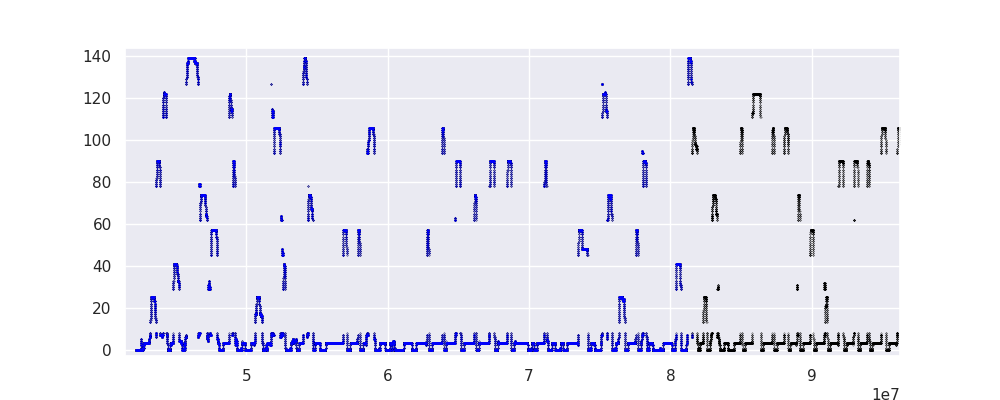

In [829]:
# look at trials for remy day 20 epoch 2
offline_arm_coords = [[0,8],[13,25],[29,41],[45,57],[62,74],[78,90],[94,106],[111,123],[127,139]]
false_positive_data_plot = false_positive_data.copy()
binned_linear_pos_plot = binned_linear_pos.copy()
binned_linear_pos_plot.reset_index(inplace=True)
mvt_time = binned_linear_pos_plot[binned_linear_pos_plot['linvel_flat'].values>4]

arm_list_int = false_positive_data_plot['off_max_arm_RT'].values.astype(int)
arm_list_plot = np.zeros((1,len(arm_list_int)))
for i in np.arange(0,len(arm_list_int)):
    arm_list_plot[0][i] = (offline_arm_coords[arm_list_int[i]][1])

# day 20 epoch 2: 1958987
# day 20 epoch 4: 10722379
plt.figure(figsize=(10,4))
#plt.scatter(binned_linear_pos_plot['timestamp'].values-10722379,binned_linear_pos_plot['linpos_flat'].values,s=.05,c='black')
plt.scatter(binned_linear_pos_plot['timestamp'].values,binned_linear_pos_plot['linpos_flat'].values,s=.05,c='black')
plt.scatter(encoding_pos_subset['timestamp'].values,encoding_pos_subset['linpos_flat'].values,s=.02,c='blue')


#plt.scatter(false_positive_data_plot['ripple_start'].values,arm_list_plot,s=3,c='red')
#plt.scatter(false_positive_data_plot['rip_start_off'].values,arm_list_plot,s=3,c='red')


In [709]:
# use moving average of spike count in decoder bins to find end of ripple
# try this first with all the known offline ripples

#timestamp offset:
# remy day 20, epoch 2: 1958987
# gus day 17 epoch 3: 88254102
# remy day 20, epoch 4: 10722379

realtime_off_rips = rips.copy()
realtime_off_rips['start'] = (rips['starttime'].values*30000)-10722379
realtime_off_rips['end'] = (rips['endtime'].values*30000)-10722379
realtime_off_rips = realtime_off_rips.reset_index()

summarize_all_rips_offline = True

# set which decoder_data file to use
merged_off_post_pos = decoder_data3.copy()
spike_count_all = np.zeros((len(realtime_off_rips),7))

# spike count threshold to mark end of ripple 
spike_thresh = 1.5

# ripple start delay (in bins)
rip_start_delay = 10

# number of bins for spike count moving average
sliding_window = 3

# remy 20, 2: 18: -1
# remy 20, 4: 20:-4
for index, rip_timestamp in enumerate(realtime_off_rips['start'][20:-4]):
    adj_index = index+20
    posterior_sum_array = np.zeros((sliding_window,9))
    short_ripple = False
    # to plot all ripples
    if summarize_all_rips_offline:

        #print(matching_offline_rips['lockout_num'][index:index+1].values)
        #print(rip_timestamp-30*300,rip_timestamp+30*300,index)
        
        posterior_to_plot = merged_off_post_pos[(merged_off_post_pos['bin_timestamp'] > rip_timestamp-30*300) & 
                                            (merged_off_post_pos['bin_timestamp'] < rip_timestamp+30*500)]
        #print(posterior_to_plot.shape)
        ripple_num_index = int(len(posterior_to_plot)*0.55)
        ripple_num = realtime_off_rips[adj_index:adj_index+1]['event'].values
        ripple_start = realtime_off_rips[adj_index:adj_index+1]['start'].values
        ripple_end = realtime_off_rips[adj_index:adj_index+1]['end'].values
        real_pos = posterior_to_plot[ripple_num_index:ripple_num_index+1]['real_pos'].values
        #print(ripple_num,ripple_start,ripple_end,index,adj_index)

        # exact time of the ripple
        # to check decode with new ripple boundaries, we need new values for ripple_start and ripple_end
        post_sum_times = posterior_to_plot[(posterior_to_plot['bin_timestamp'] > ripple_start[0]) & 
                                          (posterior_to_plot['bin_timestamp'] < ripple_end[0])]
        ripple_length = post_sum_times.shape[0]
        plot_length = posterior_to_plot.shape[0]
    
        # spike count moving average - need to run this over whole window, not just ripple
        # generates a vector with length of the ripple, row 1: timestamp. row 2: spike count avg
        stop_spike_count = False
        spk_count_window = np.zeros((1,sliding_window))
        spk_count_avg = np.zeros((2,plot_length))
        spike_count_all[index,0] = ripple_num
        spike_count_all[index,1] = ripple_length
        spike_count_all[index,4] = posterior_to_plot['bin_timestamp'].values[60+rip_start_delay]
        bins_below_thresh = 0
        #exact_ripple_counter = 0
        for i in np.arange(0,plot_length):
            spk_count_window[0,np.mod(i,sliding_window)] = posterior_to_plot['spike_count'].values[i]
            spk_count_avg[0][i] = posterior_to_plot['bin_timestamp'].values[i]
            spk_count_avg[1][i] = np.average(spk_count_window)
            #threshold to mark end of ripple
            # 60 is the number of 5 msec bins after start of plot that ripple starts
            # now it should require 2 time bins below threshold
            #if i > (60+10) and not exact_ripple_counter:
            #    spike_count_all[index,4] = posterior_to_plot['bin_timestamp'].values[i]
            #    exact_ripple_counter += 1
            if i > (60+rip_start_delay) and spk_count_avg[1][i] < spike_thresh and not stop_spike_count:
                bins_below_thresh += 1
                if bins_below_thresh > 1:
                    spike_count_all[index,2] = spk_count_avg[0][i]
                    spike_count_all[index,3] = (ripple_end - spk_count_avg[0][i])/30
                    spike_count_all[index,5] = posterior_to_plot['bin_timestamp'].values[i]
                    spike_count_all[index,6] = (spike_count_all[index,5] - spike_count_all[index,4])/(30*5)
                    count_end_index = i
                    stop_spike_count = True

        # this is all for plotting
        #ripple_times: need to shift index of posterior_to_plot to 0
        ripple_times = posterior_to_plot.index[(posterior_to_plot['bin_timestamp'] > ripple_start[0]) &
                                              (posterior_to_plot['bin_timestamp'] < ripple_end[0])].tolist()
        ripple_times = ripple_times - posterior_to_plot.index[0]

        #plt.figure(figsize=(7,3))
        #plt.title(f'Spike count = Offline rip {ripple_num}. Len {ripple_length}')
        #plt.scatter(np.arange(0,plot_length),posterior_to_plot['spike_count'].values,s=5)
        #plt.plot(np.arange(0,plot_length),spk_count_avg[1])
        #plt.scatter(count_end_index,5,marker='x',c='green')
        #plt.scatter(ripple_times,np.repeat(5, len(ripple_times)),marker='_',c='blue')

        # final step: save the figure
        #plt.savefig(f'/stelmo/mcoulter/posterior_plots_by_ripple/remy_20_2_offline_2_20_rip_nonmatching_{ripple_num}_real_rip_{realtime_ripple_num}_timestamp_{rip_timestamp}.jpg')

# convert spike_count_all array to pandas
spike_count_all_summary = pd.DataFrame(data=spike_count_all,columns=('offline_rip','ripple_length',
                                                                     'end_timestamp','time_diff',
                                                                    'new_start','new_end','new_length'))

spike_count_all_summary.shape
print('total rips',spike_count_all_summary[spike_count_all_summary['offline_rip']>0].shape)
print('rips >50 ms before',spike_count_all_summary[(spike_count_all_summary['time_diff']>50) &
                        (spike_count_all_summary['offline_rip']>0)].shape)
print('rips >50 ms after',spike_count_all_summary[(spike_count_all_summary['time_diff']<-50) &
                        (spike_count_all_summary['offline_rip']>0)].shape)

total rips (1241, 7)
rips >50 ms before (67, 7)
rips >50 ms after (67, 7)


In [729]:
# spike count average over whole session
# overall average is 1.6 - very close to 1.5 used at the cut off
# so now we want to calculate a moving average every 1 sec
# this will require 200 bins
np.average(decoder_data1['spike_count'].values)

spk_count_window = np.zeros((1,sliding_window))
spk_count_avg = np.zeros((2,plot_length))
        
for i in np.arange(0,plot_length):
    spk_count_window[0,np.mod(i,sliding_window)] = posterior_to_plot['spike_count'].values[i]
    spk_count_avg[0][i] = posterior_to_plot['bin_timestamp'].values[i]
    spk_count_avg[1][i] = np.average(spk_count_window)

1.6383696280593563

In [615]:
len(ripple_times)
np.repeat(5, len(ripple_times))
#count_end_index
ripple_times - posterior_to_plot.index[0]
post_sum_times
spike_count_all_summary[100:110]
spike_count_all_summary[spike_count_all_summary['new_end']==0]

,offline_rip,ripple_length,end_timestamp,time_diff,new_start,new_end,new_length
1241,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1242,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1243,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1244,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1245,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1246,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...
1259,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1260,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1261,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [480]:
# looking at ripple end timing
pd.set_option('display.max_rows', 10)
spike_count_all_summary[(spike_count_all_summary['time_diff']<0) & (spike_count_all_summary['time_diff']>-50)
                        & (spike_count_all_summary['offline_rip']>0)]


,offline_rip,ripple_length,end_timestamp,time_diff
0,65.0,8.0,43859400.0,-20.100000
1,66.0,21.0,43896600.0,-2.100000
2,67.0,12.0,43915350.0,-1.766667
3,68.0,13.0,43978650.0,-15.766667
5,81.0,13.0,44746350.0,-1.100000
...,...,...,...,...
1231,2257.0,13.0,161826900.0,-2.100000
1232,2258.0,17.0,161837700.0,-1.433333
1234,2260.0,16.0,161960700.0,-43.433333
1235,2267.0,13.0,162296400.0,-4.766667


In [473]:
#spike_count_summary_01 = spike_count_all_summary.copy()
#spike_count_summary_005 = spike_count_all_summary.copy()
#spike_count_summary_01_plus_10 = spike_count_all_summary.copy()
#spike_count_summary_015 = spike_count_all_summary.copy()
spike_count_summary_015_2bin = spike_count_all_summary.copy()

<IPython.core.display.Javascript object>


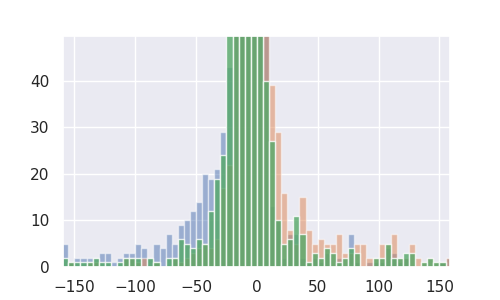

(array([  2.,   1.,   0.,   0.,   0.,   0.,   0.,   0.,   2.,   1.,   1.,
          1.,   1.,   2.,   1.,   1.,   0.,   1.,   2.,   2.,   2.,   0.,
          2.,   1.,   0.,   2.,   2.,   6.,   5.,   4.,   6.,   5.,  12.,
         19.,  24.,  63.,  91., 128., 233., 282., 169.,  40.,  27.,  10.,
          5.,   6.,  11.,   7.,   1.,   3.,   2.,   4.,   3.,   1.,   2.,
          4.,   3.,   0.,   0.,   2.,   2.,   5.,   2.,   2.,   3.,   3.,
          0.,   1.,   2.,   1.,   1.,   0.,   0.,   2.,   2.,   2.,   3.,
          0.,   1.]),
 array([-200, -195, -190, -185, -180, -175, -170, -165, -160, -155, -150,
        -145, -140, -135, -130, -125, -120, -115, -110, -105, -100,  -95,
         -90,  -85,  -80,  -75,  -70,  -65,  -60,  -55,  -50,  -45,  -40,
         -35,  -30,  -25,  -20,  -15,  -10,   -5,    0,    5,   10,   15,
          20,   25,   30,   35,   40,   45,   50,   55,   60,   65,   70,
          75,   80,   85,   90,   95,  100,  105,  110,  115,  120,  125,
         130,  1

In [472]:
plt.figure(figsize=(5,3))
#plt.hist(spike_count_summary_01['time_diff'].values,bins=np.arange(-200,200,5),alpha=0.5)
#plt.hist(spike_count_summary_005['time_diff'].values,bins=np.arange(-200,200,5),alpha=0.5)
plt.hist(spike_count_summary_01_plus_10['time_diff'].values,bins=np.arange(-200,200,5),alpha=0.5)
plt.hist(spike_count_summary_015['time_diff'].values,bins=np.arange(-200,200,5),alpha=0.5)
plt.hist(spike_count_all_summary['time_diff'].values,bins=np.arange(-200,200,5),alpha=0.8)

In [ ]:
# new linearization
# plot histogram of offline replay arms
#off_post_sum_summary[off_post_sum_summary['offline_rip']>0]
off_post_sum_summary.shape
#plt.hist(off_post_sum_summary['off_max_arm'].values,bins=np.arange(0,100))
off_RT_post_sum_summary[100:110]

In [ ]:
replay_combined_matching[replay_combined_matching['rt_two_messages']>0]
#non_matching[non_matching['rt_two_messages']>0]

(817, 20)


<IPython.core.display.Javascript object>


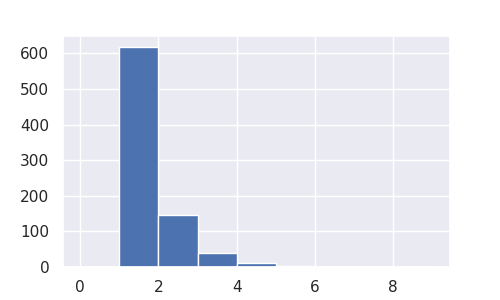

(array([  0., 618., 145.,  38.,  12.,   2.,   1.,   0.,   0.]),
 array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 <a list of 9 Patch objects>)

In [758]:
# join offline and realtime replay summaries

# remove ripples past end of offline decoding (b/c of trial time filter?)
#off_post_sum_summary = off_post_sum_summary[off_post_sum_summary['offline_rip']>0]

replay_summary_combined = pd.DataFrame.join(off_post_sum_summary,realtime_post_sum_summary,on='realtime_rip',
                                            how='outer',lsuffix='off',rsuffix='rt')
replay_combined_matching = replay_summary_combined[replay_summary_combined['offline_rip']>0]
#replay_combined_matching = replay_combined_matching[replay_combined_matching['rt_two_messages']>0]
#replay_summary_combined['realtime_ripoff'].values
print(replay_combined_matching.shape)

# what is this plot showing???? - showing duplicate real-time rips (0 bin in histogram)
plt.figure(figsize=(5,3))
plt.hist(replay_combined_matching['realtime_rip'].diff(),bins=np.arange(0,10))

In [490]:
# for some reason there are two missed rips in the offline only table - not sure why??
replay_combined_matching[300:310]
off_post_sum_summary[off_post_sum_summary['offline_rip']>0][160:170]
off_post_sum_summary[160:170]
off_post_sum_summary[off_post_sum_summary['offline_rip']== -1]

,offline_rip,realtime_rip,off_max_arm,box,arm1,arm2,arm3,arm4,arm5,arm6,arm7,arm8,rip_length,short_rip
168,-1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,114.0,0.0
1138,-1.0,1.0,2.0,0.0,0.0,0.9,0.0,0.0,0.0,0.0,0.0,0.0,114.0,0.0


<IPython.core.display.Javascript object>


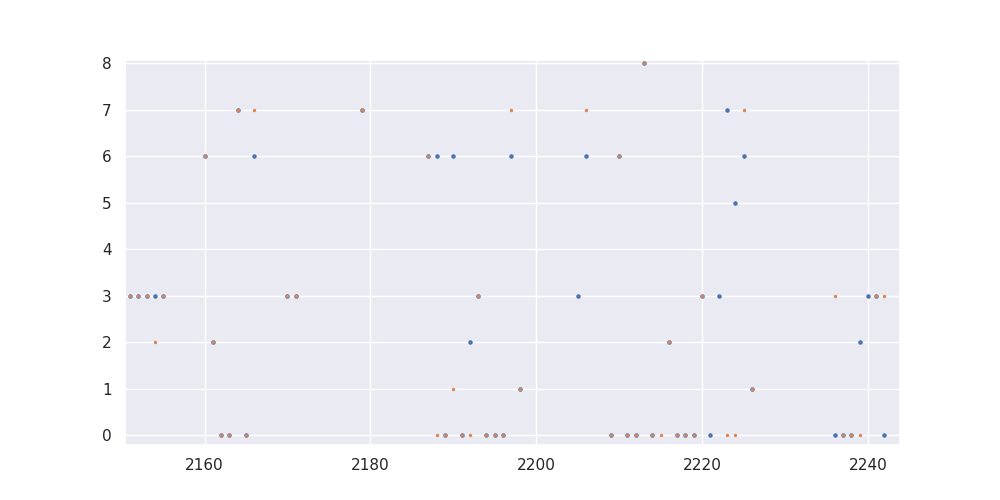

In [625]:
plt.figure(figsize=(10,5))
plt.scatter(off_RT_post_sum_summary['offline_rip'].values,off_RT_post_sum_summary['off_max_arm'].values,s=5)
plt.scatter(off_post_sum_summary['offline_rip'].values,off_post_sum_summary['off_max_arm'].values,s=2)


<IPython.core.display.Javascript object>


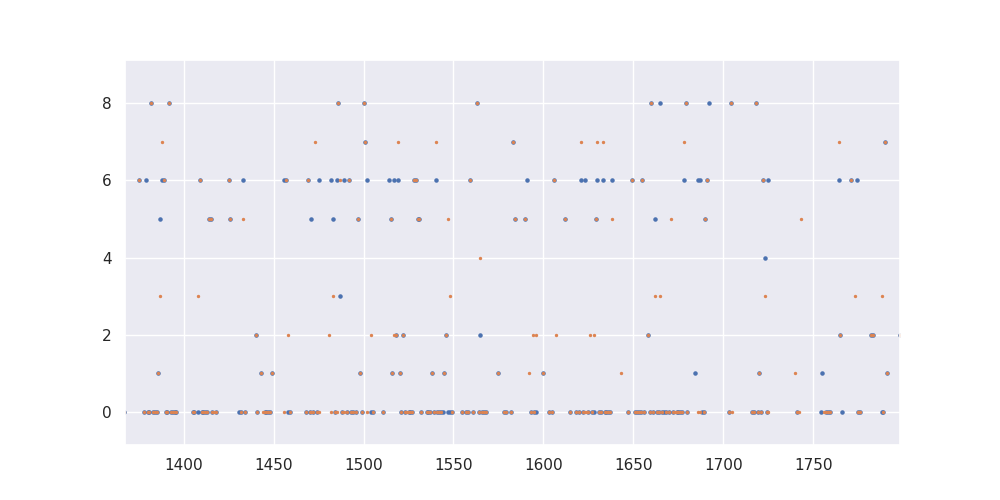

In [42]:
plt.figure(figsize=(10,5))
plt.scatter(off_RT_post_sum_summary['offline_rip'].values,off_RT_post_sum_summary['off_max_arm'].values,s=5)
plt.scatter(off_post_sum_summary['offline_rip'].values,off_post_sum_summary['off_max_arm'].values,s=2)


In [ ]:
off_RT_post_sum_summary[765:800]

<IPython.core.display.Javascript object>


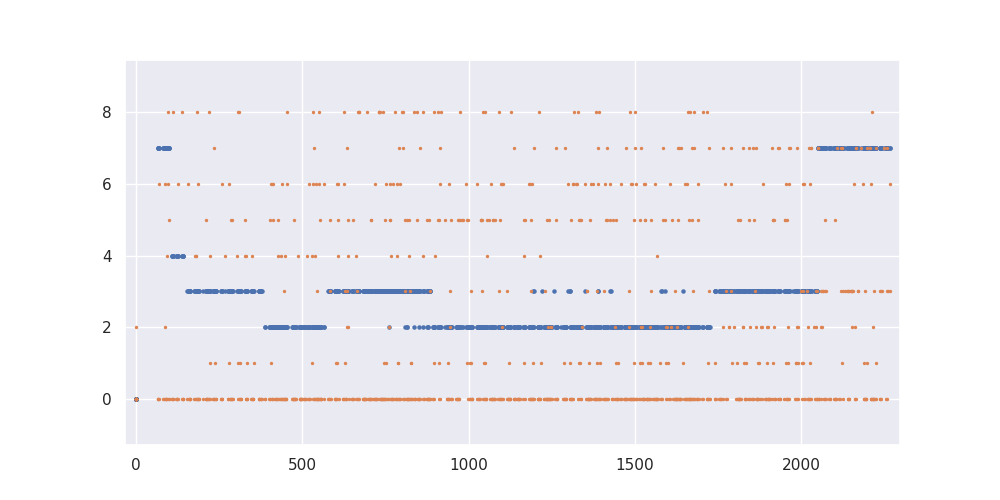

In [543]:
# tried to run real-time system with full R Star tree
plt.figure(figsize=(10,5))
plt.scatter(off_RT_post_sum_summary['offline_rip'].values,off_RT_post_sum_summary['off_max_arm'].values,s=5)
plt.scatter(off_post_sum_summary['offline_rip'].values,off_post_sum_summary['off_max_arm'].values,s=2)


<IPython.core.display.Javascript object>


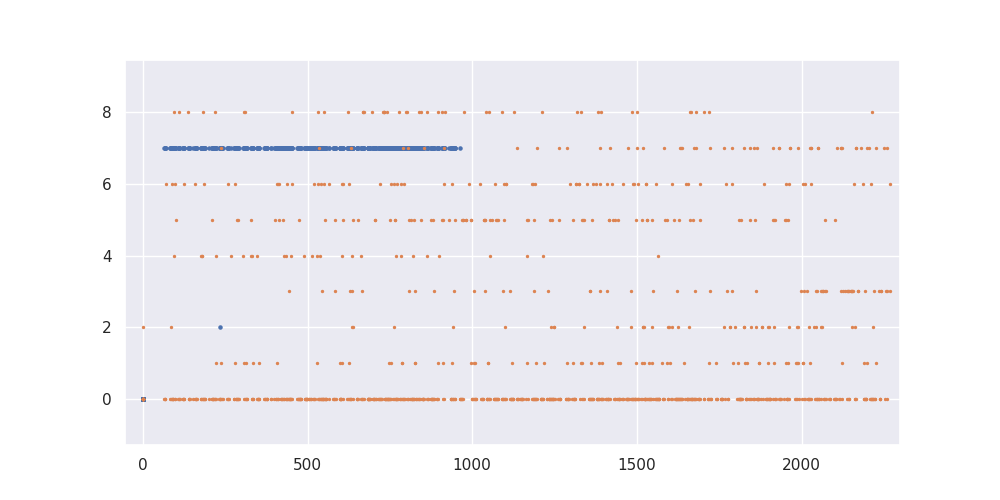

In [577]:
# tried to run real-time system with full R Star tree and full occupancy
plt.figure(figsize=(10,5))
plt.scatter(off_RT_post_sum_summary['offline_rip'].values,off_RT_post_sum_summary['off_max_arm'].values,s=5)
plt.scatter(off_post_sum_summary['offline_rip'].values,off_post_sum_summary['off_max_arm'].values,s=2)


In [ ]:
plt.figure(figsize=(10,5))
plt.hist(off_post_sum_summary['off_max_arm'].values,bins=np.arange(0,100))

In [151]:
pd.set_option('display.max_rows', 10)
pd.set_option('display.max_columns', 20)
false_positive_data

,offline_rip_off,realtime_rip_off,off_max_arm_off,box_off,arm1_off,arm2_off,arm3_off,arm4_off,arm5_off,arm6_off,...,arm3_RT,arm4_RT,arm5_RT,arm6_RT,arm7_RT,arm8_RT,rip_length_RT,short_rip_RT,real_pos_RT,rip_diff
76,236.0,1.0,99.0,0.2,0.0,0.0,0.0,0.0,0.0,0.3,...,0.0,0.0,0.0,0.0,0.7,0.0,19.0,1.0,3.0,0.0
148,406.0,1.0,99.0,0.2,0.4,0.2,0.0,0.0,0.0,0.0,...,0.1,0.0,0.0,0.0,0.1,0.0,26.0,1.0,3.0,0.0
327,720.0,1.0,99.0,0.3,0.1,0.0,0.0,0.0,0.0,0.4,...,0.0,0.0,0.0,0.6,0.0,0.0,42.0,1.0,3.0,0.0
360,762.0,1.0,99.0,0.4,0.0,0.3,0.0,0.2,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,40.0,1.0,3.0,0.0
475,944.0,1.0,99.0,0.4,0.0,0.0,0.0,0.0,0.1,0.1,...,0.0,0.0,0.0,0.2,0.0,0.5,21.0,1.0,3.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1103,2024.0,1.0,7.0,0.2,0.0,0.0,0.0,0.0,0.0,0.2,...,0.0,0.0,0.0,0.7,0.1,0.0,10.0,1.0,3.0,0.0
1118,2049.0,1.0,7.0,0.0,0.0,0.0,0.0,0.0,0.0,0.3,...,0.0,0.0,0.0,0.9,0.1,0.0,29.0,1.0,3.0,0.0
1158,2121.0,1.0,7.0,0.2,0.0,0.0,0.1,0.0,0.0,0.1,...,0.1,0.0,0.0,0.5,0.1,0.0,11.0,1.0,3.0,0.0
1184,2166.0,1.0,7.0,0.0,0.1,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.1,0.7,0.1,0.0,20.0,1.0,3.0,0.0


In [ ]:
# DONT USE - incomplete because does not account for other arm filter
# is there a way to remove the duplicates? - should we?
# include fractions in the print out summary

# re-run without dealy
# re-run with delay and full session

# make histogram of classification for all replays

#summarize matching between offline and realtime
print('total matching:',replay_combined_matching.shape[0])

#exact match
print('exact match:',(replay_combined_matching[replay_combined_matching['off_max_arm'].values == replay_combined_matching['rt_max_arm'].values]).shape[0])

# non-matching
non_matching = replay_combined_matching[replay_combined_matching['off_max_arm'].values != replay_combined_matching['rt_max_arm'].values]
print('non-matching:',non_matching.shape[0])
# count for each arm in realtime replays
print('realtime below 0.5:',non_matching[non_matching['rt_max_arm'] == 99].shape[0])
print('realtime box:',non_matching[non_matching['rt_max_arm'] == 0].shape[0])
print('realtime arm 1:',non_matching[non_matching['rt_max_arm'] == 1].shape[0])
print('realtime arm 2:',non_matching[non_matching['rt_max_arm'] == 2].shape[0])
print('realtime arm 3:',non_matching[non_matching['rt_max_arm'] == 3].shape[0])
print('realtime arm 4:',non_matching[non_matching['rt_max_arm'] == 4].shape[0])
print('realtime arm 5:',non_matching[non_matching['rt_max_arm'] == 5].shape[0])
print('realtime arm 6:',non_matching[non_matching['rt_max_arm'] == 6].shape[0])
print('realtime arm 7:',non_matching[non_matching['rt_max_arm'] == 7].shape[0])
print('realtime arm 8:',non_matching[non_matching['rt_max_arm'] == 8].shape[0])

# offline: no arm above 0.5
print('offline < 0.5, mismatch total:',non_matching[non_matching['off_max_arm'] == 99].shape[0])
print('offline < 0.5, realtime box:',non_matching[(non_matching['off_max_arm'] == 99) & (non_matching['rt_max_arm'] == 0)].shape[0])
print('offline < 0.5, realtime other arm:',non_matching[(non_matching['off_max_arm'] == 99) & (non_matching['rt_max_arm'] != 0)].shape[0])

# offline: box
print('offline box, mismatch total:',non_matching[non_matching['off_max_arm'] == 0].shape[0])
print('offline box, realtime < 0.5:',non_matching[(non_matching['off_max_arm'] == 0) & (non_matching['rt_max_arm'] == 99)].shape[0])
print('offline box, realtime other arm:',non_matching[(non_matching['off_max_arm'] == 0) & (non_matching['rt_max_arm'] != 99)].shape[0])

# offline: outer arm
print('offline arm, mismatch total:',non_matching[(non_matching['off_max_arm'] > 0)&(non_matching['off_max_arm'] < 10)].shape[0])
print('offline arm, realtime < 0.5:',non_matching[(non_matching['off_max_arm'] > 0)&(non_matching['off_max_arm'] < 10) & (non_matching['rt_max_arm'] == 99)].shape[0])
print('offline arm, realtime box:',non_matching[(non_matching['off_max_arm'] > 0)&(non_matching['off_max_arm'] < 10) & (non_matching['rt_max_arm'] == 0)].shape[0])
print('offline arm, realtime other arm:',non_matching[(non_matching['off_max_arm'] > 0)&(non_matching['off_max_arm'] < 10) & (non_matching['rt_max_arm'] > 0)&(non_matching['rt_max_arm'] < 10)].shape[0])


In [763]:
# replay matching for real-time and offline decoder of offline ripple times

# re-run without dealy
# re-run with delay and full session

# make histogram of classification for all replays

#summarize matching between offline and realtime
print('total ripples:',replay_combined_matching.shape[0])

#exact match
matching_replays = (replay_combined_matching[replay_combined_matching['off_max_arm'].values == 
                                              replay_combined_matching['rt_max_arm'].values])

print('exact match:',matching_replays.shape[0])
# non-matching
non_matching = replay_combined_matching[replay_combined_matching['off_max_arm'].values != 
                                       replay_combined_matching['rt_max_arm'].values]
print('non-matching:',non_matching.shape[0])

# count for each arm in realtime replays
print('realtime below 0.5:',non_matching[non_matching['rt_max_arm'] == 99].shape[0])
print('realtime box:',non_matching[non_matching['rt_max_arm'] == 0].shape[0])
print('realtime arm 1:',non_matching[non_matching['rt_max_arm'] == 1].shape[0])
print('realtime arm 2:',non_matching[non_matching['rt_max_arm'] == 2].shape[0])
print('realtime arm 3:',non_matching[non_matching['rt_max_arm'] == 3].shape[0])
print('realtime arm 4:',non_matching[non_matching['rt_max_arm'] == 4].shape[0])
print('realtime arm 5:',non_matching[non_matching['rt_max_arm'] == 5].shape[0])
print('realtime arm 6:',non_matching[non_matching['rt_max_arm'] == 6].shape[0])
print('realtime arm 7:',non_matching[non_matching['rt_max_arm'] == 7].shape[0])
print('realtime arm 8:',non_matching[non_matching['rt_max_arm'] == 8].shape[0])
print('realtime no arm:',non_matching[non_matching['rt_max_arm'] == 98].shape[0])

# offline: no arm above 0.5
mismatch_05_total = non_matching[non_matching['off_max_arm'] == 99]
mismatch_05_rt_box = non_matching[(non_matching['off_max_arm'] == 99) & 
                                  (non_matching['rt_max_arm'] == 0)]
mismatch_05_rt_other = non_matching[(non_matching['off_max_arm'] == 99) & 
                                  (non_matching['rt_max_arm'] == 98)]
mismatch_05_rt_arm = non_matching[(non_matching['off_max_arm'] == 99) & 
                                  (non_matching['rt_max_arm'] > 0) &
                                  (non_matching['rt_max_arm'] < 10)]
print('offline < 0.5, mismatch total:',mismatch_05_total.shape[0])
print('offline < 0.5, realtime box:',mismatch_05_rt_box.shape[0])
print('offline < 0.5, realtime arm:',mismatch_05_rt_arm.shape[0])
print('offline < 0.5, realtime other arm:',mismatch_05_rt_other.shape[0])

# offline: box
mismatch_box_total = non_matching[non_matching['off_max_arm'] == 0]
mismatch_box_rt_05 = non_matching[(non_matching['off_max_arm'] == 0) & 
                                  (non_matching['rt_max_arm'] == 99)]
mismatch_box_rt_other = non_matching[(non_matching['off_max_arm'] == 0) & 
                                  (non_matching['rt_max_arm'] == 98)]
mismatch_box_rt_arm = non_matching[(non_matching['off_max_arm'] == 0) & 
                                   (non_matching['rt_max_arm'] > 0) &
                                   (non_matching['rt_max_arm'] < 10)]
print('offline box, mismatch total:',mismatch_box_total.shape[0])
print('offline box, realtime < 0.5:',mismatch_box_rt_05.shape[0])
print('offline box, realtime arm:',mismatch_box_rt_arm.shape[0])
print('offline box, realtime other arm:',mismatch_box_rt_other.shape[0])

# offline: outer arm
mismatch_arm_total = non_matching[(non_matching['off_max_arm'] > 0)&
                                  (non_matching['off_max_arm'] < 10)]
mismatch_arm_rt_05 = non_matching[(non_matching['off_max_arm'] > 0)&
                                  (non_matching['off_max_arm'] < 10) & 
                                  (non_matching['rt_max_arm'] == 99)]
mismatch_arm_rt_box = non_matching[(non_matching['off_max_arm'] > 0)&
                                   (non_matching['off_max_arm'] < 10) & 
                                   (non_matching['rt_max_arm'] == 0)]
mismatch_arm_rt_other = non_matching[(non_matching['off_max_arm'] > 0)&
                                  (non_matching['off_max_arm'] < 10) & 
                                  (non_matching['rt_max_arm'] == 98)]
mismatch_arm_rt_arm = non_matching[(non_matching['off_max_arm'] > 0)&
                                   (non_matching['off_max_arm'] < 10) & 
                                   (non_matching['rt_max_arm'] > 0) &
                                   (non_matching['rt_max_arm'] < 10)]
print('offline arm, mismatch total:',mismatch_arm_total.shape[0])
print('offline arm, realtime < 0.5:',mismatch_arm_rt_05.shape[0])
print('offline arm, realtime box:',mismatch_arm_rt_box.shape[0])
print('offline arm, realtime arm:',mismatch_arm_rt_arm.shape[0])
print('offline arm, realtime other arm:',mismatch_arm_rt_other.shape[0])

#offline: other outer arm filter
mismatch_other_total = non_matching[non_matching['off_max_arm'] == 98]
mismatch_other_rt_box = non_matching[(non_matching['off_max_arm'] == 98) & 
                                  (non_matching['rt_max_arm'] == 0)]
mismatch_other_rt_05 = non_matching[(non_matching['off_max_arm'] == 98) & 
                                  (non_matching['rt_max_arm'] == 99)]
mismatch_other_rt_arm = non_matching[(non_matching['off_max_arm'] == 98) & 
                                  (non_matching['rt_max_arm'] > 0) &
                                  (non_matching['rt_max_arm'] < 10)]
print('offline other arm filter, mismatch total:',mismatch_other_total.shape[0])
print('offline other arm filter, realtime box:',mismatch_other_rt_box.shape[0])
print('offline other arm filter, realtime 0.5:',mismatch_other_rt_05.shape[0])
print('offline other arm filter, realtime arm:',mismatch_other_rt_arm.shape[0])


print('exact match fraction',np.around((matching_replays.shape[0]/replay_combined_offline.shape[0]),decimals=2))

print('same message fraction',np.around((matching_replays.shape[0]+mismatch_05_rt_box.shape[0]+
                                         mismatch_box_rt_05.shape[0]+mismatch_other_rt_box.shape[0]+
                                         mismatch_other_rt_05.shape[0])/replay_combined_offline.shape[0],decimals=2))

print('false negative',np.around((mismatch_arm_rt_05.shape[0]+mismatch_arm_rt_box.shape[0]+
                                 mismatch_arm_rt_other.shape[0])/replay_combined_offline.shape[0],decimals=2))

false_positive_data = pd.concat([mismatch_05_rt_arm, mismatch_box_rt_arm, mismatch_arm_rt_arm,mismatch_other_rt_arm])

print('false positive count',false_positive_data.shape[0])

replay_false_positive = (mismatch_05_rt_arm.shape[0]+mismatch_box_rt_arm.shape[0]+
                         mismatch_arm_rt_arm.shape[0]+mismatch_other_rt_arm.shape[0])

print('false positive',np.around(replay_false_positive/replay_combined_offline.shape[0],decimals=2))

# false positives of sent messages
all_sent_message = replay_combined_matching[(replay_combined_matching['rt_max_arm'] > 0) & 
                                           (replay_combined_matching['rt_max_arm'] < 10)]
print('false positive messages:',np.around(replay_false_positive/all_sent_message.shape[0],decimals=2))

total ripples: 817
exact match: 604
non-matching: 213
realtime below 0.5: 109
realtime box: 56
realtime arm 1: 4
realtime arm 2: 9
realtime arm 3: 6
realtime arm 4: 2
realtime arm 5: 9
realtime arm 6: 4
realtime arm 7: 1
realtime arm 8: 7
realtime no arm: 6
offline < 0.5, mismatch total: 79
offline < 0.5, realtime box: 50
offline < 0.5, realtime arm: 26
offline < 0.5, realtime other arm: 3
offline box, mismatch total: 77
offline box, realtime < 0.5: 68
offline box, realtime arm: 9
offline box, realtime other arm: 0
offline arm, mismatch total: 48
offline arm, realtime < 0.5: 38
offline arm, realtime box: 5
offline arm, realtime arm: 2
offline arm, realtime other arm: 3
offline other arm filter, mismatch total: 9
offline other arm filter, realtime box: 1
offline other arm filter, realtime 0.5: 3
offline other arm filter, realtime arm: 5
exact match fraction 0.51
same message fraction 0.62
false negative 0.04
false positive count 42
false positive 0.04
false positive messages: 0.33


<IPython.core.display.Javascript object>


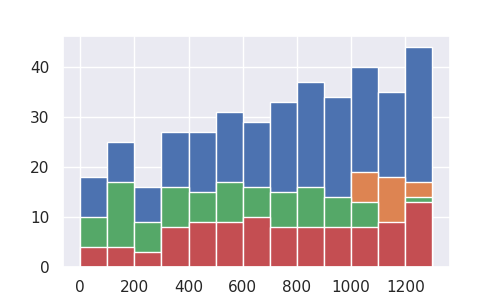

(array([ 4.,  4.,  3.,  8.,  9.,  9., 10.,  8.,  8.,  8.,  8.,  9., 13.]),
 array([   0,  100,  200,  300,  400,  500,  600,  700,  800,  900, 1000,
        1100, 1200, 1300]),
 <a list of 13 Patch objects>)

In [127]:
# plot non-matching ripples with max real-time arm over time
# would like to plot again with arm = 99 set to -1 or something like that

# plot histogram of number of mis-match ripples over time
non_matching
arm_mismatch = non_matching[(non_matching['rt_max_arm'].values>0) & (non_matching['rt_max_arm'].values<10)]
box_mismatch = non_matching[(non_matching['rt_max_arm'].values==0)]
noarm_mismatch = non_matching[(non_matching['rt_max_arm'].values==99)]
plt.figure(figsize=(5,3))
#plt.scatter(non_matching['realtime_rip'].values,non_matching['rt_max_arm'].values,s=5)
plt.hist(non_matching['realtime_rip'].values,bins=np.arange(0,1400,100))
plt.hist(arm_mismatch['realtime_rip'].values,bins=np.arange(0,1400,100))
plt.hist(box_mismatch['realtime_rip'].values,bins=np.arange(0,1400,100))
plt.hist(noarm_mismatch['realtime_rip'].values,bins=np.arange(0,1400,100))


In [311]:
# what is distribution of all real-time replays with 2 message
print('total matching:',replay_combined_matching.shape[0])
# count for each arm in realtime replays
print('realtime below 0.5:',replay_combined_matching[replay_combined_matching['rt_max_arm'] == 99].shape[0])
print('realtime box:',replay_combined_matching[replay_combined_matching['rt_max_arm'] == 0].shape[0])
print('realtime arm 1:',replay_combined_matching[replay_combined_matching['rt_max_arm'] == 1].shape[0])
print('realtime arm 2:',replay_combined_matching[replay_combined_matching['rt_max_arm'] == 2].shape[0])
print('realtime arm 3:',replay_combined_matching[replay_combined_matching['rt_max_arm'] == 3].shape[0])
print('realtime arm 4:',replay_combined_matching[replay_combined_matching['rt_max_arm'] == 4].shape[0])
print('realtime arm 5:',replay_combined_matching[replay_combined_matching['rt_max_arm'] == 5].shape[0])
print('realtime arm 6:',replay_combined_matching[replay_combined_matching['rt_max_arm'] == 6].shape[0])
print('realtime arm 7:',replay_combined_matching[replay_combined_matching['rt_max_arm'] == 7].shape[0])
print('realtime arm 8:',replay_combined_matching[replay_combined_matching['rt_max_arm'] == 8].shape[0])

print('off below 0.5:',replay_combined_matching[replay_combined_matching['off_max_arm'] == 99].shape[0])
print('off box:',replay_combined_matching[replay_combined_matching['off_max_arm'] == 0].shape[0])
print('off arm 1:',replay_combined_matching[replay_combined_matching['off_max_arm'] == 1].shape[0])
print('off arm 2:',replay_combined_matching[replay_combined_matching['off_max_arm'] == 2].shape[0])
print('off arm 3:',replay_combined_matching[replay_combined_matching['off_max_arm'] == 3].shape[0])
print('off arm 4:',replay_combined_matching[replay_combined_matching['off_max_arm'] == 4].shape[0])
print('off arm 5:',replay_combined_matching[replay_combined_matching['off_max_arm'] == 5].shape[0])
print('off arm 6:',replay_combined_matching[replay_combined_matching['off_max_arm'] == 6].shape[0])
print('off arm 7:',replay_combined_matching[replay_combined_matching['off_max_arm'] == 7].shape[0])
print('off arm 8:',replay_combined_matching[replay_combined_matching['off_max_arm'] == 8].shape[0])

#replay_combined_matching

total matching: 109
realtime below 0.5: 0
realtime box: 0
realtime arm 1: 13
realtime arm 2: 7
realtime arm 3: 6
realtime arm 4: 8
realtime arm 5: 25
realtime arm 6: 20
realtime arm 7: 16
realtime arm 8: 14
off below 0.5: 4
off box: 29
off arm 1: 11
off arm 2: 4
off arm 3: 8
off arm 4: 1
off arm 5: 19
off arm 6: 12
off arm 7: 12
off arm 8: 9


# posterior plotting

In [578]:
# from error calcuation: plot decoder_data max
# generate posterior error dataframe for real-time data
post_error3 = decoder_data8.copy()

post_error3.drop(columns=['rec_ind','bin_timestamp','wall_time','velocity','real_pos',
                         'raw_x','raw_y','smooth_x','smooth_y','next_bin',
                         'spike_count','ripple','ripple_number','ripple_length',
                         'shortcut_message','box','arm1','arm2','arm3','arm4','arm5',
                         'arm6','arm7','arm8'], inplace=True)
post_error3.fillna(0,inplace=True)
post_error3['max_position'] = post_error3.idxmax(axis=1)
post_error3['max_position'] = post_error3['max_position'].str.replace('x','')
post_error3['max_position'] = post_error3['max_position'].astype(int)

#now need to add back columns 'timestamp','real_pos_time','real_pos'
# try adding back spike_count too
post_error3['timestamp'] = decoder_data8['bin_timestamp']
post_error3['real_vel'] = decoder_data8['velocity']
post_error3['real_pos'] = decoder_data8['real_pos']
post_error3['spike_count'] = decoder_data8['spike_count']
#this is the error column in centimeters
post_error3['error_cm'] = abs(post_error3['max_position']-decoder_data8['real_pos'])*5

post_error3
post_error_plot3 = post_error3.copy()
post_error_plot3 = post_error_plot3
#post_error_plot3 = post_error_plot3[post_error_plot3['real_vel']>8]
post_error_plot3.shape

(398670, 143)

In [ ]:
# real-time posteriors max - load full Tree - all in arm 7
plt.figure(figsize=(10,3))

plt.scatter(post_error_plot3['timestamp'].values,post_error_plot3['real_pos'].values,s=10)
plt.scatter(post_error_plot3['timestamp'].values,post_error_plot3['max_position'].values,s=1,alpha=0.3)


In [27]:
decoder_data1.iloc[:,25:162]

,x000,x001,x002,x003,x004,x005,x006,x007,x008,x009,...,x127,x128,x129,x130,x131,x132,x133,x134,x135,x136
0,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.0,...,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524
1,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.0,...,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524
2,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.0,...,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524
3,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.0,...,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524
4,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.0,...,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524,0.009524
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
819857,0.070677,0.063111,0.051867,0.038980,0.026122,0.016179,0.009971,0.006946,0.004812,0.0,...,0.004369,0.004496,0.004590,0.004646,0.004687,0.004687,0.004627,0.004570,0.004603,0.004684
819858,0.064536,0.057932,0.048204,0.037012,0.025619,0.016550,0.010666,0.007650,0.005258,0.0,...,0.004827,0.004979,0.005096,0.005170,0.005222,0.005221,0.005146,0.005070,0.005095,0.005178
819859,0.059144,0.053366,0.044913,0.035143,0.024997,0.016729,0.011196,0.008246,0.005659,0.0,...,0.005244,0.005420,0.005560,0.005652,0.005714,0.005712,0.005623,0.005529,0.005548,0.005634
819860,0.054397,0.049323,0.041948,0.033377,0.024308,0.016765,0.011589,0.008735,0.006015,0.0,...,0.005624,0.005823,0.005986,0.006095,0.006168,0.006165,0.006062,0.005952,0.005965,0.006055


In [28]:
# from error caclulation: max for real-time decoder_data
post_error = decoder_data1.copy()

#post_error.drop(columns=['rec_ind','bin_timestamp','wall_time','velocity','real_pos',
#                         'raw_x','raw_y','smooth_x','smooth_y','next_bin',
#                         'spike_count','ripple','ripple_number','ripple_length',
#                         'shortcut_message','box','arm1','arm2','arm3','arm4','arm5',
#                         'arm6','arm7','arm8'], inplace=True)
#post_error = post_error.iloc[:,24:161]
# with taskstate in decoder_data
post_error = post_error.iloc[:,25:162]
post_error.fillna(0,inplace=True)
post_error['posterior_max'] = post_error.idxmax(axis=1)
post_error['posterior_max'] = post_error['posterior_max'].str.replace('x','')
post_error['posterior_max'] = post_error['posterior_max'].astype(int)

#now need to add back columns 'timestamp','real_pos_time','real_pos'
# try adding back spike_count too
post_error['timestamp'] = decoder_data1['bin_timestamp']
post_error['real_vel'] = decoder_data1['velocity']
post_error['linpos_flat'] = decoder_data1['real_pos']
post_error['spike_count'] = decoder_data1['spike_count']
#this is the error column in centimeters
post_error['error_cm'] = abs(post_error['posterior_max']-decoder_data1['real_pos'])*5

post_error1 = post_error.copy()

post_error1.shape

(819862, 143)

<IPython.core.display.Javascript object>


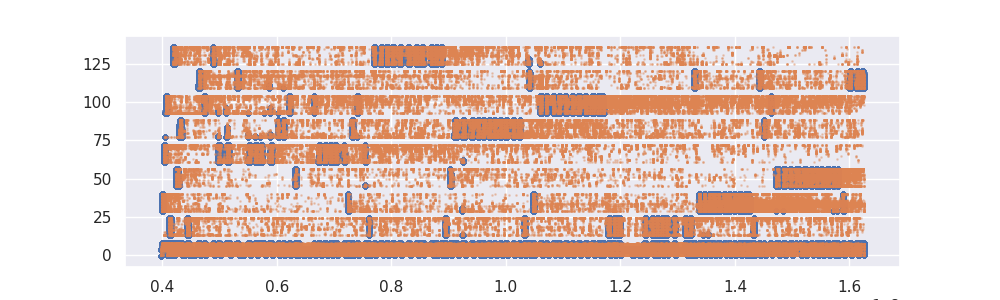

In [24]:
# real-time posteriors max - trans mat offset 0.0001
plt.figure(figsize=(10,3))

plt.scatter(post_error['timestamp'].values,post_error['linpos_flat'].values,s=10)
plt.scatter(post_error['timestamp'].values,post_error['posterior_max'].values,s=1,alpha=0.3)


<IPython.core.display.Javascript object>


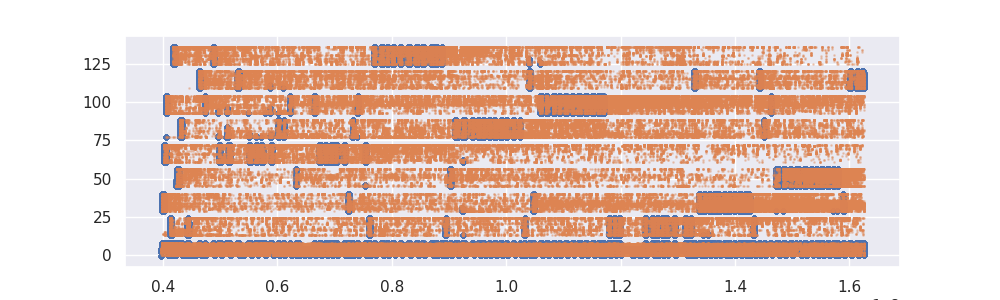

In [29]:
# real-time posteriors max - trans mat offset 0.001
# hmm by this measure it doesnt look much better...
plt.figure(figsize=(10,3))

plt.scatter(post_error1['timestamp'].values,post_error1['linpos_flat'].values,s=10)
plt.scatter(post_error1['timestamp'].values,post_error1['posterior_max'].values,s=1,alpha=0.3)


In [ ]:
# plot heatmap of real-time likelihood

#timestamp offset:
# remy day 20, epoch 2: 1958987
# gus day 17 epoch 3: 88254102

# real-time arm coords
arm_coords =  [[0,8],[13,24],[29,40],[45,56],[61,72],[77,88],[93,104],[109,120],[125,136]]

# real-time timestamps for offline ripples
realtime_off_rips = rips.copy()
realtime_off_rips['start'] = (rips['starttime'].values*30000)-1958987
realtime_off_rips['end'] = (rips['endtime'].values*30000)-1958987
realtime_off_rips = realtime_off_rips.reset_index()

summarize_all_rips_offline = True

# set which decoder_data file to use
#merged_off_post_pos = decoder_data5.copy()
merged_off_post_pos = likelihood_data5.copy()

# need to start at row 18 to match decoder_data time, and end at -1
for index, rip_timestamp in enumerate(realtime_off_rips['start'][1205:1220]):
    adj_index = index+1205
    short_ripple = False
    # to plot all ripples
    if summarize_all_rips_offline:
    # to plotting mis-match replays
    #if matching_offline_rips['lockout_num'][index:index+1].values in non_matching['realtime_rip'].values:
        #print(matching_offline_rips['lockout_num'][index:index+1].values)
        #print(rip_timestamp-30*300,rip_timestamp+30*300,index)
        
        posterior_to_plot = merged_off_post_pos[(merged_off_post_pos['bin_timestamp'] > rip_timestamp-30*300) & 
                                            (merged_off_post_pos['bin_timestamp'] < rip_timestamp+30*300)]
        #print(posterior_to_plot.shape)
        ripple_num = realtime_off_rips[adj_index:adj_index+1]['event'].values
        ripple_start = realtime_off_rips[adj_index:adj_index+1]['start'].values
        ripple_end = realtime_off_rips[adj_index:adj_index+1]['end'].values
        print(ripple_num,ripple_start,ripple_end,index,adj_index)

        ripple_times = posterior_to_plot.index[(posterior_to_plot['bin_timestamp'] > ripple_start[0]) &
                                              (posterior_to_plot['bin_timestamp'] < ripple_end[0])].tolist()

        # for posteriors
        #posterior_offline1 = posterior_to_plot.iloc[:,24:161]
        # for likelihoods
        posterior_offline1 = posterior_to_plot.iloc[:,5:142]
        
        posterior_offline2 = posterior_offline1.fillna(0)
        post_heatmap = posterior_offline2.transpose()
        post_heatmap = post_heatmap.iloc[::-1]

        plt.figure(figsize=(8,4))
        #plt.title(f'Off rip {ripple_num}. Arm {arm_max} {posterior_sum} Len {ripple_length}')
        ax = (sns.heatmap(post_heatmap,vmin=0, vmax=0.7))
        ax.hlines([136-10,136-27,136-43,136-59,136-74,136-90,136-106,136-122], lw=.5, color='w',*ax.get_xlim())
        #ax.scatter(np.arange(0,posterior_to_plot.shape[0]),136-posterior_to_plot['real_pos'].values,s=1,alpha=1,color='cyan')
        #ax.vlines([ripple_times-posterior_to_plot.index[0]],lw=1,color='w',alpha=0.25,*ax.get_ylim())
    
        # final step: save the figure
        #plt.savefig(f'/stelmo/mcoulter/posterior_plots_by_ripple/remy_20_2_offline_2_20_rip_nonmatching_{ripple_num}_real_rip_{realtime_ripple_num}_timestamp_{rip_timestamp}.jpg')


<IPython.core.display.Javascript object>


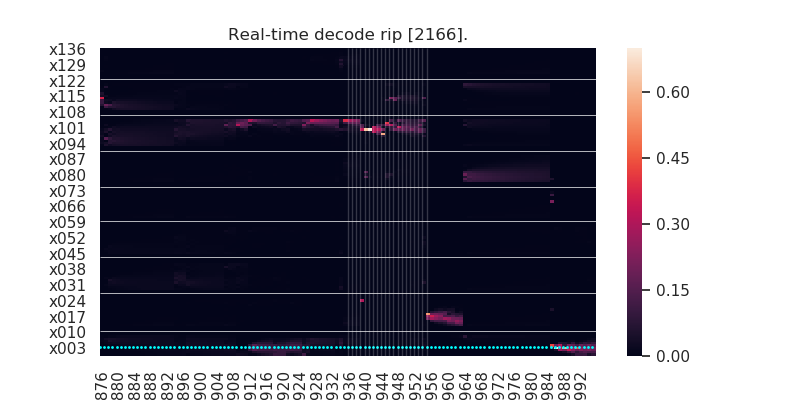

<IPython.core.display.Javascript object>


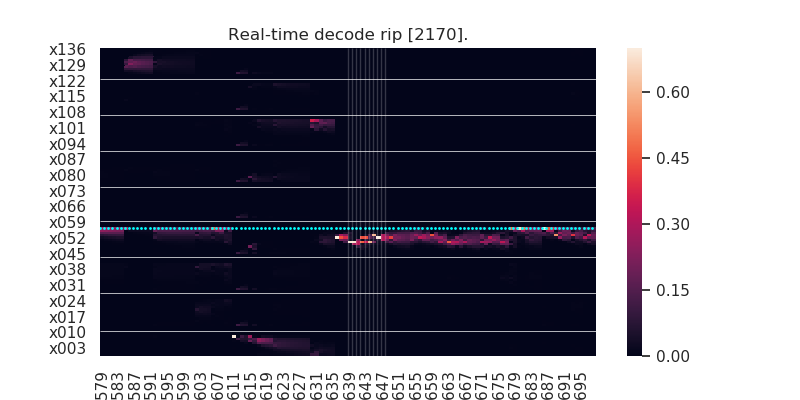

<IPython.core.display.Javascript object>


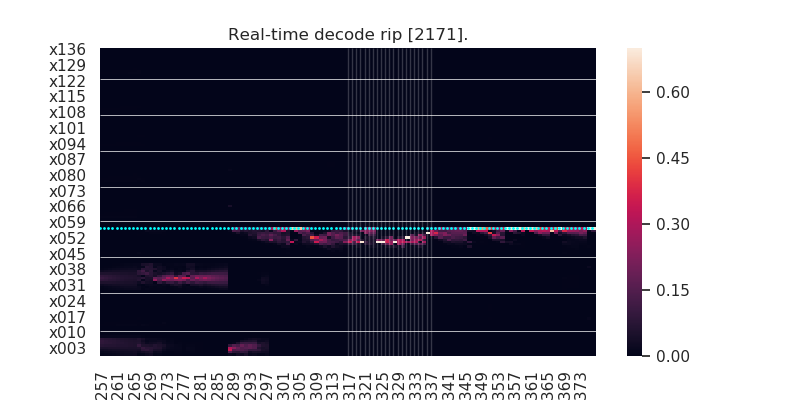

<IPython.core.display.Javascript object>


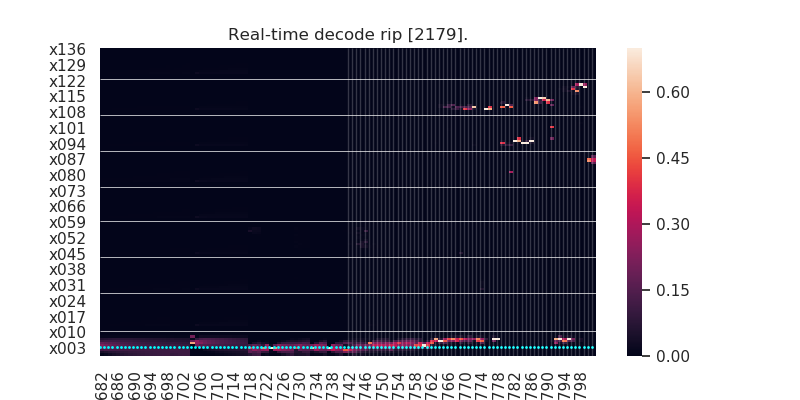

<IPython.core.display.Javascript object>


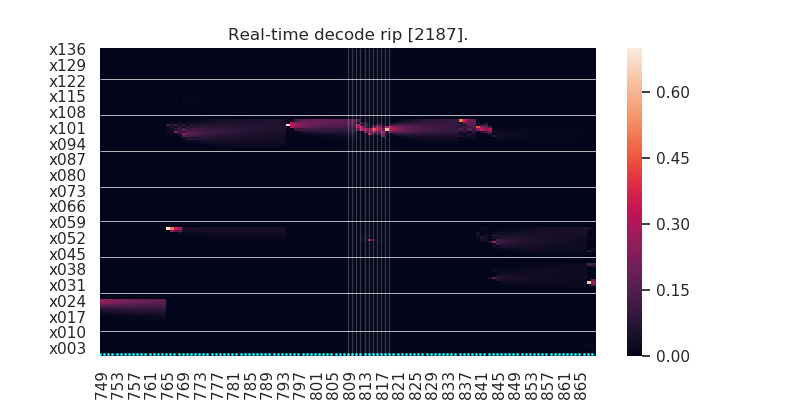

<IPython.core.display.Javascript object>


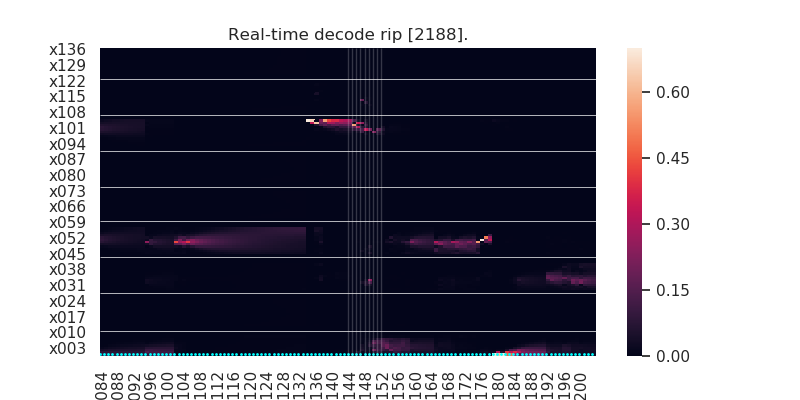

<IPython.core.display.Javascript object>


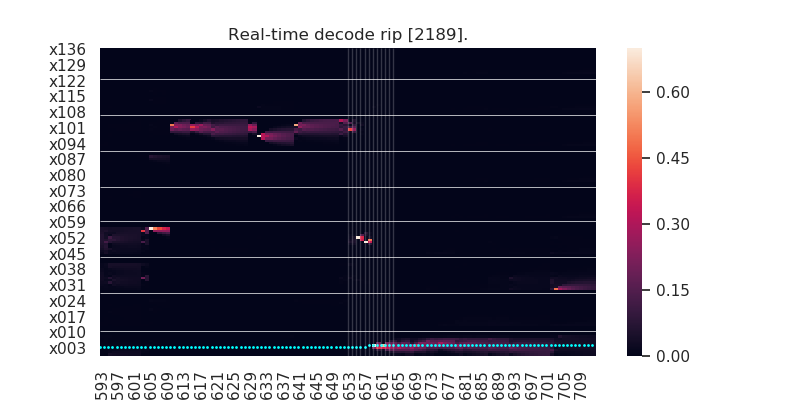

<IPython.core.display.Javascript object>


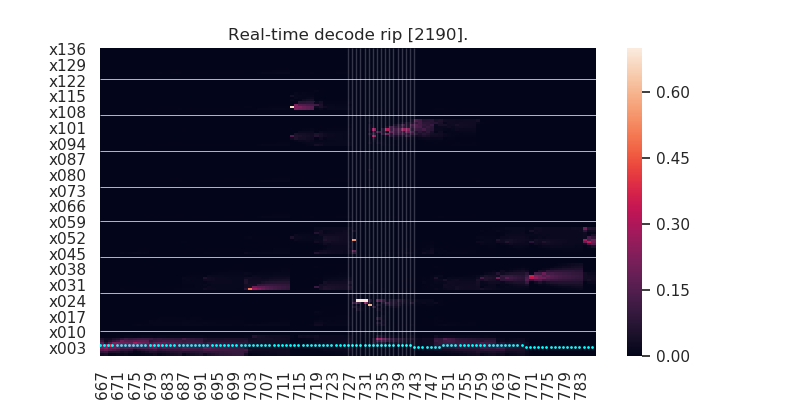

In [11]:
# plot heatmap of posterior for real-time decoder-data

#timestamp offset:
# remy day 20, epoch 2: 1958987
# gus day 17 epoch 3: 88254102

# real-time arm coords
arm_coords =  [[0,8],[13,24],[29,40],[45,56],[61,72],[77,88],[93,104],[109,120],[125,136]]

# real-time timestamps for offline ripples
realtime_off_rips = rips.copy()
realtime_off_rips['start'] = (rips['starttime'].values*30000)-1958987
realtime_off_rips['end'] = (rips['endtime'].values*30000)-1958987
realtime_off_rips = realtime_off_rips.reset_index()

summarize_all_rips_offline = True

# set which decoder_data file to use
merged_off_post_pos = decoder_data.copy()
#merged_off_post_pos = likelihood_data5.copy()

# need to start at row 18 to match decoder_data time, and end at -1
for index, rip_timestamp in enumerate(realtime_off_rips['start'][1202:1210]):
    adj_index = index+1202
    short_ripple = False
    # to plot all ripples
    if summarize_all_rips_offline:
    # to plot false positive mismatch replays
    #if realtime_off_rips['event'][adj_index:adj_index+1].values in false_positive_data['offline_rip_off'].values:
        #print(matching_offline_rips['lockout_num'][index:index+1].values)
        #print(rip_timestamp-30*300,rip_timestamp+30*300,index)
        
        posterior_to_plot = merged_off_post_pos[(merged_off_post_pos['bin_timestamp'] > rip_timestamp-30*300) & 
                                            (merged_off_post_pos['bin_timestamp'] < rip_timestamp+30*300)]
        #print(posterior_to_plot.shape)
        ripple_num = realtime_off_rips[adj_index:adj_index+1]['event'].values
        ripple_start = realtime_off_rips[adj_index:adj_index+1]['start'].values
        ripple_end = realtime_off_rips[adj_index:adj_index+1]['end'].values
        #print(ripple_num,ripple_start,ripple_end,index,adj_index)

        ripple_times = posterior_to_plot.index[(posterior_to_plot['bin_timestamp'] > ripple_start[0]) &
                                              (posterior_to_plot['bin_timestamp'] < ripple_end[0])].tolist()

        # for posteriors
        posterior_offline1 = posterior_to_plot.iloc[:,24:161]
        # for likelihoods
        #posterior_offline1 = posterior_to_plot.iloc[:,5:142]
        
        posterior_offline2 = posterior_offline1.fillna(0)
        post_heatmap = posterior_offline2.transpose()
        post_heatmap = post_heatmap.iloc[::-1]

        plt.figure(figsize=(8,4))
        plt.title(f'Real-time decode rip {ripple_num}.')
        ax = (sns.heatmap(post_heatmap,vmin=0, vmax=0.7))
        ax.hlines([136-10,136-27,136-43,136-59,136-74,136-90,136-106,136-122], lw=0.5, color='w',*ax.get_xlim())
        ax.scatter(np.arange(0,posterior_to_plot.shape[0]),136-posterior_to_plot['real_pos'].values,s=1,alpha=1,color='cyan')
        ax.vlines([ripple_times-posterior_to_plot.index[0]],lw=1,color='w',alpha=0.2,*ax.get_ylim())
    
        # final step: save the figure
        #plt.savefig(f'/stelmo/mcoulter/posterior_plots_by_ripple/4_17_20/remy_20_2_realtime_false_pos_{ripple_num}_timestamp_{rip_timestamp}.jpg')


<IPython.core.display.Javascript object>


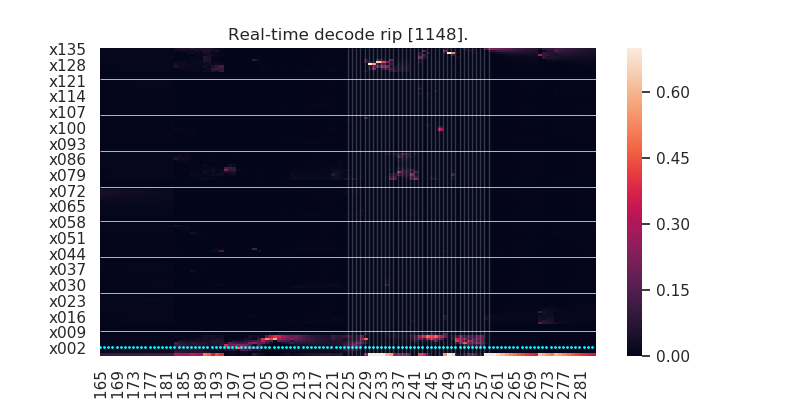

<IPython.core.display.Javascript object>


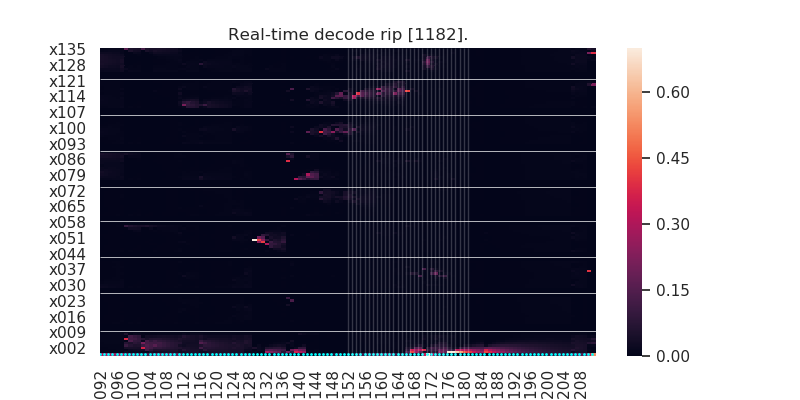

<IPython.core.display.Javascript object>


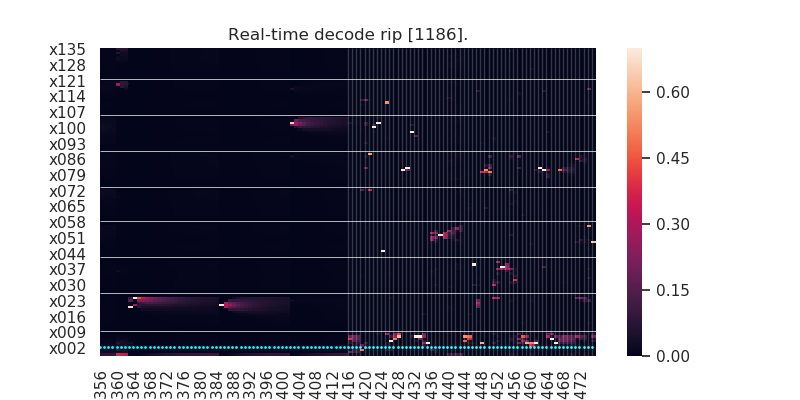

<IPython.core.display.Javascript object>


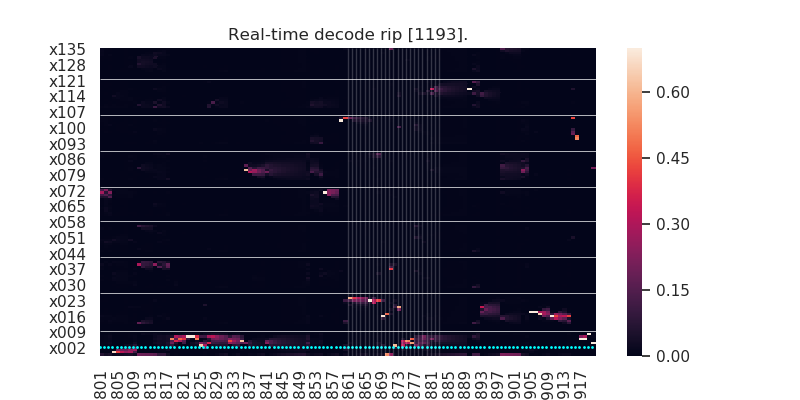

<IPython.core.display.Javascript object>


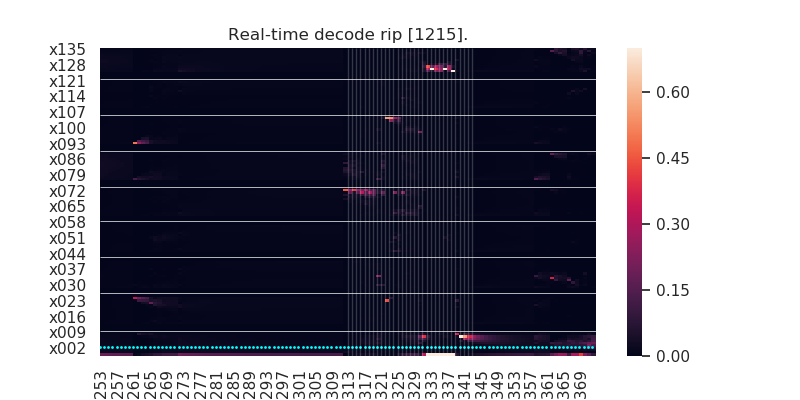

<IPython.core.display.Javascript object>


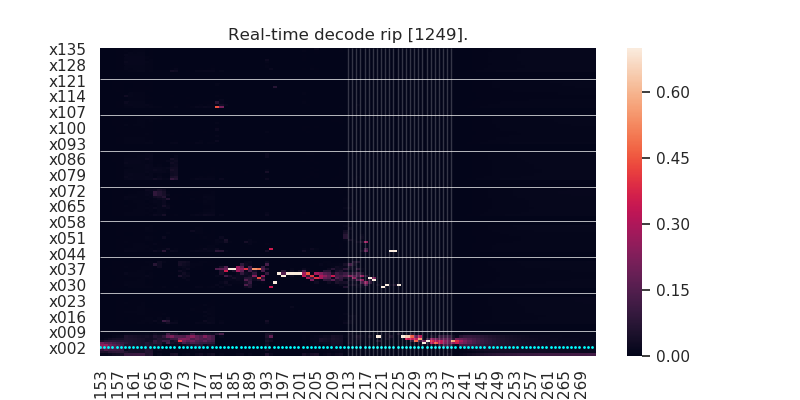

<IPython.core.display.Javascript object>


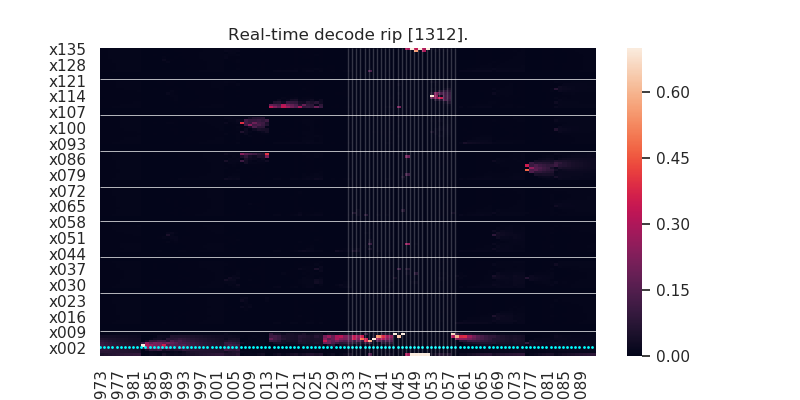

<IPython.core.display.Javascript object>


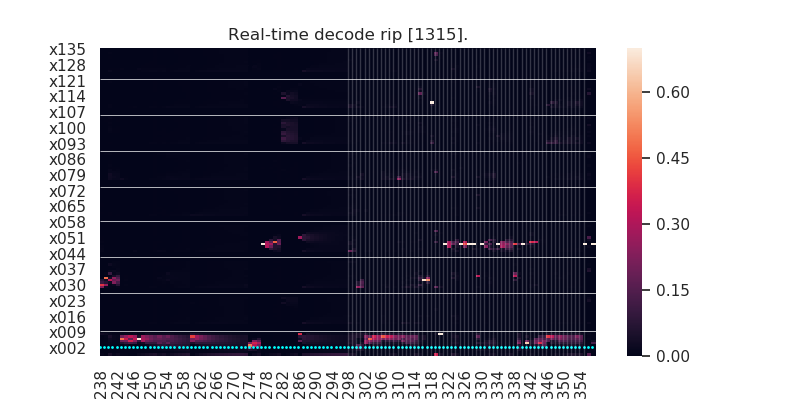

<IPython.core.display.Javascript object>


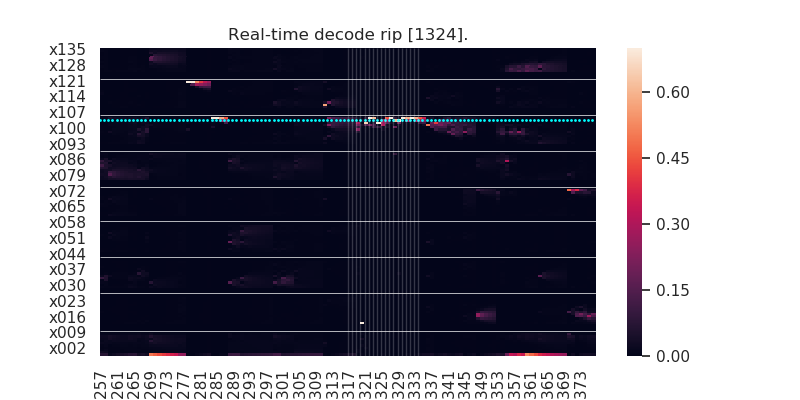

<IPython.core.display.Javascript object>


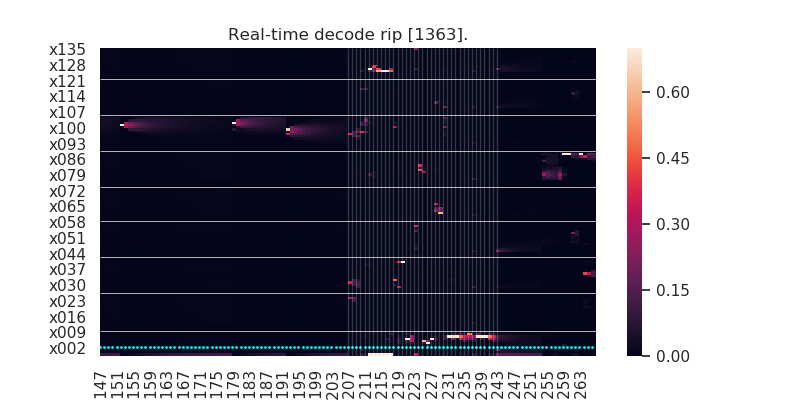

<IPython.core.display.Javascript object>


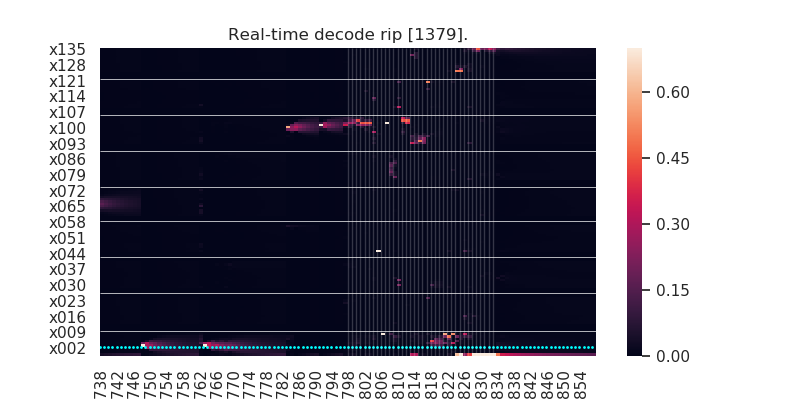

<IPython.core.display.Javascript object>


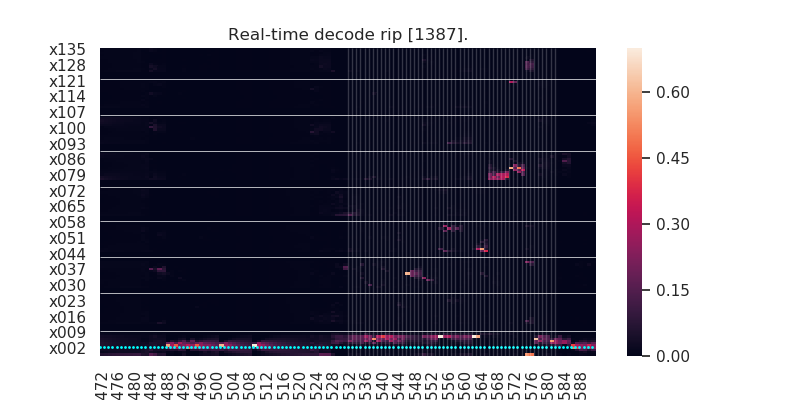

<IPython.core.display.Javascript object>


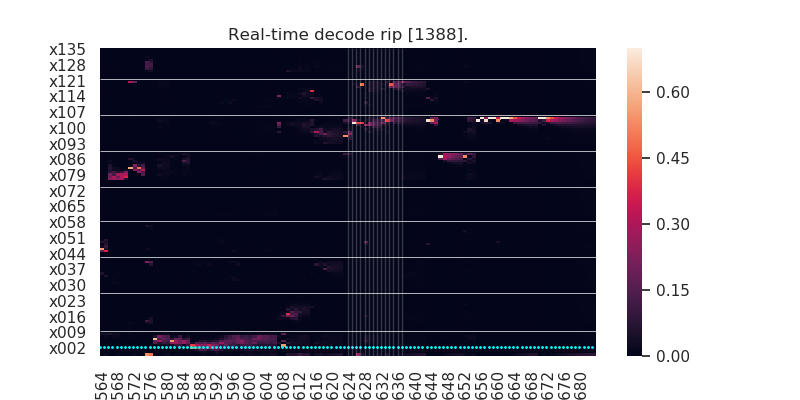

<IPython.core.display.Javascript object>


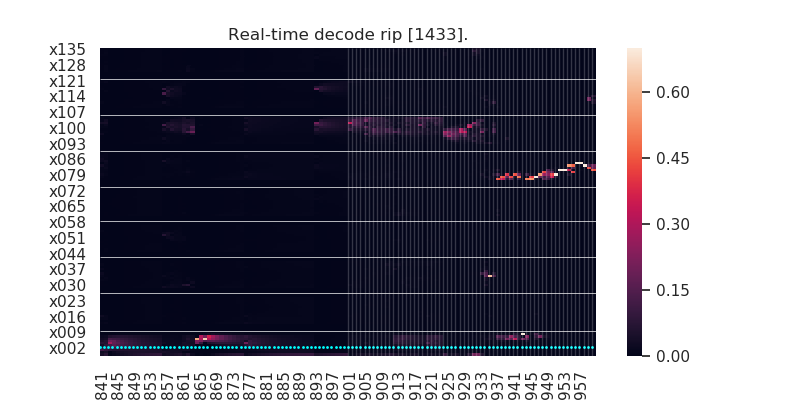

<IPython.core.display.Javascript object>


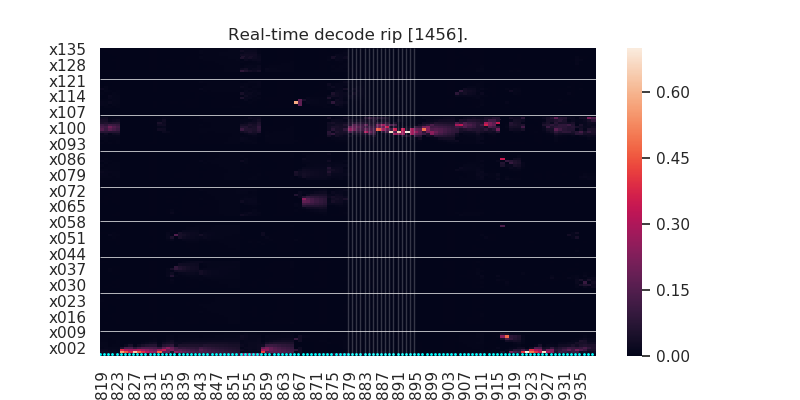

<IPython.core.display.Javascript object>


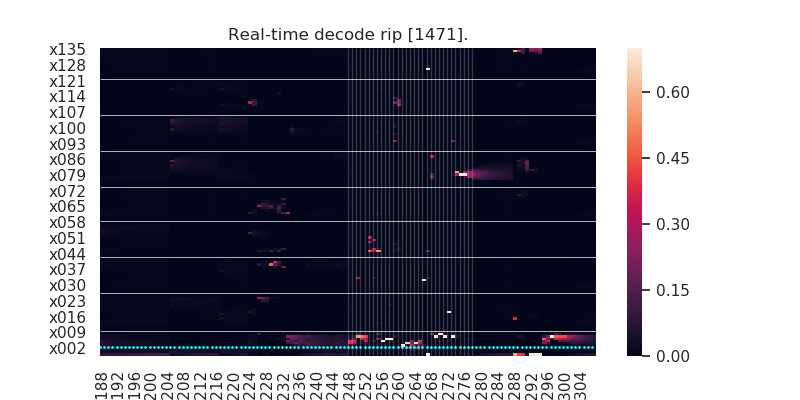

<IPython.core.display.Javascript object>


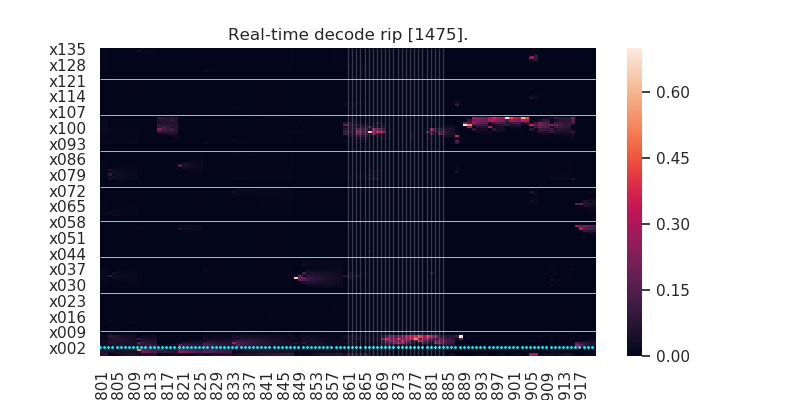

<IPython.core.display.Javascript object>


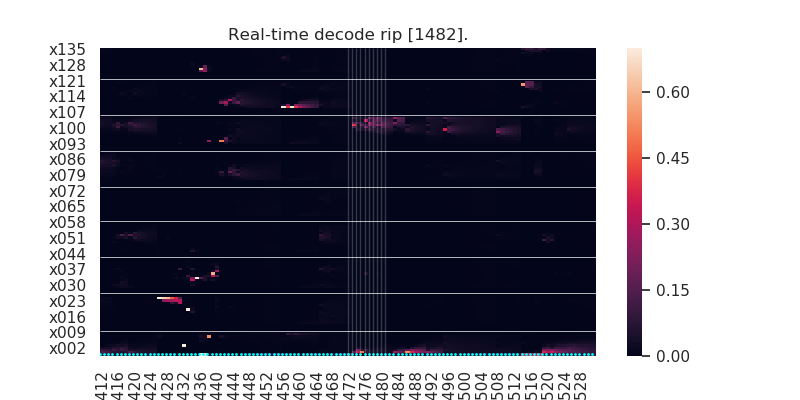

<IPython.core.display.Javascript object>


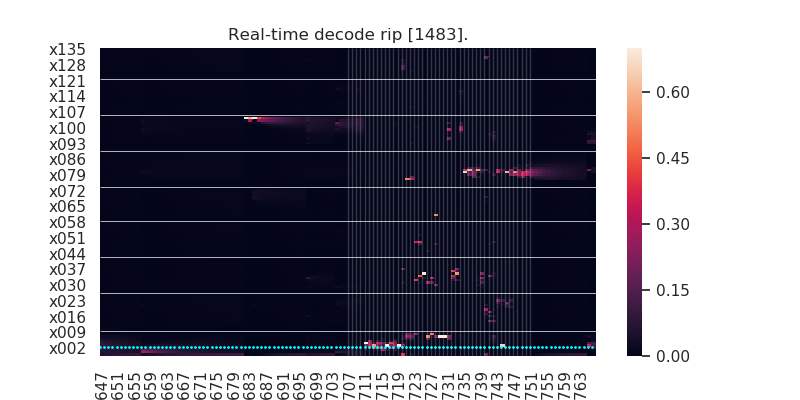

<IPython.core.display.Javascript object>


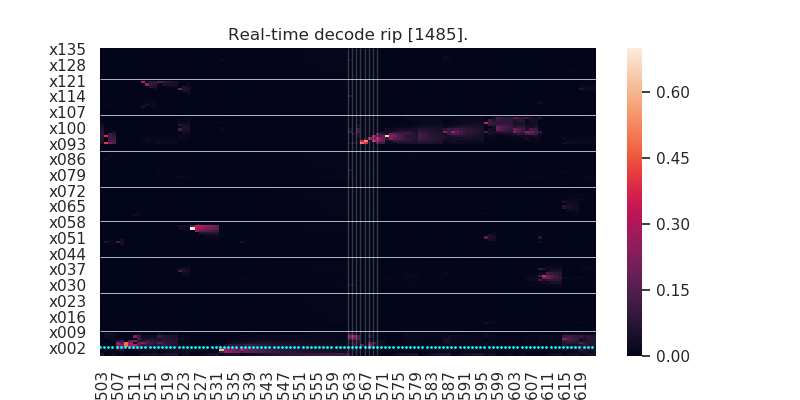

<IPython.core.display.Javascript object>


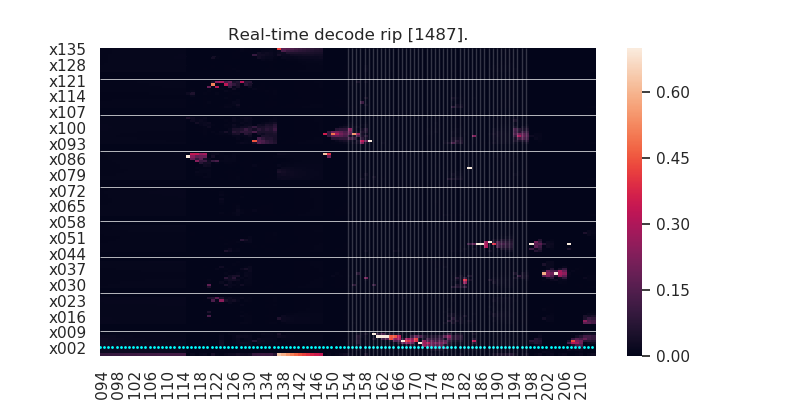

<IPython.core.display.Javascript object>


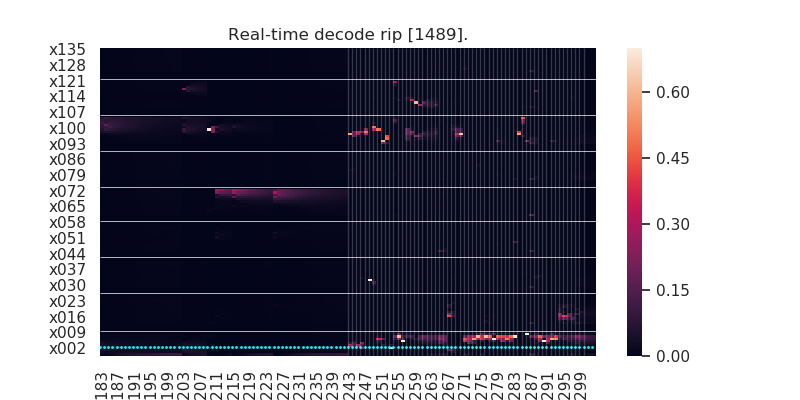

<IPython.core.display.Javascript object>


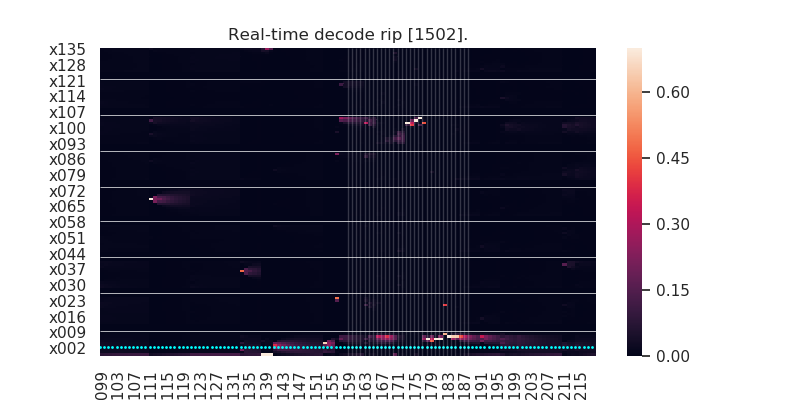

<IPython.core.display.Javascript object>


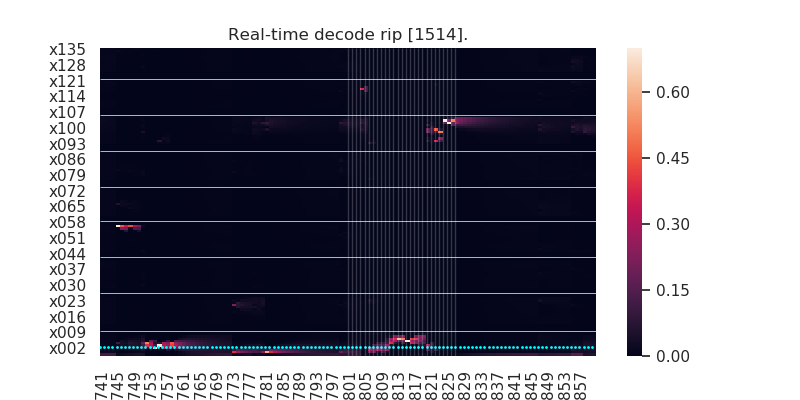

<IPython.core.display.Javascript object>


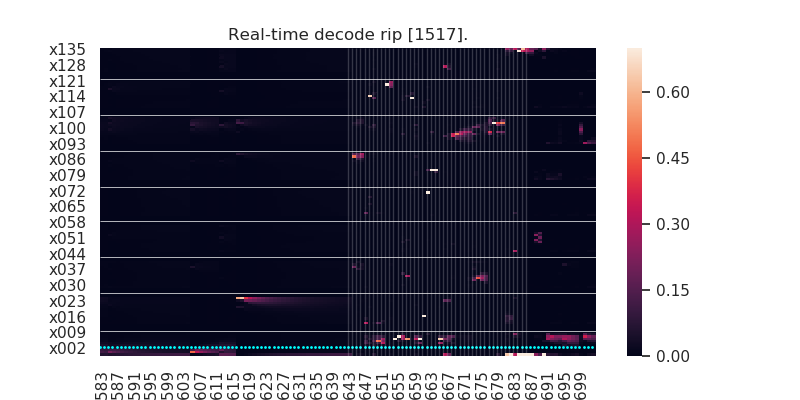

<IPython.core.display.Javascript object>


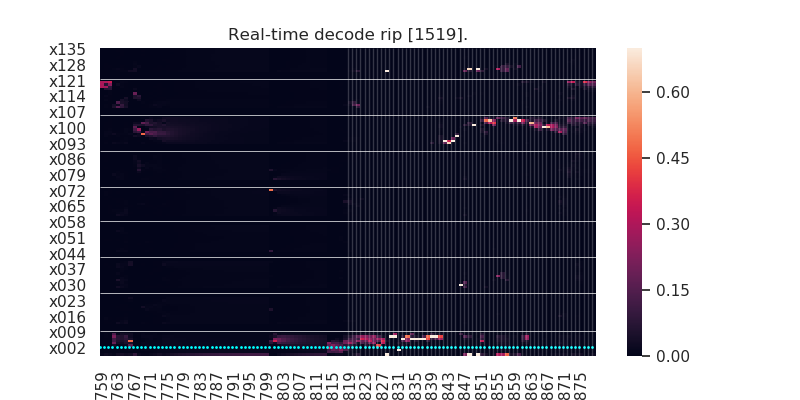

<IPython.core.display.Javascript object>


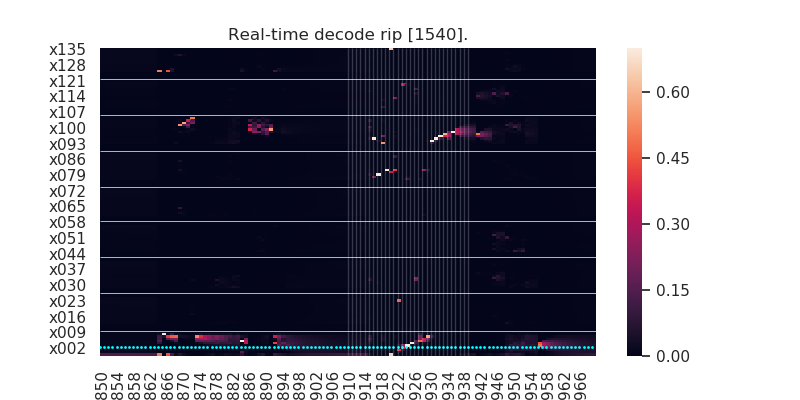

<IPython.core.display.Javascript object>


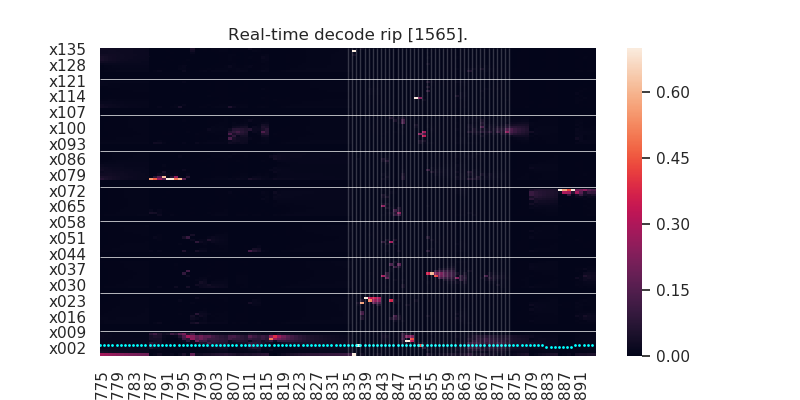

<IPython.core.display.Javascript object>


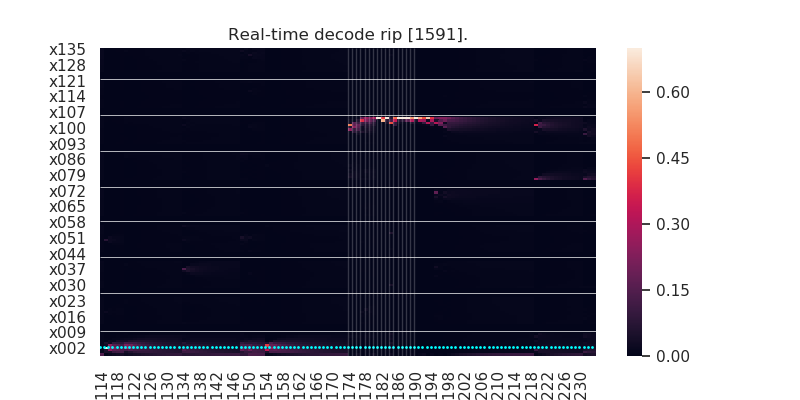

<IPython.core.display.Javascript object>


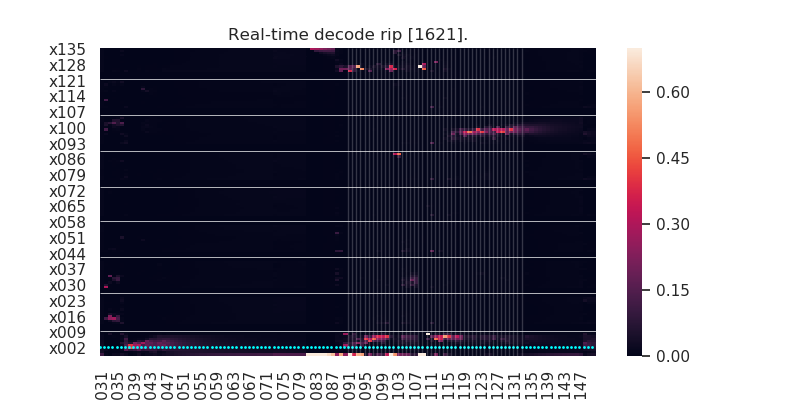

<IPython.core.display.Javascript object>


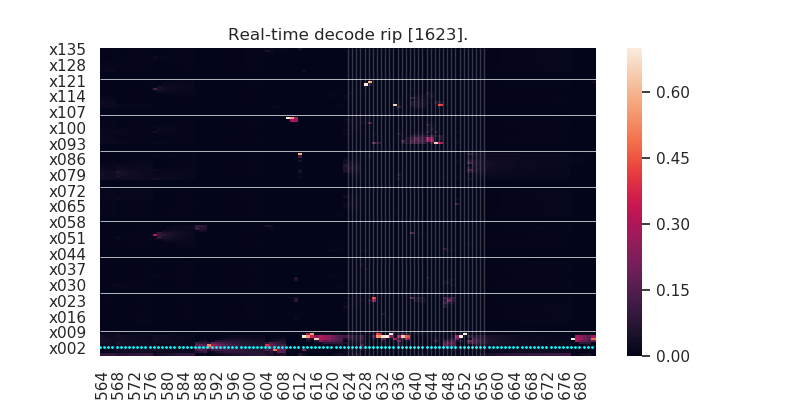

<IPython.core.display.Javascript object>


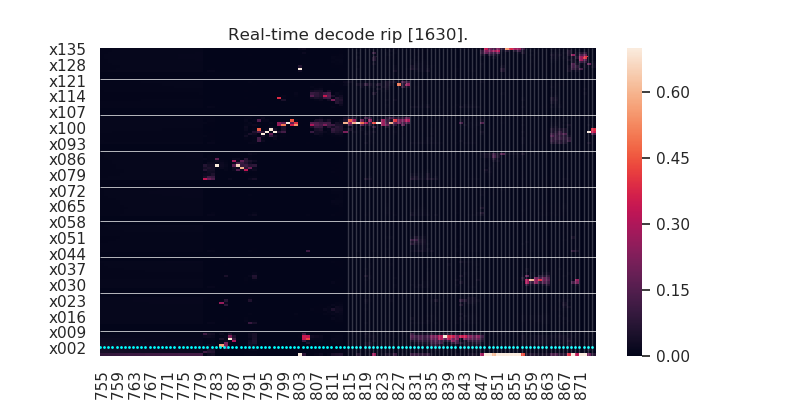

<IPython.core.display.Javascript object>


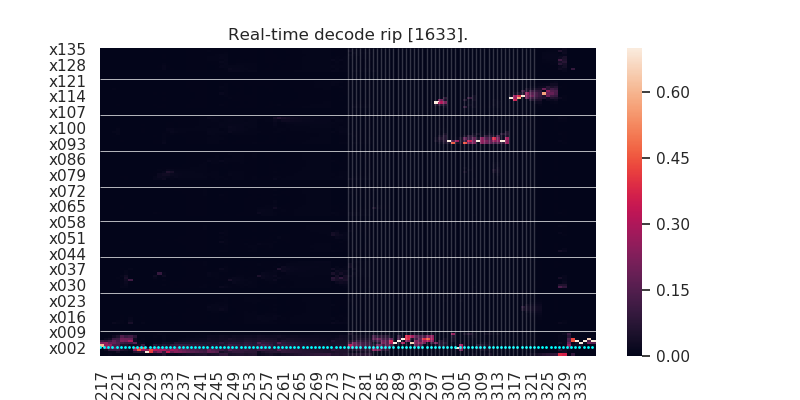

<IPython.core.display.Javascript object>


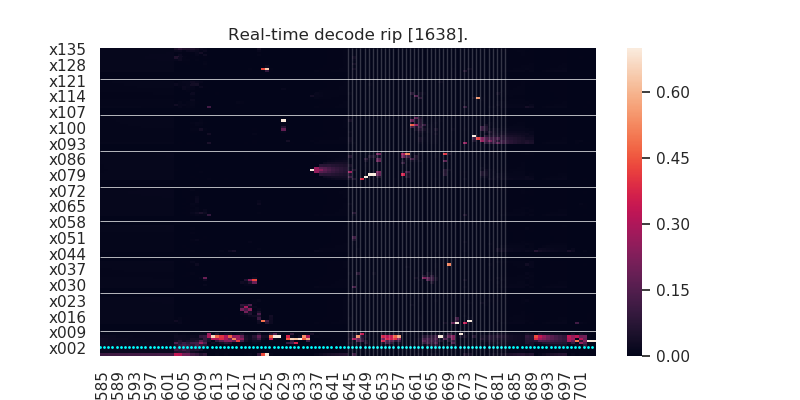

<IPython.core.display.Javascript object>


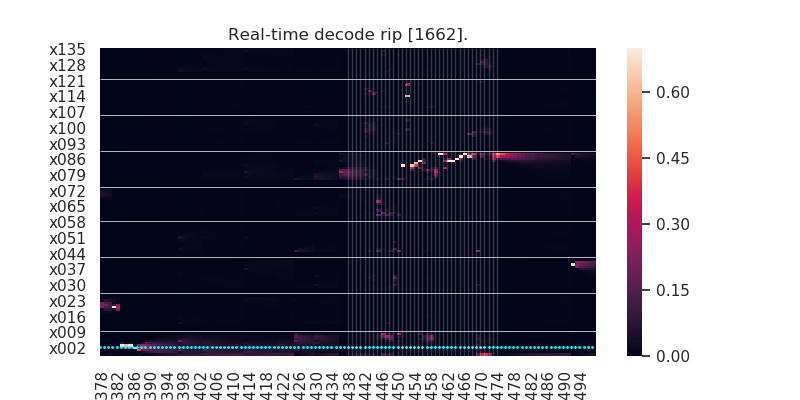

<IPython.core.display.Javascript object>


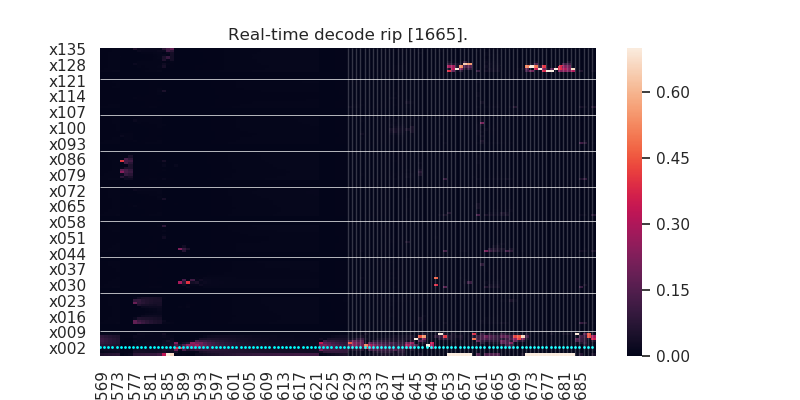

<IPython.core.display.Javascript object>


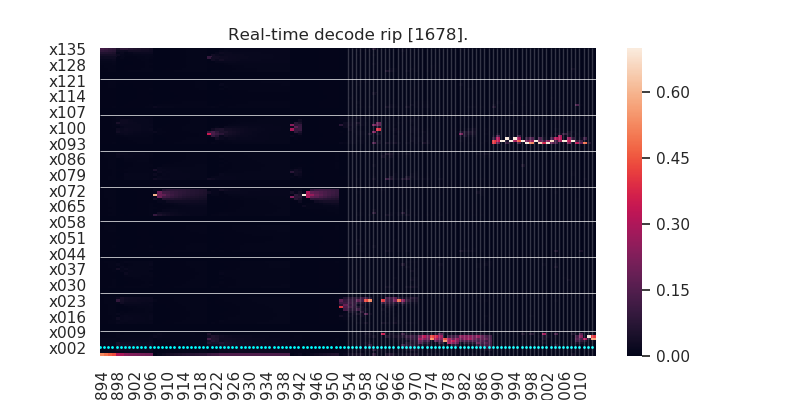

<IPython.core.display.Javascript object>


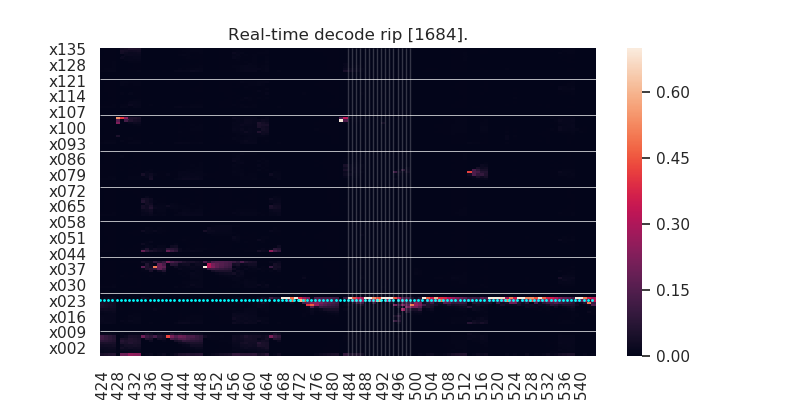

<IPython.core.display.Javascript object>


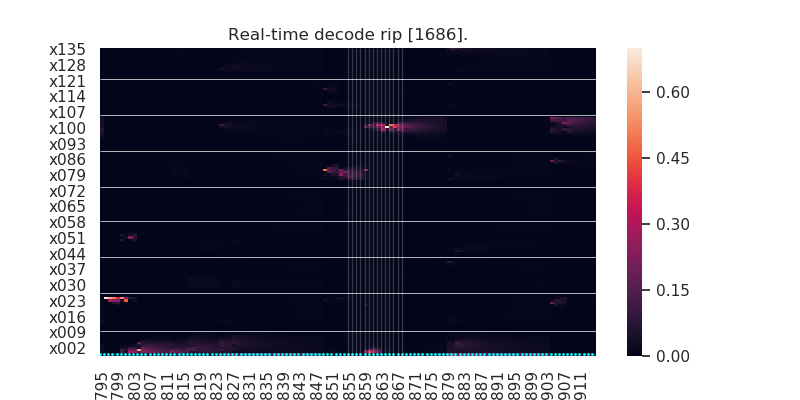

<IPython.core.display.Javascript object>


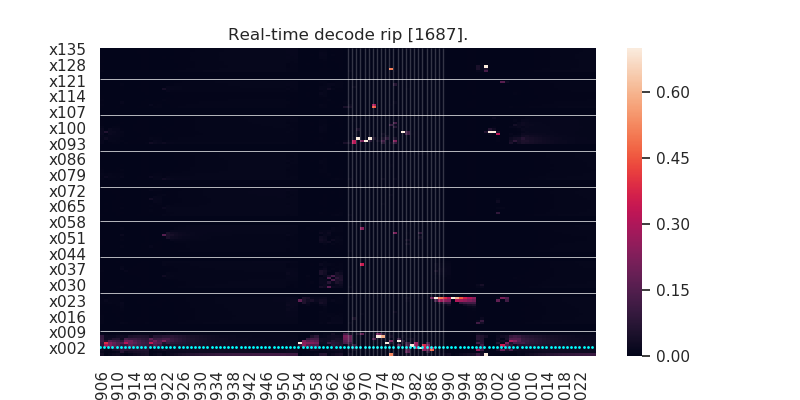

<IPython.core.display.Javascript object>


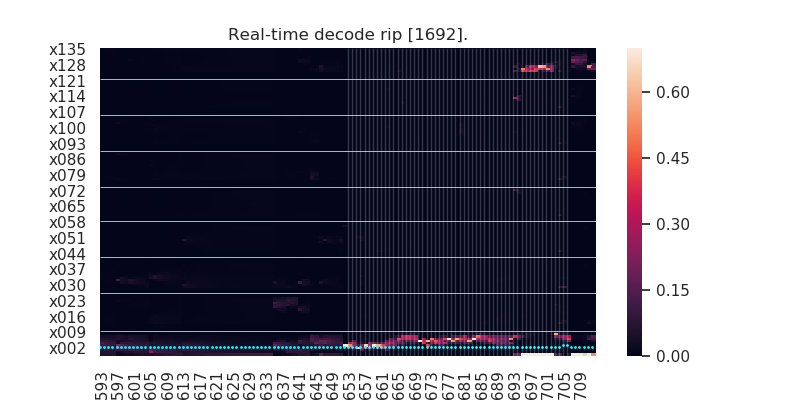

<IPython.core.display.Javascript object>


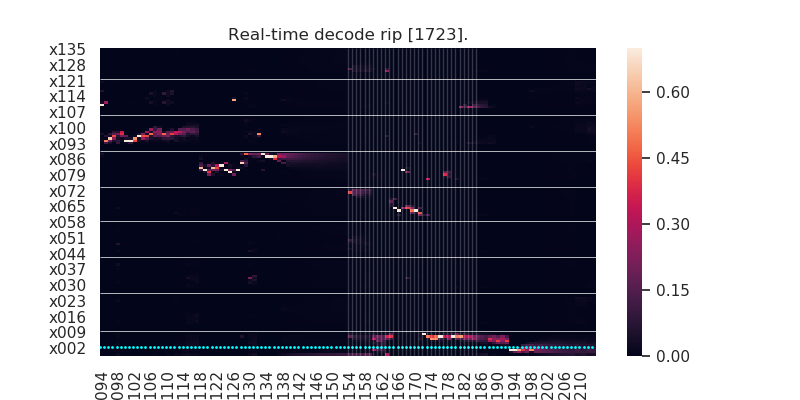

<IPython.core.display.Javascript object>


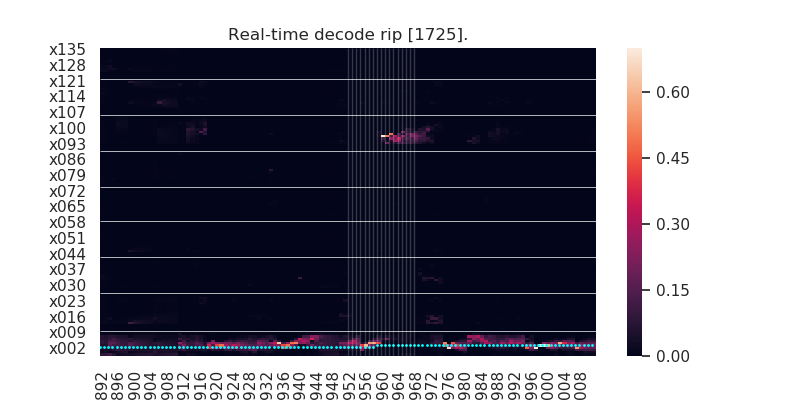

<IPython.core.display.Javascript object>


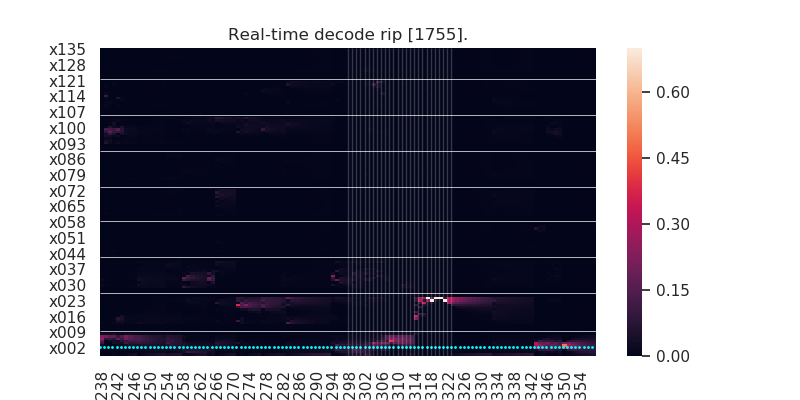

<IPython.core.display.Javascript object>


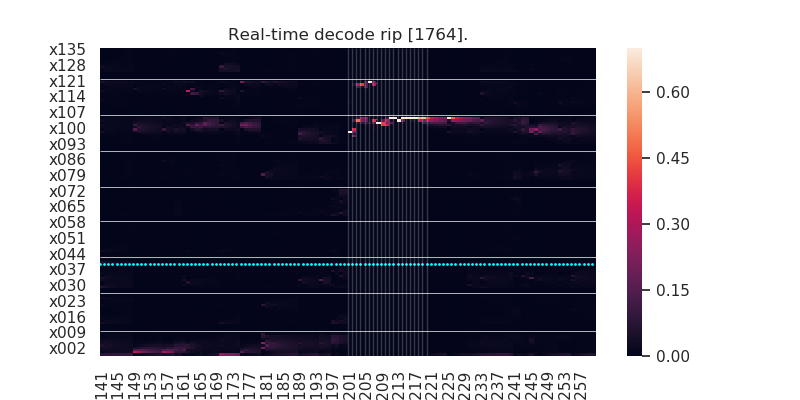

<IPython.core.display.Javascript object>


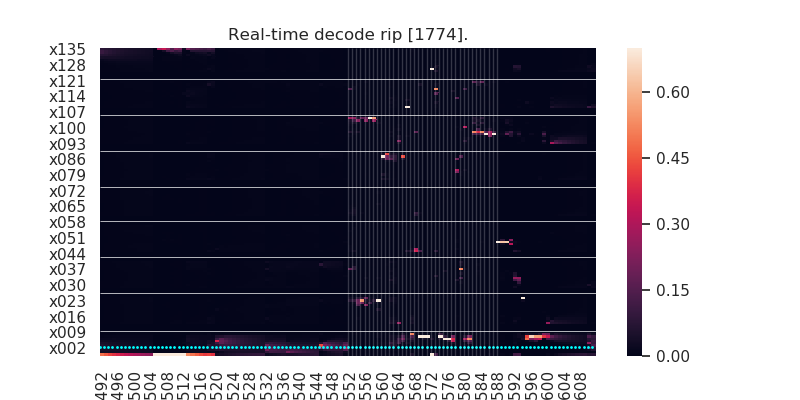

<IPython.core.display.Javascript object>


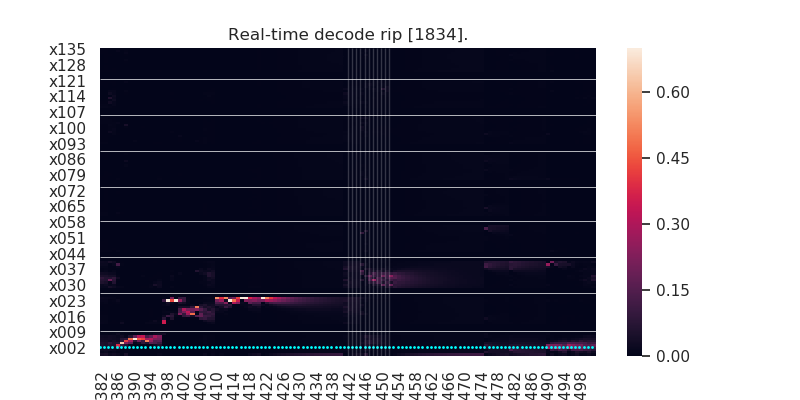

<IPython.core.display.Javascript object>


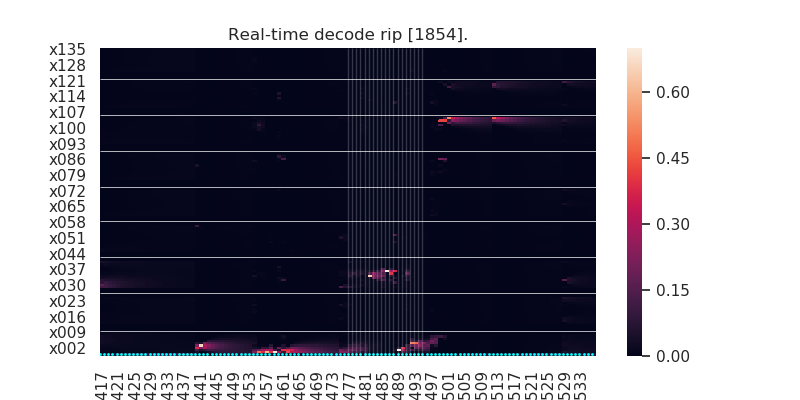

<IPython.core.display.Javascript object>


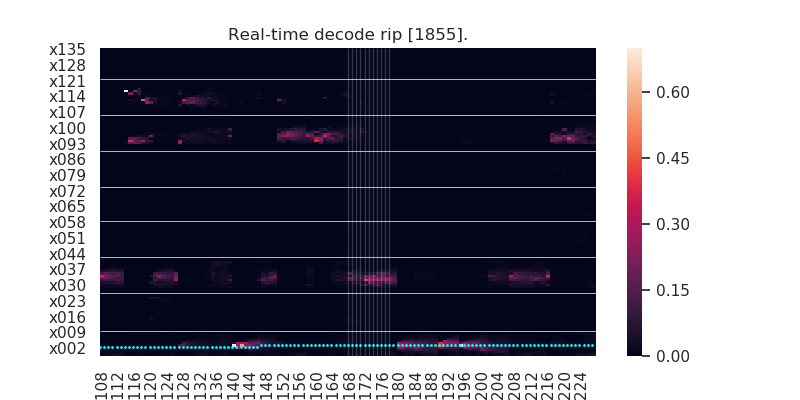

<IPython.core.display.Javascript object>


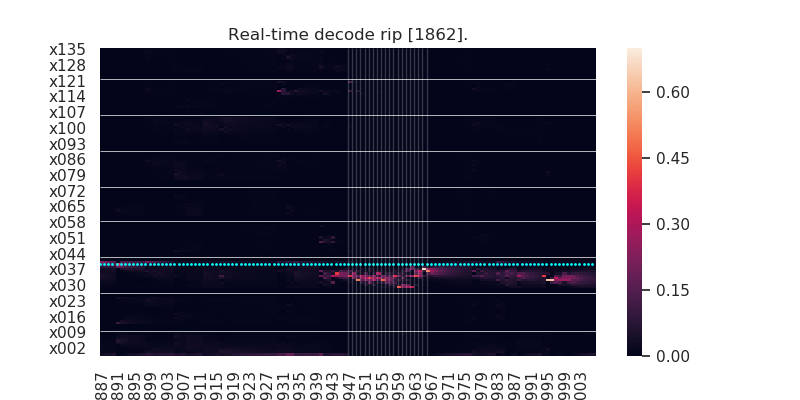

<IPython.core.display.Javascript object>


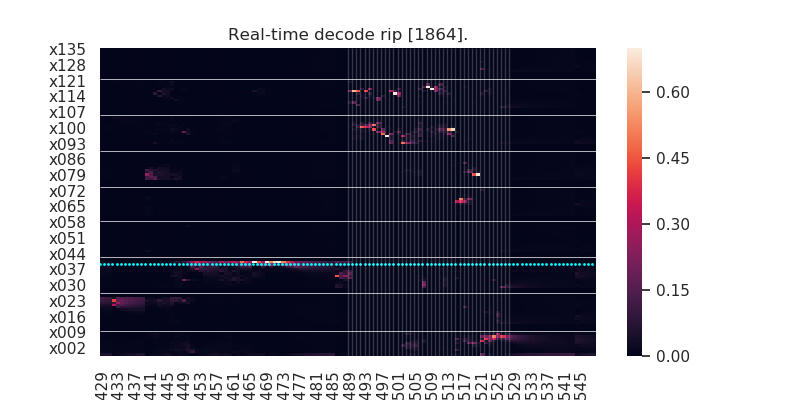

<IPython.core.display.Javascript object>


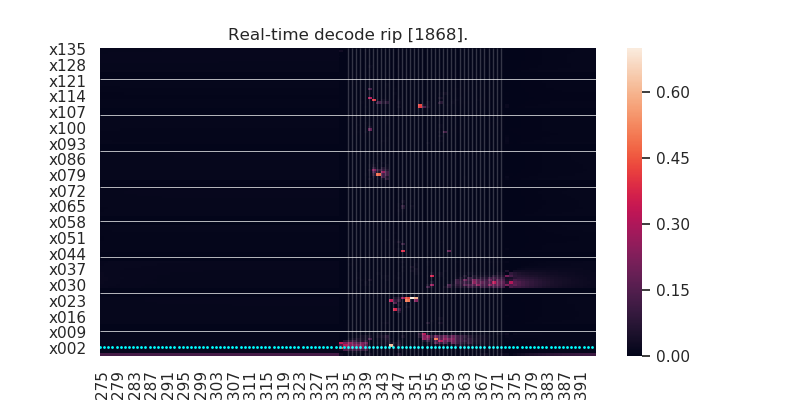

<IPython.core.display.Javascript object>


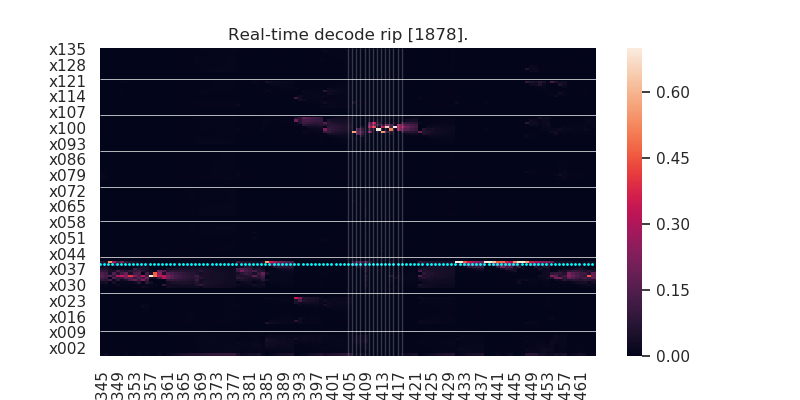

<IPython.core.display.Javascript object>


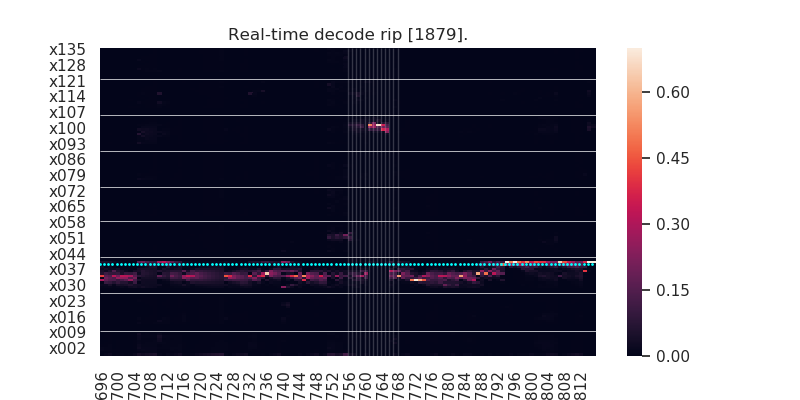

<IPython.core.display.Javascript object>


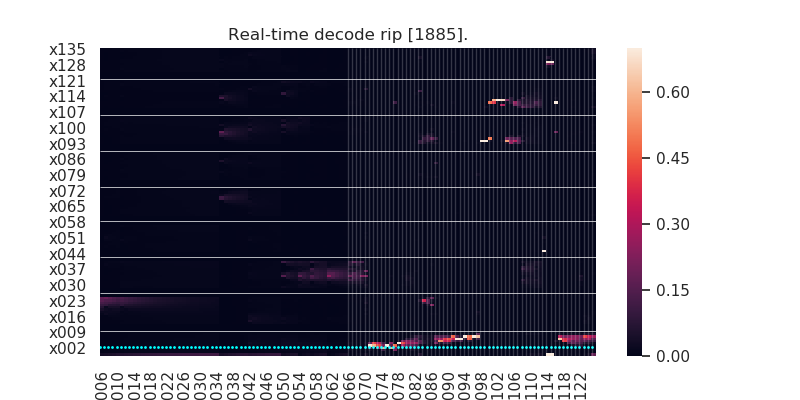

<IPython.core.display.Javascript object>


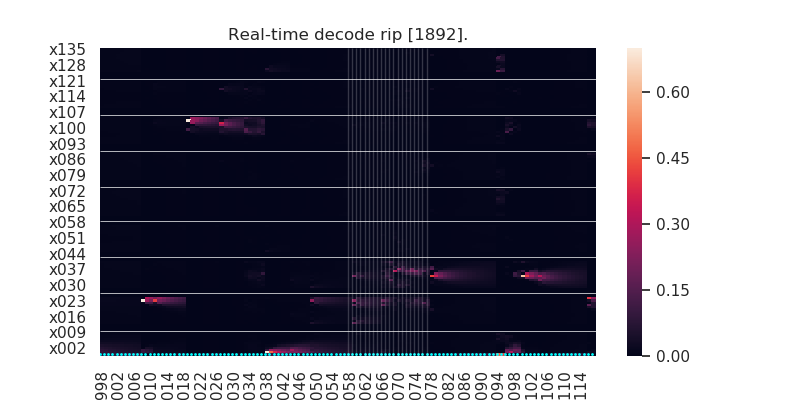

<IPython.core.display.Javascript object>


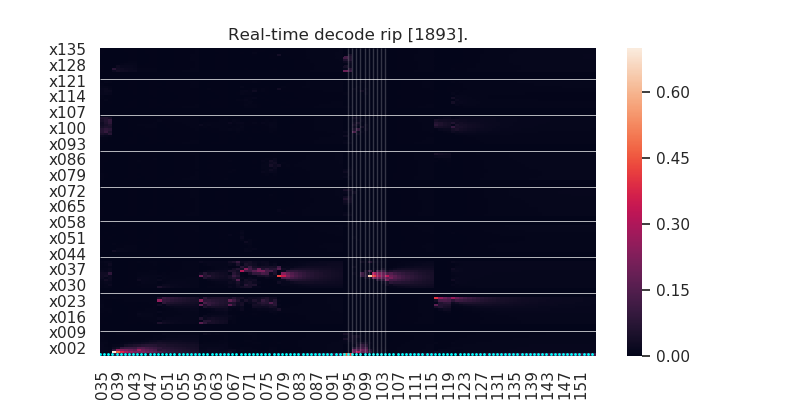

<IPython.core.display.Javascript object>


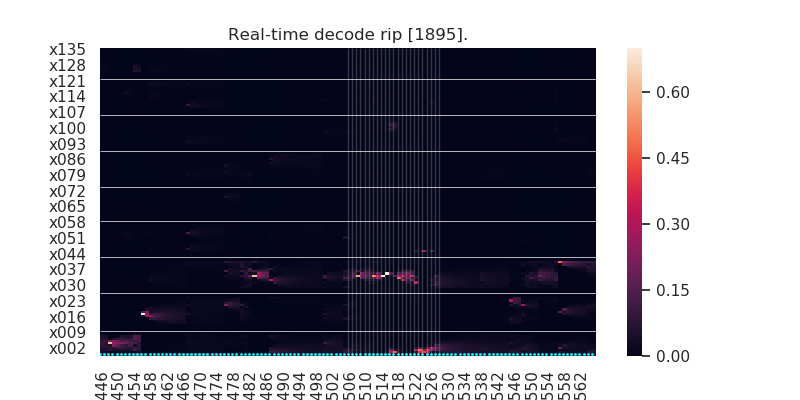

<IPython.core.display.Javascript object>


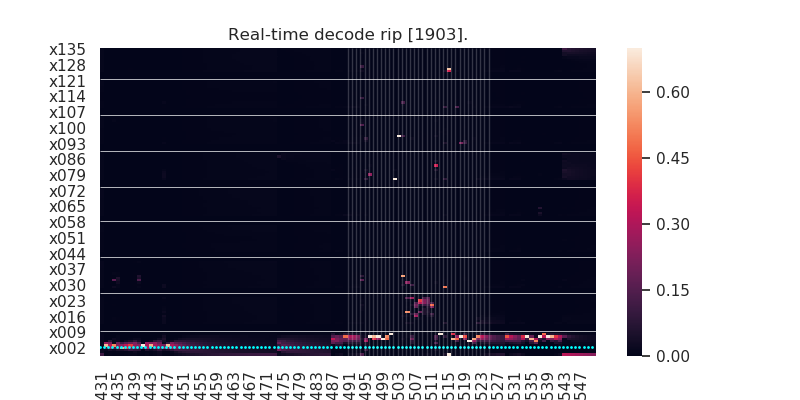

<IPython.core.display.Javascript object>


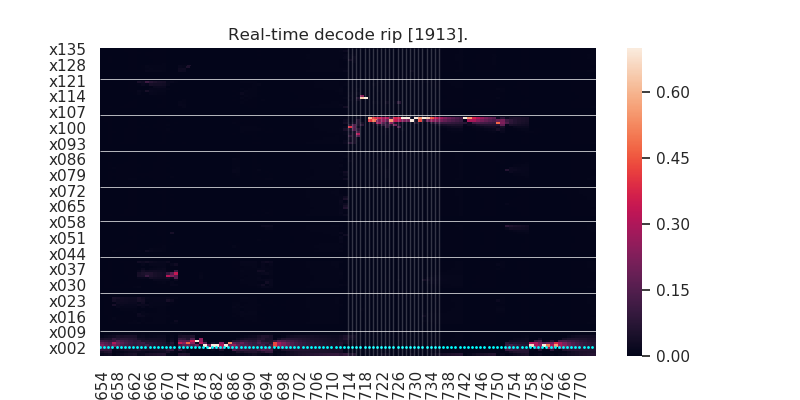

<IPython.core.display.Javascript object>


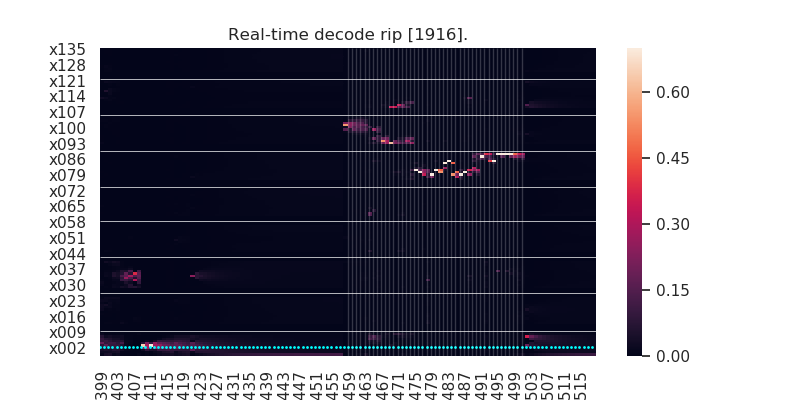

<IPython.core.display.Javascript object>


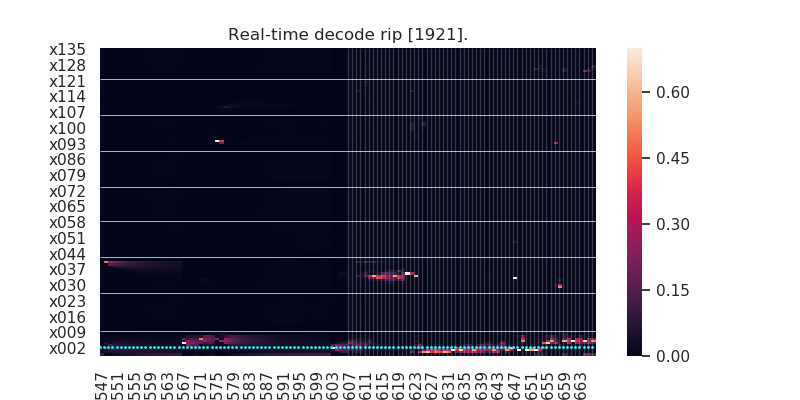

<IPython.core.display.Javascript object>


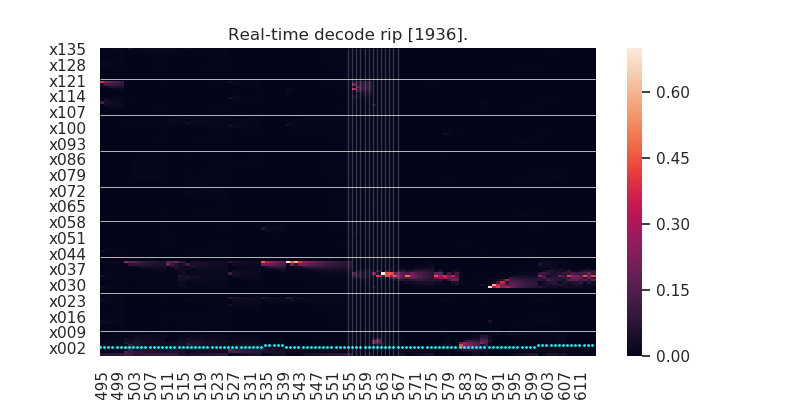

<IPython.core.display.Javascript object>


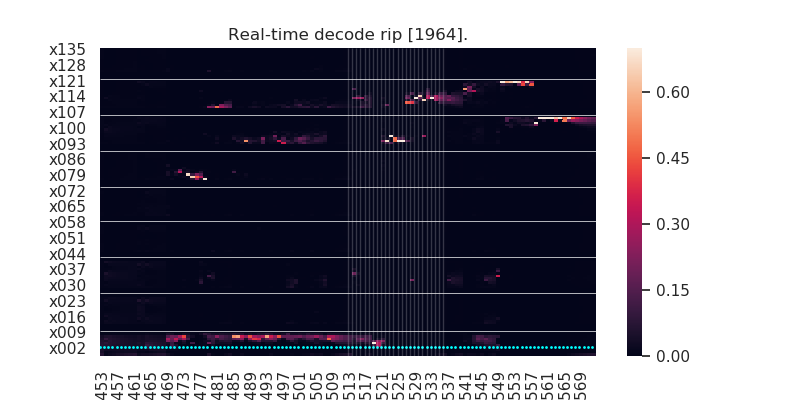

<IPython.core.display.Javascript object>


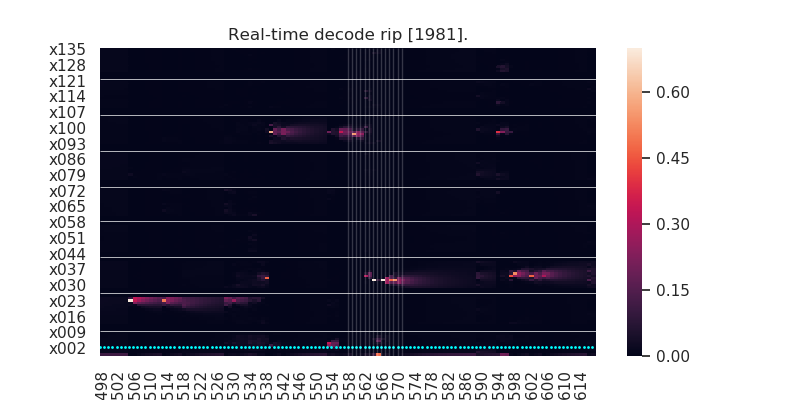

<IPython.core.display.Javascript object>


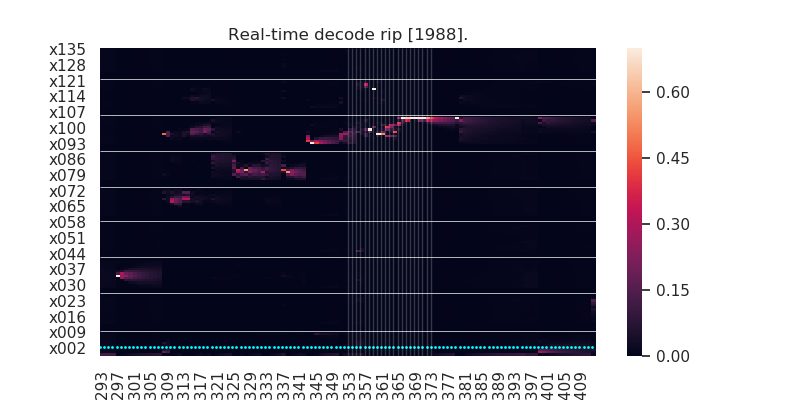

<IPython.core.display.Javascript object>


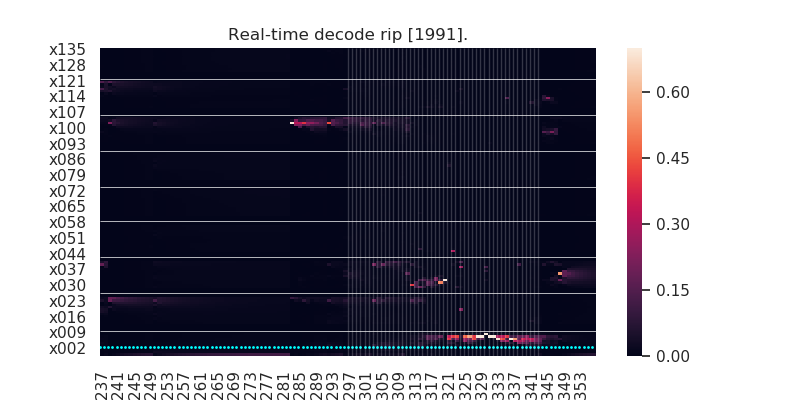

<IPython.core.display.Javascript object>


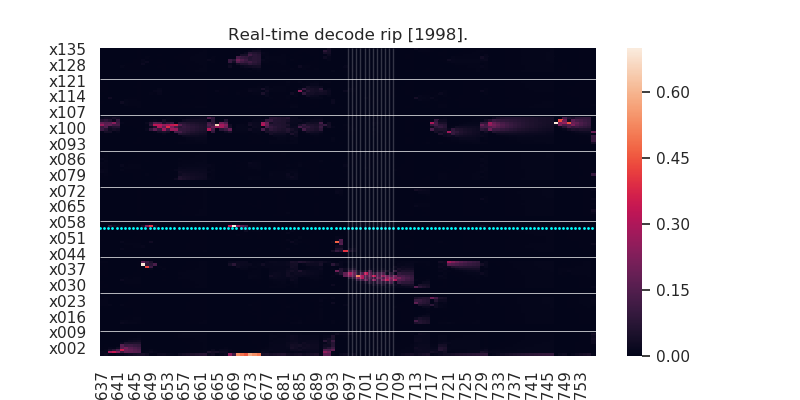

<IPython.core.display.Javascript object>


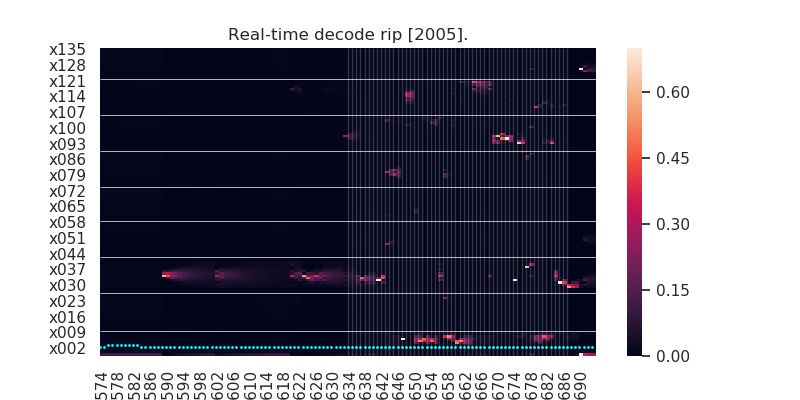

<IPython.core.display.Javascript object>


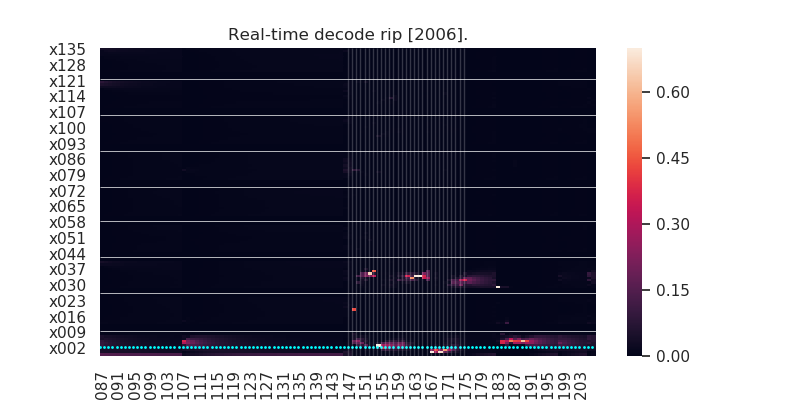

<IPython.core.display.Javascript object>


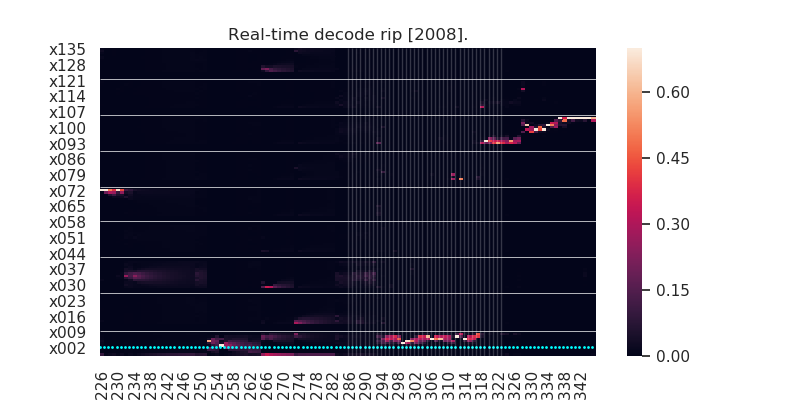

<IPython.core.display.Javascript object>


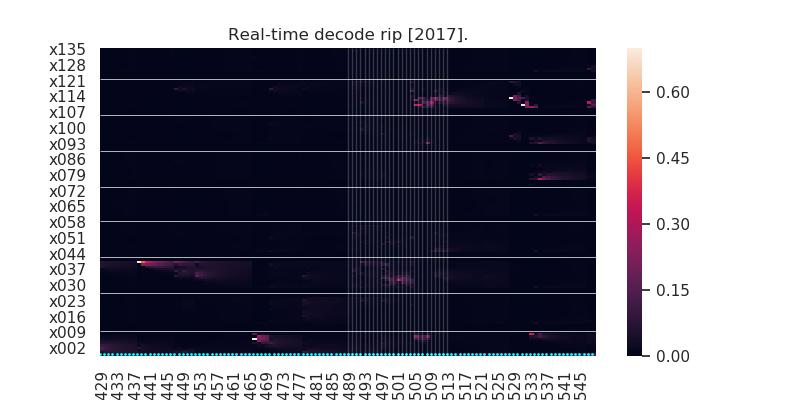

<IPython.core.display.Javascript object>


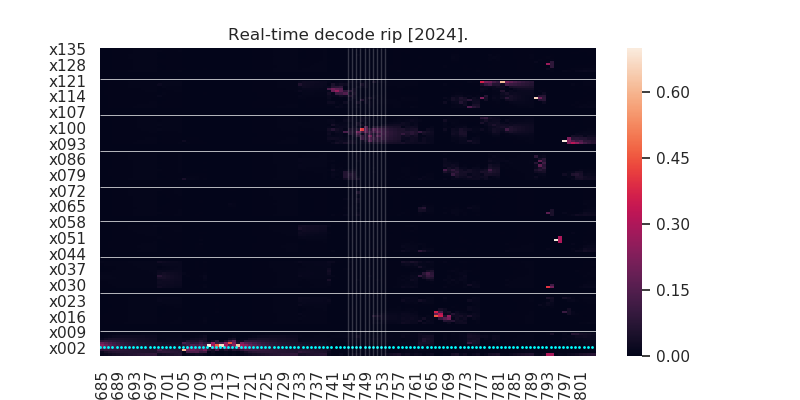

<IPython.core.display.Javascript object>


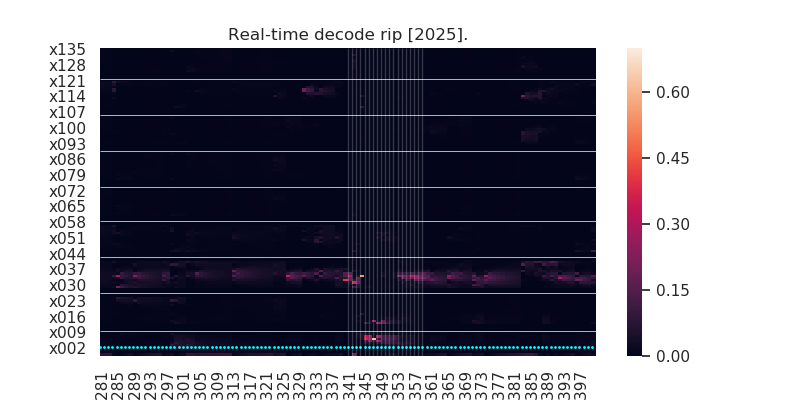

<IPython.core.display.Javascript object>


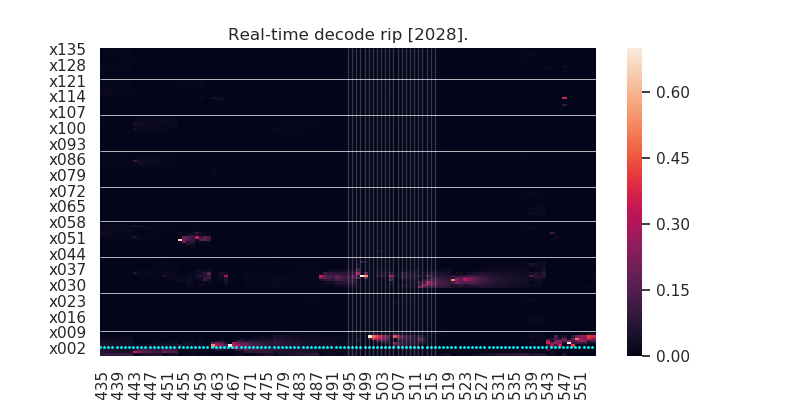

<IPython.core.display.Javascript object>


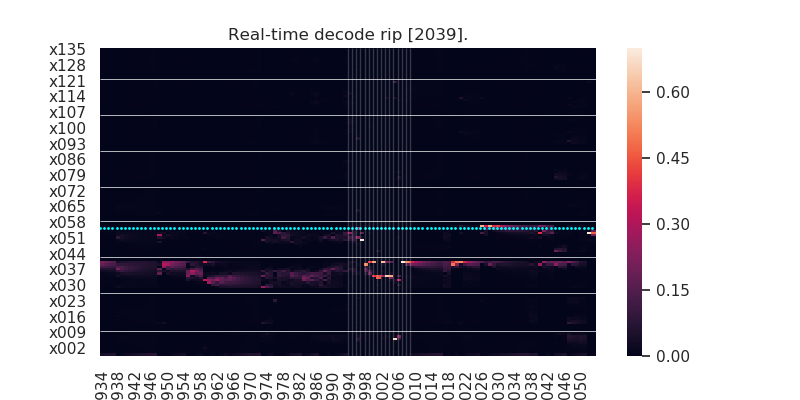

<IPython.core.display.Javascript object>


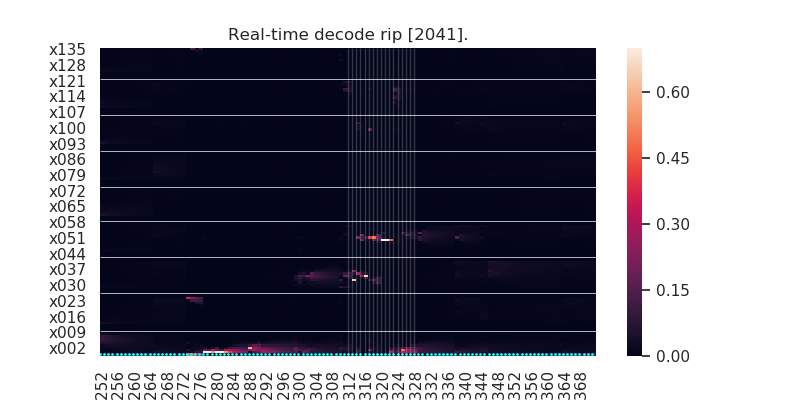

<IPython.core.display.Javascript object>


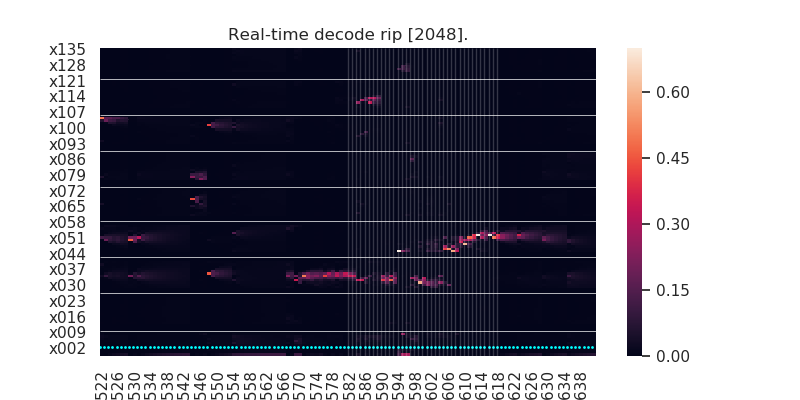

<IPython.core.display.Javascript object>


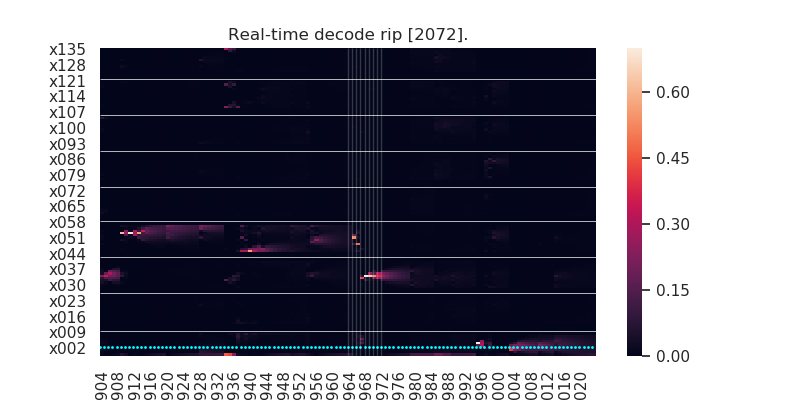

<IPython.core.display.Javascript object>


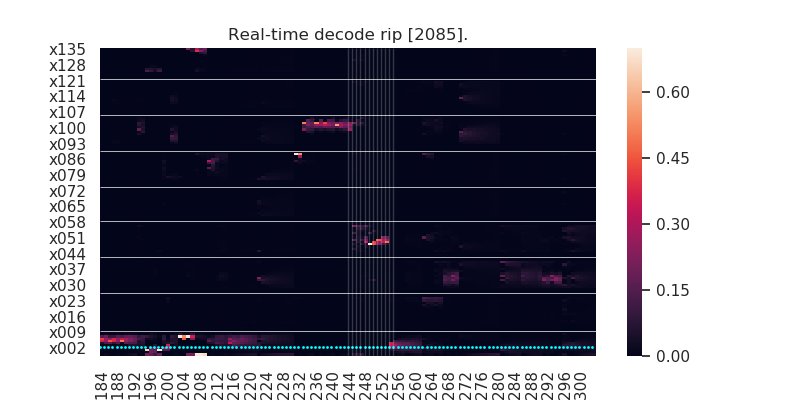

<IPython.core.display.Javascript object>


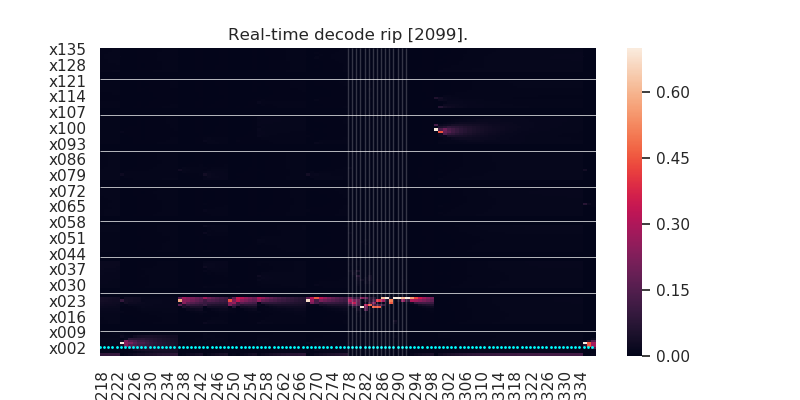

<IPython.core.display.Javascript object>


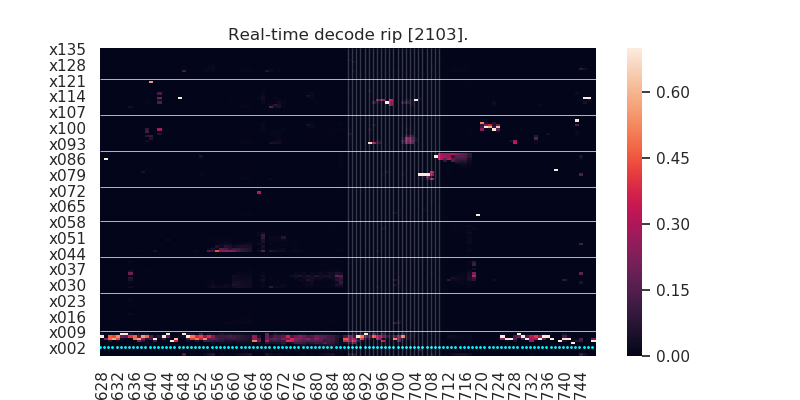

<IPython.core.display.Javascript object>


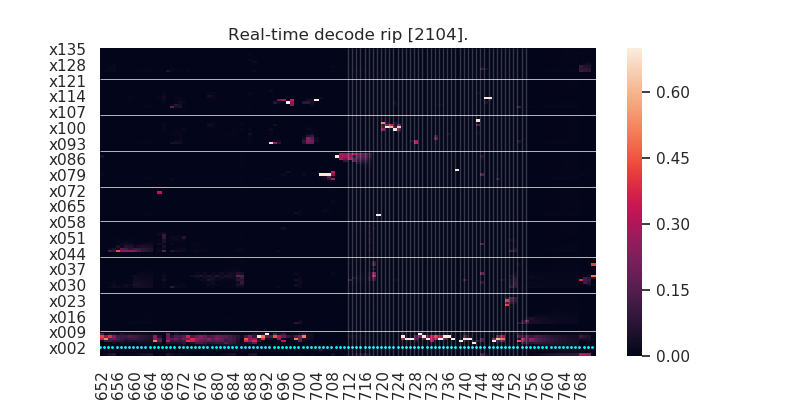

<IPython.core.display.Javascript object>


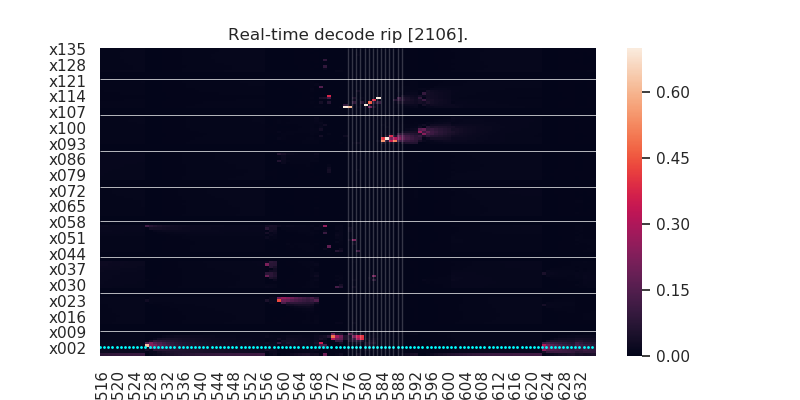

<IPython.core.display.Javascript object>


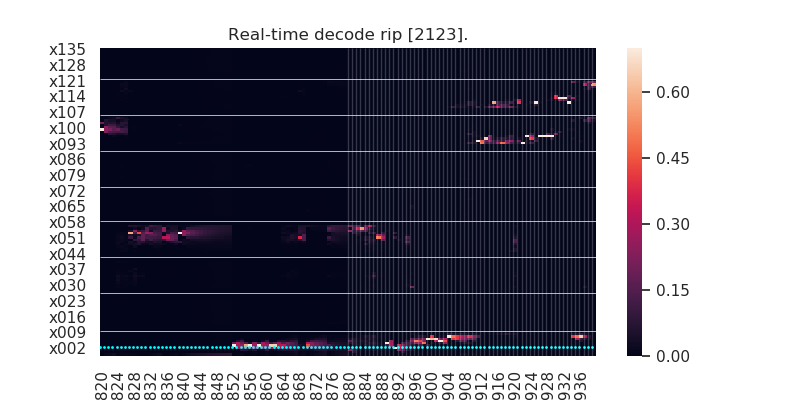

<IPython.core.display.Javascript object>


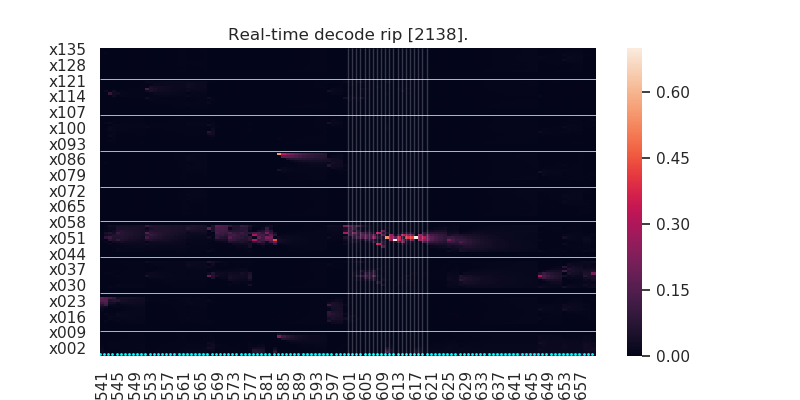

<IPython.core.display.Javascript object>


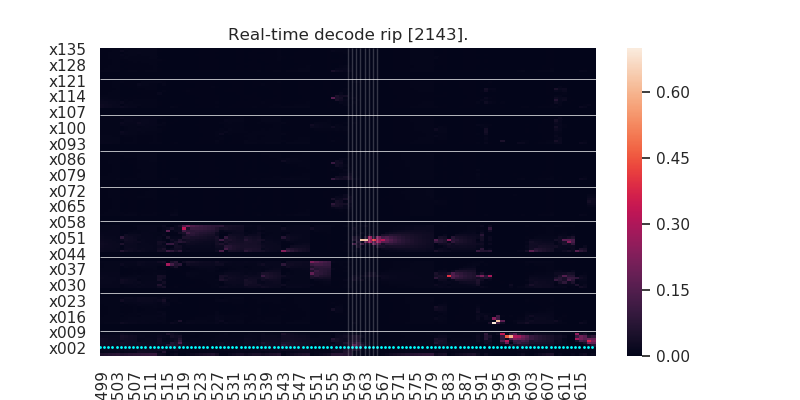

<IPython.core.display.Javascript object>


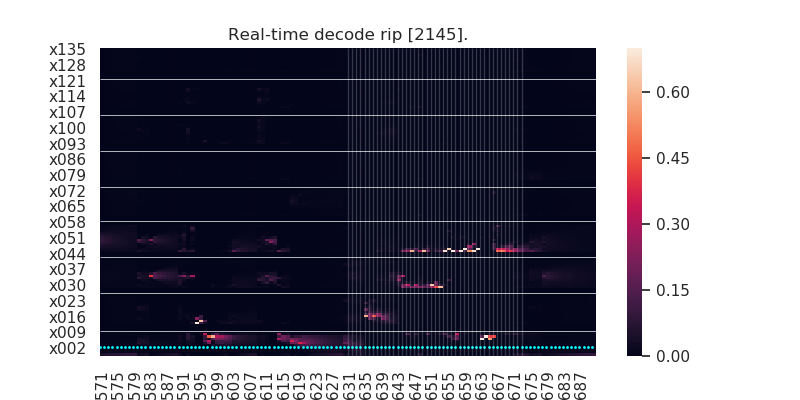

<IPython.core.display.Javascript object>


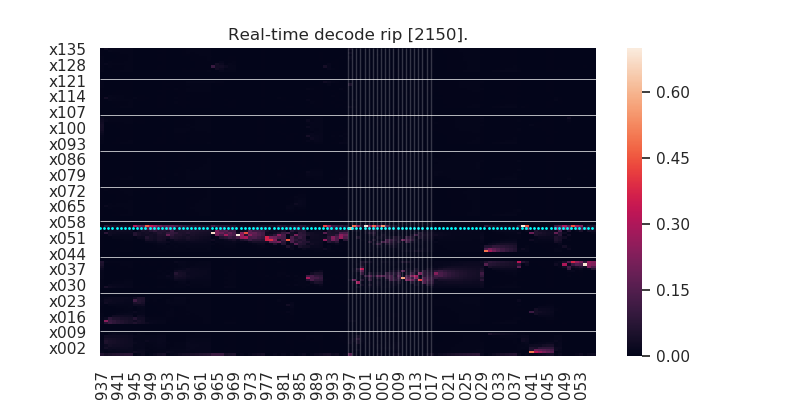

<IPython.core.display.Javascript object>


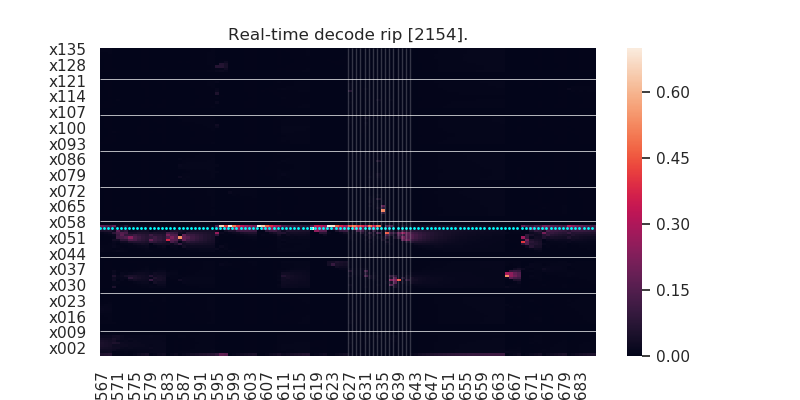

<IPython.core.display.Javascript object>


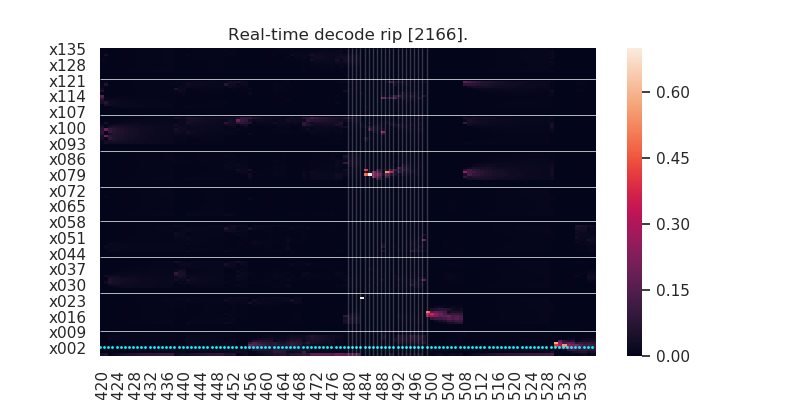

<IPython.core.display.Javascript object>


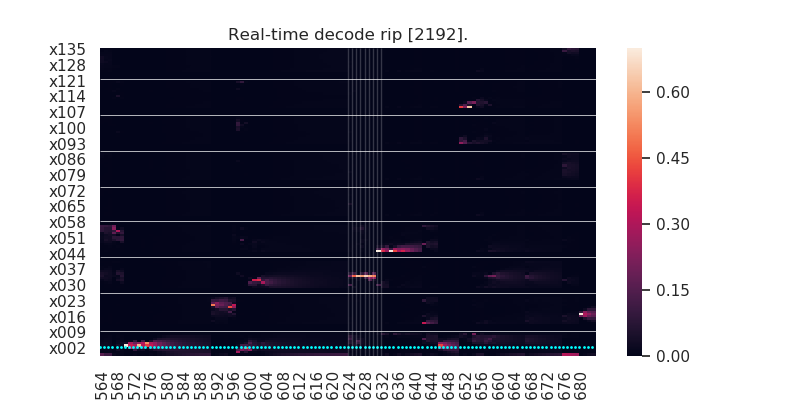

<IPython.core.display.Javascript object>


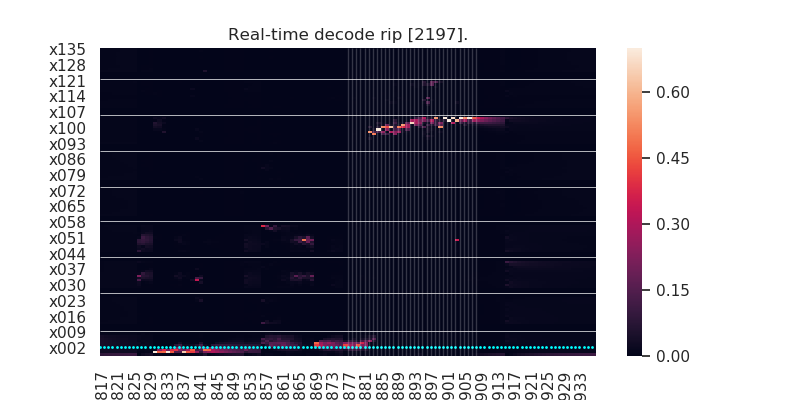

<IPython.core.display.Javascript object>


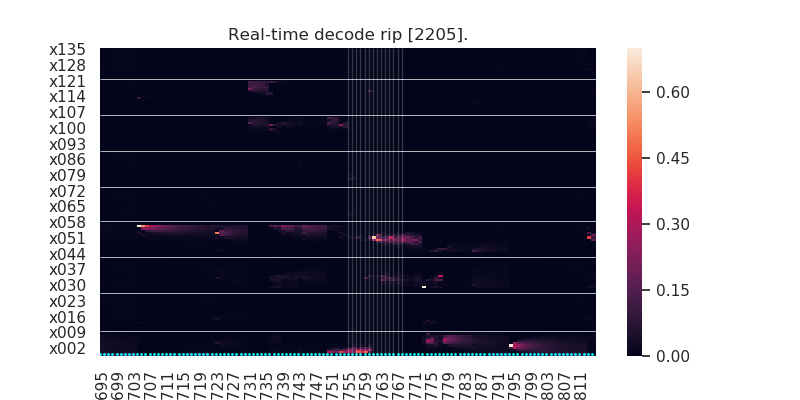

<IPython.core.display.Javascript object>


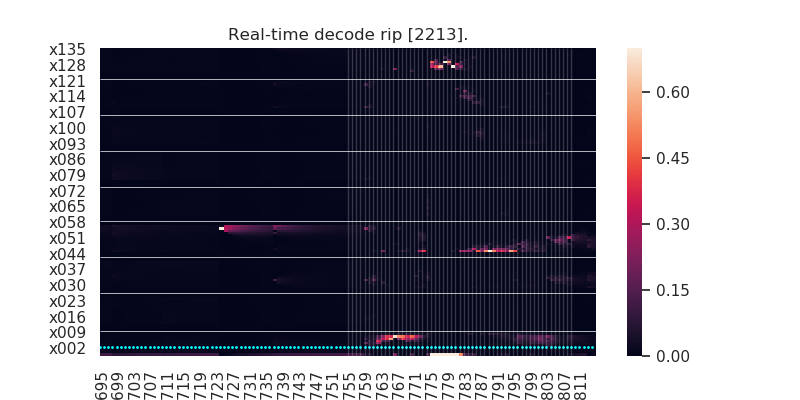

<IPython.core.display.Javascript object>


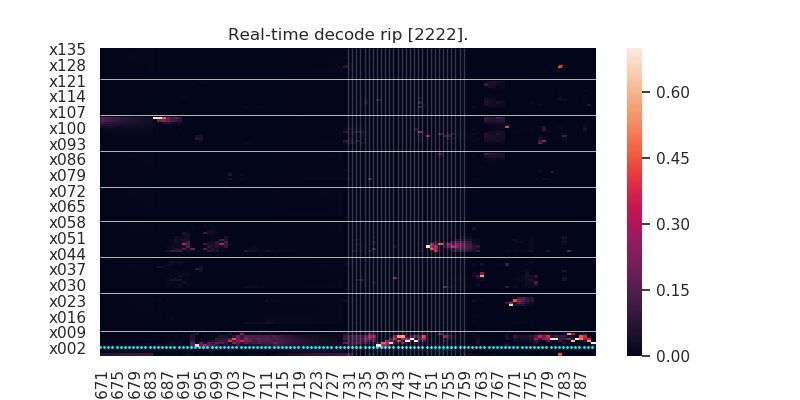

<IPython.core.display.Javascript object>


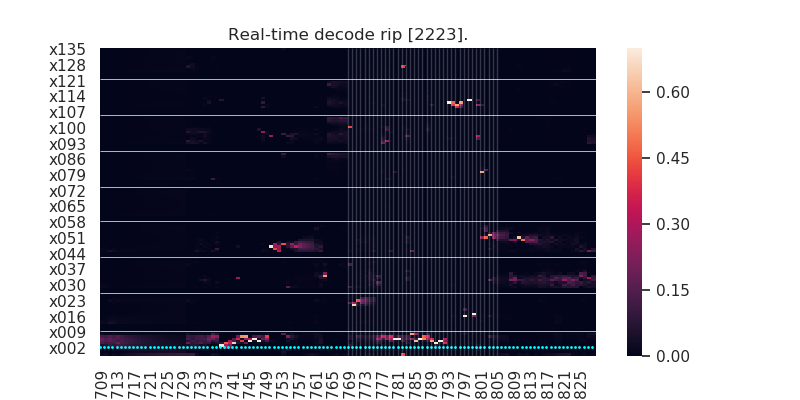

<IPython.core.display.Javascript object>


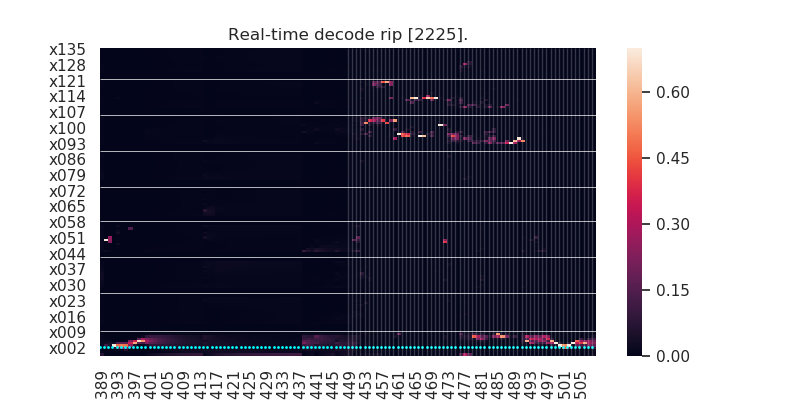

<IPython.core.display.Javascript object>


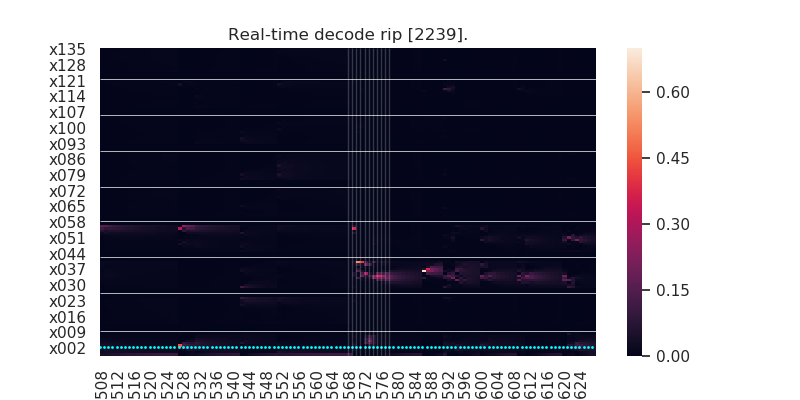

<IPython.core.display.Javascript object>


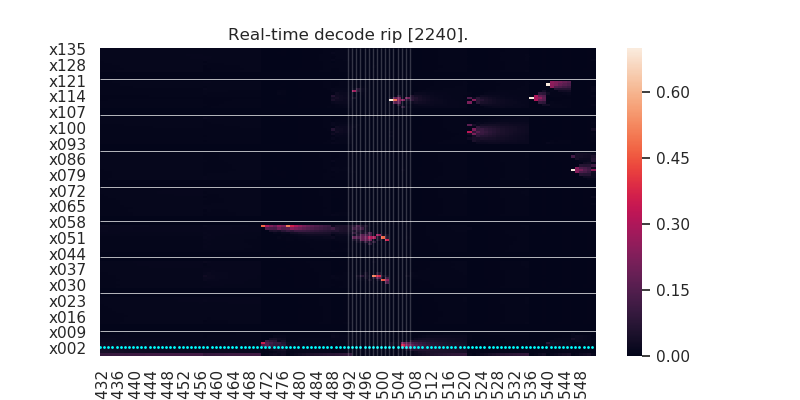

<IPython.core.display.Javascript object>


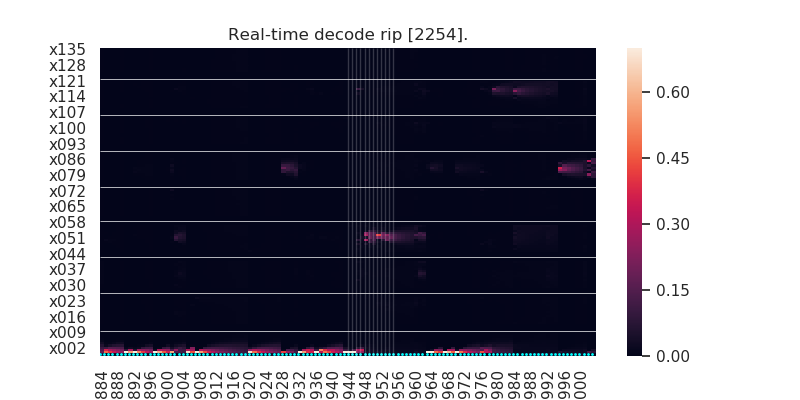

<IPython.core.display.Javascript object>


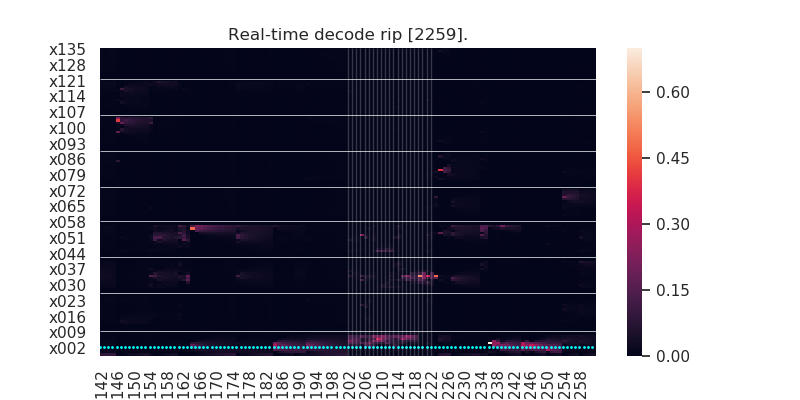

In [52]:
# plot heatmap of posterior for real-time decoder-data
# this is with trans mat offset = 0.001

#timestamp offset:
# remy day 20, epoch 2: 1958987
# gus day 17 epoch 3: 88254102

# real-time arm coords
arm_coords =  [[0,8],[13,24],[29,40],[45,56],[61,72],[77,88],[93,104],[109,120],[125,136]]

# real-time timestamps for offline ripples
realtime_off_rips = rips.copy()
realtime_off_rips['start'] = (rips['starttime'].values*30000)-1958987
realtime_off_rips['end'] = (rips['endtime'].values*30000)-1958987
realtime_off_rips = realtime_off_rips.reset_index()

summarize_all_rips_offline = True

# set which decoder_data file to use
merged_off_post_pos = decoder_data1.copy()
#merged_off_post_pos = likelihood_data5.copy()

# need to start at row 18 to match decoder_data time, and end at -1
for index, rip_timestamp in enumerate(realtime_off_rips['start'][600:-1]):
    adj_index = index+600
    short_ripple = False
    # to plot all ripples
    #if summarize_all_rips_offline:
    # to plot false positive mismatch replays
    if realtime_off_rips['event'][adj_index:adj_index+1].values in false_positive_data['offline_rip_off'].values:
        #print(matching_offline_rips['lockout_num'][index:index+1].values)
        #print(rip_timestamp-30*300,rip_timestamp+30*300,index)
        
        posterior_to_plot = merged_off_post_pos[(merged_off_post_pos['bin_timestamp'] > rip_timestamp-30*300) & 
                                            (merged_off_post_pos['bin_timestamp'] < rip_timestamp+30*300)]
        #print(posterior_to_plot.shape)
        ripple_num = realtime_off_rips[adj_index:adj_index+1]['event'].values
        ripple_start = realtime_off_rips[adj_index:adj_index+1]['start'].values
        ripple_end = realtime_off_rips[adj_index:adj_index+1]['end'].values
        #print(ripple_num,ripple_start,ripple_end,index,adj_index)

        ripple_times = posterior_to_plot.index[(posterior_to_plot['bin_timestamp'] > ripple_start[0]) &
                                              (posterior_to_plot['bin_timestamp'] < ripple_end[0])].tolist()

        # for posteriors
        posterior_offline1 = posterior_to_plot.iloc[:,24:161]
        # for likelihoods
        #posterior_offline1 = posterior_to_plot.iloc[:,5:142]
        
        posterior_offline2 = posterior_offline1.fillna(0)
        post_heatmap = posterior_offline2.transpose()
        post_heatmap = post_heatmap.iloc[::-1]

        plt.figure(figsize=(8,4))
        plt.title(f'Real-time decode rip {ripple_num}.')
        ax = (sns.heatmap(post_heatmap,vmin=0, vmax=0.7))
        ax.hlines([136-10,136-27,136-43,136-59,136-74,136-90,136-106,136-122], lw=0.5, color='w',*ax.get_xlim())
        ax.scatter(np.arange(0,posterior_to_plot.shape[0]),136-posterior_to_plot['real_pos'].values,s=1,alpha=1,color='cyan')
        ax.vlines([ripple_times-posterior_to_plot.index[0]],lw=1,color='w',alpha=0.2,*ax.get_ylim())
    
        # final step: save the figure
        #plt.savefig(f'/stelmo/mcoulter/posterior_plots_by_ripple/4_17_20/remy_20_2_realtime_false_pos_{ripple_num}_timestamp_{rip_timestamp}.jpg')


In [ ]:
posterior_to_plot.iloc[:,5:142]
offline_rips_plot
false_positive_data

<IPython.core.display.Javascript object>


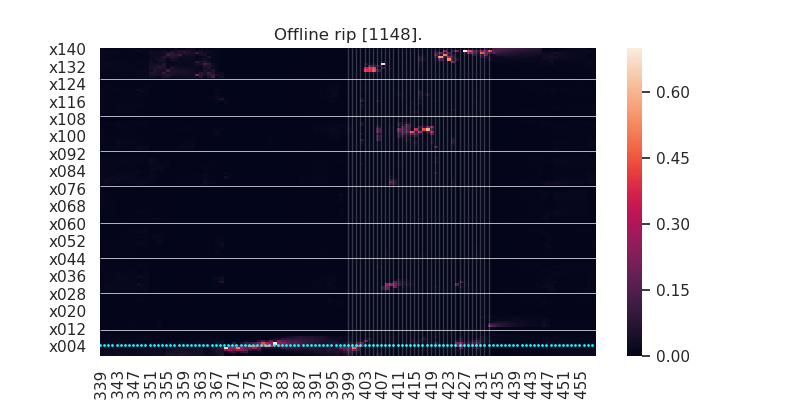

<IPython.core.display.Javascript object>


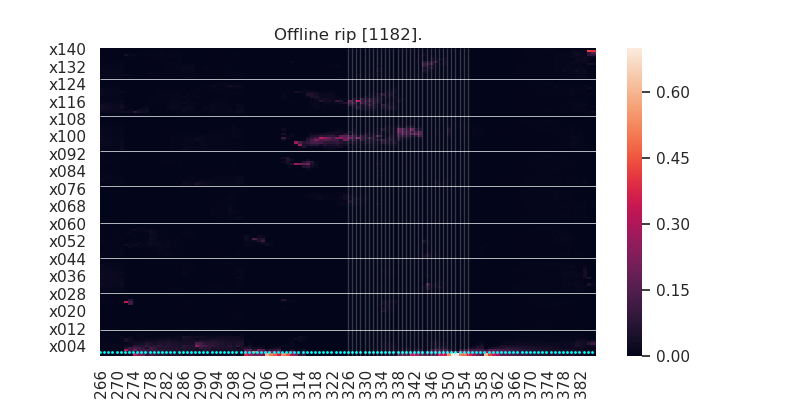

<IPython.core.display.Javascript object>


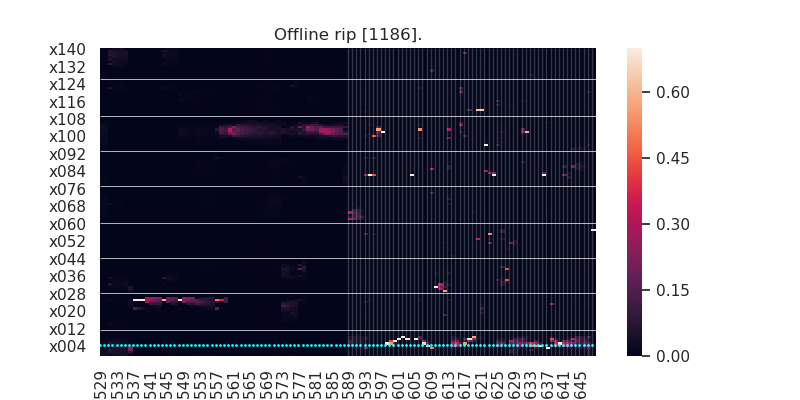

<IPython.core.display.Javascript object>


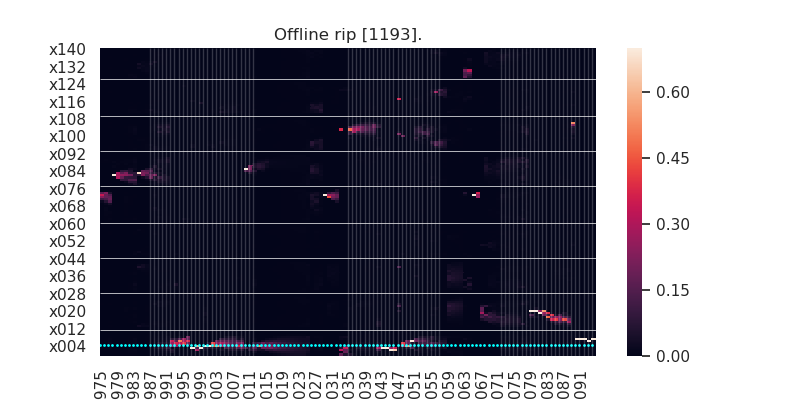

<IPython.core.display.Javascript object>


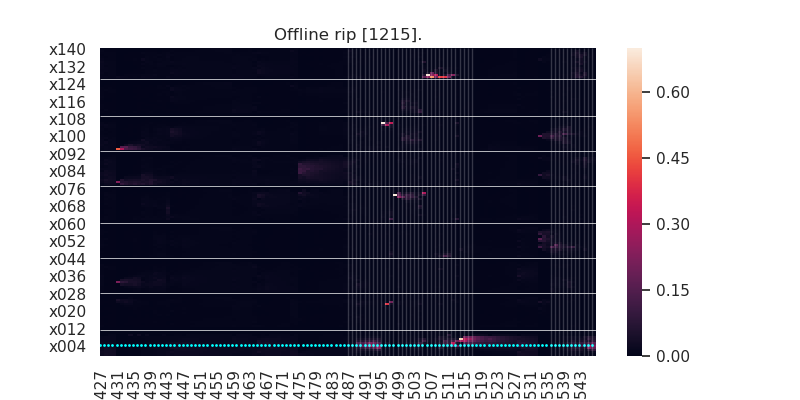

<IPython.core.display.Javascript object>


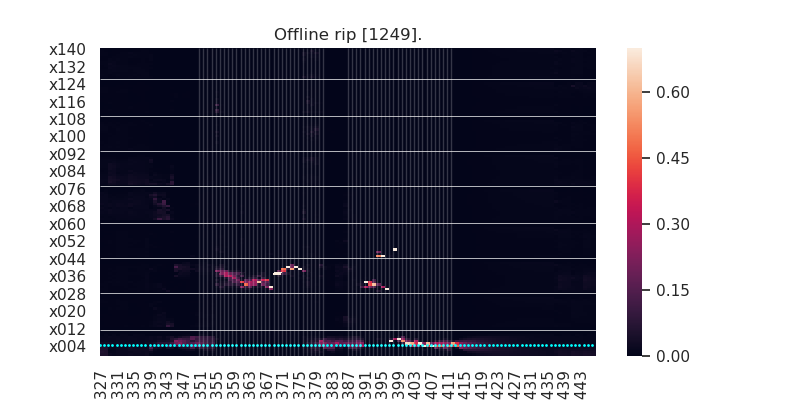

<IPython.core.display.Javascript object>


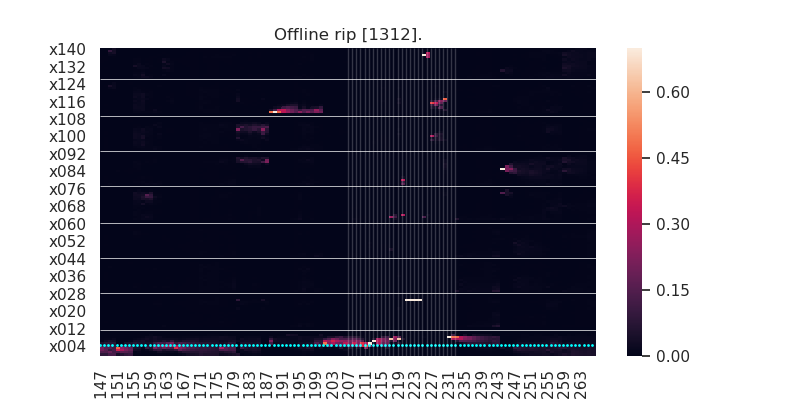

<IPython.core.display.Javascript object>


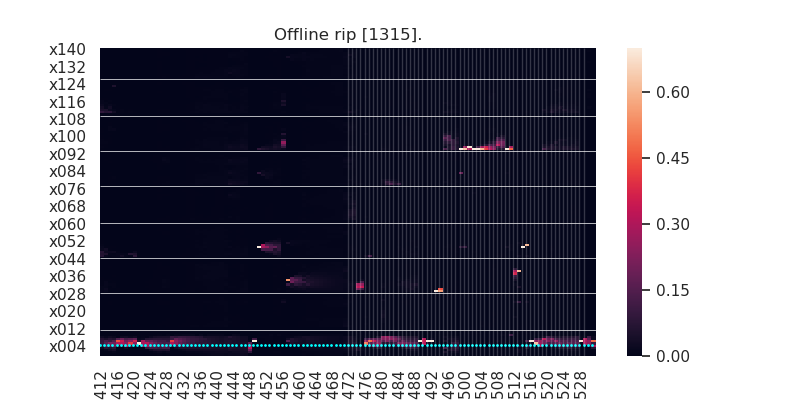

<IPython.core.display.Javascript object>


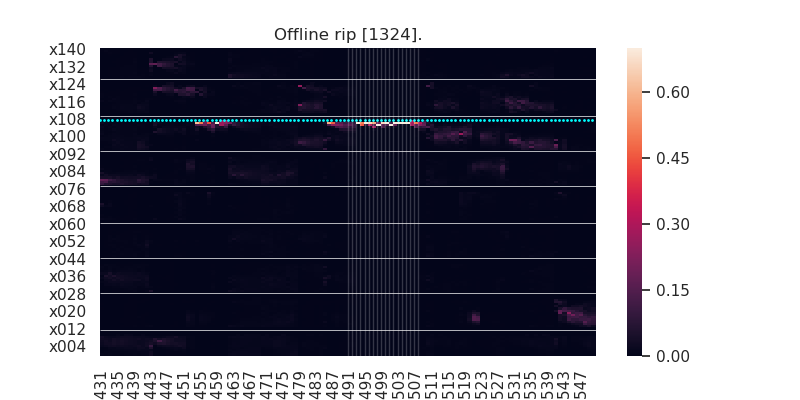

<IPython.core.display.Javascript object>


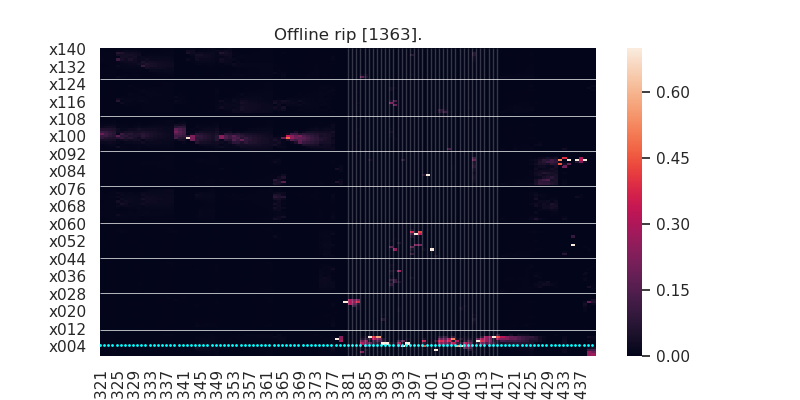

<IPython.core.display.Javascript object>


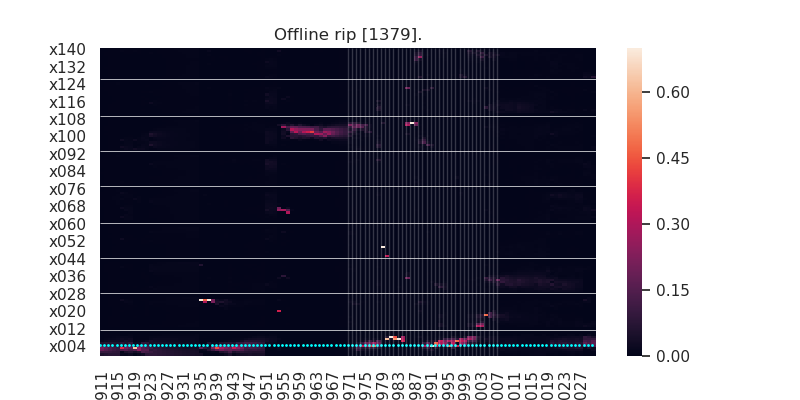

<IPython.core.display.Javascript object>


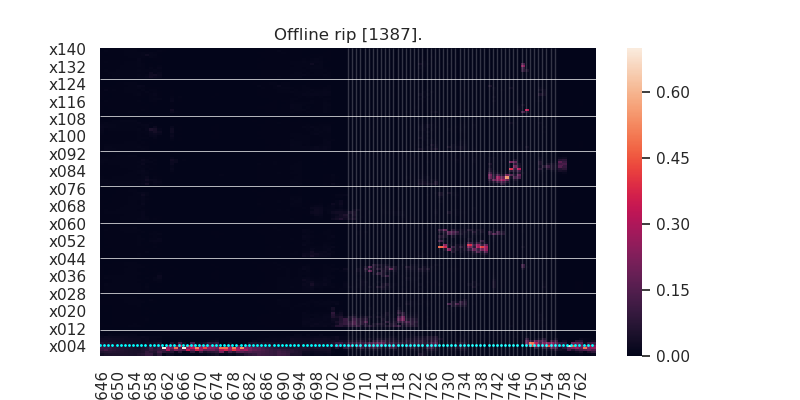

<IPython.core.display.Javascript object>


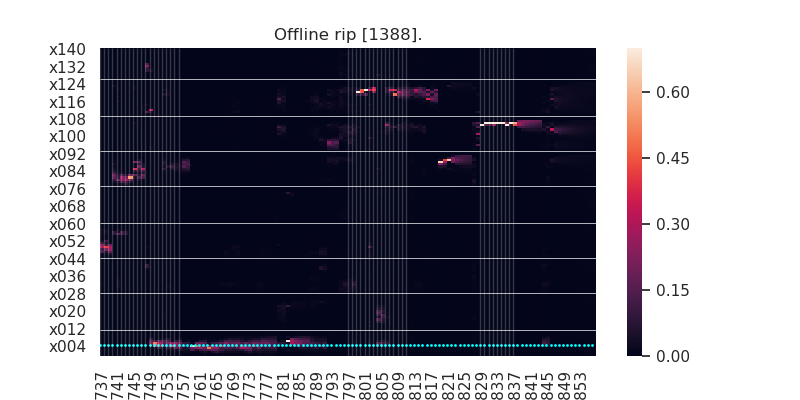

<IPython.core.display.Javascript object>


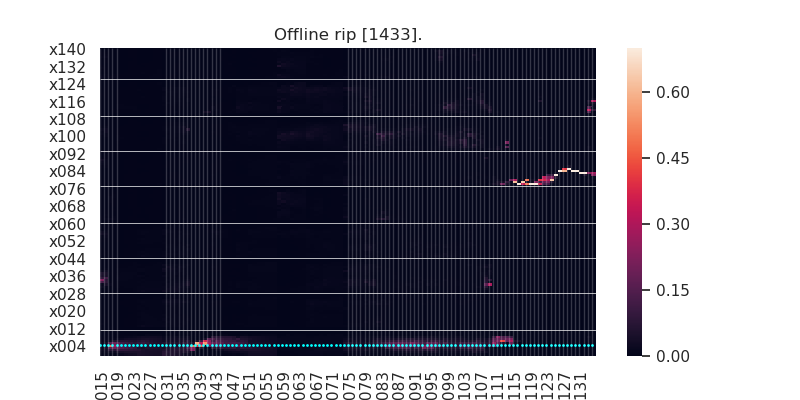

<IPython.core.display.Javascript object>


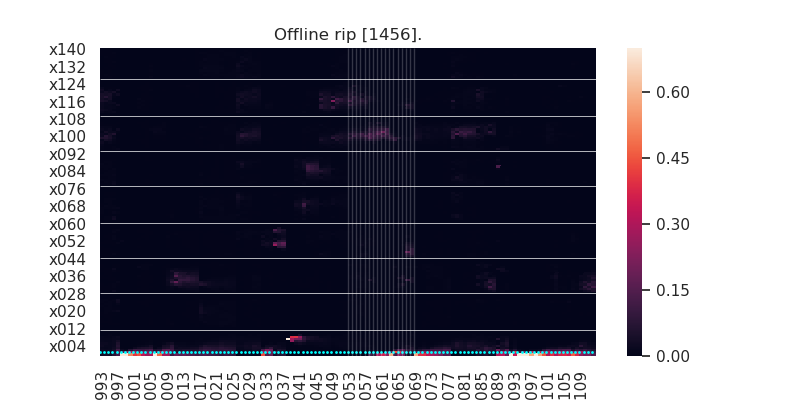

<IPython.core.display.Javascript object>


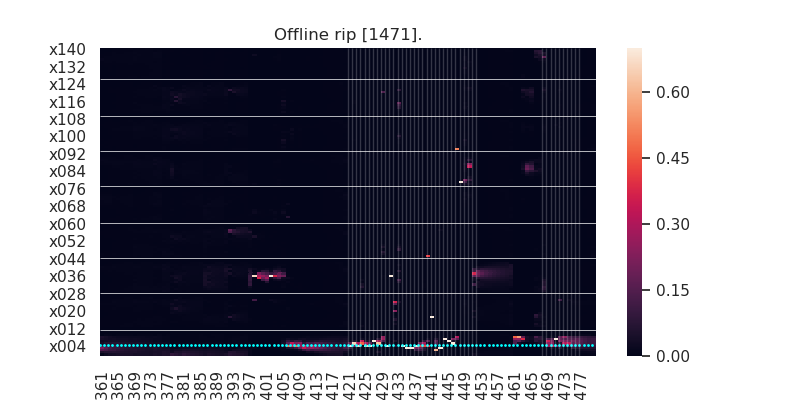

<IPython.core.display.Javascript object>


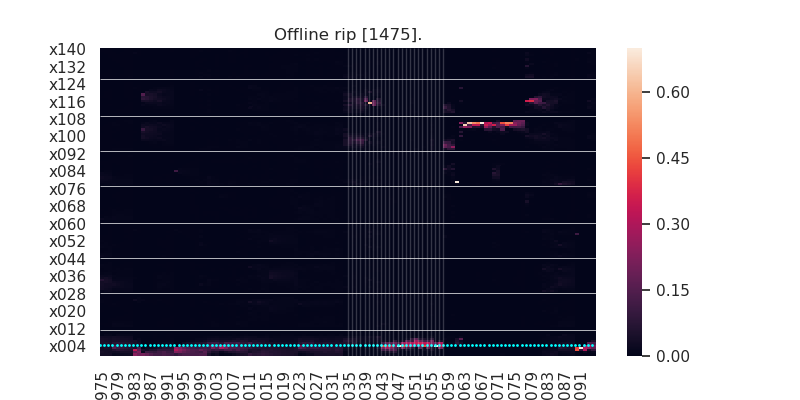

<IPython.core.display.Javascript object>


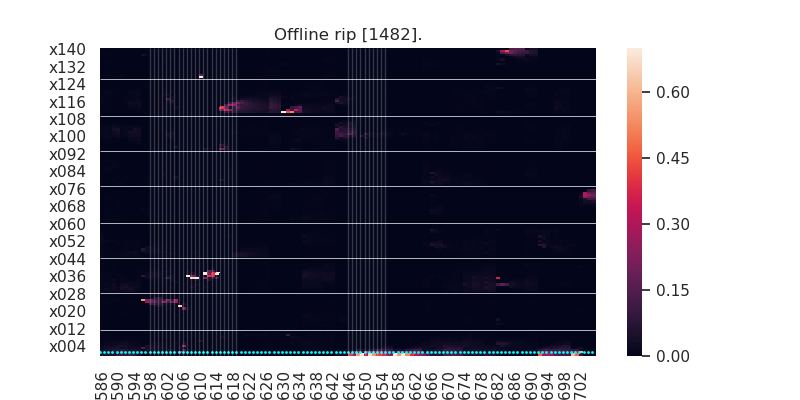

<IPython.core.display.Javascript object>


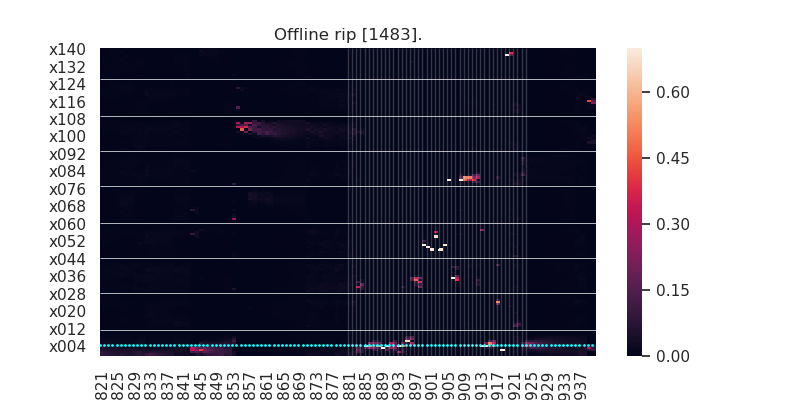

<IPython.core.display.Javascript object>


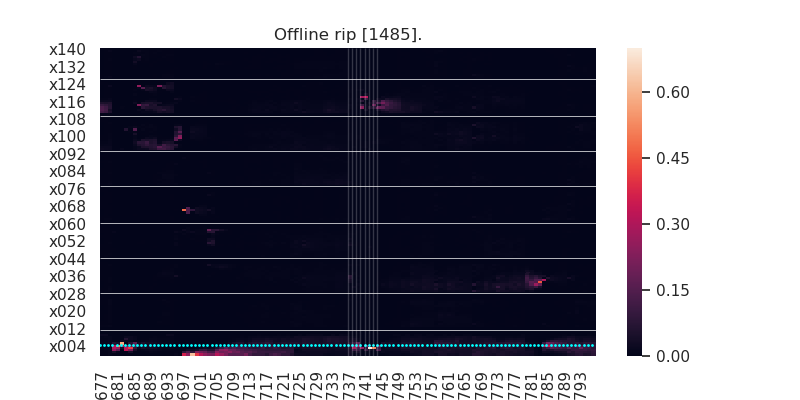

<IPython.core.display.Javascript object>


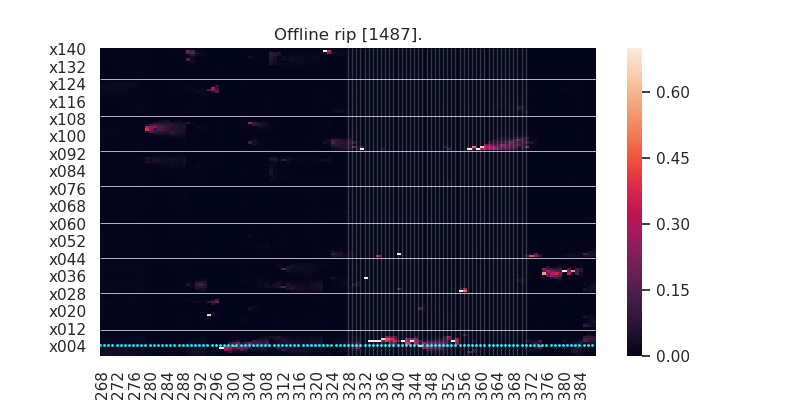

<IPython.core.display.Javascript object>


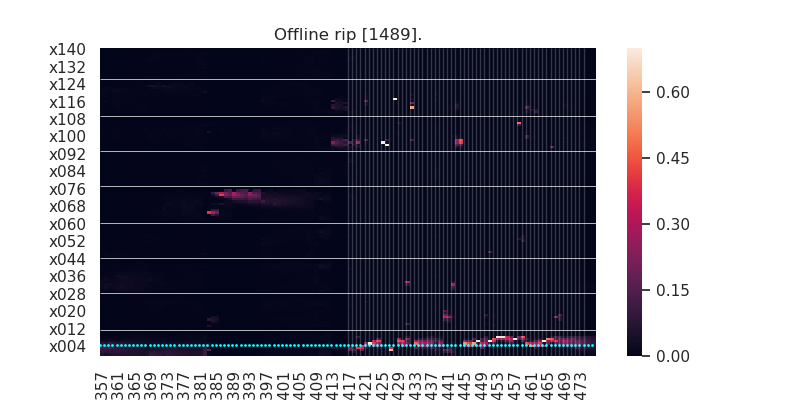

<IPython.core.display.Javascript object>


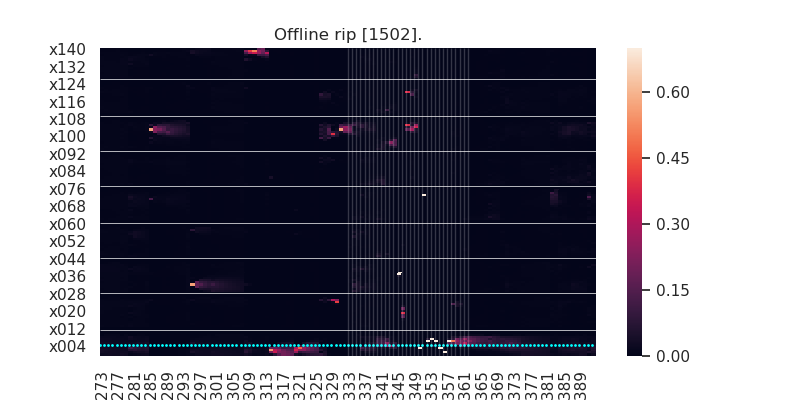

<IPython.core.display.Javascript object>


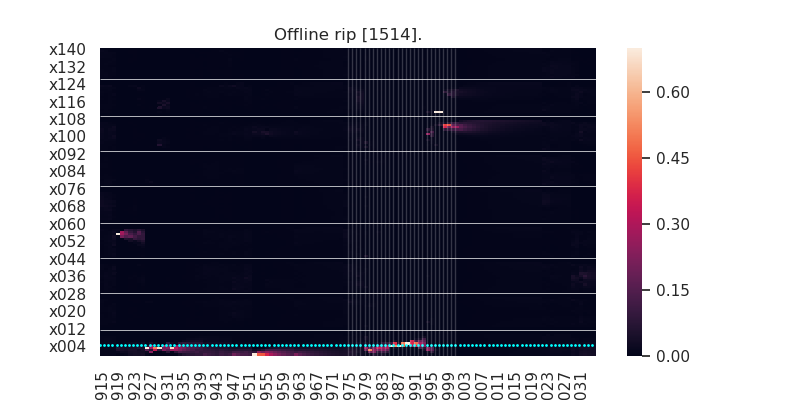

<IPython.core.display.Javascript object>


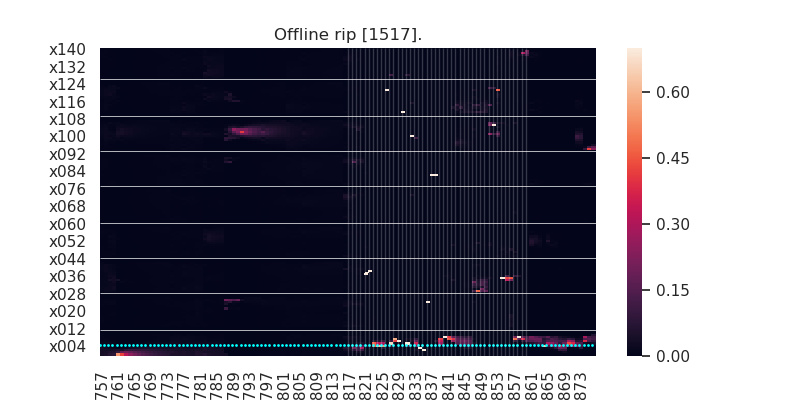

<IPython.core.display.Javascript object>


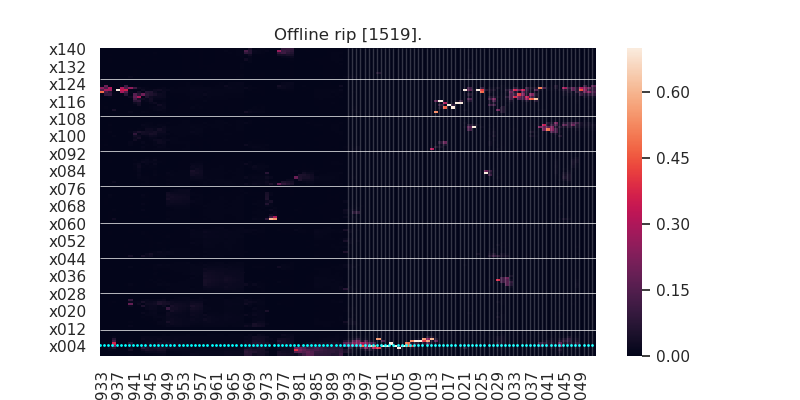

<IPython.core.display.Javascript object>


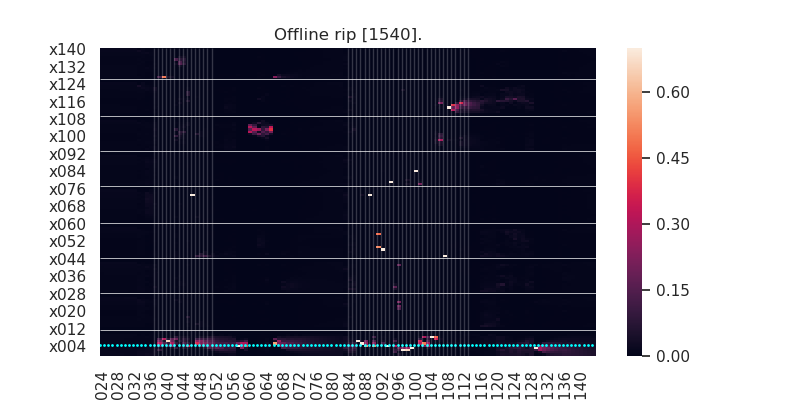

<IPython.core.display.Javascript object>


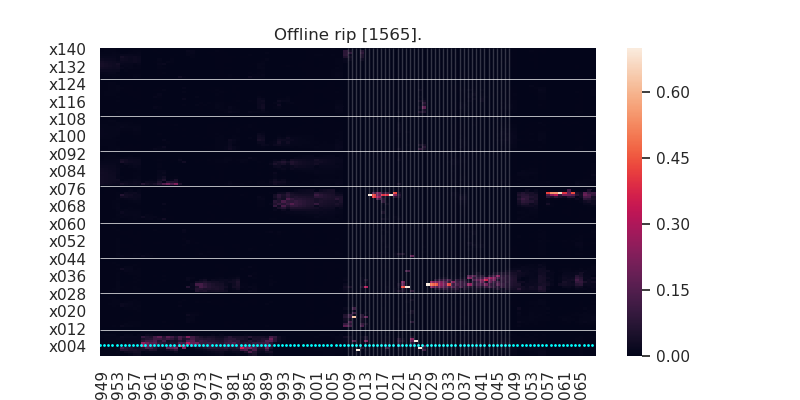

<IPython.core.display.Javascript object>


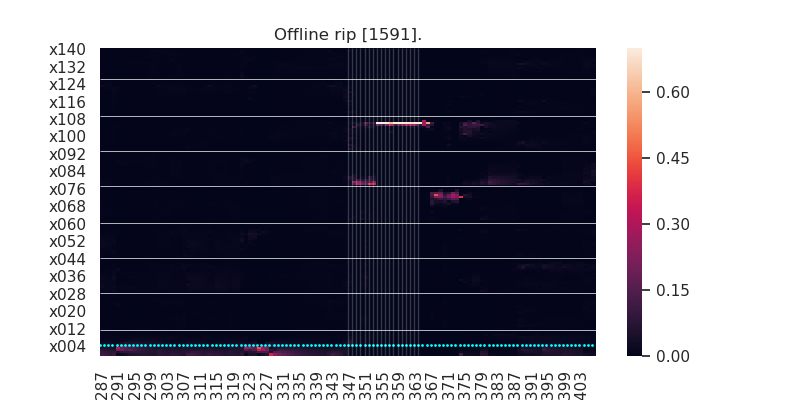

<IPython.core.display.Javascript object>


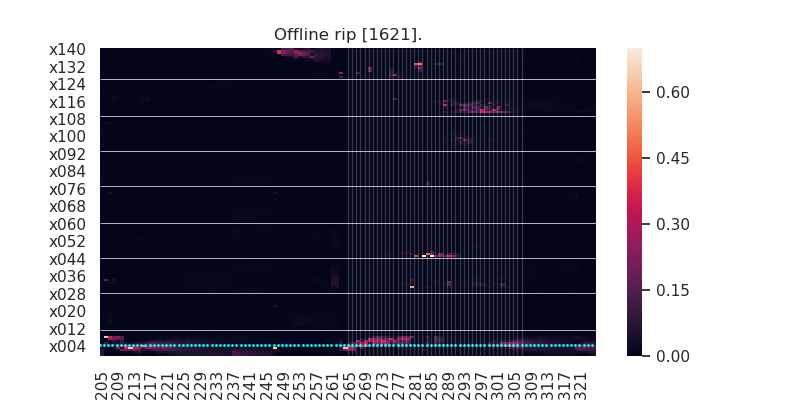

<IPython.core.display.Javascript object>


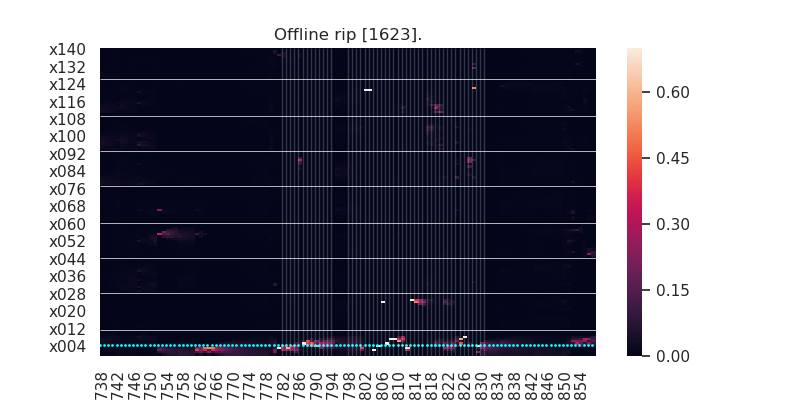

<IPython.core.display.Javascript object>


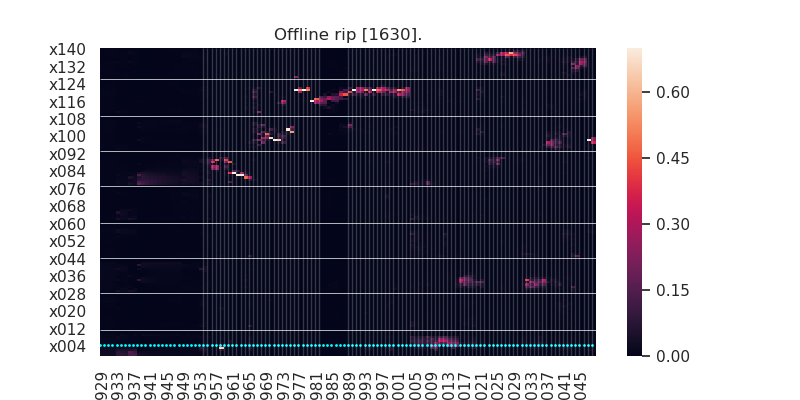

<IPython.core.display.Javascript object>


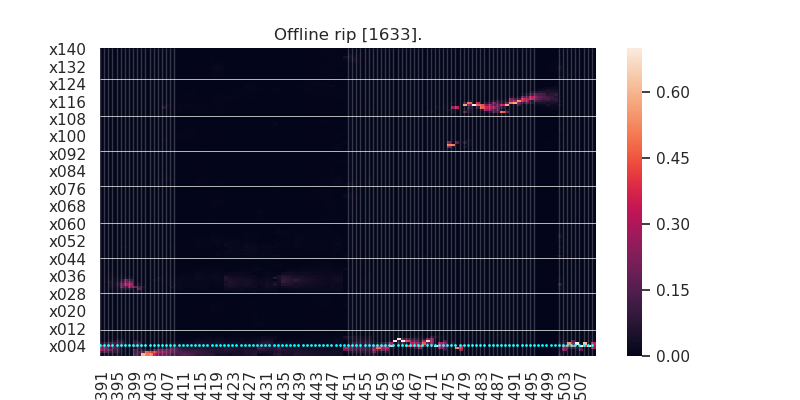

<IPython.core.display.Javascript object>


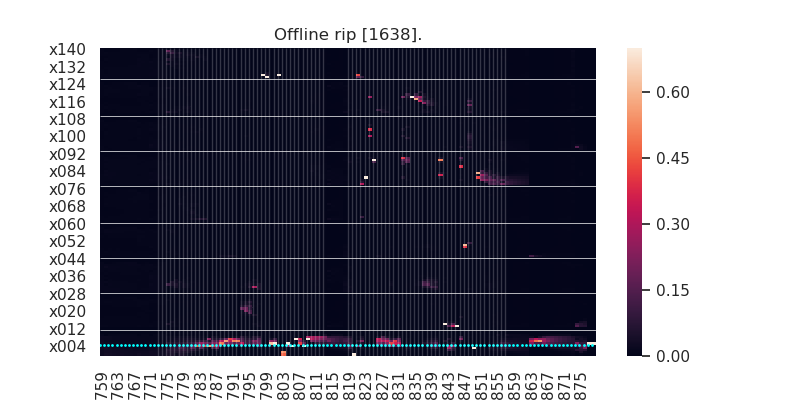

<IPython.core.display.Javascript object>


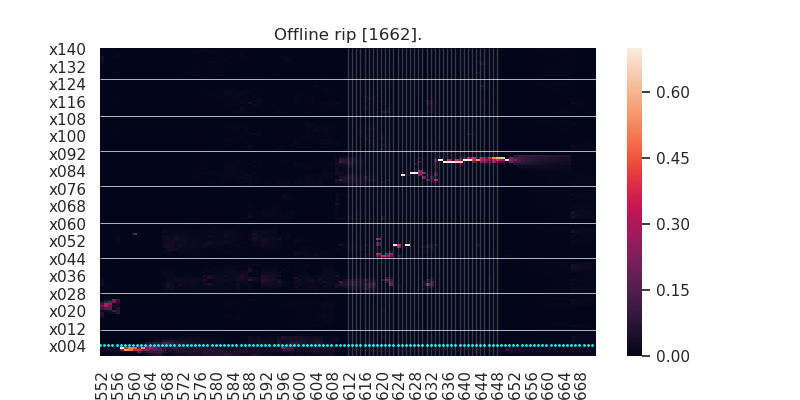

<IPython.core.display.Javascript object>


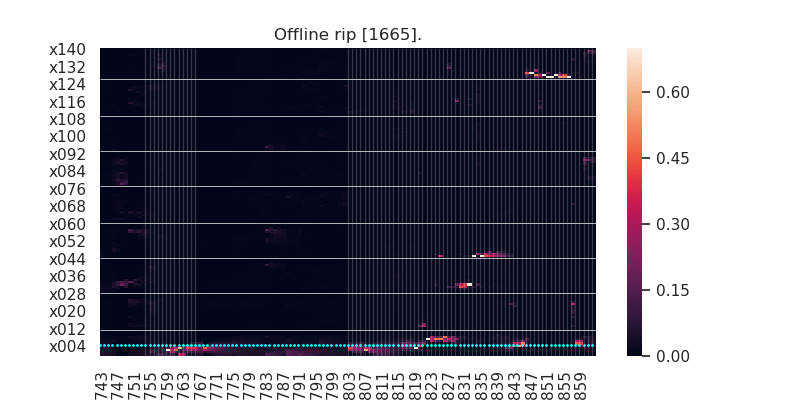

<IPython.core.display.Javascript object>


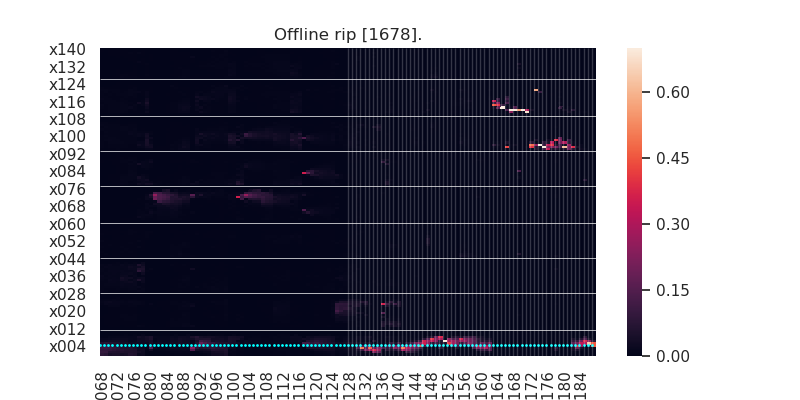

<IPython.core.display.Javascript object>


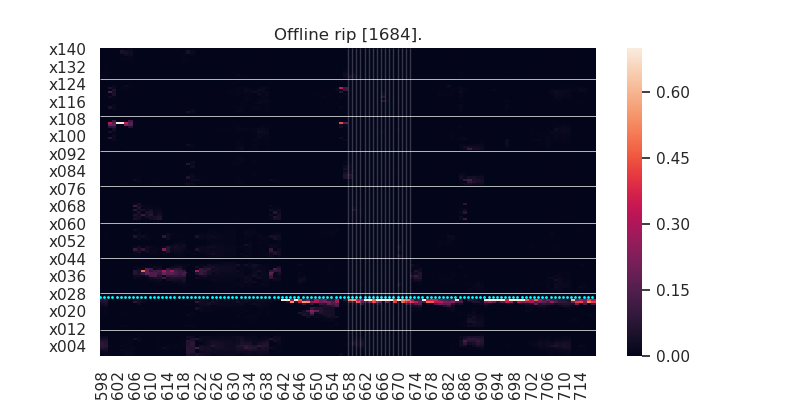

<IPython.core.display.Javascript object>


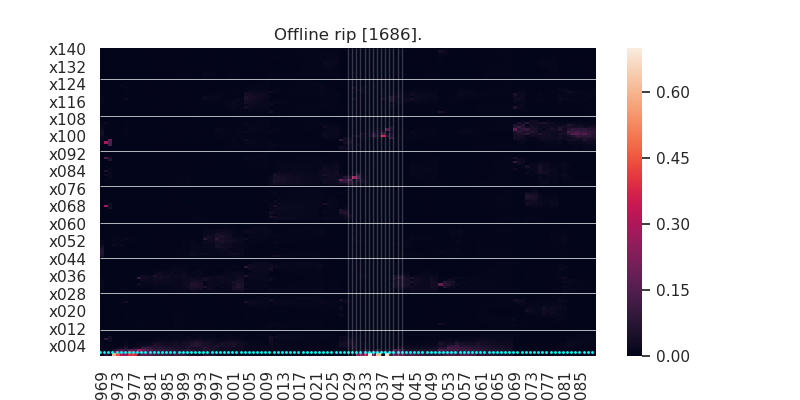

<IPython.core.display.Javascript object>


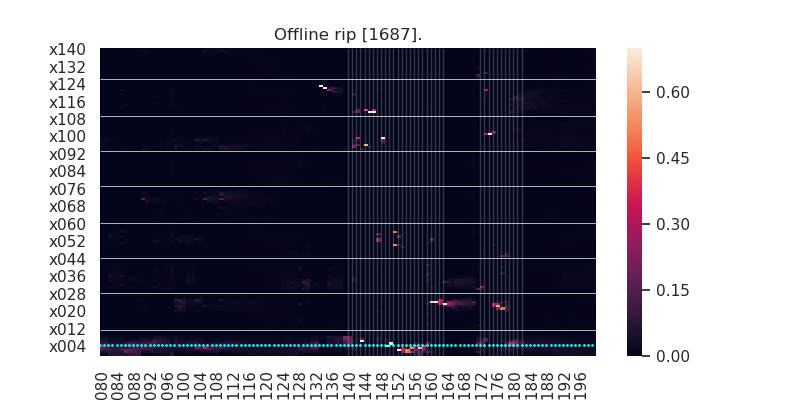

<IPython.core.display.Javascript object>


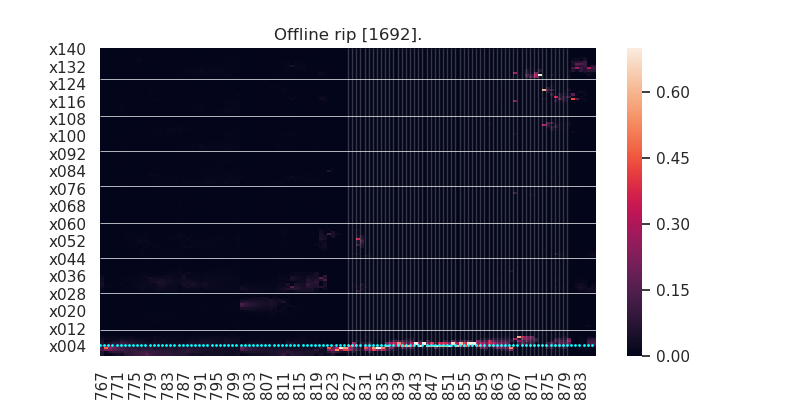

<IPython.core.display.Javascript object>


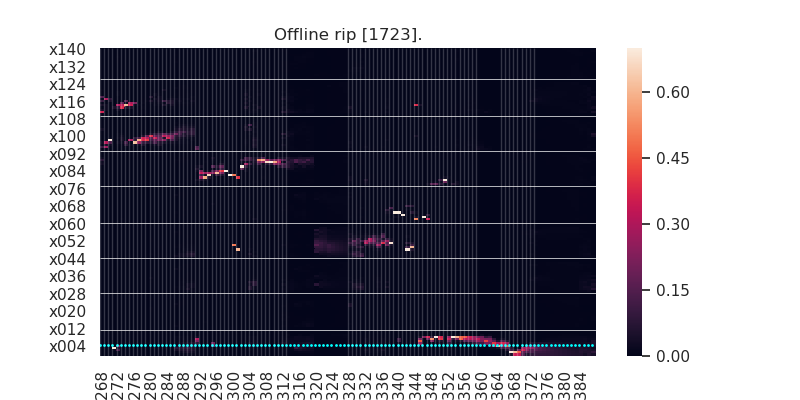

<IPython.core.display.Javascript object>


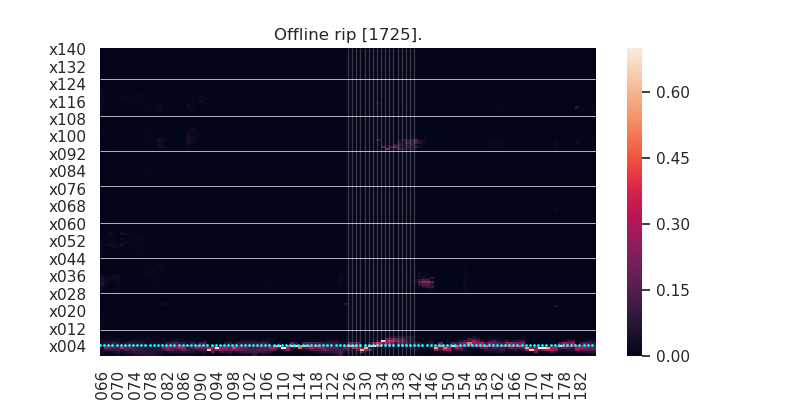

<IPython.core.display.Javascript object>


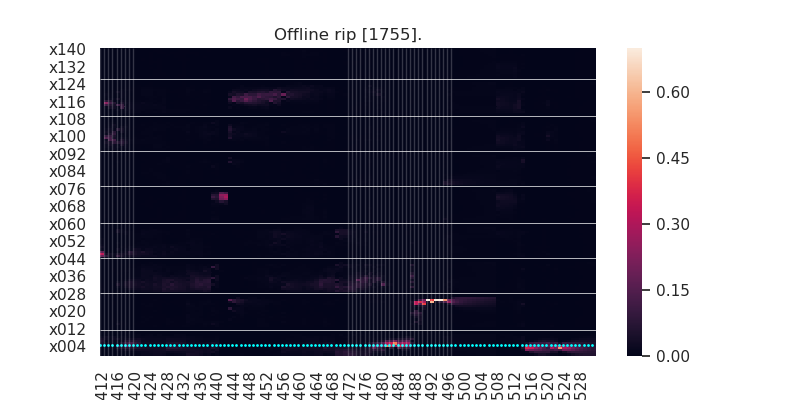

<IPython.core.display.Javascript object>


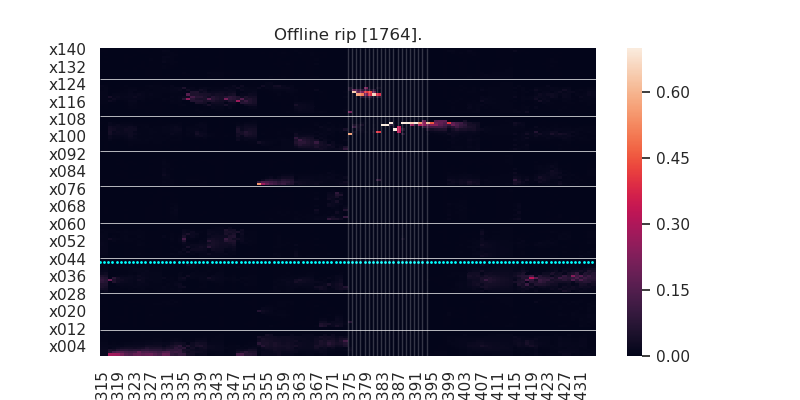

<IPython.core.display.Javascript object>


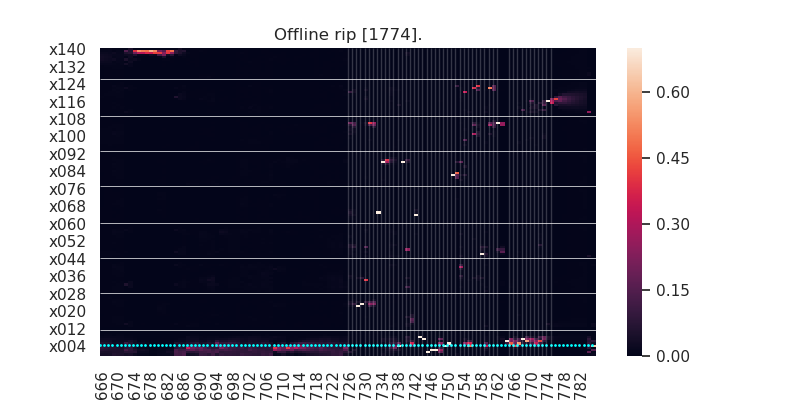

<IPython.core.display.Javascript object>


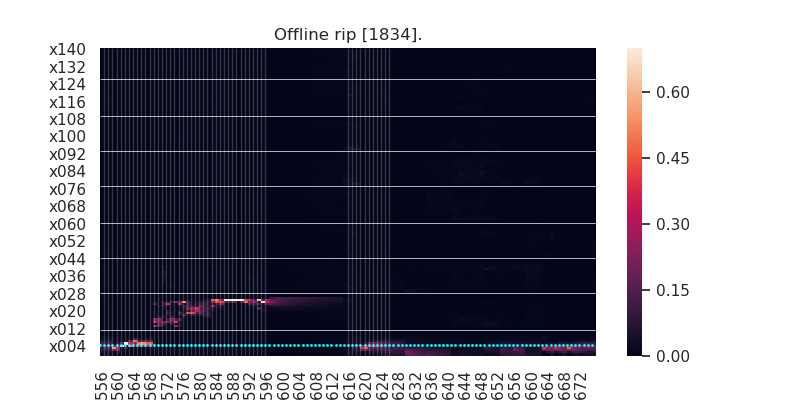

<IPython.core.display.Javascript object>


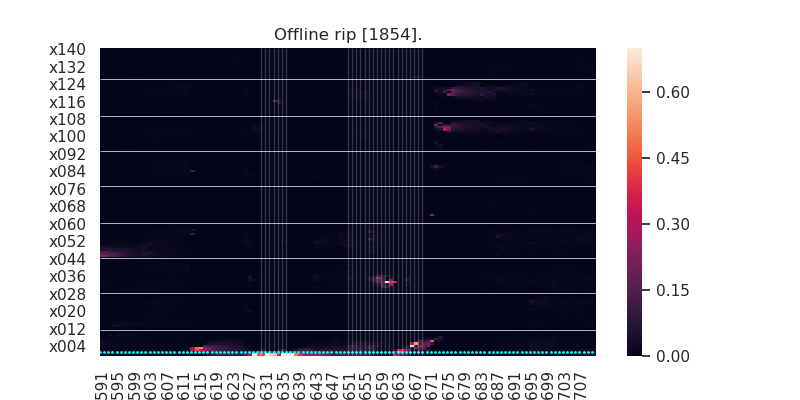

<IPython.core.display.Javascript object>


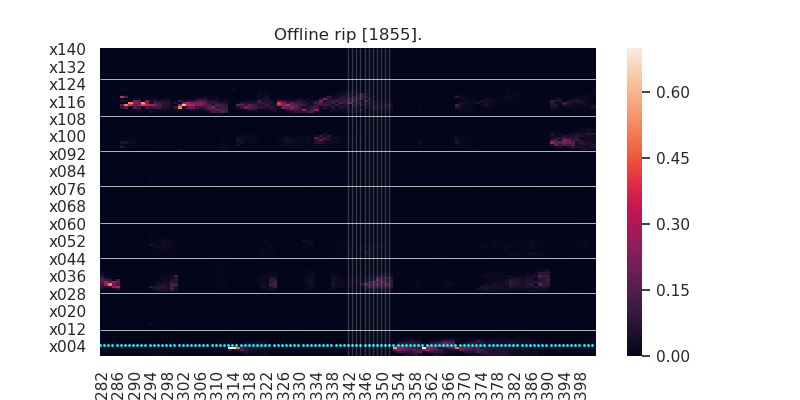

<IPython.core.display.Javascript object>


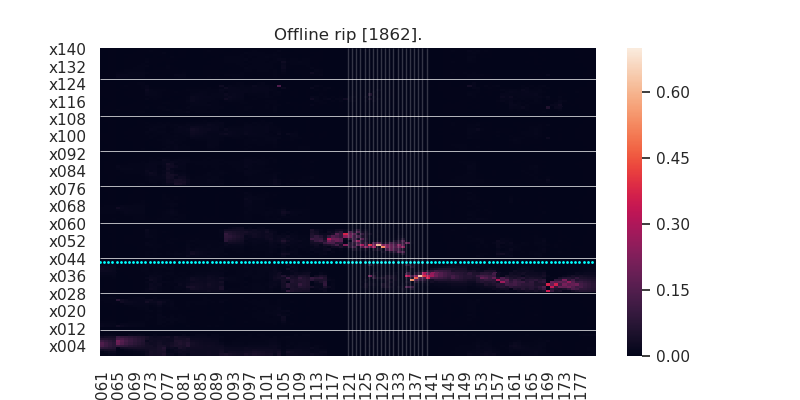

<IPython.core.display.Javascript object>


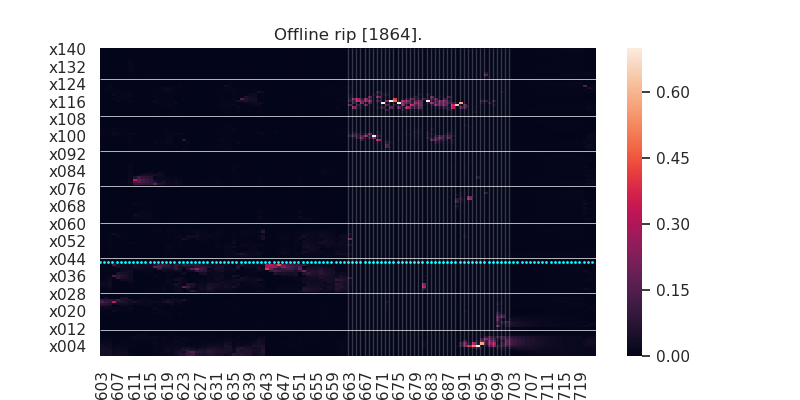

<IPython.core.display.Javascript object>


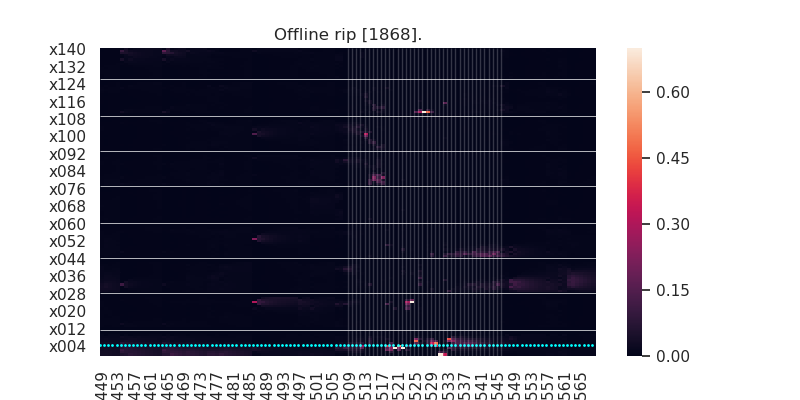

<IPython.core.display.Javascript object>


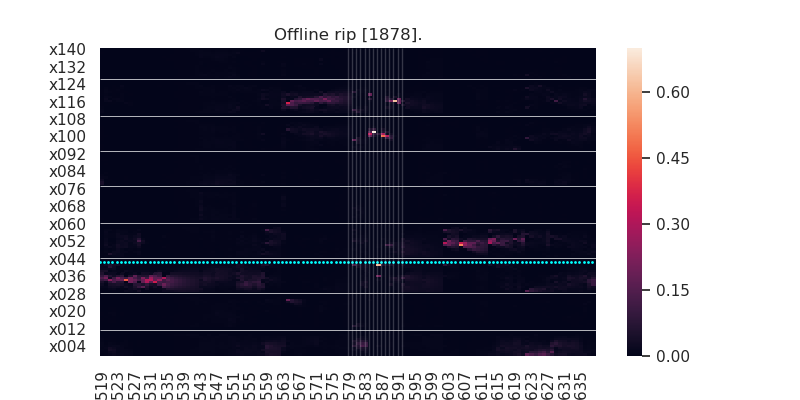

<IPython.core.display.Javascript object>


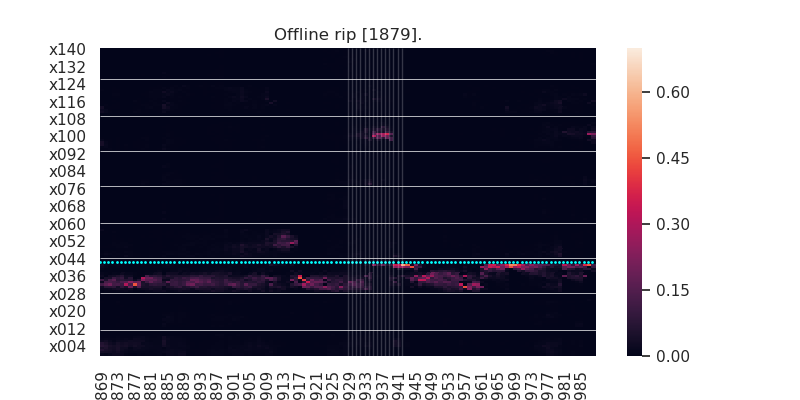

<IPython.core.display.Javascript object>


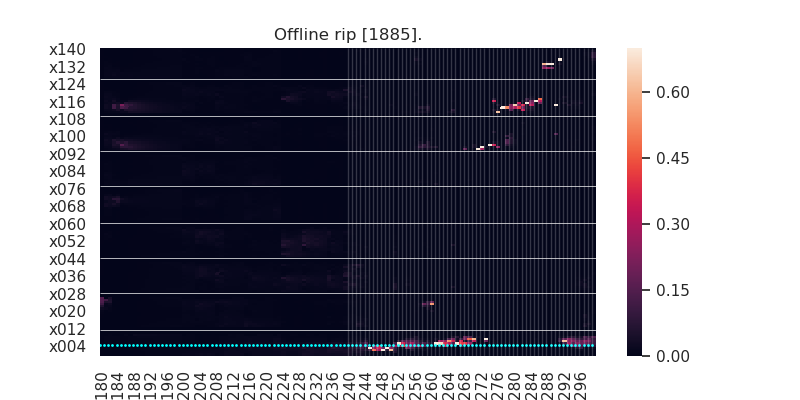

<IPython.core.display.Javascript object>


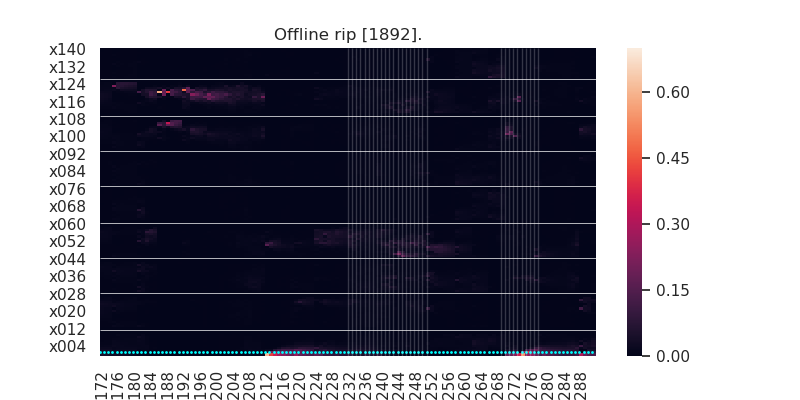

<IPython.core.display.Javascript object>


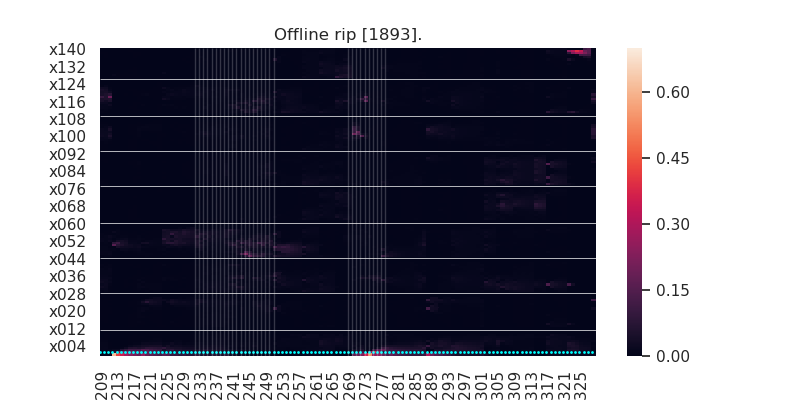

<IPython.core.display.Javascript object>


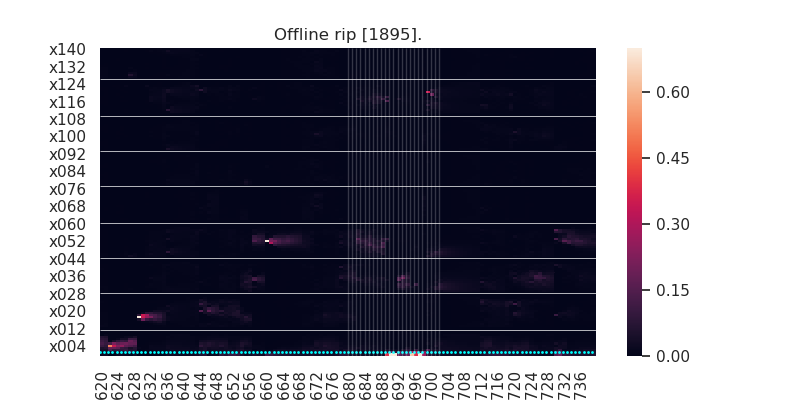

<IPython.core.display.Javascript object>


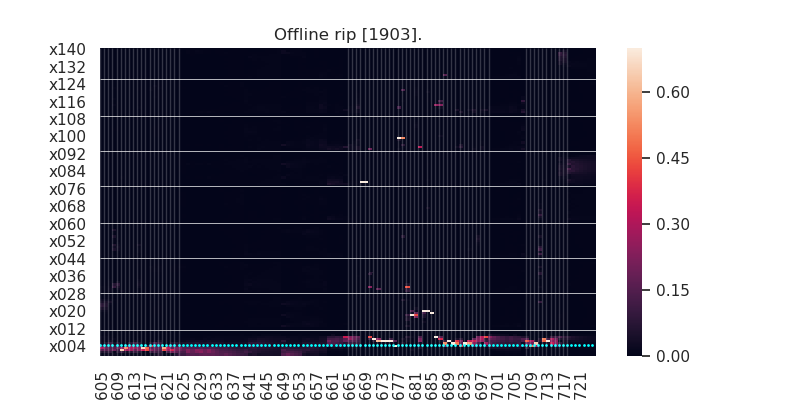

<IPython.core.display.Javascript object>


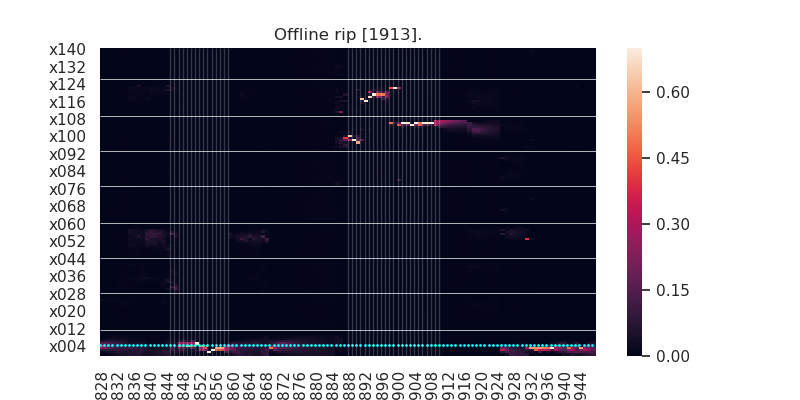

<IPython.core.display.Javascript object>


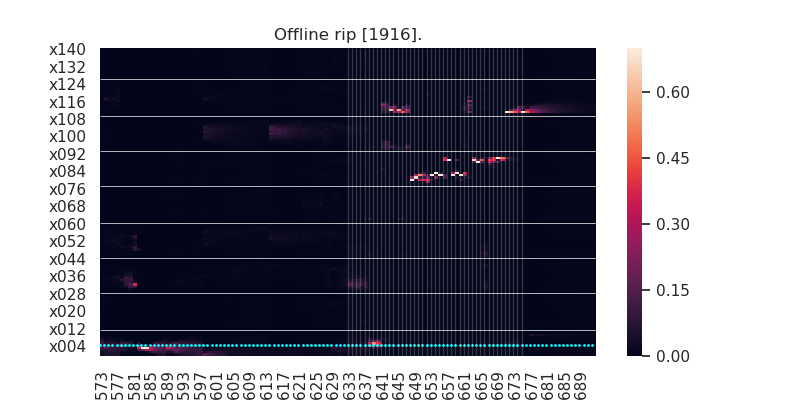

<IPython.core.display.Javascript object>


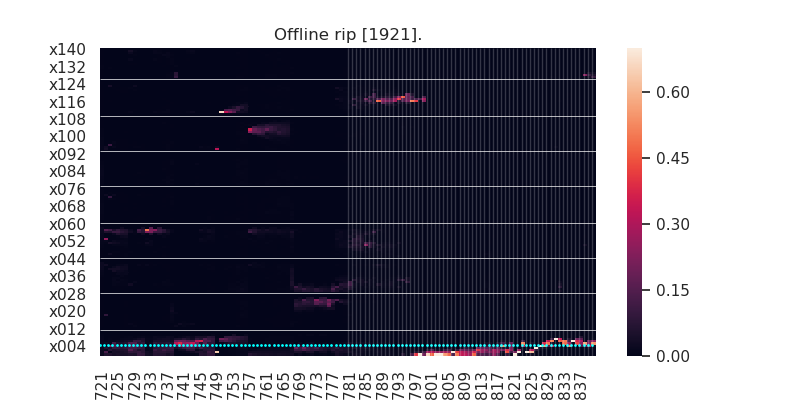

<IPython.core.display.Javascript object>


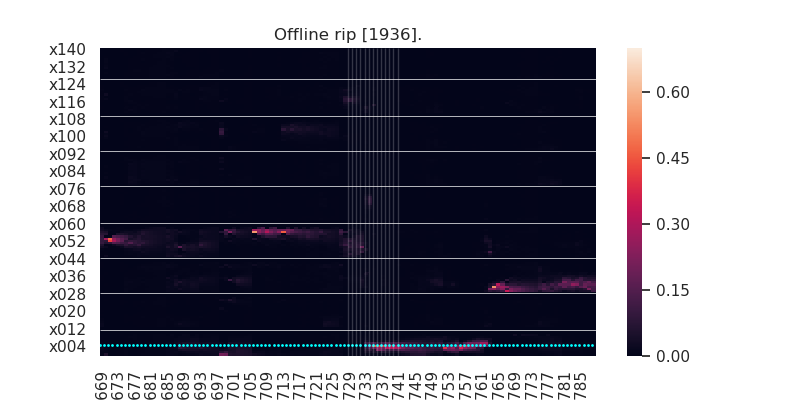

<IPython.core.display.Javascript object>


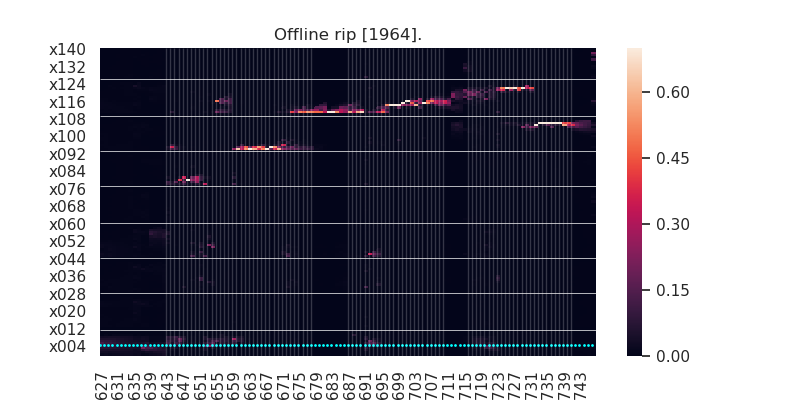

<IPython.core.display.Javascript object>


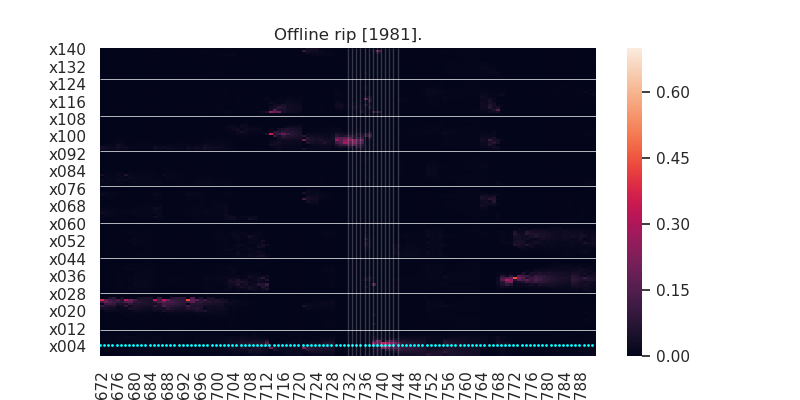

<IPython.core.display.Javascript object>


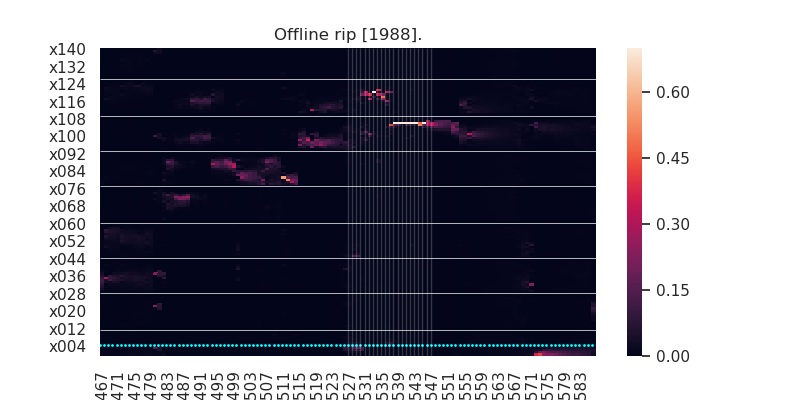

<IPython.core.display.Javascript object>


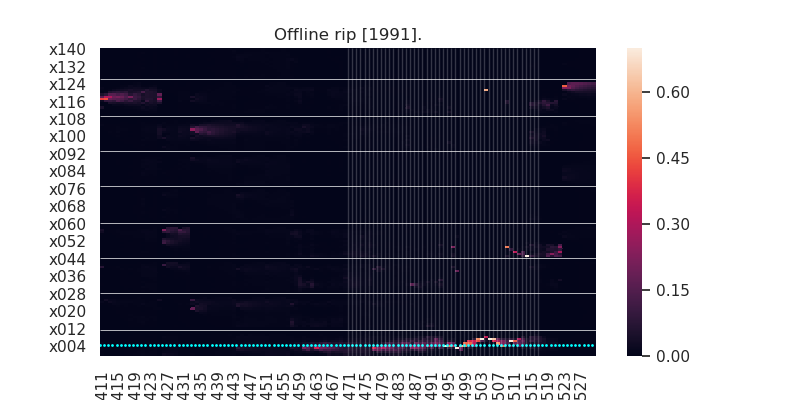

<IPython.core.display.Javascript object>


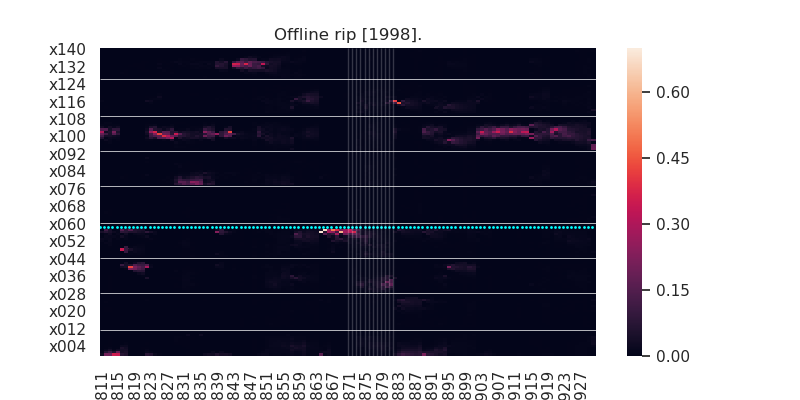

<IPython.core.display.Javascript object>


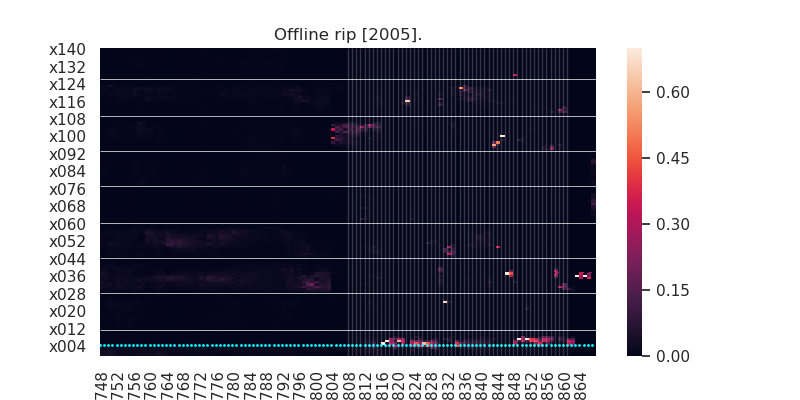

<IPython.core.display.Javascript object>


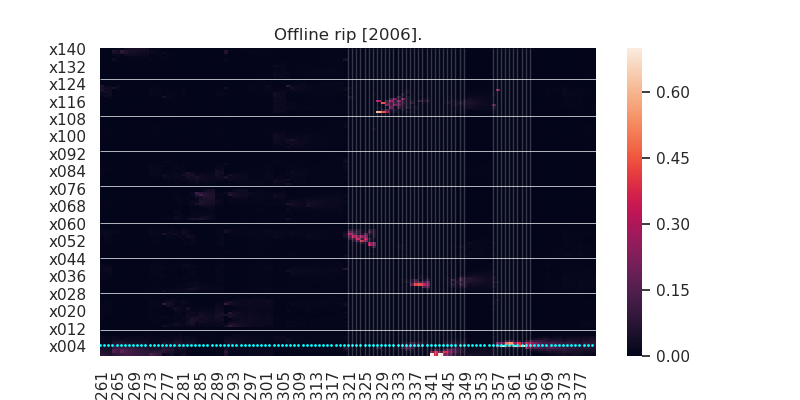

<IPython.core.display.Javascript object>


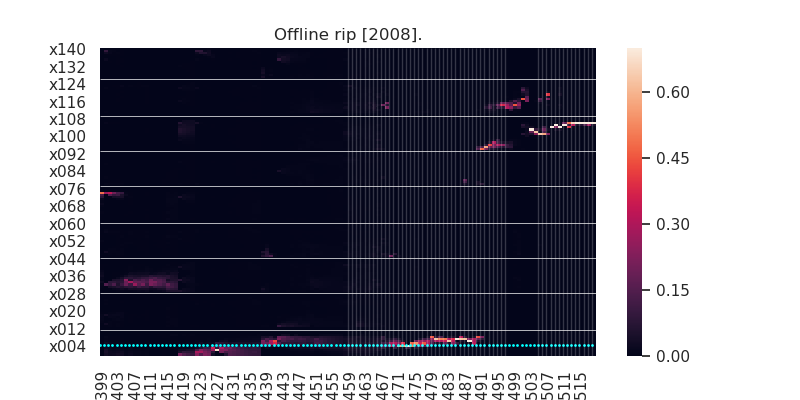

<IPython.core.display.Javascript object>


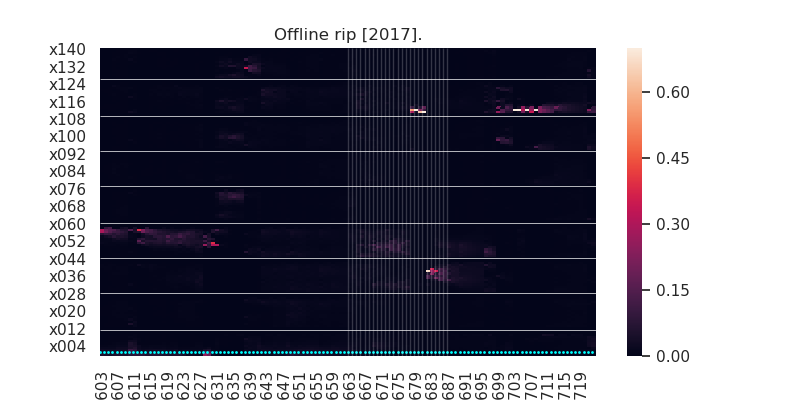

<IPython.core.display.Javascript object>


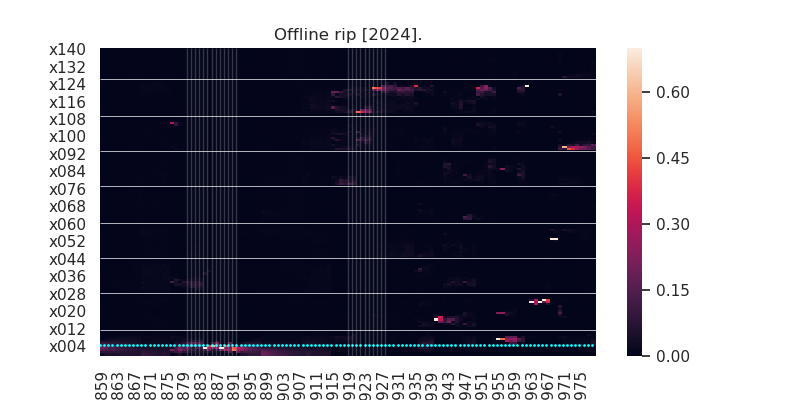

<IPython.core.display.Javascript object>


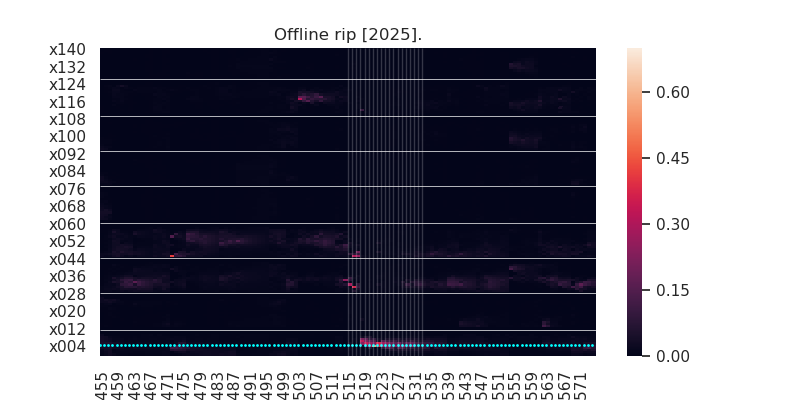

<IPython.core.display.Javascript object>


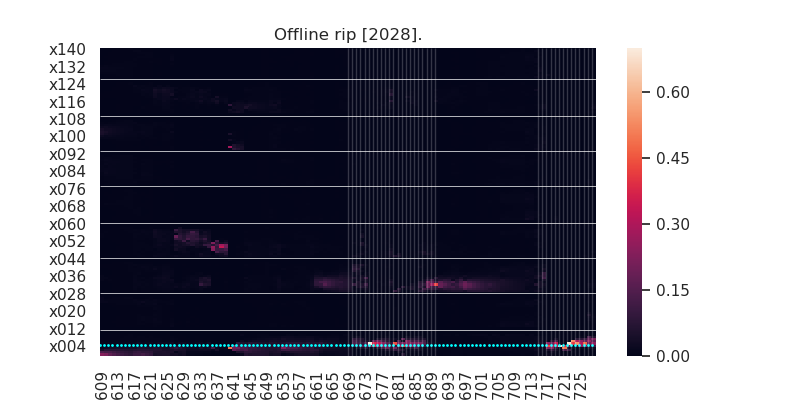

<IPython.core.display.Javascript object>


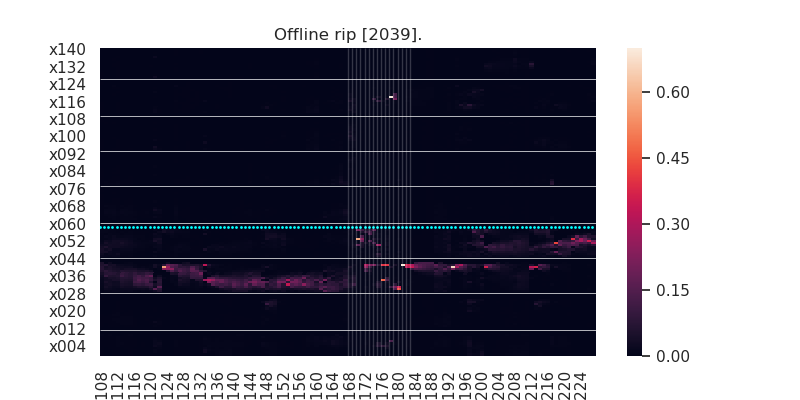

<IPython.core.display.Javascript object>


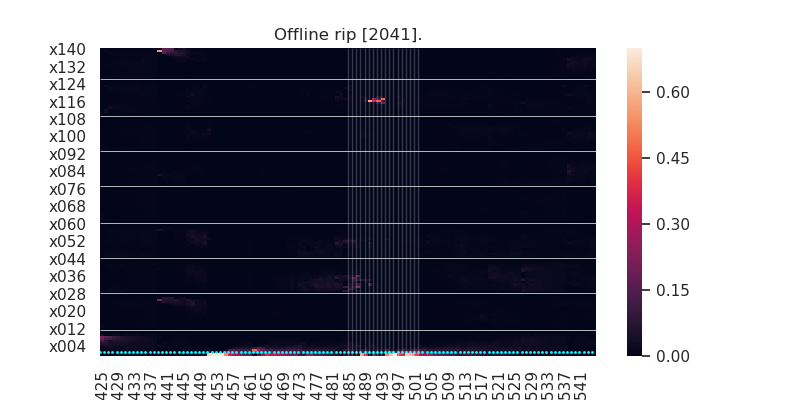

<IPython.core.display.Javascript object>


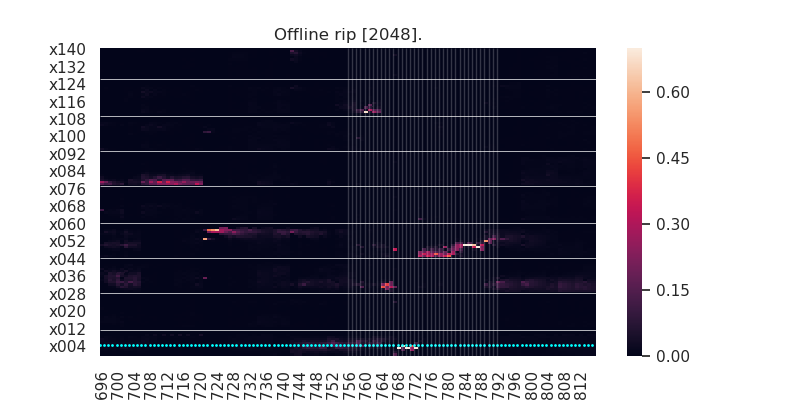

<IPython.core.display.Javascript object>


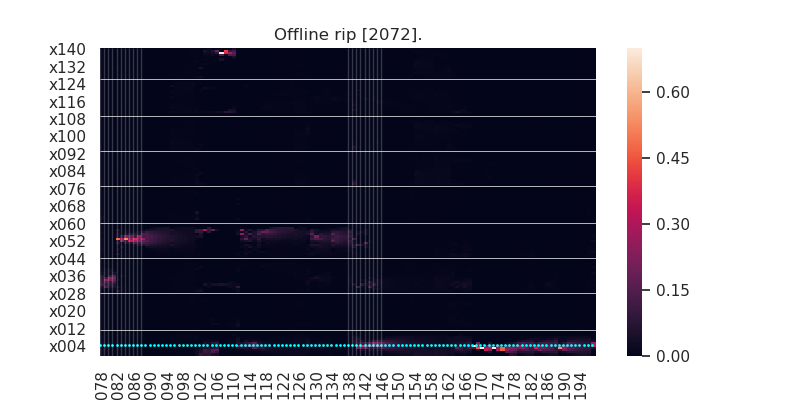

<IPython.core.display.Javascript object>


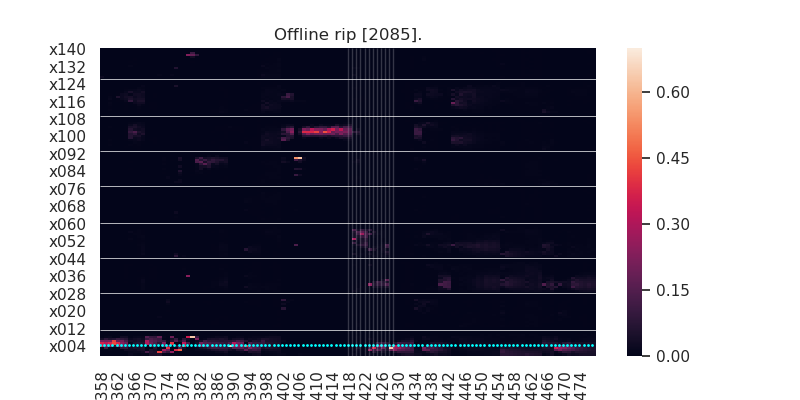

<IPython.core.display.Javascript object>


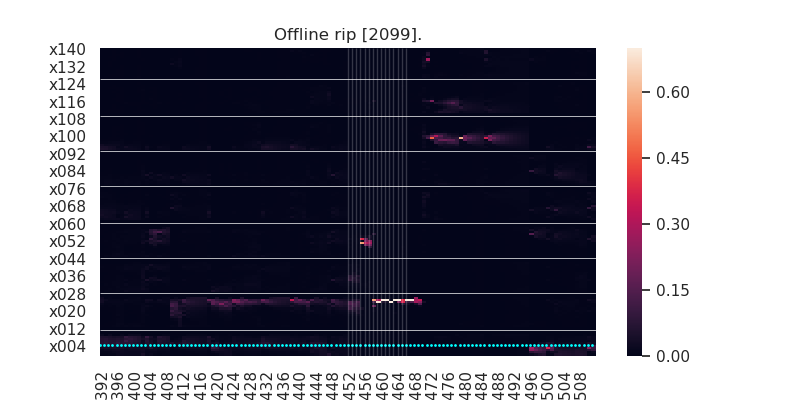

<IPython.core.display.Javascript object>


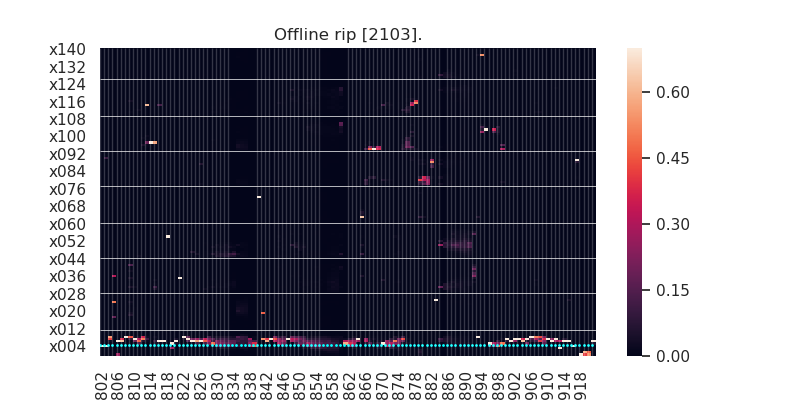

<IPython.core.display.Javascript object>


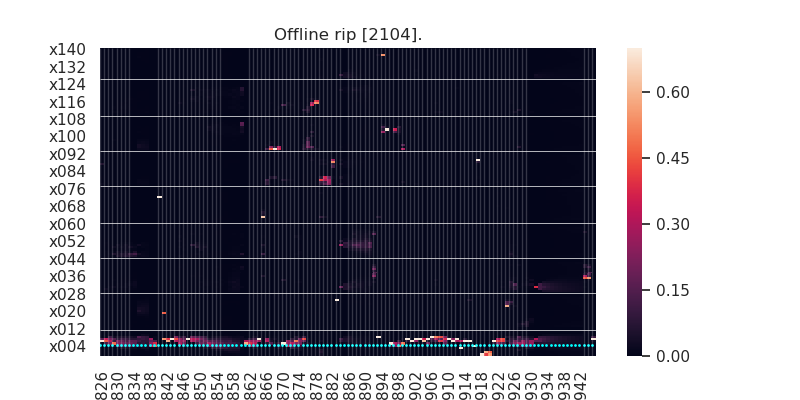

<IPython.core.display.Javascript object>


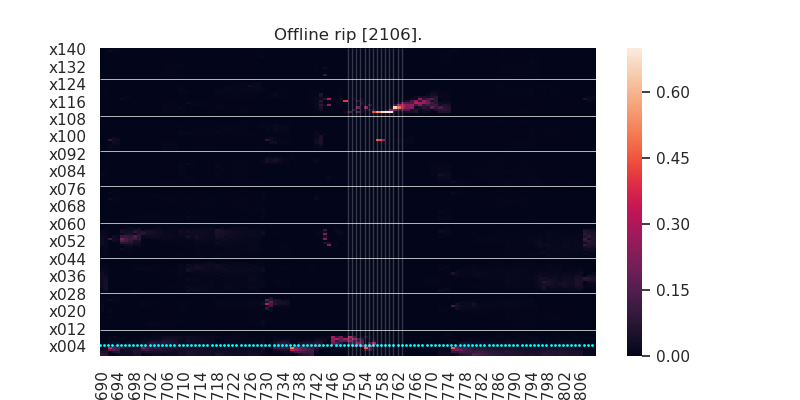

<IPython.core.display.Javascript object>


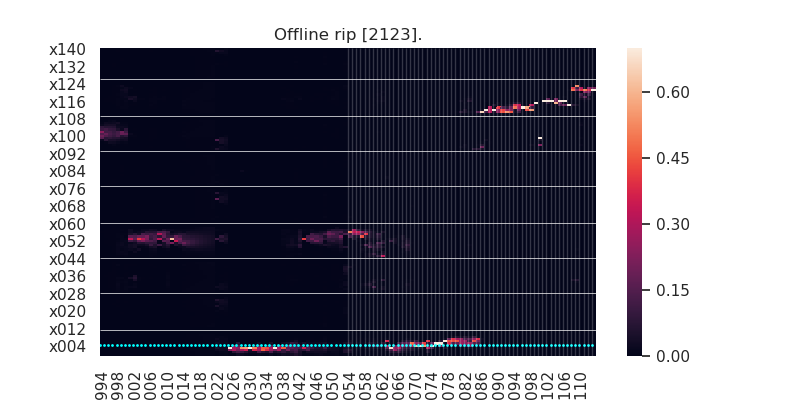

<IPython.core.display.Javascript object>


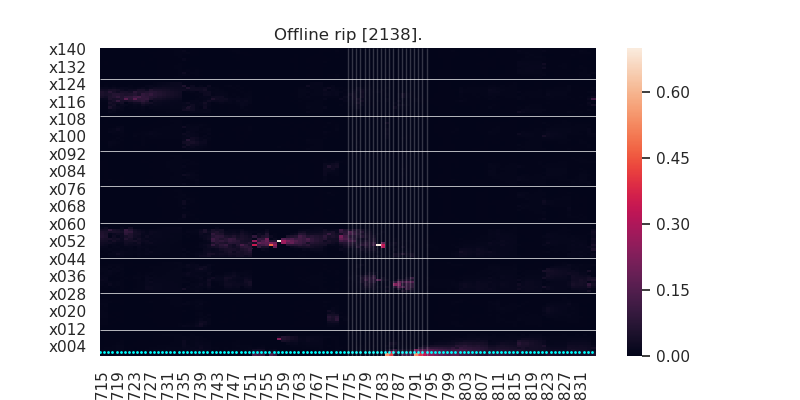

<IPython.core.display.Javascript object>


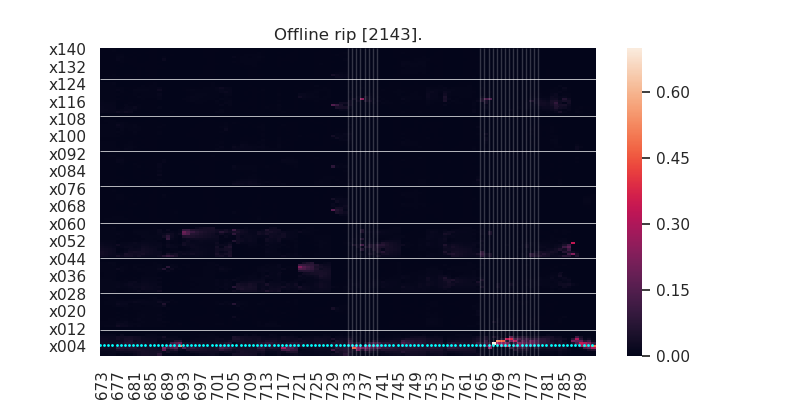

<IPython.core.display.Javascript object>


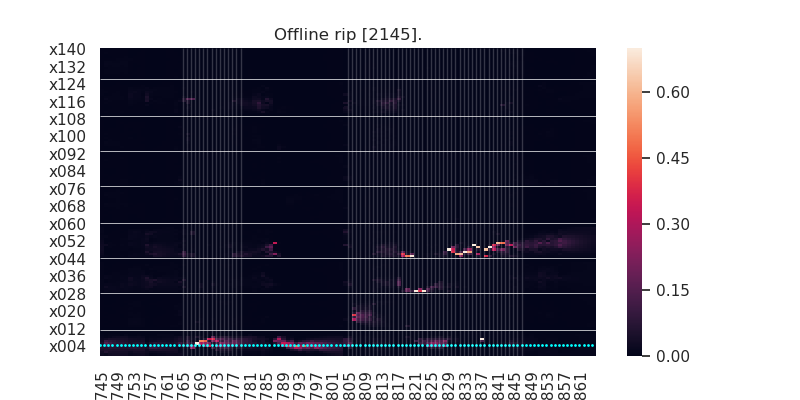

<IPython.core.display.Javascript object>


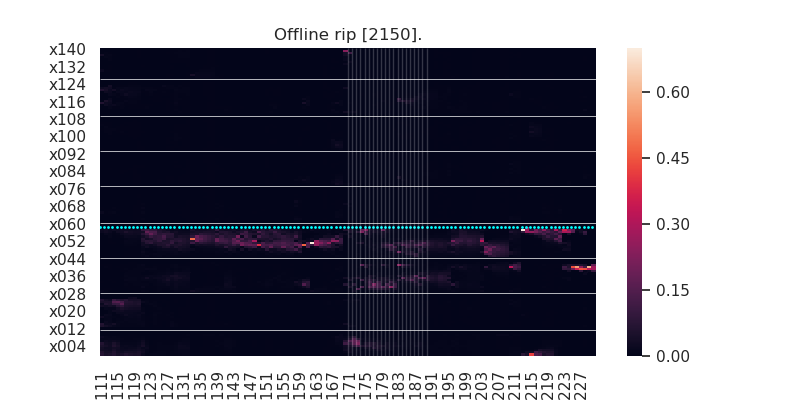

<IPython.core.display.Javascript object>


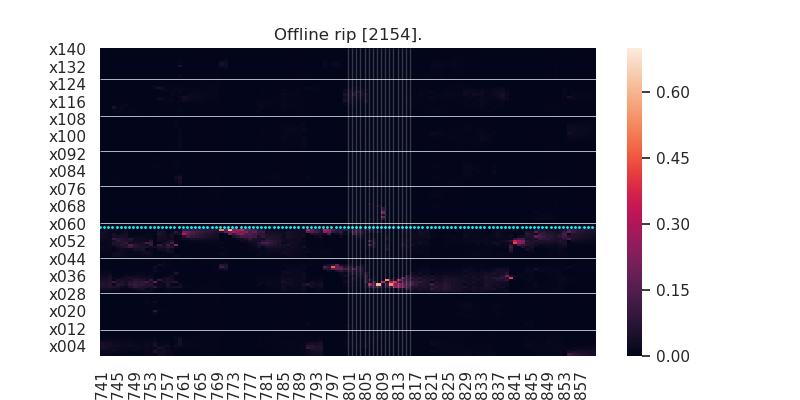

<IPython.core.display.Javascript object>


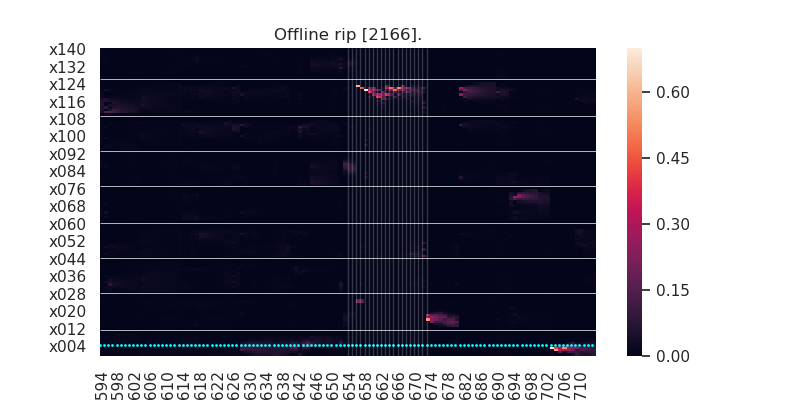

<IPython.core.display.Javascript object>


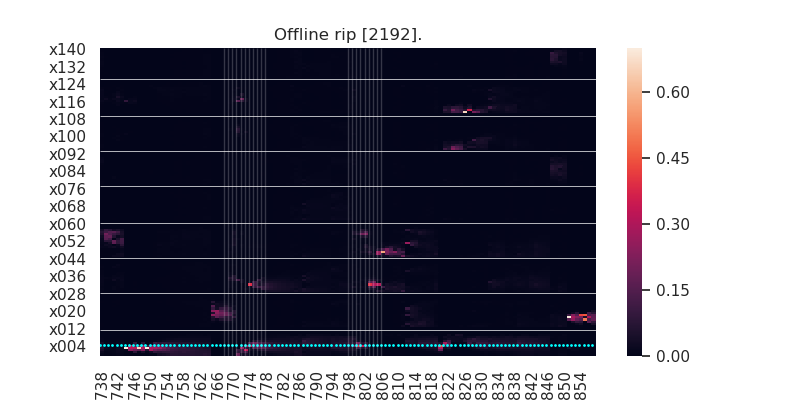

<IPython.core.display.Javascript object>


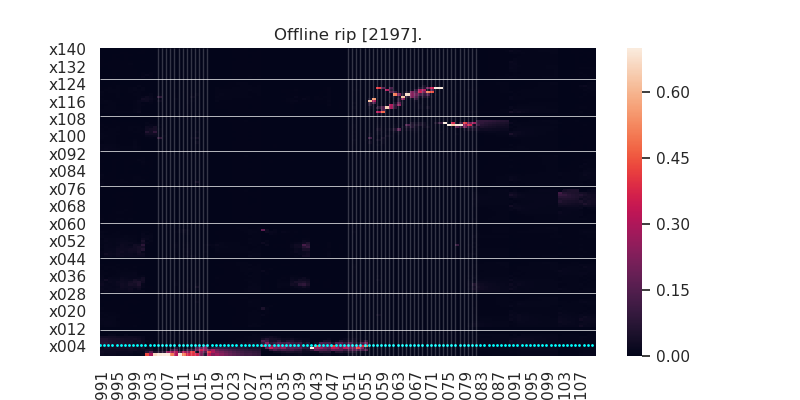

<IPython.core.display.Javascript object>


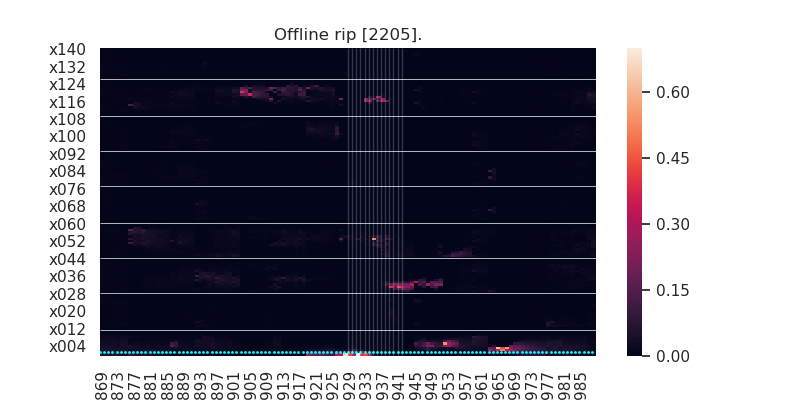

<IPython.core.display.Javascript object>


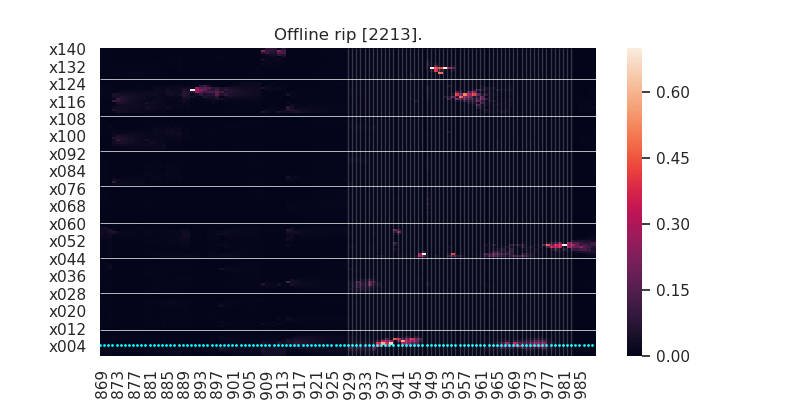

<IPython.core.display.Javascript object>


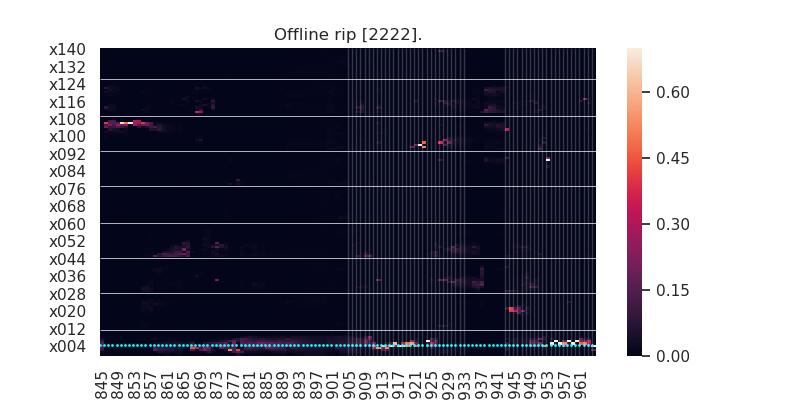

<IPython.core.display.Javascript object>


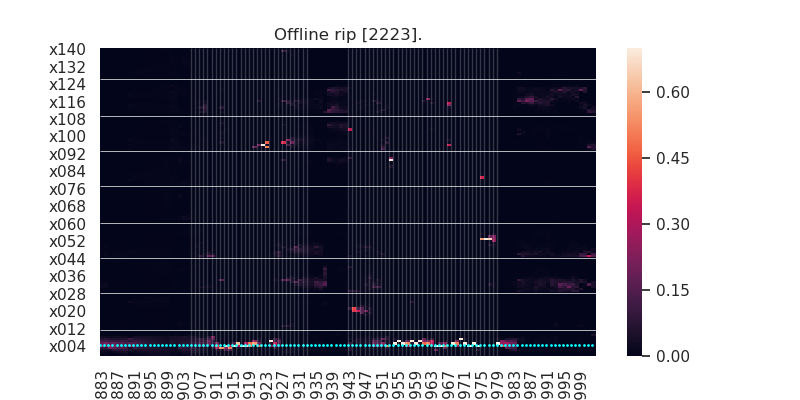

<IPython.core.display.Javascript object>


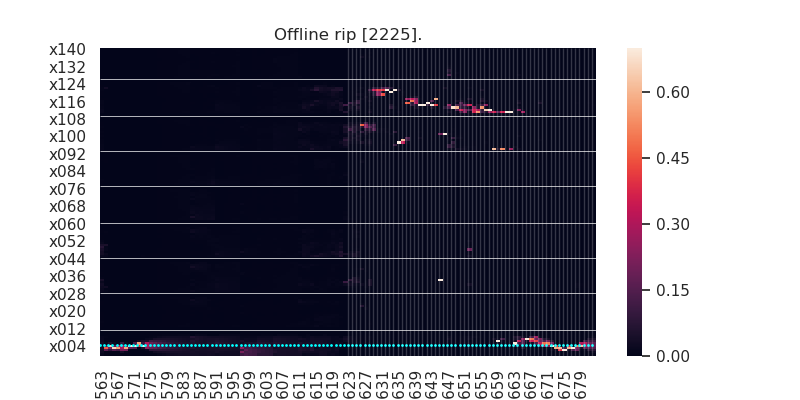

<IPython.core.display.Javascript object>


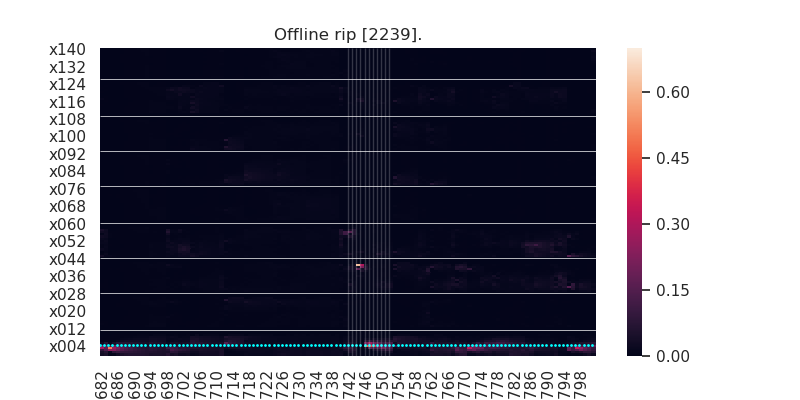

<IPython.core.display.Javascript object>


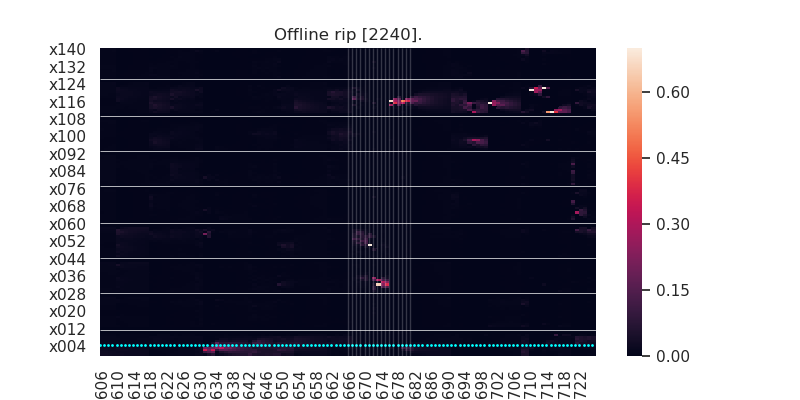

<IPython.core.display.Javascript object>


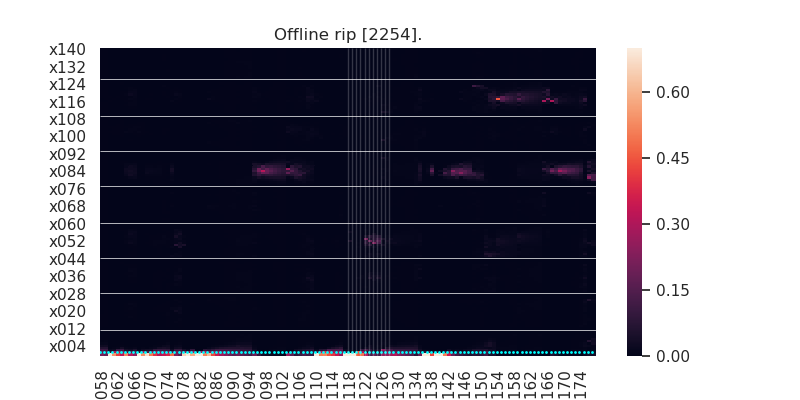

<IPython.core.display.Javascript object>


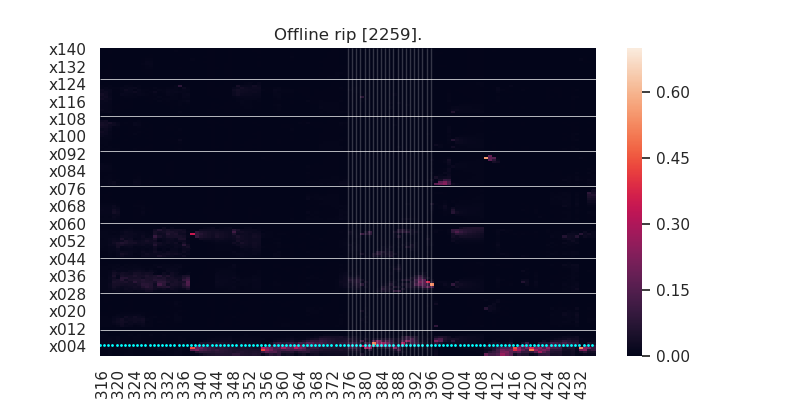

In [53]:
# offline posteriors, 150 uV threshold
# running sum version for offline ripples - 50 msec running sum means 11 bins
#offline arm ends 8, 25, 42, 59, 77, 94, 111, 128, 145 
# old linearization
#arm_coords = [[0,8],[13,25],[30,42],[47,59],[65,77],[82,94],[99,111],[116,128],[133,145]]
# new linearization
arm_coords = [[0,8],[13,25],[29,41],[45,57],[62,74],[78,90],[94,106],[111,123],[127,139]]

# if we want to check all offline ripples
offline_rips_plot = rips.copy()
offline_rips_plot = offline_rips_plot.reset_index()

summarize_all_rips_offline = True

# now need to plot offline ripples that are mismatched

# set which posteriors file to use
posterior_offline = posteriors3.reset_index()
offline_pos = binned_linear_pos.reset_index()
merged_off_post_pos = pd.merge_asof(posterior_offline,offline_pos,on='timestamp',direction='nearest')

# to plot all offline rips: full range [18:-1]
for index, rip_timestamp in enumerate(offline_rips_plot['timestamp'][600:-1]):
    adj_index = index+600
    short_ripple = False
    # to plot all ripples
    #if summarize_all_rips_offline:
    # to plot false positive ripples
    if offline_rips_plot['event'][adj_index:adj_index+1].values in false_positive_data['offline_rip_off'].values:
        #print(rip_timestamp-30*300,rip_timestamp+30*300,index)
        
        posterior_to_plot = merged_off_post_pos[(merged_off_post_pos['timestamp'] > rip_timestamp-30*300) & 
                                            (merged_off_post_pos['timestamp'] < rip_timestamp+30*300)]
     
        ripple_num_index = int(len(posterior_to_plot)*0.55)
        ripple_num = posterior_to_plot[ripple_num_index:ripple_num_index+1]['ripple_grp'].values
        #print(ripple_num,index,ripple_num_index)
        
        ripple_times = posterior_to_plot.index[posterior_to_plot['ripple_grp'] > 0].tolist()

        posterior_offline1 = posterior_to_plot.iloc[:,4:145]
        posterior_offline2 = posterior_offline1.fillna(0)
        post_heatmap = posterior_offline2.transpose()
        post_heatmap = post_heatmap.iloc[::-1]
                              
        plt.figure(figsize=(8,4))
        plt.title(f'Offline rip {ripple_num}.')
        ax = (sns.heatmap(post_heatmap,vmin=0, vmax=0.7))
        ax.hlines([139-10,139-27,139-43,139-59,139-76,139-92,139-108,139-125], lw=0.5, color='w',*ax.get_xlim())
        ax.scatter(np.arange(0,posterior_to_plot.shape[0]),139-posterior_to_plot['linpos_flat'].values,s=1,alpha=1,color='cyan')
        ax.vlines([ripple_times-posterior_to_plot.index[0]],lw=1,color='w',alpha=0.2,*ax.get_ylim())
    
        # final step: save the figure
        #plt.savefig(f'/stelmo/mcoulter/posterior_plots_by_ripple/4_17_20/remy_20_2_offline_false_pos_{ripple_num}_timestamp_{rip_timestamp}.jpg')


In [635]:
# try to compare offline and real-time observations
#timestamp offset: remy day 20, epoch 2: 1958987
# example ripple with arm 6 decode: timestamps: [1.56995697e+08] - [1.56998617e+08] ripple id: 2166
# add 1000 timestamps to end 
encoder_data_plot = encoder_data5.copy()
encoder_data_plot['adj_timestamp'] = encoder_data5['timestamp']+1958987
#encoder_data_plot = encoder_data_plot[encoder_data_plot['elec_grp_id']==30]
encoder_data_plot = encoder_data_plot[(encoder_data_plot['timestamp']>156995697) & 
                  (encoder_data_plot['timestamp']<156999617)]
encoder_data_plot

,rec_ind,timestamp,elec_grp_id,ch1,ch2,ch3,ch4,position,velocity,x000,...,x128,x129,x130,x131,x132,x133,x134,x135,x136,adj_timestamp
1296629,529574,156995744,24,180.0,136.0,123.0,107.0,3.0,0.770049,0.015500,...,0.013079,0.016627,0.018320,0.025072,0.019177,0.013122,0.008155,0.006766,0.010132,158954731
1296630,295195,156995922,9,149.0,197.0,138.0,133.0,3.0,0.678395,0.007360,...,0.007084,0.008620,0.006785,0.006890,0.009411,0.010609,0.013450,0.013752,0.006854,158954909
1296631,166253,156996116,15,166.0,156.0,412.0,361.0,3.0,0.678395,0.000007,...,0.000187,0.000228,0.000265,0.000272,0.000284,0.000248,0.000189,0.000126,0.000068,158955103
1296632,181383,156996196,20,21.0,153.0,48.0,28.0,3.0,0.678395,0.005947,...,0.003350,0.006728,0.001227,0.001667,0.002579,0.006616,0.000153,0.008069,0.005097,158955183
1296633,462529,156996225,22,156.0,512.0,150.0,210.0,3.0,0.678395,0.006579,...,0.008087,0.003795,0.002143,0.005500,0.002492,0.003525,0.003719,0.003733,0.005003,158955212
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1296688,309419,156999187,21,246.0,78.0,116.0,199.0,3.0,0.694451,0.005306,...,0.004987,0.002334,0.001128,0.005965,0.002770,0.000506,0.001198,0.003987,0.005707,158958174
1296689,446116,156999220,11,107.0,184.0,182.0,145.0,3.0,0.694451,0.008735,...,0.007198,0.006152,0.006174,0.008476,0.009512,0.010233,0.010033,0.007869,0.011456,158958207
1296690,373352,156999437,28,8.0,52.0,172.0,65.0,3.0,0.816332,0.007376,...,0.006751,0.009086,0.007458,0.008558,0.007943,0.008156,0.005366,0.008440,0.005423,158958424
1296691,606327,156999447,30,572.0,185.0,163.0,209.0,3.0,0.816332,0.003547,...,0.008398,0.007358,0.010461,0.013969,0.015282,0.011724,0.007264,0.012509,0.008549,158958434


<IPython.core.display.Javascript object>


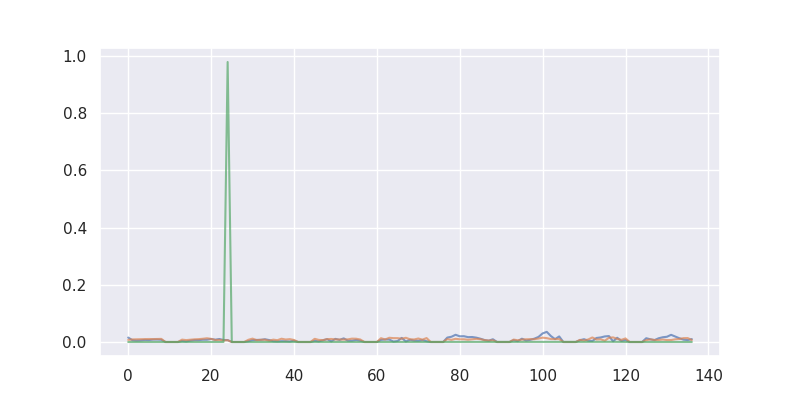

In [652]:
plt.figure(figsize=(8,4))
for i in np.arange(0,3):
    plt.plot(np.arange(0,137),encoder_data_plot.iloc[i:i+1,9:146].values[0],alpha=0.7)
#plt.plot(np.arange(0,137),encoder_data_plot.iloc[1:2,9:146].values[0],alpha=0.7)
#plt.plot(np.arange(0,137),encoder_data_plot.iloc[2:3,9:146].values[0],alpha=0.7)
#plt.plot(np.arange(0,137),encoder_data_plot.iloc[3:4,9:146].values[0],alpha=0.7)
#plt.plot(np.arange(0,137),encoder_data_plot.iloc[4:5,9:146].values[0],alpha=0.7)



<IPython.core.display.Javascript object>


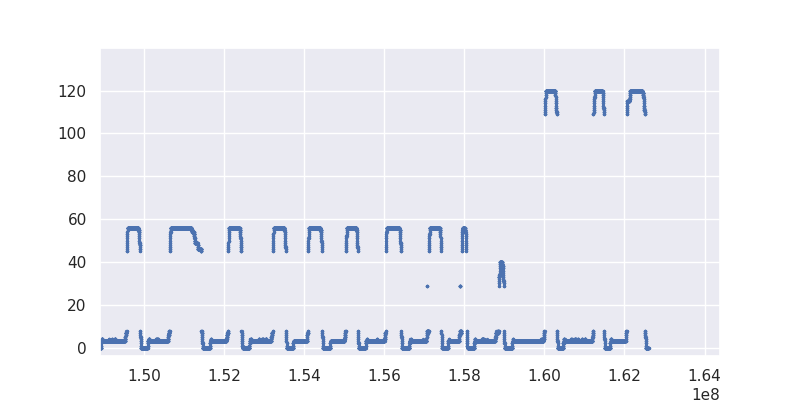

In [639]:
plt.figure(figsize=(8,4))
plt.scatter(occupancy_data5['bin_timestamp'].values,occupancy_data5['linear_pos'].values,s=2)

In [232]:
## DONT USE - not a running sum and wrong linearization
# offline posteriors, 150 uV threshold
#offline arm ends 8, 25, 42, 59, 77, 94, 111, 128, 145 
arm_coords = [[0,8],[13,25],[30,42],[47,59],[65,77],[82,94],[99,111],[116,128],[133,145]]

summarize_all_rips_off = True

# now need to plot offline ripples that are mismatched

posterior_offline = posteriors2.reset_index()
offline_pos = binned_linear_pos.reset_index()
merged_off_post_pos = pd.merge_asof(posterior_offline,offline_pos,on='timestamp',direction='nearest')
offline_posterior_sum_all = np.zeros((len(matching_offline_rips),12))

for index, rip_timestamp in enumerate(matching_offline_rips['timestamp_x'][0:100]):
    # to plot all ripples
    if summarize_all_rips_off:
    # to plotting mis-match replays
    #if matching_offline_rips['lockout_num'][index:index+1].values in non_matching['realtime_rip'].values:
        #print(matching_offline_rips['lockout_num'][index:index+1].values)
        #print(rip_timestamp-30*300,rip_timestamp+30*300,index)

        posterior_to_plot = merged_off_post_pos[(merged_off_post_pos['timestamp'] > rip_timestamp-30*300) & 
                                            (merged_off_post_pos['timestamp'] < rip_timestamp+30*300)]

        realtime_ripple_num = matching_offline_rips['lockout_num'][index:index+1].values
        ripple_num_index = int(len(posterior_to_plot)*0.55)
        ripple_num = posterior_to_plot[ripple_num_index:ripple_num_index+1]['ripple_grp'].values
    
        # calculate posterior sum during ripple
        # we need to only take out the time when ripple_grp matches ripple_grp at the middle of the plotting bin
    
        #post_sum_times = posterior_to_plot[posterior_to_plot['ripple_grp'] > 0]
        post_sum_times = posterior_to_plot[posterior_to_plot['ripple_grp'] == ripple_num[0]]
        ripple_length = post_sum_times.shape[0]
        # sum each arm over whole ripple
        post_sum_ripple = np.zeros((ripple_length,9))
        for i in np.arange(0,ripple_length):
            if i == 0:
                for j in np.arange(0,len(arm_coords),1):
                    post_sum_ripple[i,j] = post_sum_times.iloc[i,4:150].values[arm_coords[j][0]:arm_coords[j][1]].sum()

            else:
                for j in np.arange(0,len(arm_coords),1):
                    post_sum_ripple[i,j] = post_sum_ripple[i-1,j] + post_sum_times.iloc[i,4:150].values[arm_coords[j][0]:arm_coords[j][1]].sum()
            
        # normalize sum of whole ripple - this is the final row
        post_sum_ripple[i] = post_sum_ripple[i]/post_sum_ripple[i].sum()
    
        ripple_times = posterior_to_plot.index[posterior_to_plot['ripple_grp'] > 0].tolist()

        posterior_offline1 = posterior_to_plot.drop(['day_x','epoch_x','timestamp','time_x','num_spikes','dec_bin',
                                                 'ripple_grp','day_y','epoch_y','time_y','linpos_flat',
                                                 'linvel_flat'], axis=1)

        posterior_offline2 = posterior_offline1.fillna(0)
        post_heatmap = posterior_offline2.transpose()
        post_heatmap = post_heatmap.iloc[::-1]

        posterior_sum = np.around(post_sum_ripple[-1:],decimals=1)
        posterior_sum = posterior_sum[0]
    
        if len(np.argwhere(posterior_sum>=0.5)):
            arm_max = np.argwhere(posterior_sum>=0.5)[0][0]
        else:
            arm_max = 99 

        # fill in current row of posterior sum array - seems to work
        offline_posterior_sum_all[index,0] = ripple_num
        offline_posterior_sum_all[index,1] = realtime_ripple_num
        offline_posterior_sum_all[index,2] = arm_max
        offline_posterior_sum_all[index,3] = posterior_sum[0]
        offline_posterior_sum_all[index,4] = posterior_sum[1]
        offline_posterior_sum_all[index,5] = posterior_sum[2]
        offline_posterior_sum_all[index,6] = posterior_sum[3]
        offline_posterior_sum_all[index,7] = posterior_sum[4]
        offline_posterior_sum_all[index,8] = posterior_sum[5]
        offline_posterior_sum_all[index,9] = posterior_sum[6]
        offline_posterior_sum_all[index,10] = posterior_sum[7]
        offline_posterior_sum_all[index,11] = posterior_sum[8]
                                     
        plt.figure(figsize=(12,5))
        plt.title(f'Off rip {ripple_num}. RT rip {realtime_ripple_num} Arm {arm_max} {posterior_sum}')
        ax = (sns.heatmap(post_heatmap,vmin=0, vmax=0.7))
        ax.hlines([145-10,145-27,145-44,145-61,145-79,145-96,145-113,145-130], lw=2, color='w',*ax.get_xlim())
        ax.scatter(np.arange(0,posterior_to_plot.shape[0]),145-posterior_to_plot['linpos_flat'].values,s=2,alpha=1,color='cyan')
        ax.vlines([ripple_times-posterior_to_plot.index[0]],lw=1,color='w',alpha=0.2,*ax.get_ylim())
    
        # final step: save the figure
        #plt.savefig(f'/stelmo/mcoulter/posterior_plots_by_ripple/remy_20_2_offline_2_20_rip_nonmatching_{ripple_num}_real_rip_{realtime_ripple_num}_timestamp_{rip_timestamp}.jpg')

# convert offline_posterior_sum_all array to pandas
# only run this first time through - not with non-matching

#off_post_sum_summary = pd.DataFrame(data=offline_posterior_sum_all,columns=('offline_rip','realtime_rip',
#                                                                            'off_max_arm','box','arm1','arm2',
#                                                                            'arm3','arm4','arm5','arm6',
#                                                                            'arm7','arm8'))

#off_post_sum_summary.shape

(544, 12)

# error calculation

In [16]:
# generate posterior error dataframe for real-time data
post_error1 = decoder_data1.copy()

post_error1.drop(columns=['rec_ind','bin_timestamp','wall_time','velocity','real_pos',
                         'raw_x','raw_y','smooth_x','smooth_y','next_bin',
                         'spike_count','ripple','ripple_number','ripple_length',
                         'shortcut_message','box','arm1','arm2','arm3','arm4','arm5',
                         'arm6','arm7','arm8'], inplace=True)
post_error1.fillna(0,inplace=True)
post_error1['max_position'] = post_error1.idxmax(axis=1)
post_error1['max_position'] = post_error1['max_position'].str.replace('x','')
post_error1['max_position'] = post_error1['max_position'].astype(int)

#now need to add back columns 'timestamp','real_pos_time','real_pos'
# try adding back spike_count too
post_error1['timestamp'] = decoder_data1['bin_timestamp']
post_error1['real_vel'] = decoder_data1['velocity']
post_error1['real_pos'] = decoder_data1['real_pos']
post_error1['spike_count'] = decoder_data1['spike_count']
#this is the error column in centimeters
post_error1['error_cm'] = abs(post_error1['max_position']-decoder_data1['real_pos'])*5

post_error1
post_error_plot1 = post_error1.copy()
#post_error_plot9 = post_error_plot9
post_error_plot1 = post_error_plot1[post_error_plot1['real_vel']>5]
post_error_plot1.shape

(177698, 143)

In [123]:
binned_linear_pos

<_FlatLinearPosition: d6c3909f-4bd7-43c6-b1d2-2e8115900c19, shape: ((122655, 2))>

In [124]:
#calculate max for offline posteriors
post_to_merge = posteriors2.copy()

#calculate posterior max
post_to_merge1 = post_to_merge.drop(['num_spikes','dec_bin','ripple_grp'], axis=1)
post_to_merge1.fillna(0,inplace=True)
post_to_merge1['posterior_max'] = post_to_merge1.idxmax(axis=1)
post_to_merge1['posterior_max'] = post_to_merge1['posterior_max'].str.replace('x','')
post_to_merge1['posterior_max'] = post_to_merge1['posterior_max'].astype(int)

#post_to_merge.reset_index(level=['timestamp'],inplace=True)
post_to_merge1.reset_index(inplace=True)
post_to_merge1['timestamp1']=post_to_merge1['timestamp']

#calculate posterior max

#post_to_merge.set_index('timestamp', append=True, inplace=True)
#post_to_merge.set_index('dat','epoch','timestamp', 'time',append=True, inplace=True)
#post_to_merge1 = post_to_merge.reorder_levels(['day', 'epoch', 'timestamp', 'time'])
post_to_merge1

pos_vel = binned_linear_pos.copy()
pos_vel1 = pos_vel.reset_index()
pos_vel1['timestamp1'] = pos_vel1['timestamp']
pos_vel2 = pos_vel1.drop(['day','epoch','time','timestamp'], axis=1)

posterior_with_pos_vel = pd.merge_asof(post_to_merge1,pos_vel2,on='timestamp1',direction='nearest')
posterior_with_pos_vel['error_cm'] = abs(posterior_with_pos_vel['posterior_max']-posterior_with_pos_vel['linpos_flat'])*5
posterior_with_pos_vel

post_error_plot_off = posterior_with_pos_vel.copy()
#post_error_plot_off = post_error_plot[100:821700]
#post_error_plot_off = post_error_plot_off[post_error_plot_off['linvel_flat']>4]
post_error_plot_off.shape

(821703, 155)

<IPython.core.display.Javascript object>


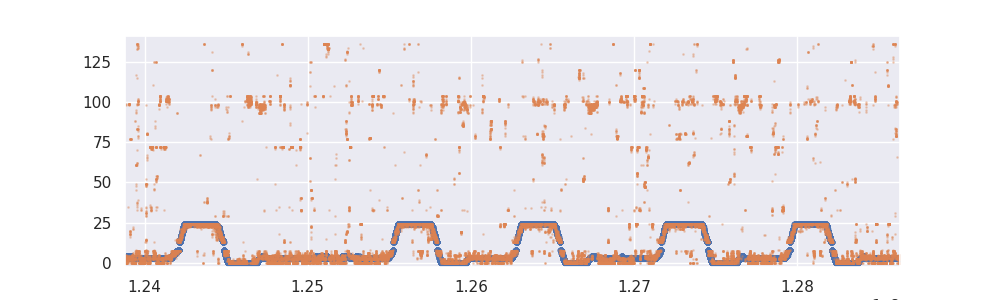

In [10]:
%matplotlib notebook
# plot decoded max posterior and real position
plt.figure(figsize=(10,3))

#post_error_plot_subset = post_error_plot3[(post_error_plot3['timestamp']>124500000) & 
#                                          (post_error_plot3['timestamp']<124700000)]

plt.scatter(post_error_plot['timestamp'].values,post_error_plot['real_pos'].values,s=10)
plt.scatter(post_error_plot['timestamp'].values,post_error_plot['max_position'].values,s=1,alpha=0.3)


<IPython.core.display.Javascript object>


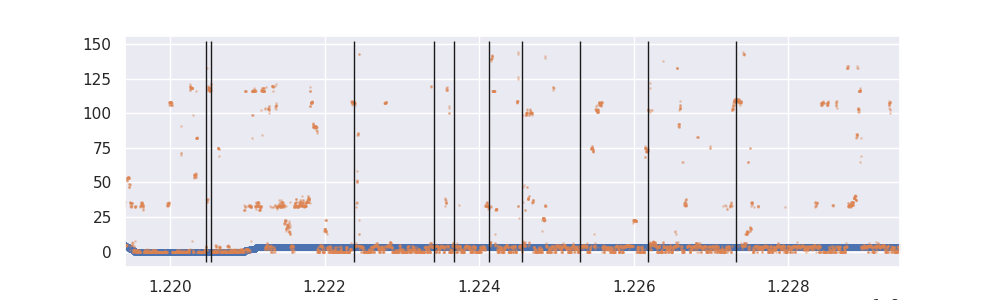

In [126]:
# plot offline max posterior and real position
plt.figure(figsize=(10,3))

#post_error_plot_subset = post_error_plot3[(post_error_plot3['timestamp']>124500000) & 
#                                          (post_error_plot3['timestamp']<124700000)]

plt.scatter(post_error_plot_off['timestamp'].values,post_error_plot_off['linpos_flat'].values,s=10)
plt.scatter(post_error_plot_off['timestamp'].values,post_error_plot_off['posterior_max'].values,s=1,alpha=0.3)
plt.vlines(rips['timestamp'].values,lw=1,color='k',alpha=1,*plt.ylim())


In [ ]:
# remote error
# only calculate error during movement
#post_error_plot7 = post_error_plot7[post_error_plot7['real_vel']>8]
post_error_plot5 = post_error_plot1.copy()

#arm_coords_rt = [[0,7],[12,23],[28,39],[44,55],[60,71],[76,87],[92,103],[108,119],[124,135]]
# new arm_coords 2-2020: [[0,8],[13,24],[29,40],[45,56],[61,72],[77,88],[93,104],[109,120],[125,136]]
box = post_error_plot5[(post_error_plot5['real_pos']>=0) & (post_error_plot5['real_pos']<=8)]
arm1 = post_error_plot5[(post_error_plot5['real_pos']>=13) & (post_error_plot5['real_pos']<=24)]
arm2 = post_error_plot5[(post_error_plot5['real_pos']>=29) & (post_error_plot5['real_pos']<=40)]
arm3 = post_error_plot5[(post_error_plot5['real_pos']>=45) & (post_error_plot5['real_pos']<=56)]
arm4 = post_error_plot5[(post_error_plot5['real_pos']>=61) & (post_error_plot5['real_pos']<=72)]
arm5 = post_error_plot5[(post_error_plot5['real_pos']>=77) & (post_error_plot5['real_pos']<=88)]
arm6 = post_error_plot5[(post_error_plot5['real_pos']>=93) & (post_error_plot5['real_pos']<=104)]
arm7 = post_error_plot5[(post_error_plot5['real_pos']>=109) & (post_error_plot5['real_pos']<=120)]
arm8 = post_error_plot5[(post_error_plot5['real_pos']>=125) & (post_error_plot5['real_pos']<=136)]
print(arm1.shape[0])
print(post_error_plot5.shape)
# fraction of bins with remote error
box_remote_error = ((box.shape[0] - box[(box['max_position']>=0) & (box['max_position']<=8)].shape[0])/box.shape[0])
arm1_remote_error = ((arm1.shape[0] - arm1[(arm1['max_position']>=13) & (arm1['max_position']<=24)].shape[0])/arm1.shape[0])
arm2_remote_error = ((arm2.shape[0] - arm2[(arm2['max_position']>=29) & (arm2['max_position']<=40)].shape[0])/arm2.shape[0])
arm3_remote_error = ((arm3.shape[0] - arm3[(arm3['max_position']>=45) & (arm3['max_position']<=56)].shape[0])/arm3.shape[0])
arm4_remote_error = ((arm4.shape[0] - arm4[(arm4['max_position']>=61) & (arm4['max_position']<=72)].shape[0])/arm4.shape[0])
arm5_remote_error = ((arm5.shape[0] - arm5[(arm5['max_position']>=77) & (arm5['max_position']<=88)].shape[0])/arm5.shape[0])
arm6_remote_error = ((arm6.shape[0] - arm6[(arm6['max_position']>=93) & (arm6['max_position']<=104)].shape[0])/arm6.shape[0])
arm7_remote_error = ((arm7.shape[0] - arm7[(arm7['max_position']>=109) & (arm7['max_position']<=120)].shape[0])/arm7.shape[0])
arm8_remote_error = ((arm8.shape[0] - arm8[(arm8['max_position']>=125) & (arm8['max_position']<=136)].shape[0])/arm8.shape[0])

#print error values
print(box_remote_error,arm1_remote_error,arm2_remote_error,arm3_remote_error,arm4_remote_error,arm5_remote_error,arm6_remote_error,arm7_remote_error,arm8_remote_error)
box_frac = box.shape[0]/post_error_plot5.shape[0]
arm1_frac = arm1.shape[0]/post_error_plot5.shape[0]
arm2_frac = arm2.shape[0]/post_error_plot5.shape[0]
arm3_frac = arm3.shape[0]/post_error_plot5.shape[0]
arm4_frac = arm4.shape[0]/post_error_plot5.shape[0]
arm5_frac = arm5.shape[0]/post_error_plot5.shape[0]
arm6_frac = arm6.shape[0]/post_error_plot5.shape[0]
arm7_frac = arm7.shape[0]/post_error_plot5.shape[0]
arm8_frac = arm8.shape[0]/post_error_plot5.shape[0]

# fraction of arm-only time
arm1_frac1 = arm1.shape[0]/(post_error_plot5.shape[0]*(1-box_frac))
arm2_frac1 = arm2.shape[0]/(post_error_plot5.shape[0]*(1-box_frac))
arm3_frac1 = arm3.shape[0]/(post_error_plot5.shape[0]*(1-box_frac))
arm4_frac1 = arm4.shape[0]/(post_error_plot5.shape[0]*(1-box_frac))
arm5_frac1 = arm5.shape[0]/(post_error_plot5.shape[0]*(1-box_frac))
arm6_frac1 = arm6.shape[0]/(post_error_plot5.shape[0]*(1-box_frac))
arm7_frac1 = arm7.shape[0]/(post_error_plot5.shape[0]*(1-box_frac))
arm8_frac1 = arm8.shape[0]/(post_error_plot5.shape[0]*(1-box_frac))
#weighted average for box + each arm
print((box_remote_error*box_frac + arm1_remote_error*arm1_frac +arm2_remote_error*arm2_frac +
       arm3_remote_error*arm3_frac +arm4_remote_error*arm4_frac +arm5_remote_error*arm5_frac +
       arm6_remote_error*arm6_frac +arm7_remote_error*arm7_frac +arm8_remote_error*arm8_frac))
# weighted average no box
print((arm1_remote_error*arm1_frac1 +arm2_remote_error*arm2_frac1 +arm3_remote_error*arm3_frac1 +
       arm4_remote_error*arm4_frac1 +arm5_remote_error*arm5_frac1 +arm6_remote_error*arm6_frac1 +
       arm7_remote_error*arm7_frac1 +arm8_remote_error*arm8_frac1))


In [ ]:
# local error
# NOTE: need to update arm coords
box_local = box[(box['max_position']>-1) & (box['max_position']<8)]
arm1_local = arm1[(arm1['max_position']>11) & (arm1['max_position']<24)]
arm2_local = arm2[(arm2['max_position']>27) & (arm2['max_position']<40)]
arm3_local = arm3[(arm3['max_position']>43) & (arm3['max_position']<56)]
arm4_local = arm4[(arm4['max_position']>59) & (arm4['max_position']<72)]
arm5_local = arm5[(arm5['max_position']>75) & (arm5['max_position']<88)]
arm6_local = arm6[(arm6['max_position']>91) & (arm6['max_position']<104)]
arm7_local = arm7[(arm7['max_position']>107) & (arm7['max_position']<120)]
arm8_local = arm8[(arm8['max_position']>123) & (arm8['max_position']<136)]

box_local_error = np.median(box_local['error_cm'].values)
arm1_local_error = np.median(arm1_local['error_cm'].values)
arm2_local_error = np.median(arm2_local['error_cm'].values)
arm3_local_error = np.median(arm3_local['error_cm'].values)
arm4_local_error = np.median(arm4_local['error_cm'].values)
arm5_local_error = np.median(arm5_local['error_cm'].values)
arm6_local_error = np.median(arm6_local['error_cm'].values)
arm7_local_error = np.median(arm7_local['error_cm'].values)
arm8_local_error = np.median(arm8_local['error_cm'].values)

print(arm1_local_error,arm2_local_error,arm3_local_error,arm4_local_error,arm5_local_error,arm6_local_error,arm7_local_error,arm8_local_error,)

# total bins with local error
local_total_bins = (arm1_local.shape[0]+arm2_local.shape[0]+arm3_local.shape[0]+arm4_local.shape[0]+
                    arm5_local.shape[0]+arm6_local.shape[0]+arm7_local.shape[0]+arm8_local.shape[0])
local_total_bins
#weighted average for each arm
(arm1_local_error*(arm1_local.shape[0]/local_total_bins)+arm2_local_error*(arm2_local.shape[0]/local_total_bins)+
 arm3_local_error*(arm3_local.shape[0]/local_total_bins)+arm4_local_error*(arm4_local.shape[0]/local_total_bins)+
 arm5_local_error*(arm5_local.shape[0]/local_total_bins)+arm6_local_error*(arm6_local.shape[0]/local_total_bins)+
 arm7_local_error*(arm7_local.shape[0]/local_total_bins)+
 arm8_local_error*(arm8_local.shape[0]/local_total_bins))